In [1]:
import numpy as np
import math
import matplotlib.pyplot as plt
import random as rand
import FMM3D.python.fmm3dpy as fmm

In [73]:
np.random.rand(2,3)-0.5

array([[-0.16061285, -0.44696169,  0.28253339],
       [ 0.42462752,  0.34998567, -0.43567184]])

In [64]:
#initialize positions

#ma_posx = [-8.80378877e-14, -2.00400157e-05,  2.00400157e-05,  2.45180411e-05,
#  2.00400157e-05, -9.47046622e-14, -2.45180410e-05, -5.06892235e-14,
# -7.51007479e-16, -2.00400156e-05]
#ma_posy = [9.16801357e-06,  2.01849643e-05,
#  2.01849644e-05, -3.33118772e-14, -2.01849643e-05, -9.16801358e-06,
# -6.91825536e-14,  3.07232821e-05, -3.07232821e-05, -2.01849643e-05]

num_ions = 100
#rad = 2*10**-3 #ions uniformly distributed in sphere of this radius
rad = 2*10**-4 #test
vol = 4/3*np.pi*rad**3
start_pos_x = np.empty(num_ions)
start_pos_y = np.empty(num_ions)
start_pos_z = np.empty(num_ions)
for i in range(num_ions):
    this_vol = rand.random()*vol
    this_rad = (3/(4*np.pi)*this_vol)**(1/3)
    #this_theta = rand.random()*np.pi
    qq = rand.random()
    this_theta = np.arccos(2.*qq-1.)
    this_phi = rand.random()*2*np.pi
    start_pos_x[i] = this_rad * np.sin(this_theta) * np.cos(this_phi)
    start_pos_y[i] = this_rad * np.sin(this_theta) * np.sin(this_phi)
    start_pos_z[i] = this_rad * np.cos(this_theta)
start_pos_z[:] = 0
start_pos = np.array([start_pos_x,start_pos_y])
#start_pos = np.array([ma_posx,ma_posy])
start_pos

array([[ 3.90882027e-05, -3.47851147e-05, -3.13311534e-05,
         9.16857368e-05,  1.31194221e-04, -3.71624597e-05,
         7.51144012e-05,  8.70928724e-05, -1.44065563e-05,
        -7.92409042e-07, -1.00234631e-04,  1.54098317e-04,
        -1.00929936e-04,  1.32070140e-04,  1.29684983e-04,
         1.08438715e-05, -4.37694685e-05, -1.68395927e-04,
        -4.38985591e-05,  5.52894979e-05,  6.81906513e-05,
        -6.67418493e-05,  7.29253100e-05, -1.40159521e-04,
         1.56298702e-04, -1.62295878e-05,  5.80891443e-05,
         5.35472471e-05,  1.40576963e-04, -1.29302386e-04,
        -8.69870624e-05, -2.18566693e-05, -1.62022977e-04,
         1.02339170e-04,  2.71105587e-05,  1.58664966e-04,
        -1.63264327e-04, -1.03990267e-04,  1.34393452e-05,
        -2.80394219e-05, -1.13923019e-05,  7.09435583e-05,
         1.06235432e-04,  8.89445491e-05,  9.72535705e-05,
         9.41377787e-05, -6.88330771e-05,  9.77385918e-05,
        -2.51359078e-05,  1.31935107e-04,  5.23007341e-0

In [173]:
m = 9.012182*1.66057e-27
q = 1.602176597458587e-19
wz = 2*np.pi*1.58e6
wc = 4.4588*q/m
wr = 180000*2*np.pi
V0=(0.5 * m * wz**2) / q
Volt_w = 30
Volt_0 = V0 
delta = 1612.*Volt_w / Volt_0
Vw = 0.5*(m*wz**2/q)*delta
eps0 = 8.85418782*10**-12

def pot_eng_ax_pl_trap(position):
    shape   = np.shape(position)
    dims,ions=shape
    x = position[0,:]
    y = position[1,:]
    #z = position[2,:]
    #pot_eng_ion = np.zeros((ions,2))
    pot_eng_ion = np.zeros((ions,1))
    #pot_eng_ion[:,0] = 0.5*m*wz**2*np.square(z)
    #pot_eng_ion[:,1] += -0.5*m*(wr**2 - wr*wc + 0.5*wz**2) *(np.square(x)+np.square(y))
    #pot_eng_ion[:,1] += q*Vw*(np.square(x)-np.square(y))
    pot_eng_ion[:,0] += -0.5*m*(wr**2 - wr*wc + 0.5*wz**2) *(np.square(x)+np.square(y))
    pot_eng_ion[:,0] += q*Vw*(np.square(x)-np.square(y))
    return np.sum(pot_eng_ion)

def pot_eng_coul(position):
    shape   = np.shape(position)
    dims,ions=shape
    x = position[0,:]
    y = position[1,:]
    #z = position[2,:]
    pot_eng_ion = np.zeros(ions)
    for ion1 in range(ions):
        for ion2 in range(ions):
            if ion1!=ion2:
                dx = x[ion1] - x[ion2]
                dy = y[ion1] - y[ion2]
                #dz = z[ion1] - z[ion2]
                #r = np.sqrt(dx**2 + dy**2 + dz**2)
                #pot_eng_ion[ion1] += q**2/(4*np.pi*eps0*r)
                r = np.sqrt(dx**2 + dy**2)
                pot_eng_ion[ion1] += q**2/(4*np.pi*eps0*r)
    return np.sum(pot_eng_ion)/2

def pot_eng_coul_fmm(position):
    shape   = np.shape(position)
    dims,ions=shape
    x = position[0,:]
    y = position[1,:]
    sources = np.array([x,y,np.zeros(ions)])
    charges = np.full(ions, 1.0)
    fmm_out = fmm.lfmm3d(eps=10**-7, sources=sources,charges=charges,dipvec=None,targets=None,pg=2,pgt=0,nd=1)
    #print(fmm_out.pot)
    Vc_tot = np.sum(fmm_out.pot) * q**2/(4*np.pi*eps0)
    return Vc_tot/2

    
def pot_en(position):
    return pot_eng_ax_pl_trap(position) + pot_eng_coul(position)
pot_en(start_pos)

def pot_en_fmm(position):
    return pot_eng_ax_pl_trap(position) + pot_eng_coul_fmm(position)
pot_en_fmm(start_pos)

5.1724884332977273e-20

In [25]:
def simulated_annealing(energy, start_pos, n_iterations, step_size, temp):
    # generate an initial point
    best = start_pos
    position_list = np.array([[]])
    # evaluate the initial point
    best_eval = energy(start_pos)
    #print(best_eval)
    # current working solution
    curr, curr_eval = best, best_eval
    # run the algorithm
    print(np.size(start_pos[0]))
    write_per = 10
    counter = 0
    position_list = np.array([start_pos])
    #position_list = np.append(position_list, start_pos, axis=0)
    for i in range(n_iterations):
    # take a step
        candidate = curr + (np.random.rand(2,np.size(start_pos[0]))-0.5) * step_size
        # evaluate candidate point
        candidate_eval = energy(candidate)
        #print(candidate_eval)
        # check for new best solution
        if candidate_eval < best_eval:
            # store new best point
            best, best_eval = candidate, candidate_eval
            counter+=1
            if counter % write_per == 0:
                position_list = np.append(position_list, [best], axis = 0)
            # report progress
            print('>%d f(%s) = %.5f' % (i, best, best_eval))
        # difference between candidate and current point evaluation
        diff = candidate_eval - curr_eval
        # calculate temperature for current epoch
        #t = temp / float(i + 1)
        t = temp
        #t = temp*0.9999**i
        # calculate metropolis acceptance criterion
        metropolis = np.exp(-diff / t)
        # check if we should keep the new point
        if diff < 0 or rand.random() < metropolis:
            # store the new current point
            curr, curr_eval = candidate, candidate_eval
            counter+=1
            if counter % write_per == 0:
                position_list = np.append(position_list, [curr], axis = 0)
    return [best, best_eval, position_list]

In [66]:
def simulated_annealing(energy, start_pos, n_iterations, refinement, step_size, temp):
    # generate an initial point
    best = start_pos
    position_list = np.array([[]])
    # evaluate the initial point
    best_eval = energy(start_pos)
    #print(best_eval)
    # current working solution
    curr, curr_eval = best, best_eval
    # run the algorithm
    print(np.size(start_pos[0]))
    update_history = np.zeros(refinement)
    write_per = 20
    counter = 0
    position_list = np.array([start_pos])
    #position_list = np.append(position_list, start_pos, axis=0)
    for i in range(n_iterations):
    # take a step
        if i > 1 and i%refinement ==0:
            lower = refinement/2 - 0.95*refinement/2
            upper = refinement/2 - 0.20*refinement/2
            if np.sum(update_history) < lower:
                temp = temp*0.985
                step_size = step_size*0.995
            #if np.sum(update_history) > upper:
                #step_size = step_size*1.5
            #print("temp: " +str(temp))
            #print("step: " + str(step_size))
            #print(np.sum(update_history))
        candidate = curr + (np.random.rand(2,np.size(start_pos[0]))-0.5) * step_size
        # evaluate candidate point
        candidate_eval = energy(candidate)
        #print(candidate_eval)
        # check for new best solution
        if candidate_eval < best_eval:
            # store new best point
            update_history[i%refinement] = 1
            best, best_eval = candidate, candidate_eval
            counter+=1
            if counter % write_per == 0:
                position_list = np.append(position_list, [best], axis = 0)
            # report progress
            #print('>%d f(%s) = %.5f' % (i, best, best_eval))
        else:
            update_history[i%refinement] = 0
        # difference between candidate and current point evaluation
        diff = candidate_eval - curr_eval
        # calculate temperature for current epoch
        #t = temp / float(i + 1)
        #t = temp*0.9999**i
        # calculate metropolis acceptance criterion
        metropolis = np.exp(-diff / temp)
        # check if we should keep the new point
        if diff < 0 or rand.random() < metropolis:
            # store the new current point
            curr, curr_eval = candidate, candidate_eval
            counter+=1
            if counter % write_per == 0:
                position_list = np.append(position_list, [curr], axis = 0)
    return [best, best_eval, position_list]

In [101]:
def simulated_annealing(energy, start_pos, n_iterations, step_size, temp):
    # generate an initial point
    best = start_pos
    position_list = np.array([[]])
    # evaluate the initial point
    best_eval = energy(start_pos)
    #print(best_eval)
    # current working solution
    curr, curr_eval = best, best_eval
    # run the algorithm
    print(np.size(start_pos[0]))
    write_per = 10
    counter = 0
    position_list = np.array([start_pos])
    n_ions = np.shape(start_pos)[1]
    #position_list = np.append(position_list, start_pos, axis=0)
    for i in range(n_iterations):
    # take a step
        for j in range(n_ions):
            candidate = curr 
            candidate[0,j] += (np.random.rand()-0.5) * step_size
            candidate[1,j] += (np.random.rand()-0.5) * step_size
            # evaluate candidate point
            candidate_eval = energy(candidate)
            #print(candidate_eval)
            # check for new best solution
            if candidate_eval < best_eval:
                # store new best point
                best, best_eval = candidate, candidate_eval
                counter+=1
                if counter % write_per == 0:
                    position_list = np.append(position_list, [best], axis = 0)
                # report progress
                print('>%d f(%s) = %.5f' % (i, best, best_eval))
            # difference between candidate and current point evaluation
            diff = candidate_eval - curr_eval
            # calculate temperature for current epoch
            #t = temp / float(i + 1)
            t = temp
            #t = temp*0.9999**i
            # calculate metropolis acceptance criterion
            metropolis = np.exp(-diff / t)
            # check if we should keep the new point
            if diff < 0 or rand.random() < metropolis:
                # store the new current point
                curr, curr_eval = candidate, candidate_eval
                counter+=1
                if diff > 0:
                    print("energy increase")
                #if counter % write_per == 0:
                #    position_list = np.append(position_list, [curr], axis = 0)
    return [best, best_eval, position_list]

In [67]:
x = simulated_annealing(pot_en_fmm, start_pos, 50000, 50, 10**-6,10**-24)

100


In [116]:
x1 = simulated_annealing(pot_en_fmm, x[0], 100000, 200, 10**-7,10**-27)

100
>7 f([[-1.14848262e-05  6.16565051e-06  3.73166395e-06 -3.95355901e-06
  -3.70814509e-05  7.61444884e-05  2.78860046e-05 -3.48436308e-05
   9.67228849e-06  1.94564229e-06 -1.88589216e-05  5.13171373e-06
   2.99264209e-06 -5.80664934e-06 -1.42495814e-05  4.44065394e-06
  -7.88105551e-05  8.28876072e-05 -9.86728947e-06  3.77743798e-05
  -4.93954794e-05  4.51251346e-05  5.79085702e-05 -1.68464292e-05
   2.15097166e-05  2.01235753e-05 -9.48353144e-06  7.95078026e-05
  -4.62441189e-05  3.78188795e-05 -5.29821856e-05 -1.97785836e-05
  -4.24542375e-05  4.25053594e-05 -7.86329136e-05 -6.05125018e-05
   1.80996557e-05  1.31789712e-05  5.35871545e-05 -2.45980014e-05
   2.27151584e-05  7.44262707e-05 -6.22669099e-05  3.30774260e-05
  -6.19315523e-05  2.22312508e-05  3.22841678e-05  1.86308235e-05
  -3.06979081e-05 -3.62533155e-05  1.61797810e-05  3.46250462e-05
   2.03945946e-05  4.90120547e-05  5.32688779e-05  1.49812350e-05
  -2.76905329e-05 -6.15039325e-06  1.84099772e-05 -6.22068741e-05
 

>95 f([[-1.15357130e-05  6.15830232e-06  3.40217560e-06 -3.82670580e-06
  -3.71080932e-05  7.62518235e-05  2.76764768e-05 -3.49046062e-05
   9.81839479e-06  2.07078345e-06 -1.86766714e-05  5.06073969e-06
   2.93995784e-06 -5.71497342e-06 -1.42074720e-05  4.52681223e-06
  -7.87146887e-05  8.31360614e-05 -9.59522326e-06  3.77560715e-05
  -4.93989800e-05  4.49581480e-05  5.79691233e-05 -1.69575627e-05
   2.13297580e-05  2.01801941e-05 -9.24609215e-06  7.94658732e-05
  -4.63516960e-05  3.76148964e-05 -5.30840385e-05 -1.96883857e-05
  -4.23082176e-05  4.23908195e-05 -7.87114611e-05 -6.04855790e-05
   1.79996240e-05  1.30654708e-05  5.37128813e-05 -2.45682107e-05
   2.28503582e-05  7.41434758e-05 -6.19771926e-05  3.30723429e-05
  -6.18642310e-05  2.22267298e-05  3.21742973e-05  1.87026938e-05
  -3.06243445e-05 -3.59734079e-05  1.62150374e-05  3.45722544e-05
   2.06578090e-05  4.90837229e-05  5.31075847e-05  1.50209566e-05
  -2.77203297e-05 -6.31669072e-06  1.81673298e-05 -6.21908606e-05
   2

  -4.18104215e-05  4.73018604e-05 -5.92117170e-05 -1.70280064e-05]]) = 0.00000
>214 f([[-1.15803803e-05  6.17839957e-06  3.56751807e-06 -3.93259817e-06
  -3.69858769e-05  7.62956276e-05  2.75913389e-05 -3.50003811e-05
   9.74731546e-06  1.71133320e-06 -1.86819436e-05  4.98878540e-06
   2.93257829e-06 -5.56787017e-06 -1.43393880e-05  4.70423206e-06
  -7.87890772e-05  8.28760006e-05 -9.73354300e-06  3.76363110e-05
  -4.96070190e-05  4.50333742e-05  5.78825352e-05 -1.70404179e-05
   2.13631118e-05  2.01995218e-05 -9.40700312e-06  7.94258514e-05
  -4.64873969e-05  3.72699048e-05 -5.29610294e-05 -1.96002648e-05
  -4.24870066e-05  4.23597141e-05 -7.88524264e-05 -6.06193910e-05
   1.80231379e-05  1.30164101e-05  5.38445055e-05 -2.45552545e-05
   2.27647678e-05  7.39995727e-05 -6.19942632e-05  3.32973903e-05
  -6.17579348e-05  2.23769271e-05  3.24442671e-05  1.86031997e-05
  -3.05858303e-05 -3.59115162e-05  1.64841802e-05  3.44391502e-05
   2.04714806e-05  4.91091771e-05  5.30118355e-05  1.536

>318 f([[-1.17384652e-05  6.19486092e-06  3.50739192e-06 -4.12983685e-06
  -3.68432127e-05  7.62454628e-05  2.76563991e-05 -3.49175594e-05
   9.58418925e-06  1.65565023e-06 -1.86657555e-05  4.97505820e-06
   3.22023626e-06 -5.62483291e-06 -1.43072254e-05  4.71929696e-06
  -7.87221046e-05  8.27842788e-05 -9.72458931e-06  3.78659987e-05
  -4.96128542e-05  4.49490342e-05  5.78076812e-05 -1.69510509e-05
   2.15353424e-05  2.02032108e-05 -9.53232774e-06  7.95137557e-05
  -4.64466915e-05  3.72196498e-05 -5.32617374e-05 -1.98376518e-05
  -4.23147539e-05  4.24047121e-05 -7.87350775e-05 -6.06267548e-05
   1.79004546e-05  1.30933297e-05  5.37022604e-05 -2.46181459e-05
   2.25660694e-05  7.40544755e-05 -6.20736832e-05  3.31914179e-05
  -6.16854181e-05  2.24926011e-05  3.23500604e-05  1.86383703e-05
  -3.06976051e-05 -3.58883915e-05  1.64702933e-05  3.44482190e-05
   2.05898596e-05  4.91894749e-05  5.29520462e-05  1.54922040e-05
  -2.76874348e-05 -6.17661684e-06  1.78488783e-05 -6.21367145e-05
   

>385 f([[-1.16908806e-05  6.32932169e-06  3.62333954e-06 -4.11372057e-06
  -3.69013396e-05  7.61891255e-05  2.77589266e-05 -3.48326141e-05
   9.53768898e-06  1.68115320e-06 -1.86909953e-05  4.84802159e-06
   3.31241066e-06 -5.58564149e-06 -1.42789387e-05  4.60432845e-06
  -7.88493611e-05  8.27857160e-05 -9.70782566e-06  3.79271583e-05
  -4.95560111e-05  4.49369274e-05  5.76988330e-05 -1.70705210e-05
   2.14435244e-05  2.02998739e-05 -9.63695615e-06  7.96223482e-05
  -4.63879114e-05  3.71864365e-05 -5.32694297e-05 -1.99089447e-05
  -4.23939663e-05  4.24535270e-05 -7.87009510e-05 -6.06060542e-05
   1.78368220e-05  1.29944466e-05  5.37008373e-05 -2.45166353e-05
   2.25495569e-05  7.40823897e-05 -6.20654395e-05  3.32037894e-05
  -6.17908654e-05  2.25183645e-05  3.23593628e-05  1.87136959e-05
  -3.07313199e-05 -3.59010138e-05  1.64415774e-05  3.44242305e-05
   2.06561431e-05  4.90334624e-05  5.29113644e-05  1.55933593e-05
  -2.76508067e-05 -6.16973904e-06  1.76418849e-05 -6.20395475e-05
   

>515 f([[-1.16264459e-05  6.20607486e-06  3.67411085e-06 -4.01793898e-06
  -3.69758962e-05  7.61416961e-05  2.77188858e-05 -3.48875614e-05
   9.60668945e-06  1.71696858e-06 -1.87585196e-05  4.92979491e-06
   3.35083640e-06 -5.61625855e-06 -1.43145304e-05  4.58456216e-06
  -7.88672903e-05  8.26537731e-05 -9.77251813e-06  3.79327726e-05
  -4.94947026e-05  4.49603510e-05  5.78390701e-05 -1.71155239e-05
   2.13988295e-05  2.05008416e-05 -9.63924547e-06  7.96780248e-05
  -4.64388528e-05  3.70631565e-05 -5.32823443e-05 -1.99854941e-05
  -4.25256650e-05  4.25396521e-05 -7.85579668e-05 -6.06821092e-05
   1.76060639e-05  1.28702857e-05  5.38205676e-05 -2.45267379e-05
   2.25133703e-05  7.39845872e-05 -6.18681372e-05  3.32630396e-05
  -6.15663946e-05  2.25419674e-05  3.24269500e-05  1.87352698e-05
  -3.07036945e-05 -3.58362242e-05  1.63928966e-05  3.43286148e-05
   2.06213514e-05  4.91507639e-05  5.31969471e-05  1.54419775e-05
  -2.75834939e-05 -6.08992425e-06  1.77534207e-05 -6.22295826e-05
   

>639 f([[-1.16841113e-05  6.31713803e-06  3.89345021e-06 -3.95204149e-06
  -3.69217782e-05  7.61952672e-05  2.76577648e-05 -3.49518388e-05
   9.71691280e-06  1.68539490e-06 -1.87310640e-05  4.79421797e-06
   3.36040609e-06 -5.50873460e-06 -1.44876115e-05  4.59844499e-06
  -7.89622931e-05  8.25425191e-05 -9.80473866e-06  3.79577308e-05
  -4.93794574e-05  4.48435959e-05  5.77459857e-05 -1.70429408e-05
   2.14882737e-05  2.03892048e-05 -9.82260133e-06  7.96401754e-05
  -4.63854327e-05  3.69534470e-05 -5.32801429e-05 -1.99100169e-05
  -4.26157213e-05  4.25074161e-05 -7.86599684e-05 -6.07334696e-05
   1.76741180e-05  1.29691389e-05  5.38381138e-05 -2.46696517e-05
   2.23224250e-05  7.39230166e-05 -6.20272752e-05  3.32687610e-05
  -6.16806747e-05  2.23706472e-05  3.23537607e-05  1.87778592e-05
  -3.05927324e-05 -3.58356814e-05  1.64714383e-05  3.44174592e-05
   2.07587453e-05  4.91909455e-05  5.30026026e-05  1.54888544e-05
  -2.76206186e-05 -6.07817250e-06  1.78497384e-05 -6.23393591e-05
   

>754 f([[-1.15796558e-05  6.37844492e-06  3.87113405e-06 -4.05515690e-06
  -3.69094134e-05  7.62497884e-05  2.76681357e-05 -3.49051167e-05
   9.60882524e-06  1.69248807e-06 -1.87690600e-05  4.67540346e-06
   3.37805801e-06 -5.50884709e-06 -1.45957925e-05  4.55219288e-06
  -7.90273706e-05  8.25004626e-05 -9.79869415e-06  3.79383176e-05
  -4.93997947e-05  4.47414728e-05  5.77668155e-05 -1.69358712e-05
   2.14969461e-05  2.04349564e-05 -9.72125866e-06  7.95902324e-05
  -4.62797934e-05  3.68535434e-05 -5.32351262e-05 -1.98774769e-05
  -4.25000711e-05  4.24466812e-05 -7.85395358e-05 -6.08596648e-05
   1.76020225e-05  1.30243174e-05  5.37267731e-05 -2.46440785e-05
   2.23116685e-05  7.38273958e-05 -6.20197106e-05  3.33558669e-05
  -6.15681741e-05  2.24472995e-05  3.22827582e-05  1.87836369e-05
  -3.06379168e-05 -3.59879085e-05  1.65923375e-05  3.44025709e-05
   2.05516143e-05  4.90916750e-05  5.29234686e-05  1.54493015e-05
  -2.74648328e-05 -6.14538882e-06  1.77916088e-05 -6.23377457e-05
   

>886 f([[-1.14524468e-05  6.12114613e-06  3.81904874e-06 -3.75364630e-06
  -3.68886339e-05  7.60295063e-05  2.76867997e-05 -3.47992363e-05
   9.59737126e-06  1.83668546e-06 -1.88069215e-05  4.56638234e-06
   3.30181464e-06 -5.42331911e-06 -1.46006671e-05  4.70568512e-06
  -7.90320312e-05  8.25500999e-05 -9.85282181e-06  3.79336261e-05
  -4.94195526e-05  4.46819195e-05  5.78506253e-05 -1.70344385e-05
   2.16563358e-05  2.04852097e-05 -9.85776084e-06  7.96179832e-05
  -4.63194990e-05  3.67932024e-05 -5.32486641e-05 -2.00711258e-05
  -4.24723161e-05  4.24775307e-05 -7.85588846e-05 -6.07576451e-05
   1.76827023e-05  1.29113793e-05  5.37231732e-05 -2.46368601e-05
   2.22933148e-05  7.38071113e-05 -6.20372496e-05  3.33661355e-05
  -6.14029351e-05  2.24423240e-05  3.22323744e-05  1.89517414e-05
  -3.06874994e-05 -3.58514240e-05  1.65947132e-05  3.43913237e-05
   2.05611950e-05  4.91546628e-05  5.30017133e-05  1.55882776e-05
  -2.75093225e-05 -6.16692217e-06  1.76714255e-05 -6.22877496e-05
   

>1030 f([[-1.12523469e-05  6.27059366e-06  3.81177497e-06 -3.78016091e-06
  -3.68731312e-05  7.60746755e-05  2.77411402e-05 -3.48593252e-05
   9.76385941e-06  1.83696151e-06 -1.88102226e-05  4.48761660e-06
   3.16477206e-06 -5.52499130e-06 -1.45131518e-05  4.60007916e-06
  -7.89492912e-05  8.24218607e-05 -9.75394411e-06  3.79322857e-05
  -4.94420347e-05  4.47229298e-05  5.78157896e-05 -1.69169909e-05
   2.16817739e-05  2.03586050e-05 -9.98416322e-06  7.96014734e-05
  -4.61561049e-05  3.67718123e-05 -5.30463096e-05 -2.00688580e-05
  -4.23741859e-05  4.24991140e-05 -7.84378511e-05 -6.06317189e-05
   1.76799218e-05  1.30103600e-05  5.36605840e-05 -2.45504995e-05
   2.22900670e-05  7.38197033e-05 -6.19888397e-05  3.33539502e-05
  -6.14295551e-05  2.23932456e-05  3.23970172e-05  1.90219533e-05
  -3.05531224e-05 -3.60657995e-05  1.64971238e-05  3.42811331e-05
   2.07141185e-05  4.92576524e-05  5.28984920e-05  1.57204505e-05
  -2.73766254e-05 -6.24708212e-06  1.78315076e-05 -6.23737432e-05
  

>1151 f([[-1.10809988e-05  6.18113776e-06  3.64181772e-06 -3.76334352e-06
  -3.69865836e-05  7.61417172e-05  2.76523426e-05 -3.48035210e-05
   9.70650188e-06  1.66877525e-06 -1.88617273e-05  4.47353368e-06
   3.09318127e-06 -5.66158789e-06 -1.44377313e-05  4.54734134e-06
  -7.90372723e-05  8.24513413e-05 -9.76838799e-06  3.79733065e-05
  -4.95347979e-05  4.46785100e-05  5.76336510e-05 -1.68352850e-05
   2.17620570e-05  2.02663571e-05 -9.92369595e-06  7.95133346e-05
  -4.61783577e-05  3.69440220e-05 -5.30855485e-05 -2.01367345e-05
  -4.24253446e-05  4.24977048e-05 -7.84183100e-05 -6.05869057e-05
   1.76244386e-05  1.29024996e-05  5.37135641e-05 -2.46312871e-05
   2.21386386e-05  7.39594696e-05 -6.19075661e-05  3.33375196e-05
  -6.13855289e-05  2.24010971e-05  3.24596483e-05  1.90562357e-05
  -3.05846072e-05 -3.60468134e-05  1.65222569e-05  3.42428654e-05
   2.06982459e-05  4.93737980e-05  5.28410029e-05  1.55767375e-05
  -2.74546790e-05 -6.27296917e-06  1.76680927e-05 -6.23355878e-05
  

>1278 f([[-1.12042642e-05  6.24417393e-06  3.63053877e-06 -3.89228169e-06
  -3.70452700e-05  7.61635785e-05  2.76614242e-05 -3.47539494e-05
   9.66513327e-06  1.67168000e-06 -1.88744575e-05  4.55578358e-06
   3.15005032e-06 -5.64156317e-06 -1.45026214e-05  4.69942124e-06
  -7.87678346e-05  8.24801360e-05 -9.86139925e-06  3.78905755e-05
  -4.95628637e-05  4.47950775e-05  5.77847785e-05 -1.69648976e-05
   2.18716513e-05  2.04100781e-05 -9.88925249e-06  7.95386164e-05
  -4.62428939e-05  3.68372558e-05 -5.30616680e-05 -2.01686095e-05
  -4.23715739e-05  4.23261846e-05 -7.85313193e-05 -6.06515602e-05
   1.76918289e-05  1.28981283e-05  5.36606366e-05 -2.46175330e-05
   2.20957192e-05  7.39658488e-05 -6.20211754e-05  3.33373178e-05
  -6.13166982e-05  2.22182960e-05  3.22869367e-05  1.90021747e-05
  -3.05596780e-05 -3.58749946e-05  1.65790542e-05  3.42288074e-05
   2.07219906e-05  4.94134729e-05  5.27216540e-05  1.53965261e-05
  -2.75791749e-05 -6.26999291e-06  1.77260036e-05 -6.24243122e-05
  

>1396 f([[-1.11328381e-05  6.05352473e-06  3.58219111e-06 -3.80236678e-06
  -3.71246182e-05  7.61981630e-05  2.77016898e-05 -3.48929389e-05
   9.67271507e-06  1.63561503e-06 -1.89989377e-05  4.66512745e-06
   3.15287930e-06 -5.53733545e-06 -1.44321455e-05  4.78582030e-06
  -7.87705944e-05  8.23407046e-05 -9.75207745e-06  3.78972142e-05
  -4.97097309e-05  4.48085005e-05  5.77567894e-05 -1.68968154e-05
   2.18429864e-05  2.03598456e-05 -9.89059963e-06  7.93626705e-05
  -4.62583109e-05  3.67532999e-05 -5.31494574e-05 -2.03409982e-05
  -4.23043027e-05  4.23973149e-05 -7.84872456e-05 -6.05769655e-05
   1.75176411e-05  1.28386997e-05  5.36295221e-05 -2.45955657e-05
   2.23118565e-05  7.39968014e-05 -6.19416976e-05  3.33386765e-05
  -6.13513099e-05  2.21795586e-05  3.23567461e-05  1.90198739e-05
  -3.05259826e-05 -3.57651043e-05  1.63745969e-05  3.42859225e-05
   2.05544620e-05  4.93151139e-05  5.28224847e-05  1.54861619e-05
  -2.75620579e-05 -6.30011895e-06  1.79657017e-05 -6.24533471e-05
  

>1514 f([[-1.11237682e-05  6.05134470e-06  3.44362333e-06 -3.83384071e-06
  -3.70952915e-05  7.62492357e-05  2.76698790e-05 -3.48527258e-05
   9.75434654e-06  1.68358013e-06 -1.90337051e-05  4.60785833e-06
   3.22887589e-06 -5.61062117e-06 -1.43490088e-05  4.81755736e-06
  -7.87153112e-05  8.23560370e-05 -9.67399928e-06  3.78931628e-05
  -4.98395346e-05  4.47623316e-05  5.79124281e-05 -1.68644426e-05
   2.18962040e-05  2.03631640e-05 -9.84353873e-06  7.93162620e-05
  -4.61935224e-05  3.67127042e-05 -5.32805486e-05 -2.03329747e-05
  -4.24469246e-05  4.23554129e-05 -7.86268812e-05 -6.06209706e-05
   1.74184787e-05  1.28589806e-05  5.37494305e-05 -2.45717260e-05
   2.23850175e-05  7.40299126e-05 -6.17831518e-05  3.33566477e-05
  -6.12164845e-05  2.22326292e-05  3.22455984e-05  1.90267647e-05
  -3.05975770e-05 -3.57744792e-05  1.63307781e-05  3.42114253e-05
   2.05053647e-05  4.93338830e-05  5.27014546e-05  1.55169045e-05
  -2.75738286e-05 -6.28994262e-06  1.79993379e-05 -6.23304350e-05
  

>1597 f([[-1.11126219e-05  6.04321469e-06  3.47359118e-06 -3.75640274e-06
  -3.71969760e-05  7.62397643e-05  2.76233719e-05 -3.48603357e-05
   9.73181374e-06  1.76105742e-06 -1.90085590e-05  4.61111742e-06
   3.21426241e-06 -5.54941687e-06 -1.43289886e-05  4.79308836e-06
  -7.87074614e-05  8.23004130e-05 -9.70595676e-06  3.78803018e-05
  -4.98605546e-05  4.46973862e-05  5.77986734e-05 -1.68670140e-05
   2.18694420e-05  2.03668761e-05 -9.83854275e-06  7.93551978e-05
  -4.61393766e-05  3.67260782e-05 -5.32711426e-05 -2.03467474e-05
  -4.23720442e-05  4.24485906e-05 -7.87161528e-05 -6.05991289e-05
   1.73686225e-05  1.28433895e-05  5.37604011e-05 -2.44826119e-05
   2.23804766e-05  7.40199700e-05 -6.18276333e-05  3.33630179e-05
  -6.11483024e-05  2.22331805e-05  3.22232259e-05  1.90606508e-05
  -3.07337911e-05 -3.58735546e-05  1.63549278e-05  3.42166268e-05
   2.05329200e-05  4.94087266e-05  5.26630175e-05  1.55652360e-05
  -2.75598953e-05 -6.31165831e-06  1.80130138e-05 -6.23461327e-05
  

>1723 f([[-1.11021878e-05  6.10281785e-06  3.59427231e-06 -3.75817504e-06
  -3.71415616e-05  7.61691408e-05  2.76098788e-05 -3.48029171e-05
   9.71434588e-06  1.77884733e-06 -1.90671169e-05  4.58257649e-06
   3.13522563e-06 -5.55198922e-06 -1.43057119e-05  4.79789919e-06
  -7.87460220e-05  8.23890268e-05 -9.70375540e-06  3.78667461e-05
  -4.97727453e-05  4.46043117e-05  5.78095958e-05 -1.68340260e-05
   2.17179259e-05  2.04089152e-05 -9.97273552e-06  7.93925009e-05
  -4.62232427e-05  3.67327881e-05 -5.32159531e-05 -2.04490738e-05
  -4.22948562e-05  4.23464778e-05 -7.88130496e-05 -6.07370616e-05
   1.73422768e-05  1.28422141e-05  5.38074583e-05 -2.45494667e-05
   2.23183912e-05  7.40806659e-05 -6.18698569e-05  3.32480348e-05
  -6.12761391e-05  2.20783054e-05  3.21981123e-05  1.89892465e-05
  -3.07642624e-05 -3.58452332e-05  1.64540320e-05  3.42928469e-05
   2.04178322e-05  4.94229379e-05  5.27388771e-05  1.52783106e-05
  -2.75567207e-05 -6.21858442e-06  1.78791098e-05 -6.23502960e-05
  

>1847 f([[-1.11079602e-05  6.09093669e-06  3.62593369e-06 -3.81199485e-06
  -3.71359526e-05  7.62664211e-05  2.76596629e-05 -3.48059539e-05
   9.75741420e-06  1.86625514e-06 -1.91554297e-05  4.59297500e-06
   3.08312000e-06 -5.55069818e-06 -1.43432727e-05  4.87821069e-06
  -7.86831710e-05  8.24905475e-05 -9.60408497e-06  3.79690477e-05
  -4.97694933e-05  4.46039683e-05  5.77007296e-05 -1.68057972e-05
   2.16383814e-05  2.02989842e-05 -9.92007045e-06  7.94002105e-05
  -4.62528124e-05  3.68446018e-05 -5.31998140e-05 -2.04292624e-05
  -4.22981359e-05  4.23459072e-05 -7.87849944e-05 -6.07505520e-05
   1.74223220e-05  1.28596171e-05  5.38218831e-05 -2.45344723e-05
   2.23555127e-05  7.42129798e-05 -6.18483208e-05  3.32563577e-05
  -6.13279320e-05  2.20703867e-05  3.21352755e-05  1.89331992e-05
  -3.06933020e-05 -3.58363695e-05  1.63754176e-05  3.44145949e-05
   2.04007074e-05  4.93047910e-05  5.27915066e-05  1.53555307e-05
  -2.75910908e-05 -6.18419143e-06  1.78561778e-05 -6.24556993e-05
  

temp: 1e-27
step: 1e-07
9.0
>2004 f([[-1.10564029e-05  6.11759910e-06  3.59298827e-06 -3.71088598e-06
  -3.71100708e-05  7.62505100e-05  2.75229842e-05 -3.47876216e-05
   9.79381627e-06  1.81271173e-06 -1.92096027e-05  4.56035444e-06
   2.98274323e-06 -5.55971963e-06 -1.43095465e-05  4.98908665e-06
  -7.86718680e-05  8.24336001e-05 -9.67877532e-06  3.80916575e-05
  -4.98577512e-05  4.45975565e-05  5.78463451e-05 -1.68149609e-05
   2.16189903e-05  2.03220236e-05 -9.99704169e-06  7.94529923e-05
  -4.62280824e-05  3.69148965e-05 -5.32357235e-05 -2.04188843e-05
  -4.21846059e-05  4.23969338e-05 -7.87295120e-05 -6.06508346e-05
   1.73883835e-05  1.28198502e-05  5.38463748e-05 -2.45288548e-05
   2.24590890e-05  7.39621523e-05 -6.18120600e-05  3.31857463e-05
  -6.12552794e-05  2.21682243e-05  3.21581896e-05  1.90814836e-05
  -3.08604440e-05 -3.59414029e-05  1.63503585e-05  3.43043310e-05
   2.04244296e-05  4.93845492e-05  5.27358285e-05  1.54753110e-05
  -2.74988455e-05 -6.25051510e-06  1.791

>2156 f([[-1.11102444e-05  6.10178674e-06  3.68851678e-06 -3.68680121e-06
  -3.71114778e-05  7.63014594e-05  2.75401312e-05 -3.47740128e-05
   9.85829334e-06  1.82659876e-06 -1.91879492e-05  4.51931331e-06
   2.90635154e-06 -5.53541500e-06 -1.42571907e-05  4.96704586e-06
  -7.87028173e-05  8.24415903e-05 -9.57334175e-06  3.81042165e-05
  -4.98888909e-05  4.46059074e-05  5.78817682e-05 -1.67937483e-05
   2.16574806e-05  2.03829723e-05 -9.93603002e-06  7.94584003e-05
  -4.62121876e-05  3.69316589e-05 -5.31949339e-05 -2.04625089e-05
  -4.20813199e-05  4.23561449e-05 -7.87120844e-05 -6.07804896e-05
   1.73509732e-05  1.26916224e-05  5.37831055e-05 -2.45736276e-05
   2.25058836e-05  7.40129960e-05 -6.17486070e-05  3.31688931e-05
  -6.12343801e-05  2.20907942e-05  3.22422587e-05  1.89523023e-05
  -3.07505018e-05 -3.59877223e-05  1.63357257e-05  3.42693246e-05
   2.03842644e-05  4.93148744e-05  5.28216257e-05  1.54901767e-05
  -2.75636856e-05 -6.25314085e-06  1.78963729e-05 -6.25348584e-05
  

>2291 f([[-1.09685661e-05  6.24065854e-06  3.69423927e-06 -3.69750768e-06
  -3.71959421e-05  7.62004044e-05  2.75550742e-05 -3.47858445e-05
   9.94679988e-06  1.78754846e-06 -1.92177935e-05  4.54361954e-06
   2.88575520e-06 -5.67366176e-06 -1.42102034e-05  4.99279012e-06
  -7.87462261e-05  8.24143671e-05 -9.52415676e-06  3.80379507e-05
  -4.98762595e-05  4.45966329e-05  5.78651374e-05 -1.66663178e-05
   2.16534329e-05  2.04000645e-05 -9.97574823e-06  7.94353964e-05
  -4.61928087e-05  3.70033092e-05 -5.30259788e-05 -2.03746799e-05
  -4.21948771e-05  4.22556212e-05 -7.86240635e-05 -6.07465738e-05
   1.72686109e-05  1.26845257e-05  5.36714509e-05 -2.47086078e-05
   2.24875652e-05  7.40152205e-05 -6.17679457e-05  3.32728953e-05
  -6.12012967e-05  2.21397266e-05  3.22287063e-05  1.90683991e-05
  -3.07616285e-05 -3.60579181e-05  1.64114302e-05  3.43005081e-05
   2.03886730e-05  4.93135826e-05  5.28730091e-05  1.55311637e-05
  -2.74971782e-05 -6.17212431e-06  1.79142739e-05 -6.25496377e-05
  

>2417 f([[-1.09620177e-05  6.17667794e-06  3.63382810e-06 -3.64933702e-06
  -3.71589191e-05  7.62230195e-05  2.75424340e-05 -3.47953711e-05
   9.97121201e-06  1.93446373e-06 -1.91201746e-05  4.45315776e-06
   3.04117757e-06 -5.71369037e-06 -1.41443182e-05  5.06818344e-06
  -7.86236870e-05  8.23398163e-05 -9.52840663e-06  3.81290252e-05
  -4.97173441e-05  4.45406435e-05  5.77944673e-05 -1.66828110e-05
   2.16406993e-05  2.04165882e-05 -9.92969644e-06  7.94601838e-05
  -4.63061837e-05  3.69899058e-05 -5.30214784e-05 -2.03838557e-05
  -4.21957483e-05  4.22649914e-05 -7.86701155e-05 -6.06913702e-05
   1.72967850e-05  1.28231446e-05  5.36317718e-05 -2.47106090e-05
   2.24372692e-05  7.41138147e-05 -6.18283236e-05  3.32628901e-05
  -6.13035704e-05  2.22072298e-05  3.22266758e-05  1.89455103e-05
  -3.08035376e-05 -3.61186305e-05  1.63298696e-05  3.43126666e-05
   2.04074005e-05  4.93643548e-05  5.27627353e-05  1.55335807e-05
  -2.75387984e-05 -6.10018116e-06  1.78699264e-05 -6.25458414e-05
  

>2548 f([[-1.09573290e-05  6.23420653e-06  3.69994575e-06 -3.59285780e-06
  -3.72134617e-05  7.62212821e-05  2.75167164e-05 -3.47712148e-05
   9.96245297e-06  1.97604525e-06 -1.90563144e-05  4.35894892e-06
   2.97855972e-06 -5.73293738e-06 -1.41014167e-05  5.12558368e-06
  -7.85751452e-05  8.23199863e-05 -9.62296450e-06  3.80384388e-05
  -4.96667709e-05  4.46452767e-05  5.77955056e-05 -1.66600404e-05
   2.15436575e-05  2.05181991e-05 -9.91713320e-06  7.94728708e-05
  -4.62077096e-05  3.70752530e-05 -5.29522041e-05 -2.04431005e-05
  -4.22763308e-05  4.22044417e-05 -7.86430441e-05 -6.07525511e-05
   1.72647184e-05  1.28087442e-05  5.37076705e-05 -2.45806038e-05
   2.23657636e-05  7.40682765e-05 -6.17694223e-05  3.32374190e-05
  -6.12636605e-05  2.22222350e-05  3.23336947e-05  1.89932953e-05
  -3.08904213e-05 -3.61212860e-05  1.63863165e-05  3.43676149e-05
   2.04649369e-05  4.94000135e-05  5.27847471e-05  1.55282837e-05
  -2.76772289e-05 -6.18935073e-06  1.78238150e-05 -6.24835369e-05
  

temp: 1e-27
step: 1e-07
4.0
>2837 f([[-1.09148820e-05  6.18382995e-06  3.72596079e-06 -3.54772462e-06
  -3.69987253e-05  7.64519193e-05  2.75560233e-05 -3.46969944e-05
   9.92280132e-06  1.91918458e-06 -1.91458758e-05  4.22764253e-06
   2.97068059e-06 -5.74436131e-06 -1.40229237e-05  5.09382245e-06
  -7.86092203e-05  8.22408511e-05 -9.58056538e-06  3.80795061e-05
  -4.96345350e-05  4.46793066e-05  5.78031083e-05 -1.67071964e-05
   2.14460292e-05  2.06853383e-05 -1.00096436e-05  7.95441000e-05
  -4.62457491e-05  3.69485034e-05 -5.30672769e-05 -2.04325998e-05
  -4.21711373e-05  4.21849244e-05 -7.87437279e-05 -6.08658954e-05
   1.71679637e-05  1.27381361e-05  5.36813047e-05 -2.44790430e-05
   2.23259041e-05  7.41806921e-05 -6.18412520e-05  3.32711989e-05
  -6.12623000e-05  2.21347340e-05  3.23585540e-05  1.89127346e-05
  -3.08172823e-05 -3.60443185e-05  1.65560308e-05  3.44456896e-05
   2.04438192e-05  4.93469173e-05  5.27436555e-05  1.55033162e-05
  -2.76518470e-05 -6.13044621e-06  1.774

>3157 f([[-1.08833695e-05  6.24976673e-06  3.80809605e-06 -3.51077759e-06
  -3.69975535e-05  7.64488321e-05  2.74808424e-05 -3.46522430e-05
   9.94220876e-06  1.75209127e-06 -1.93055422e-05  4.28384621e-06
   2.91953530e-06 -5.63033994e-06 -1.41328426e-05  5.15608965e-06
  -7.86189105e-05  8.22911222e-05 -9.46376355e-06  3.80291163e-05
  -4.97211715e-05  4.46431053e-05  5.77288141e-05 -1.66775039e-05
   2.14912525e-05  2.08005133e-05 -9.88889598e-06  7.96197123e-05
  -4.61965978e-05  3.68651696e-05 -5.30503233e-05 -2.05558038e-05
  -4.22031769e-05  4.23457502e-05 -7.87637550e-05 -6.08948678e-05
   1.72608522e-05  1.26844022e-05  5.37998342e-05 -2.43588666e-05
   2.23392733e-05  7.42357125e-05 -6.17598977e-05  3.32256912e-05
  -6.13273193e-05  2.21325644e-05  3.23073705e-05  1.90794983e-05
  -3.08873732e-05 -3.59452708e-05  1.64202697e-05  3.44996840e-05
   2.03952676e-05  4.93195495e-05  5.27284366e-05  1.56274271e-05
  -2.78988308e-05 -6.14505480e-06  1.77500451e-05 -6.25448928e-05
  

>3277 f([[-1.07631938e-05  6.27611605e-06  3.78807197e-06 -3.55801734e-06
  -3.71548392e-05  7.65363378e-05  2.74616489e-05 -3.46228627e-05
   9.97732994e-06  1.78014411e-06 -1.93963954e-05  4.25462071e-06
   2.95731511e-06 -5.54919606e-06 -1.41945219e-05  5.20341033e-06
  -7.86236034e-05  8.21879361e-05 -9.41514220e-06  3.80637593e-05
  -4.97854281e-05  4.46122018e-05  5.77930208e-05 -1.66540423e-05
   2.14674109e-05  2.08498913e-05 -9.81646170e-06  7.96169912e-05
  -4.61817985e-05  3.68143992e-05 -5.30322983e-05 -2.05932332e-05
  -4.23146692e-05  4.22756092e-05 -7.86936671e-05 -6.07964414e-05
   1.71882785e-05  1.26953535e-05  5.36983467e-05 -2.43084866e-05
   2.22146576e-05  7.42599944e-05 -6.17787988e-05  3.32337980e-05
  -6.12703315e-05  2.20555594e-05  3.23560480e-05  1.92064008e-05
  -3.08406446e-05 -3.59561103e-05  1.65872120e-05  3.45154270e-05
   2.04239833e-05  4.93744313e-05  5.27713151e-05  1.55145844e-05
  -2.78074751e-05 -6.13723828e-06  1.78699373e-05 -6.25945077e-05
  

>3660 f([[-1.07607293e-05  6.15088457e-06  3.88691670e-06 -3.55555938e-06
  -3.69846256e-05  7.64630377e-05  2.74753582e-05 -3.46255858e-05
   9.96751472e-06  1.73248894e-06 -1.94852880e-05  4.19621028e-06
   2.96165671e-06 -5.64666088e-06 -1.42068170e-05  5.26572430e-06
  -7.87137414e-05  8.22028819e-05 -9.42975390e-06  3.80463373e-05
  -4.97825016e-05  4.46365927e-05  5.76395041e-05 -1.66762718e-05
   2.14198067e-05  2.07909307e-05 -9.83262803e-06  7.96226446e-05
  -4.61520524e-05  3.67335754e-05 -5.30766452e-05 -2.06043252e-05
  -4.23601867e-05  4.22315378e-05 -7.86764578e-05 -6.07563500e-05
   1.72247259e-05  1.26881554e-05  5.35600441e-05 -2.42689565e-05
   2.21666204e-05  7.42323465e-05 -6.16941988e-05  3.33121107e-05
  -6.12054500e-05  2.20836140e-05  3.23184959e-05  1.92895019e-05
  -3.09029895e-05 -3.59970241e-05  1.65627204e-05  3.44715600e-05
   2.04977811e-05  4.93114747e-05  5.27443410e-05  1.56008261e-05
  -2.77862298e-05 -6.16963179e-06  1.79905523e-05 -6.24613946e-05
  

>3954 f([[-1.07068633e-05  6.19820000e-06  3.99639281e-06 -3.70457348e-06
  -3.69906161e-05  7.64150283e-05  2.73454061e-05 -3.45629899e-05
   1.00069072e-05  1.74307374e-06 -1.93731379e-05  4.08573130e-06
   2.99673666e-06 -5.73571530e-06 -1.42845927e-05  5.31461196e-06
  -7.87035496e-05  8.23183556e-05 -9.39634231e-06  3.79441096e-05
  -4.97394388e-05  4.47850563e-05  5.77716196e-05 -1.65607956e-05
   2.13028225e-05  2.08964053e-05 -9.93992319e-06  7.95990687e-05
  -4.61349417e-05  3.65486185e-05 -5.31995363e-05 -2.05793875e-05
  -4.23955439e-05  4.21630050e-05 -7.86345770e-05 -6.08017504e-05
   1.71894126e-05  1.26907909e-05  5.34490115e-05 -2.42836054e-05
   2.20927991e-05  7.41942066e-05 -6.15175805e-05  3.31523187e-05
  -6.11844815e-05  2.21180093e-05  3.24096790e-05  1.91319700e-05
  -3.10622188e-05 -3.57847990e-05  1.65029378e-05  3.44121159e-05
   2.04209803e-05  4.92881859e-05  5.27823303e-05  1.56837438e-05
  -2.78064072e-05 -6.10928565e-06  1.80186851e-05 -6.24989880e-05
  

>4105 f([[-1.06327736e-05  6.12696885e-06  4.06649076e-06 -3.73125020e-06
  -3.69692877e-05  7.63387557e-05  2.72730747e-05 -3.45951724e-05
   9.95673148e-06  1.82582106e-06 -1.93461381e-05  4.04278841e-06
   3.07350899e-06 -5.69253700e-06 -1.42160069e-05  5.35528350e-06
  -7.86903701e-05  8.22886553e-05 -9.48233747e-06  3.80376335e-05
  -4.96549466e-05  4.47721508e-05  5.77816737e-05 -1.64553759e-05
   2.13139960e-05  2.08317894e-05 -9.99504651e-06  7.94572444e-05
  -4.61042537e-05  3.65539512e-05 -5.30981122e-05 -2.06752062e-05
  -4.24489783e-05  4.21821263e-05 -7.87680000e-05 -6.08995267e-05
   1.71636703e-05  1.26946537e-05  5.34096749e-05 -2.43059369e-05
   2.20738567e-05  7.41295998e-05 -6.15090389e-05  3.31580827e-05
  -6.12053099e-05  2.21042233e-05  3.24023676e-05  1.91614587e-05
  -3.09442715e-05 -3.57824010e-05  1.64750111e-05  3.43748275e-05
   2.05231717e-05  4.92812250e-05  5.27047891e-05  1.56308260e-05
  -2.78317450e-05 -6.08997116e-06  1.79487986e-05 -6.25428034e-05
  

>4300 f([[-1.06784847e-05  6.14592628e-06  4.02037008e-06 -3.71696223e-06
  -3.70461527e-05  7.63816738e-05  2.73077885e-05 -3.46151989e-05
   9.96955003e-06  1.86706649e-06 -1.94531141e-05  4.07742399e-06
   3.10367618e-06 -5.81201019e-06 -1.42176975e-05  5.25746681e-06
  -7.86172488e-05  8.22070321e-05 -9.54335621e-06  3.80657087e-05
  -4.96303545e-05  4.47365828e-05  5.76988973e-05 -1.65049484e-05
   2.14340824e-05  2.08286384e-05 -1.00317338e-05  7.94726898e-05
  -4.60298581e-05  3.65071238e-05 -5.30855006e-05 -2.07017168e-05
  -4.24075866e-05  4.21933632e-05 -7.88132328e-05 -6.09628926e-05
   1.71208740e-05  1.27239134e-05  5.33106450e-05 -2.42159748e-05
   2.21794373e-05  7.39782185e-05 -6.14902998e-05  3.31575649e-05
  -6.12732100e-05  2.21633545e-05  3.24485354e-05  1.91278446e-05
  -3.10148257e-05 -3.57406136e-05  1.64113463e-05  3.43590308e-05
   2.05807455e-05  4.93137760e-05  5.27275359e-05  1.55646189e-05
  -2.79056187e-05 -6.14437746e-06  1.78925811e-05 -6.25841558e-05
  

>4412 f([[-1.06859917e-05  6.17281417e-06  4.01659764e-06 -3.66004714e-06
  -3.70316275e-05  7.63659633e-05  2.73903696e-05 -3.46916469e-05
   1.00100106e-05  1.88393659e-06 -1.94954842e-05  4.08675896e-06
   3.12316672e-06 -5.86680680e-06 -1.42589959e-05  5.24458822e-06
  -7.85633625e-05  8.22108322e-05 -9.50675502e-06  3.80151714e-05
  -4.96776085e-05  4.47640098e-05  5.76630611e-05 -1.64486416e-05
   2.13768792e-05  2.08250967e-05 -9.92940264e-06  7.95515678e-05
  -4.59874050e-05  3.65835069e-05 -5.30301036e-05 -2.06514766e-05
  -4.24502026e-05  4.21802182e-05 -7.89240955e-05 -6.09493547e-05
   1.71019523e-05  1.26468922e-05  5.33345459e-05 -2.41749708e-05
   2.23138771e-05  7.40504066e-05 -6.14689108e-05  3.31458336e-05
  -6.13524625e-05  2.20960075e-05  3.24062645e-05  1.91965600e-05
  -3.11236066e-05 -3.57127436e-05  1.64005329e-05  3.43029626e-05
   2.06185327e-05  4.93368371e-05  5.27273673e-05  1.55834114e-05
  -2.79186376e-05 -6.18352610e-06  1.80375323e-05 -6.26272979e-05
  

>4573 f([[-1.08093782e-05  6.25961154e-06  4.04696104e-06 -3.60140188e-06
  -3.70255472e-05  7.63921663e-05  2.74124448e-05 -3.47247941e-05
   9.99126633e-06  1.76442122e-06 -1.95349717e-05  3.98500677e-06
   3.15214605e-06 -5.88943404e-06 -1.42719136e-05  5.19926108e-06
  -7.85596451e-05  8.21993909e-05 -9.51047768e-06  3.79761937e-05
  -4.96831510e-05  4.46958336e-05  5.76918575e-05 -1.64728434e-05
   2.13186177e-05  2.08433843e-05 -1.00552748e-05  7.94934691e-05
  -4.60367256e-05  3.66658165e-05 -5.29915182e-05 -2.06627474e-05
  -4.24729108e-05  4.22330322e-05 -7.90060984e-05 -6.09910688e-05
   1.71549493e-05  1.26879406e-05  5.34178268e-05 -2.41276510e-05
   2.23349740e-05  7.41135970e-05 -6.15291374e-05  3.31491191e-05
  -6.14280320e-05  2.20829019e-05  3.24289770e-05  1.92427426e-05
  -3.10601133e-05 -3.57044597e-05  1.63299215e-05  3.42695475e-05
   2.05994985e-05  4.93887610e-05  5.27854513e-05  1.56491434e-05
  -2.78891293e-05 -6.23266561e-06  1.80454173e-05 -6.26080370e-05
  

>4698 f([[-1.08167188e-05  6.14913997e-06  4.00837645e-06 -3.67834715e-06
  -3.70670462e-05  7.63272629e-05  2.73488941e-05 -3.46272688e-05
   9.86182467e-06  1.69585266e-06 -1.96042859e-05  3.87057784e-06
   3.08810092e-06 -5.90496986e-06 -1.42067697e-05  5.25099760e-06
  -7.85302906e-05  8.22885865e-05 -9.45765064e-06  3.80261437e-05
  -4.96244345e-05  4.47225566e-05  5.77387771e-05 -1.64219762e-05
   2.12921318e-05  2.08667951e-05 -1.00382994e-05  7.94774090e-05
  -4.60822509e-05  3.66705120e-05 -5.31028308e-05 -2.07387251e-05
  -4.23801619e-05  4.20936691e-05 -7.90210968e-05 -6.09347727e-05
   1.71529798e-05  1.26572738e-05  5.34013530e-05 -2.39280297e-05
   2.22528145e-05  7.40838580e-05 -6.16359778e-05  3.29766700e-05
  -6.13984905e-05  2.20579587e-05  3.24114761e-05  1.92052208e-05
  -3.10518140e-05 -3.58089300e-05  1.62837294e-05  3.43184312e-05
   2.05349350e-05  4.93273328e-05  5.25470335e-05  1.56251190e-05
  -2.79029755e-05 -6.26834172e-06  1.79612773e-05 -6.24972336e-05
  

>4832 f([[-1.07801146e-05  6.15167234e-06  4.03275770e-06 -3.64339515e-06
  -3.70416639e-05  7.64248791e-05  2.73443412e-05 -3.46100312e-05
   9.83447640e-06  1.73330889e-06 -1.96578439e-05  3.95535903e-06
   3.02587232e-06 -5.86097225e-06 -1.42004118e-05  5.27004747e-06
  -7.85753794e-05  8.22430824e-05 -9.40796178e-06  3.79662104e-05
  -4.95897795e-05  4.47490309e-05  5.76188403e-05 -1.64258222e-05
   2.12564903e-05  2.07763680e-05 -1.00047936e-05  7.94699544e-05
  -4.61066972e-05  3.66509994e-05 -5.30645794e-05 -2.07067738e-05
  -4.23872981e-05  4.20498241e-05 -7.89578692e-05 -6.09818278e-05
   1.72303199e-05  1.26498483e-05  5.33993666e-05 -2.40034032e-05
   2.22722231e-05  7.41316547e-05 -6.17149873e-05  3.29692120e-05
  -6.14300218e-05  2.19932748e-05  3.24088674e-05  1.92544114e-05
  -3.10500828e-05 -3.57948049e-05  1.62645661e-05  3.42518447e-05
   2.04823124e-05  4.93238975e-05  5.25714561e-05  1.56276781e-05
  -2.78933724e-05 -6.27808379e-06  1.78645165e-05 -6.25495218e-05
  

temp: 9.95e-28
step: 9.95e-08
7.0
>5019 f([[-1.06571947e-05  6.23759658e-06  3.98100174e-06 -3.53780571e-06
  -3.71183277e-05  7.65108916e-05  2.73165919e-05 -3.46297774e-05
   9.83227188e-06  1.90356380e-06 -1.97350471e-05  3.88621618e-06
   3.17968353e-06 -5.93820598e-06 -1.43117891e-05  5.26947203e-06
  -7.86533970e-05  8.21556123e-05 -9.33062365e-06  3.79513640e-05
  -4.96760763e-05  4.46072202e-05  5.76041511e-05 -1.64720016e-05
   2.13217842e-05  2.07367223e-05 -9.93029109e-06  7.95700083e-05
  -4.61526970e-05  3.66532916e-05 -5.30742098e-05 -2.06841737e-05
  -4.23241998e-05  4.21817106e-05 -7.89459712e-05 -6.09090055e-05
   1.73009136e-05  1.26263831e-05  5.33272813e-05 -2.39983041e-05
   2.22702163e-05  7.41506801e-05 -6.15896765e-05  3.30830549e-05
  -6.14138658e-05  2.19839621e-05  3.24799907e-05  1.91295456e-05
  -3.11499029e-05 -3.57710563e-05  1.61310082e-05  3.42978755e-05
   2.05355516e-05  4.94793615e-05  5.26000518e-05  1.56605144e-05
  -2.79206180e-05 -6.32838569e-06 

>5373 f([[-1.06785186e-05  6.29051517e-06  4.01210484e-06 -3.60456226e-06
  -3.70446598e-05  7.63725397e-05  2.72436267e-05 -3.46473276e-05
   9.76480077e-06  1.86806228e-06 -1.97740637e-05  3.79532130e-06
   3.16131797e-06 -6.01691207e-06 -1.42573779e-05  5.49938426e-06
  -7.87189846e-05  8.21194477e-05 -9.28179532e-06  3.79245948e-05
  -4.96565543e-05  4.46441613e-05  5.75325499e-05 -1.64487270e-05
   2.14101424e-05  2.07998060e-05 -9.85291799e-06  7.94149707e-05
  -4.59267988e-05  3.67176433e-05 -5.30593514e-05 -2.07527559e-05
  -4.23525453e-05  4.20902194e-05 -7.88708034e-05 -6.08634272e-05
   1.73708101e-05  1.26304396e-05  5.33784488e-05 -2.39274503e-05
   2.22782642e-05  7.42838464e-05 -6.15511017e-05  3.30005296e-05
  -6.11714961e-05  2.21437348e-05  3.24195262e-05  1.91491320e-05
  -3.11922148e-05 -3.58415429e-05  1.61870341e-05  3.43423309e-05
   2.04381483e-05  4.93787555e-05  5.25247713e-05  1.55575704e-05
  -2.80717911e-05 -6.29942275e-06  1.78273418e-05 -6.25454330e-05
  

>5541 f([[-1.06822705e-05  6.24751606e-06  4.05204497e-06 -3.68150077e-06
  -3.70308258e-05  7.63976398e-05  2.72353716e-05 -3.46258383e-05
   9.77110447e-06  1.91569290e-06 -1.97942316e-05  3.74119770e-06
   3.13740845e-06 -6.09651512e-06 -1.42182122e-05  5.55194959e-06
  -7.86688905e-05  8.21485048e-05 -9.26876613e-06  3.80070578e-05
  -4.95777503e-05  4.46044379e-05  5.75704515e-05 -1.64008739e-05
   2.12973277e-05  2.07479526e-05 -9.88154207e-06  7.95283771e-05
  -4.58934890e-05  3.68878827e-05 -5.29894861e-05 -2.08177310e-05
  -4.24002252e-05  4.20876893e-05 -7.88183846e-05 -6.09688111e-05
   1.73218771e-05  1.26960960e-05  5.33963623e-05 -2.39146563e-05
   2.23469843e-05  7.44600186e-05 -6.16216576e-05  3.30866307e-05
  -6.10190240e-05  2.22346228e-05  3.23739682e-05  1.91150475e-05
  -3.12478492e-05 -3.57625222e-05  1.63018565e-05  3.43835452e-05
   2.03803555e-05  4.92384698e-05  5.25972927e-05  1.56937447e-05
  -2.80866674e-05 -6.23909353e-06  1.79739370e-05 -6.27673526e-05
  

temp: 9.95e-28
step: 9.95e-08
3.0
>5805 f([[-1.05972066e-05  6.38511407e-06  4.06773528e-06 -3.68095014e-06
  -3.70619397e-05  7.63040053e-05  2.72641178e-05 -3.45123570e-05
   9.73267327e-06  1.91497665e-06 -1.98370862e-05  3.73124531e-06
   3.08108071e-06 -6.17536418e-06 -1.42088835e-05  5.44008181e-06
  -7.86828744e-05  8.21331573e-05 -9.26003143e-06  3.80749828e-05
  -4.95535604e-05  4.46939524e-05  5.75415866e-05 -1.63453581e-05
   2.13069769e-05  2.07890159e-05 -9.90803651e-06  7.95316716e-05
  -4.59663746e-05  3.68949954e-05 -5.28743242e-05 -2.08654131e-05
  -4.23979938e-05  4.21580751e-05 -7.88529714e-05 -6.09623076e-05
   1.73534620e-05  1.27535584e-05  5.34858533e-05 -2.39378186e-05
   2.23267854e-05  7.45048016e-05 -6.16296481e-05  3.30926692e-05
  -6.09859139e-05  2.22202610e-05  3.23586194e-05  1.91188428e-05
  -3.11283124e-05 -3.58388051e-05  1.63083259e-05  3.42676777e-05
   2.03819613e-05  4.91543033e-05  5.26748115e-05  1.57770488e-05
  -2.80812505e-05 -6.26397890e-06 

>5957 f([[-1.05957312e-05  6.29988964e-06  4.03872878e-06 -3.66575712e-06
  -3.70467450e-05  7.63227192e-05  2.73133492e-05 -3.44853958e-05
   9.83354349e-06  2.01576159e-06 -1.97531764e-05  3.60868878e-06
   3.01795261e-06 -6.32888416e-06 -1.41868156e-05  5.36167764e-06
  -7.87058720e-05  8.21549016e-05 -9.17752595e-06  3.80769548e-05
  -4.95020595e-05  4.46510849e-05  5.75182738e-05 -1.62628401e-05
   2.12383217e-05  2.06424300e-05 -1.00240690e-05  7.95406744e-05
  -4.59231413e-05  3.69766529e-05 -5.29179630e-05 -2.09367309e-05
  -4.24583719e-05  4.21502521e-05 -7.89367639e-05 -6.09304774e-05
   1.73795206e-05  1.26393931e-05  5.34888219e-05 -2.38222213e-05
   2.23409590e-05  7.44685787e-05 -6.15397655e-05  3.30940921e-05
  -6.09219260e-05  2.22039702e-05  3.23495846e-05  1.91379910e-05
  -3.11052939e-05 -3.57447325e-05  1.63450017e-05  3.42707246e-05
   2.03978784e-05  4.92633226e-05  5.26287198e-05  1.57123826e-05
  -2.80703543e-05 -6.24515074e-06  1.79417509e-05 -6.27726012e-05
  

>6291 f([[-1.06150861e-05  6.33427703e-06  4.12942698e-06 -3.64733160e-06
  -3.70930658e-05  7.63469660e-05  2.74078832e-05 -3.44395178e-05
   9.84975584e-06  2.11523581e-06 -1.97764164e-05  3.68243351e-06
   2.92444054e-06 -6.18972019e-06 -1.42752523e-05  5.36869366e-06
  -7.86699103e-05  8.21676327e-05 -9.09488558e-06  3.81619106e-05
  -4.93941104e-05  4.47524960e-05  5.74111956e-05 -1.63117876e-05
   2.12631470e-05  2.05625563e-05 -9.92117462e-06  7.95371985e-05
  -4.58549099e-05  3.69304816e-05 -5.29453913e-05 -2.07082932e-05
  -4.24462162e-05  4.21633847e-05 -7.89175516e-05 -6.08832893e-05
   1.72138462e-05  1.25810190e-05  5.35728796e-05 -2.36674923e-05
   2.24209040e-05  7.45780858e-05 -6.16002844e-05  3.31337726e-05
  -6.08801179e-05  2.20808176e-05  3.24496341e-05  1.91105030e-05
  -3.10407508e-05 -3.57347716e-05  1.63129949e-05  3.44108752e-05
   2.04928896e-05  4.92856073e-05  5.26501750e-05  1.57391074e-05
  -2.81921829e-05 -6.27544201e-06  1.79807720e-05 -6.28472232e-05
  

temp: 9.900250000000002e-28
step: 9.90025e-08
0.0
temp: 9.850748750000002e-28
step: 9.85074875e-08
0.0
>6808 f([[-1.05869534e-05  6.37373732e-06  3.98712486e-06 -3.67027037e-06
  -3.69428522e-05  7.63185004e-05  2.72792714e-05 -3.44018571e-05
   9.77946770e-06  2.07018946e-06 -1.99788237e-05  3.58206123e-06
   2.93027565e-06 -6.10274295e-06 -1.43412814e-05  5.40784396e-06
  -7.86254934e-05  8.21971978e-05 -9.15420255e-06  3.81417009e-05
  -4.93625910e-05  4.48509871e-05  5.75345959e-05 -1.64310021e-05
   2.13532322e-05  2.06948450e-05 -9.95377021e-06  7.96842628e-05
  -4.58111432e-05  3.68335263e-05 -5.29630654e-05 -2.06810210e-05
  -4.23740427e-05  4.20222939e-05 -7.89128017e-05 -6.09577999e-05
   1.72058817e-05  1.24831436e-05  5.34603056e-05 -2.37549264e-05
   2.24712112e-05  7.45369734e-05 -6.15572458e-05  3.31738288e-05
  -6.08944594e-05  2.21934728e-05  3.25032505e-05  1.91877062e-05
  -3.10760100e-05 -3.57656039e-05  1.62225176e-05  3.43285522e-05
   2.03621788e-05  4.94117648e-

>7053 f([[-1.07136939e-05  6.41717873e-06  3.94661776e-06 -3.57006213e-06
  -3.69906285e-05  7.62863534e-05  2.72767096e-05 -3.43376888e-05
   9.83312860e-06  2.06599428e-06 -1.99742925e-05  3.47816686e-06
   2.91754923e-06 -6.14958633e-06 -1.43189528e-05  5.42390048e-06
  -7.87133366e-05  8.20618361e-05 -9.17096988e-06  3.81208802e-05
  -4.92135666e-05  4.47745267e-05  5.75583678e-05 -1.63562101e-05
   2.12198316e-05  2.06705974e-05 -9.98093205e-06  7.97213139e-05
  -4.59483138e-05  3.68228461e-05 -5.30303079e-05 -2.08021559e-05
  -4.23453726e-05  4.20759634e-05 -7.89410307e-05 -6.08850131e-05
   1.73309839e-05  1.25496061e-05  5.35924326e-05 -2.37805023e-05
   2.24648660e-05  7.45274698e-05 -6.15843913e-05  3.31631651e-05
  -6.09156746e-05  2.21881873e-05  3.25586926e-05  1.91338741e-05
  -3.11597171e-05 -3.58572237e-05  1.62425996e-05  3.42903858e-05
   2.03368107e-05  4.93237019e-05  5.25864060e-05  1.59073921e-05
  -2.82598253e-05 -6.37056738e-06  1.79710895e-05 -6.29982964e-05
  

>7300 f([[-1.06218603e-05  6.30659762e-06  4.02761607e-06 -3.57448826e-06
  -3.70509712e-05  7.63130702e-05  2.71579154e-05 -3.44015602e-05
   9.83427187e-06  2.07372838e-06 -1.99843850e-05  3.43529042e-06
   2.89993736e-06 -6.18029615e-06 -1.42633461e-05  5.40778857e-06
  -7.87099495e-05  8.20877348e-05 -9.12565185e-06  3.81111639e-05
  -4.91731858e-05  4.47418881e-05  5.74862472e-05 -1.64159771e-05
   2.11741036e-05  2.06720102e-05 -9.95977518e-06  7.97472828e-05
  -4.59583529e-05  3.67718714e-05 -5.30338573e-05 -2.08123088e-05
  -4.23421446e-05  4.21258512e-05 -7.89998230e-05 -6.08871910e-05
   1.72469057e-05  1.25587981e-05  5.35662318e-05 -2.37993363e-05
   2.23785187e-05  7.44797031e-05 -6.15908485e-05  3.31104591e-05
  -6.09229760e-05  2.22051876e-05  3.25782585e-05  1.91955213e-05
  -3.12012966e-05 -3.58871868e-05  1.62022038e-05  3.42455751e-05
   2.03932091e-05  4.94288816e-05  5.24896111e-05  1.59215920e-05
  -2.81921316e-05 -6.36684973e-06  1.79594378e-05 -6.30317275e-05
  

>7503 f([[-1.06354722e-05  6.27272256e-06  4.09378973e-06 -3.64680092e-06
  -3.69908610e-05  7.63432337e-05  2.72191548e-05 -3.43621519e-05
   9.75653384e-06  2.03602066e-06 -1.98595270e-05  3.46724344e-06
   3.03833999e-06 -6.20214168e-06 -1.42499347e-05  5.31284846e-06
  -7.87290525e-05  8.20665857e-05 -9.13993899e-06  3.81846521e-05
  -4.90852312e-05  4.48002970e-05  5.74588540e-05 -1.64814773e-05
   2.11880793e-05  2.06974735e-05 -1.00149799e-05  7.97757632e-05
  -4.59354459e-05  3.67826615e-05 -5.29347486e-05 -2.08623300e-05
  -4.22802463e-05  4.21553218e-05 -7.90497187e-05 -6.07333507e-05
   1.72812803e-05  1.26148187e-05  5.35397133e-05 -2.37323635e-05
   2.22318751e-05  7.43753702e-05 -6.15466798e-05  3.30837984e-05
  -6.08795333e-05  2.23325764e-05  3.25524902e-05  1.90993380e-05
  -3.12494877e-05 -3.58513781e-05  1.62631939e-05  3.43660823e-05
   2.04813419e-05  4.94249518e-05  5.25470391e-05  1.59534848e-05
  -2.81515787e-05 -6.35861932e-06  1.79437726e-05 -6.30666897e-05
  

>7861 f([[-1.06204407e-05  6.36045489e-06  4.11661416e-06 -3.61150428e-06
  -3.69543692e-05  7.65514721e-05  2.71793784e-05 -3.43526535e-05
   9.77161625e-06  2.23818066e-06 -1.98812255e-05  3.31676914e-06
   3.10451643e-06 -6.14966535e-06 -1.42260715e-05  5.41775125e-06
  -7.87356914e-05  8.20038717e-05 -9.29566219e-06  3.81270891e-05
  -4.90632026e-05  4.48680539e-05  5.74567762e-05 -1.63636032e-05
   2.11110472e-05  2.07325955e-05 -1.00269078e-05  7.96523750e-05
  -4.60114805e-05  3.68042558e-05 -5.27652856e-05 -2.08281134e-05
  -4.21959782e-05  4.22041354e-05 -7.90700787e-05 -6.07831046e-05
   1.72417053e-05  1.25182894e-05  5.35192806e-05 -2.35994843e-05
   2.23226331e-05  7.45534555e-05 -6.15470140e-05  3.30462592e-05
  -6.10665888e-05  2.23764005e-05  3.25380220e-05  1.91074979e-05
  -3.11792805e-05 -3.57526914e-05  1.61951824e-05  3.43632941e-05
   2.03283148e-05  4.94125475e-05  5.26734503e-05  1.60202774e-05
  -2.81617661e-05 -6.19558447e-06  1.80223190e-05 -6.31071819e-05
  

>8272 f([[-1.07492297e-05  6.40162229e-06  4.07252487e-06 -3.65761709e-06
  -3.69235393e-05  7.66006260e-05  2.71416482e-05 -3.42318244e-05
   9.78623844e-06  2.19992147e-06 -1.99458152e-05  3.25622500e-06
   3.09721854e-06 -6.15195735e-06 -1.42991832e-05  5.46730861e-06
  -7.87902839e-05  8.20625122e-05 -9.17670984e-06  3.80840652e-05
  -4.90768884e-05  4.47631338e-05  5.74187453e-05 -1.63047538e-05
   2.11682930e-05  2.08625029e-05 -1.00022496e-05  7.95516956e-05
  -4.60029466e-05  3.68520730e-05 -5.27826077e-05 -2.08824384e-05
  -4.21171431e-05  4.22356382e-05 -7.89572699e-05 -6.08527207e-05
   1.72918490e-05  1.25468093e-05  5.35944992e-05 -2.35215089e-05
   2.24065495e-05  7.45224410e-05 -6.15509078e-05  3.31042217e-05
  -6.10520799e-05  2.24324399e-05  3.24757065e-05  1.90055819e-05
  -3.12024409e-05 -3.57876765e-05  1.62435725e-05  3.43974664e-05
   2.04477331e-05  4.94598657e-05  5.25639690e-05  1.60519828e-05
  -2.81356671e-05 -6.18949731e-06  1.81228390e-05 -6.30746412e-05
  

>8751 f([[-1.07592192e-05  6.33969811e-06  4.09872325e-06 -3.63899909e-06
  -3.70432861e-05  7.64897473e-05  2.72301145e-05 -3.42968855e-05
   9.72222577e-06  2.25999258e-06 -1.99218709e-05  3.22945434e-06
   2.97048419e-06 -6.12341076e-06 -1.42857876e-05  5.52543296e-06
  -7.88313321e-05  8.21590256e-05 -9.05899463e-06  3.80122171e-05
  -4.91390036e-05  4.46858545e-05  5.76232704e-05 -1.63728464e-05
   2.12177906e-05  2.08048935e-05 -1.00324753e-05  7.95160604e-05
  -4.59533830e-05  3.68113299e-05 -5.27035542e-05 -2.08462402e-05
  -4.21215767e-05  4.22780375e-05 -7.90376054e-05 -6.09694667e-05
   1.73454017e-05  1.25317211e-05  5.36940597e-05 -2.35920068e-05
   2.23626120e-05  7.44585065e-05 -6.15628614e-05  3.32316242e-05
  -6.10026356e-05  2.24276440e-05  3.24493669e-05  1.89784482e-05
  -3.12771975e-05 -3.58184584e-05  1.62909140e-05  3.43261134e-05
   2.03715297e-05  4.94513083e-05  5.25495869e-05  1.60908589e-05
  -2.80805628e-05 -6.20859195e-06  1.81517973e-05 -6.30556772e-05
  

temp: 9.655206468094845e-28
step: 9.655206468094844e-08
0.0
temp: 9.60693043575437e-28
step: 9.60693043575437e-08
0.0
>9341 f([[-1.06538433e-05  6.30554339e-06  4.15504265e-06 -3.68136179e-06
  -3.69764613e-05  7.65053927e-05  2.71791627e-05 -3.42425058e-05
   9.73717051e-06  2.24045005e-06 -1.99585787e-05  3.20140288e-06
   2.96939788e-06 -6.10343641e-06 -1.42966634e-05  5.53281356e-06
  -7.88129147e-05  8.21392915e-05 -9.02386572e-06  3.79724596e-05
  -4.91772845e-05  4.47581394e-05  5.75445164e-05 -1.63916549e-05
   2.12017578e-05  2.07874875e-05 -1.00549051e-05  7.95337616e-05
  -4.60351752e-05  3.68574036e-05 -5.27198183e-05 -2.08899365e-05
  -4.21350752e-05  4.22485468e-05 -7.89997685e-05 -6.09599124e-05
   1.72992209e-05  1.24554995e-05  5.37264267e-05 -2.35776014e-05
   2.23697804e-05  7.45076056e-05 -6.14915186e-05  3.32498192e-05
  -6.10059997e-05  2.23614874e-05  3.23768903e-05  1.90085199e-05
  -3.11784195e-05 -3.57750634e-05  1.62200077e-05  3.42787922e-05
   2.04488359e-0

>9714 f([[-1.06331552e-05  6.23518044e-06  4.17589392e-06 -3.68475175e-06
  -3.69755162e-05  7.65357876e-05  2.71656569e-05 -3.42743207e-05
   9.69048371e-06  2.26861532e-06 -1.99576531e-05  3.19199926e-06
   2.95850372e-06 -6.15237144e-06 -1.42139594e-05  5.58123399e-06
  -7.88905739e-05  8.21044562e-05 -8.99775164e-06  3.80291136e-05
  -4.91545441e-05  4.47071219e-05  5.75204792e-05 -1.63564115e-05
   2.12000581e-05  2.07278275e-05 -1.00268043e-05  7.95893058e-05
  -4.60103984e-05  3.68908113e-05 -5.27397514e-05 -2.08961459e-05
  -4.21342721e-05  4.22825547e-05 -7.89184486e-05 -6.10142954e-05
   1.73440269e-05  1.25007942e-05  5.36616805e-05 -2.35375953e-05
   2.23381976e-05  7.45063334e-05 -6.14249860e-05  3.31510205e-05
  -6.09551028e-05  2.24338332e-05  3.24549533e-05  1.89789171e-05
  -3.11716006e-05 -3.58055250e-05  1.62243193e-05  3.43446264e-05
   2.04321088e-05  4.93678720e-05  5.25985952e-05  1.60744319e-05
  -2.81022197e-05 -6.25938582e-06  1.80770241e-05 -6.31572402e-05
  

>10159 f([[-1.05583839e-05  6.20376397e-06  4.18380017e-06 -3.72827671e-06
  -3.68813596e-05  7.64261945e-05  2.72478013e-05 -3.43423509e-05
   9.65982524e-06  2.15056233e-06 -2.00133791e-05  3.25416050e-06
   2.86074077e-06 -6.16482445e-06 -1.43031465e-05  5.52538038e-06
  -7.88182396e-05  8.19557081e-05 -9.04591226e-06  3.79663739e-05
  -4.91046908e-05  4.46870543e-05  5.76331241e-05 -1.62664482e-05
   2.10860527e-05  2.07085223e-05 -1.00877630e-05  7.95802010e-05
  -4.60110365e-05  3.68538384e-05 -5.28040025e-05 -2.09149636e-05
  -4.21573177e-05  4.22433077e-05 -7.88593196e-05 -6.08640437e-05
   1.73861895e-05  1.24212934e-05  5.35635435e-05 -2.34158427e-05
   2.23067766e-05  7.45339736e-05 -6.13093222e-05  3.30300449e-05
  -6.10218290e-05  2.25825451e-05  3.24158320e-05  1.89434833e-05
  -3.13166864e-05 -3.58752801e-05  1.63037109e-05  3.42720307e-05
   2.04295220e-05  4.92607530e-05  5.26024294e-05  1.58873906e-05
  -2.81028065e-05 -6.18937210e-06  1.80488805e-05 -6.31698522e-05
 

>10586 f([[-1.05450221e-05  6.25285987e-06  4.24675623e-06 -3.65346944e-06
  -3.68232040e-05  7.64343769e-05  2.71479429e-05 -3.42725474e-05
   9.67507099e-06  2.15140203e-06 -2.00260380e-05  3.41873694e-06
   2.84564573e-06 -6.14902493e-06 -1.42145765e-05  5.54396748e-06
  -7.87831392e-05  8.20279751e-05 -9.02874238e-06  3.79613647e-05
  -4.91030988e-05  4.46933165e-05  5.76713713e-05 -1.61905089e-05
   2.11824560e-05  2.06192171e-05 -1.01112711e-05  7.94628255e-05
  -4.59742953e-05  3.68528669e-05 -5.27480135e-05 -2.08577367e-05
  -4.21984091e-05  4.21746012e-05 -7.87675895e-05 -6.08263681e-05
   1.74679971e-05  1.24211741e-05  5.35590452e-05 -2.33740978e-05
   2.23406564e-05  7.45672985e-05 -6.13608932e-05  3.29975277e-05
  -6.09671262e-05  2.25621410e-05  3.23773246e-05  1.90211466e-05
  -3.12853089e-05 -3.58701662e-05  1.63371048e-05  3.42319816e-05
   2.04251061e-05  4.92932764e-05  5.25198747e-05  1.58581668e-05
  -2.82262862e-05 -6.18620271e-06  1.81025982e-05 -6.32406295e-05
 

>10723 f([[-1.06216382e-05  6.16607294e-06  4.31195311e-06 -3.68346137e-06
  -3.67124624e-05  7.63770982e-05  2.72262210e-05 -3.43124420e-05
   9.67572321e-06  2.08128923e-06 -2.00335732e-05  3.35119890e-06
   2.81097327e-06 -6.20988187e-06 -1.40397832e-05  5.64200779e-06
  -7.88074201e-05  8.19417280e-05 -9.12804916e-06  3.80367567e-05
  -4.90299256e-05  4.45404718e-05  5.76303677e-05 -1.61137603e-05
   2.11997463e-05  2.06627460e-05 -1.00615372e-05  7.94369950e-05
  -4.58996932e-05  3.68553018e-05 -5.28084239e-05 -2.09189614e-05
  -4.21184133e-05  4.21466655e-05 -7.87915946e-05 -6.07855169e-05
   1.74345635e-05  1.24708876e-05  5.34939106e-05 -2.34428846e-05
   2.22580597e-05  7.44954110e-05 -6.13731261e-05  3.30213959e-05
  -6.09041779e-05  2.25543241e-05  3.23002871e-05  1.90132265e-05
  -3.13004582e-05 -3.59510650e-05  1.63202272e-05  3.43199318e-05
   2.05345351e-05  4.92794909e-05  5.25101432e-05  1.59396327e-05
  -2.81928703e-05 -6.15278628e-06  1.81163837e-05 -6.32249278e-05
 

>10874 f([[-1.06906386e-05  6.15693230e-06  4.34181687e-06 -3.65815157e-06
  -3.66802692e-05  7.64209588e-05  2.72262907e-05 -3.42986733e-05
   9.71970945e-06  2.13488860e-06 -2.00290827e-05  3.33629133e-06
   2.83228769e-06 -6.25285940e-06 -1.41536703e-05  5.57415944e-06
  -7.87990029e-05  8.20998475e-05 -8.98546865e-06  3.79981120e-05
  -4.89992158e-05  4.46902213e-05  5.76833030e-05 -1.61356705e-05
   2.11835607e-05  2.06204104e-05 -1.00502958e-05  7.93812928e-05
  -4.59105886e-05  3.68939177e-05 -5.27090969e-05 -2.08298820e-05
  -4.21522975e-05  4.21564430e-05 -7.87810493e-05 -6.08724311e-05
   1.75146281e-05  1.24861725e-05  5.35570405e-05 -2.34069414e-05
   2.22500433e-05  7.43987842e-05 -6.13746051e-05  3.30374751e-05
  -6.09859692e-05  2.25698527e-05  3.22908683e-05  1.90334764e-05
  -3.13094803e-05 -3.60396074e-05  1.63639405e-05  3.43918491e-05
   2.04123152e-05  4.92308174e-05  5.25361538e-05  1.59756575e-05
  -2.82217887e-05 -6.19886447e-06  1.81869677e-05 -6.33150983e-05
 

temp: 9.416228069143757e-28
step: 9.416228069143759e-08
0.0
temp: 9.369146928798039e-28
step: 9.36914692879804e-08
0.0
>11404 f([[-1.05566906e-05  6.36525888e-06  4.34786722e-06 -3.66555524e-06
  -3.66661872e-05  7.65530274e-05  2.73133246e-05 -3.42951312e-05
   9.77358376e-06  2.16137286e-06 -1.99987372e-05  3.29576274e-06
   2.77151664e-06 -6.31789210e-06 -1.40105796e-05  5.68108554e-06
  -7.88820124e-05  8.20593717e-05 -9.13109741e-06  3.79851913e-05
  -4.90422594e-05  4.47360963e-05  5.76474563e-05 -1.60472453e-05
   2.10775557e-05  2.06956483e-05 -1.00548750e-05  7.94229384e-05
  -4.58677391e-05  3.67996222e-05 -5.25994422e-05 -2.09340028e-05
  -4.21089499e-05  4.22556306e-05 -7.87881900e-05 -6.08502343e-05
   1.75042964e-05  1.23892185e-05  5.36566653e-05 -2.34659277e-05
   2.24004200e-05  7.45065640e-05 -6.12405284e-05  3.31104944e-05
  -6.08877741e-05  2.27120064e-05  3.24776950e-05  1.90060809e-05
  -3.13884011e-05 -3.60310822e-05  1.62365397e-05  3.44610265e-05
   2.04397918e

>11792 f([[-1.05201084e-05  6.42012323e-06  4.42518748e-06 -3.64176901e-06
  -3.66753750e-05  7.64883317e-05  2.72255453e-05 -3.42317854e-05
   9.68333966e-06  2.05464821e-06 -2.00278866e-05  3.24987052e-06
   2.69323423e-06 -6.38606051e-06 -1.40324748e-05  5.58311410e-06
  -7.88958782e-05  8.20937678e-05 -9.05066193e-06  3.79199365e-05
  -4.90649148e-05  4.47528197e-05  5.76642818e-05 -1.59847723e-05
   2.11148773e-05  2.06359134e-05 -1.01032281e-05  7.94155722e-05
  -4.58280221e-05  3.68339951e-05 -5.26158715e-05 -2.09159912e-05
  -4.21007712e-05  4.22680904e-05 -7.87610970e-05 -6.07950439e-05
   1.75073365e-05  1.22594576e-05  5.36581618e-05 -2.34642331e-05
   2.23716077e-05  7.45177983e-05 -6.12963730e-05  3.30585672e-05
  -6.09082610e-05  2.27042638e-05  3.24346469e-05  1.89316819e-05
  -3.14421439e-05 -3.60753896e-05  1.62165515e-05  3.44625329e-05
   2.04878137e-05  4.91735434e-05  5.26059377e-05  1.60859377e-05
  -2.82409087e-05 -6.17430125e-06  1.81571396e-05 -6.34592588e-05
 

temp: 9.369146928798039e-28
step: 9.36914692879804e-08
2.0
>12031 f([[-1.04492758e-05  6.30774559e-06  4.47571749e-06 -3.72657585e-06
  -3.66396134e-05  7.65150225e-05  2.72188865e-05 -3.41680789e-05
   9.75194942e-06  2.03996445e-06 -2.00298926e-05  3.22951975e-06
   2.71354362e-06 -6.36178838e-06 -1.38457132e-05  5.59500644e-06
  -7.89001363e-05  8.20766004e-05 -9.06172250e-06  3.80544917e-05
  -4.90835037e-05  4.47772876e-05  5.76742169e-05 -1.60167596e-05
   2.10872033e-05  2.05926376e-05 -1.01600338e-05  7.93853046e-05
  -4.58400409e-05  3.68047787e-05 -5.26015754e-05 -2.09601103e-05
  -4.21683926e-05  4.21696889e-05 -7.87119875e-05 -6.06666898e-05
   1.75582613e-05  1.23105532e-05  5.37166761e-05 -2.35102950e-05
   2.23656446e-05  7.44409739e-05 -6.12081129e-05  3.30462799e-05
  -6.09002986e-05  2.26230743e-05  3.23388529e-05  1.89590360e-05
  -3.14599060e-05 -3.60742355e-05  1.63078064e-05  3.44530607e-05
   2.04273940e-05  4.92919774e-05  5.26223338e-05  1.60795820e-05
  -2.825

temp: 9.369146928798039e-28
step: 9.36914692879804e-08
3.0
>12308 f([[-1.03870931e-05  6.33113101e-06  4.48864514e-06 -3.69948264e-06
  -3.65765445e-05  7.65019044e-05  2.72539894e-05 -3.41012428e-05
   9.71332920e-06  1.99768129e-06 -1.99998166e-05  3.19551249e-06
   2.73324594e-06 -6.33642962e-06 -1.38241245e-05  5.68533961e-06
  -7.89686824e-05  8.20939822e-05 -8.99926697e-06  3.81428955e-05
  -4.89821792e-05  4.48666523e-05  5.76296707e-05 -1.59538697e-05
   2.10482474e-05  2.05334300e-05 -1.01692600e-05  7.93952270e-05
  -4.59089753e-05  3.68266067e-05 -5.26521718e-05 -2.09449433e-05
  -4.21960506e-05  4.21495703e-05 -7.86489695e-05 -6.06413574e-05
   1.75541567e-05  1.23157117e-05  5.36663467e-05 -2.35119390e-05
   2.23193774e-05  7.44386228e-05 -6.12535368e-05  3.30702349e-05
  -6.09423942e-05  2.26587920e-05  3.23064443e-05  1.89797371e-05
  -3.14891773e-05 -3.60183259e-05  1.62073220e-05  3.43869159e-05
   2.04663941e-05  4.93150439e-05  5.25484931e-05  1.60629086e-05
  -2.822

>12510 f([[-1.03650746e-05  6.31092628e-06  4.41239757e-06 -3.76127525e-06
  -3.65823882e-05  7.64943654e-05  2.72827286e-05 -3.40724113e-05
   9.75065306e-06  2.04208146e-06 -1.99276313e-05  3.16143736e-06
   2.75831137e-06 -6.25110402e-06 -1.39074118e-05  5.72718088e-06
  -7.90554774e-05  8.20247136e-05 -8.95095311e-06  3.80532428e-05
  -4.89437939e-05  4.49327430e-05  5.76084860e-05 -1.59650946e-05
   2.10890935e-05  2.05290962e-05 -1.02237304e-05  7.94490313e-05
  -4.58856300e-05  3.67600843e-05 -5.25999469e-05 -2.09395894e-05
  -4.22232065e-05  4.20956096e-05 -7.86304672e-05 -6.06298436e-05
   1.74683879e-05  1.22915463e-05  5.36311108e-05 -2.34507439e-05
   2.22601587e-05  7.43976025e-05 -6.12227554e-05  3.30890019e-05
  -6.09688705e-05  2.27117809e-05  3.22936756e-05  1.90018521e-05
  -3.14857422e-05 -3.60721939e-05  1.62836170e-05  3.43893913e-05
   2.04271639e-05  4.93505258e-05  5.25742920e-05  1.60539469e-05
  -2.82094090e-05 -6.06929869e-06  1.80336330e-05 -6.36249669e-05
 

>12647 f([[-1.04266006e-05  6.34240586e-06  4.42783136e-06 -3.81973890e-06
  -3.65868105e-05  7.64289827e-05  2.72132852e-05 -3.41046416e-05
   9.76044776e-06  1.93732211e-06 -1.99644384e-05  3.15876283e-06
   2.76028261e-06 -6.19180190e-06 -1.37943010e-05  5.78604190e-06
  -7.90571249e-05  8.20589190e-05 -8.93866469e-06  3.81099802e-05
  -4.88894898e-05  4.49157554e-05  5.75271443e-05 -1.59607933e-05
   2.10257160e-05  2.05952114e-05 -1.01921439e-05  7.93526897e-05
  -4.60481806e-05  3.67868684e-05 -5.26007460e-05 -2.08345550e-05
  -4.21369097e-05  4.21951470e-05 -7.85981279e-05 -6.06630283e-05
   1.74367369e-05  1.21711133e-05  5.36538834e-05 -2.33776720e-05
   2.22712075e-05  7.43859398e-05 -6.12266647e-05  3.30464315e-05
  -6.09946238e-05  2.27349396e-05  3.23664605e-05  1.90594908e-05
  -3.14870100e-05 -3.59501378e-05  1.62783749e-05  3.43968704e-05
   2.04814710e-05  4.92674436e-05  5.26550989e-05  1.60423055e-05
  -2.81961147e-05 -6.06436611e-06  1.79718174e-05 -6.37306904e-05
 

temp: 9.369146928798039e-28
step: 9.36914692879804e-08
4.0
>12806 f([[-1.05308884e-05  6.37066033e-06  4.41719194e-06 -3.74166962e-06
  -3.66196302e-05  7.63904507e-05  2.72735174e-05 -3.41308797e-05
   9.78995799e-06  2.00100402e-06 -1.99958730e-05  3.04261552e-06
   2.74028462e-06 -6.11956928e-06 -1.38201189e-05  5.82011301e-06
  -7.91238364e-05  8.20331342e-05 -8.98335561e-06  3.80839447e-05
  -4.88798421e-05  4.48858548e-05  5.74885303e-05 -1.59152899e-05
   2.09720111e-05  2.06599659e-05 -1.01864307e-05  7.93072334e-05
  -4.60562991e-05  3.68069654e-05 -5.25815869e-05 -2.08824007e-05
  -4.20551513e-05  4.21228036e-05 -7.85013660e-05 -6.06218454e-05
   1.74809452e-05  1.20912436e-05  5.36500650e-05 -2.33481915e-05
   2.22667173e-05  7.43389574e-05 -6.12288960e-05  3.30524812e-05
  -6.09808173e-05  2.27232658e-05  3.23600367e-05  1.90409346e-05
  -3.14979359e-05 -3.59853379e-05  1.62829309e-05  3.44096872e-05
   2.04379501e-05  4.92409317e-05  5.26405882e-05  1.60625156e-05
  -2.812

>12936 f([[-1.05929025e-05  6.32118136e-06  4.45882055e-06 -3.71652542e-06
  -3.66327394e-05  7.64284239e-05  2.71908273e-05 -3.41126369e-05
   9.81234032e-06  2.05151975e-06 -1.99521673e-05  3.01785762e-06
   2.69805217e-06 -6.09513514e-06 -1.38229966e-05  5.79365021e-06
  -7.90899219e-05  8.20133453e-05 -8.93344756e-06  3.80492427e-05
  -4.89504247e-05  4.49516879e-05  5.75136533e-05 -1.59524072e-05
   2.09449890e-05  2.07250686e-05 -1.01297732e-05  7.93652798e-05
  -4.59900506e-05  3.67625218e-05 -5.25085922e-05 -2.08752238e-05
  -4.19727544e-05  4.21499916e-05 -7.85508204e-05 -6.06401855e-05
   1.74963088e-05  1.20960131e-05  5.35957766e-05 -2.33251475e-05
   2.22480088e-05  7.43939252e-05 -6.12302678e-05  3.30607345e-05
  -6.10743919e-05  2.26993026e-05  3.23827995e-05  1.90404535e-05
  -3.14765752e-05 -3.60317297e-05  1.63079834e-05  3.44482483e-05
   2.04479223e-05  4.92219673e-05  5.26022874e-05  1.61006298e-05
  -2.81863088e-05 -6.12946416e-06  1.79760237e-05 -6.37559031e-05
 

temp: 9.322301194154049e-28
step: 9.322301194154049e-08
3.0
>13490 f([[-1.05121681e-05  6.29640228e-06  4.53980045e-06 -3.75760191e-06
  -3.66199782e-05  7.64251763e-05  2.72208959e-05 -3.41510392e-05
   9.73852808e-06  2.04023406e-06 -2.01166184e-05  2.95972498e-06
   2.67047512e-06 -6.16869745e-06 -1.38773997e-05  5.80746694e-06
  -7.90450615e-05  8.21100615e-05 -8.87522288e-06  3.80708453e-05
  -4.88750792e-05  4.49319934e-05  5.76151127e-05 -1.59459970e-05
   2.10500277e-05  2.07555129e-05 -1.01613660e-05  7.94148245e-05
  -4.61413807e-05  3.66861998e-05 -5.24020601e-05 -2.09089694e-05
  -4.21223846e-05  4.21135994e-05 -7.85023349e-05 -6.07223143e-05
   1.73706086e-05  1.22042752e-05  5.35021436e-05 -2.34373576e-05
   2.22543941e-05  7.43928140e-05 -6.13059178e-05  3.31337146e-05
  -6.10568895e-05  2.27235800e-05  3.24225382e-05  1.90825438e-05
  -3.15518645e-05 -3.61302868e-05  1.62921505e-05  3.44234144e-05
   2.05251742e-05  4.92726982e-05  5.24633997e-05  1.60738937e-05
  -2.81

temp: 9.322301194154049e-28
step: 9.322301194154049e-08
3.0
>13892 f([[-1.06293481e-05  6.23515705e-06  4.51792937e-06 -3.71822828e-06
  -3.65547557e-05  7.64458646e-05  2.72172689e-05 -3.42426508e-05
   9.71151855e-06  2.01062775e-06 -2.02002169e-05  2.89368619e-06
   2.73846454e-06 -6.11912300e-06 -1.37860131e-05  5.76735375e-06
  -7.90819467e-05  8.21058815e-05 -8.88854465e-06  3.79957713e-05
  -4.88715195e-05  4.48978866e-05  5.75980175e-05 -1.60408993e-05
   2.10476565e-05  2.08648980e-05 -1.01711322e-05  7.94562703e-05
  -4.61209280e-05  3.68133921e-05 -5.23772254e-05 -2.09264010e-05
  -4.20727062e-05  4.21585342e-05 -7.84655581e-05 -6.06693255e-05
   1.72622445e-05  1.21964596e-05  5.34998161e-05 -2.32895214e-05
   2.22728935e-05  7.43192780e-05 -6.14452298e-05  3.31530009e-05
  -6.11528032e-05  2.26373128e-05  3.24284686e-05  1.90837477e-05
  -3.15868219e-05 -3.61333822e-05  1.61902597e-05  3.43815607e-05
   2.05484198e-05  4.93245324e-05  5.24447442e-05  1.60200198e-05
  -2.81

>14080 f([[-1.06079391e-05  6.32146232e-06  4.47292885e-06 -3.68489750e-06
  -3.65329290e-05  7.65078211e-05  2.71729801e-05 -3.42743754e-05
   9.71681479e-06  2.02055662e-06 -2.02642565e-05  2.80368433e-06
   2.74119614e-06 -6.19406837e-06 -1.38150265e-05  5.75523711e-06
  -7.91217055e-05  8.20932249e-05 -8.94522290e-06  3.80175230e-05
  -4.88316880e-05  4.48300848e-05  5.75895993e-05 -1.59809775e-05
   2.10155858e-05  2.08410604e-05 -1.01538673e-05  7.94676306e-05
  -4.61908200e-05  3.67406342e-05 -5.24109746e-05 -2.09343775e-05
  -4.20677605e-05  4.21480794e-05 -7.84265735e-05 -6.06556518e-05
   1.71985457e-05  1.22044699e-05  5.35366927e-05 -2.32875863e-05
   2.22518677e-05  7.43400564e-05 -6.13695620e-05  3.30676257e-05
  -6.11786469e-05  2.25938604e-05  3.24456099e-05  1.90837387e-05
  -3.15811502e-05 -3.61329690e-05  1.62150755e-05  3.43690025e-05
   2.06348759e-05  4.92349756e-05  5.24747852e-05  1.60050745e-05
  -2.81570918e-05 -6.12917372e-06  1.79877883e-05 -6.40675332e-05
 

>14476 f([[-1.06924596e-05  6.31245003e-06  4.51333135e-06 -3.68189877e-06
  -3.64925187e-05  7.64796192e-05  2.71622637e-05 -3.42339626e-05
   9.70515585e-06  2.01022091e-06 -2.02919058e-05  2.77820529e-06
   2.81983737e-06 -6.24659194e-06 -1.37534742e-05  5.75258074e-06
  -7.91229760e-05  8.20799270e-05 -8.88259239e-06  3.80002116e-05
  -4.88994131e-05  4.47630604e-05  5.75779732e-05 -1.59426231e-05
   2.08704346e-05  2.08433396e-05 -1.01593388e-05  7.95106166e-05
  -4.61803407e-05  3.68254547e-05 -5.24594102e-05 -2.10323968e-05
  -4.20975203e-05  4.21425770e-05 -7.83768425e-05 -6.07307858e-05
   1.72217352e-05  1.22304014e-05  5.34511632e-05 -2.32510313e-05
   2.22391793e-05  7.43781351e-05 -6.12128371e-05  3.30342198e-05
  -6.12158571e-05  2.26107449e-05  3.23813934e-05  1.91265119e-05
  -3.16757436e-05 -3.60990825e-05  1.61638058e-05  3.43222045e-05
   2.07011063e-05  4.92531847e-05  5.25033298e-05  1.60185096e-05
  -2.82079391e-05 -6.14708389e-06  1.80052375e-05 -6.40442803e-05
 

>14749 f([[-1.07561740e-05  6.37598161e-06  4.52855070e-06 -3.71002034e-06
  -3.64997471e-05  7.65114319e-05  2.71723720e-05 -3.42337521e-05
   9.78117787e-06  2.06982685e-06 -2.02816576e-05  2.70045180e-06
   2.89580092e-06 -6.26493329e-06 -1.37599920e-05  5.74005448e-06
  -7.90337875e-05  8.20438702e-05 -8.83575424e-06  3.79722631e-05
  -4.89143082e-05  4.47959838e-05  5.75633001e-05 -1.59521538e-05
   2.09311679e-05  2.08732983e-05 -1.01361908e-05  7.94456768e-05
  -4.61610416e-05  3.67801620e-05 -5.24827805e-05 -2.09642780e-05
  -4.20639578e-05  4.21438894e-05 -7.83987275e-05 -6.07788868e-05
   1.72774452e-05  1.23027211e-05  5.35000695e-05 -2.32634803e-05
   2.22954857e-05  7.43659669e-05 -6.11277649e-05  3.30729140e-05
  -6.11304990e-05  2.25514959e-05  3.24769804e-05  1.91218764e-05
  -3.16549353e-05 -3.61683908e-05  1.61176920e-05  3.43241812e-05
   2.07059372e-05  4.93116758e-05  5.25063034e-05  1.61171877e-05
  -2.81905034e-05 -6.09938215e-06  1.80281345e-05 -6.41391453e-05
 

>15080 f([[-1.05850613e-05  6.50232921e-06  4.51580760e-06 -3.59821181e-06
  -3.65369372e-05  7.64684918e-05  2.71551494e-05 -3.42787685e-05
   9.67149271e-06  2.10247055e-06 -2.02940799e-05  2.60376794e-06
   2.81499057e-06 -6.29703835e-06 -1.38262751e-05  5.71575072e-06
  -7.89881016e-05  8.20370689e-05 -8.69197023e-06  3.79286303e-05
  -4.88163732e-05  4.48440566e-05  5.75084243e-05 -1.57938435e-05
   2.09805111e-05  2.08665161e-05 -1.02906089e-05  7.95082475e-05
  -4.61729444e-05  3.66636143e-05 -5.24619550e-05 -2.10388289e-05
  -4.20157403e-05  4.21486895e-05 -7.83505454e-05 -6.07099393e-05
   1.72816892e-05  1.21557430e-05  5.34669105e-05 -2.31765784e-05
   2.23092038e-05  7.42893359e-05 -6.12167193e-05  3.29589102e-05
  -6.12040188e-05  2.24790871e-05  3.24312131e-05  1.90976502e-05
  -3.17257265e-05 -3.61848710e-05  1.61284425e-05  3.43333349e-05
   2.05906292e-05  4.91863714e-05  5.24753773e-05  1.61738325e-05
  -2.81100269e-05 -6.08533018e-06  1.80563506e-05 -6.40350648e-05
 

>15315 f([[-1.06001720e-05  6.48540801e-06  4.49601672e-06 -3.62696594e-06
  -3.65215593e-05  7.64129206e-05  2.71559137e-05 -3.42314947e-05
   9.67666589e-06  2.11516751e-06 -2.02370246e-05  2.59994398e-06
   2.79823174e-06 -6.26019452e-06 -1.37874578e-05  5.74307189e-06
  -7.91058094e-05  8.20390261e-05 -8.73056906e-06  3.79057232e-05
  -4.89146932e-05  4.48327212e-05  5.75268358e-05 -1.57322327e-05
   2.10122669e-05  2.09063561e-05 -1.02532414e-05  7.93968840e-05
  -4.61497987e-05  3.65195502e-05 -5.24490946e-05 -2.10194682e-05
  -4.20876874e-05  4.21805489e-05 -7.83683809e-05 -6.07537089e-05
   1.72280211e-05  1.21861290e-05  5.35439968e-05 -2.30811126e-05
   2.22758562e-05  7.43479691e-05 -6.12467913e-05  3.29240646e-05
  -6.12074777e-05  2.25424024e-05  3.25033049e-05  1.89981802e-05
  -3.17609985e-05 -3.61488612e-05  1.61462227e-05  3.43910510e-05
   2.06703600e-05  4.91516106e-05  5.24158220e-05  1.62832687e-05
  -2.81060698e-05 -6.16740552e-06  1.79734864e-05 -6.40919417e-05
 

>15735 f([[-1.06474546e-05  6.46072879e-06  4.54705465e-06 -3.74223640e-06
  -3.65026821e-05  7.64198998e-05  2.71209920e-05 -3.40540477e-05
   9.68637941e-06  2.08729941e-06 -2.02344593e-05  2.68387349e-06
   2.83954411e-06 -6.18969275e-06 -1.38222726e-05  5.58801039e-06
  -7.91271464e-05  8.19841727e-05 -8.63530973e-06  3.78689570e-05
  -4.90094550e-05  4.46954108e-05  5.75246737e-05 -1.56755550e-05
   2.08837545e-05  2.08018675e-05 -1.03484053e-05  7.93409219e-05
  -4.60101124e-05  3.66055588e-05 -5.25766254e-05 -2.10354988e-05
  -4.20156707e-05  4.22254936e-05 -7.83961960e-05 -6.07294800e-05
   1.72794665e-05  1.21782834e-05  5.34934999e-05 -2.30570390e-05
   2.22107136e-05  7.44211892e-05 -6.13823952e-05  3.29187704e-05
  -6.11700957e-05  2.26229340e-05  3.25420831e-05  1.89897332e-05
  -3.17422486e-05 -3.61702401e-05  1.62348718e-05  3.43210692e-05
   2.06658047e-05  4.90460309e-05  5.25027641e-05  1.62107801e-05
  -2.80962237e-05 -6.04212555e-06  1.80343706e-05 -6.41193883e-05
 

>15820 f([[-1.07213219e-05  6.51520625e-06  4.53436272e-06 -3.69407466e-06
  -3.64825313e-05  7.64312879e-05  2.71177648e-05 -3.40353323e-05
   9.66315331e-06  2.13092902e-06 -2.02553057e-05  2.72699153e-06
   2.79486421e-06 -6.20010247e-06 -1.38416231e-05  5.56762356e-06
  -7.91104816e-05  8.20468599e-05 -8.64512828e-06  3.78856706e-05
  -4.89905587e-05  4.46628697e-05  5.75084548e-05 -1.56195194e-05
   2.08709365e-05  2.08406481e-05 -1.02810345e-05  7.93721468e-05
  -4.60081243e-05  3.66331031e-05 -5.25754761e-05 -2.10145831e-05
  -4.20238394e-05  4.21950559e-05 -7.84484648e-05 -6.07618718e-05
   1.72688638e-05  1.22357332e-05  5.35937138e-05 -2.31167114e-05
   2.22561029e-05  7.44317717e-05 -6.13698189e-05  3.29296053e-05
  -6.12178521e-05  2.26568044e-05  3.26094968e-05  1.89802830e-05
  -3.17611066e-05 -3.61798834e-05  1.62643804e-05  3.42918385e-05
   2.06792157e-05  4.90964147e-05  5.24903751e-05  1.62130291e-05
  -2.80977730e-05 -6.01282771e-06  1.81090935e-05 -6.41831963e-05
 

>15937 f([[-1.07118564e-05  6.59123185e-06  4.54379578e-06 -3.68470516e-06
  -3.65088131e-05  7.65231451e-05  2.70745636e-05 -3.40964821e-05
   9.72575339e-06  2.19425742e-06 -2.02655710e-05  2.75849004e-06
   2.77410204e-06 -6.19561217e-06 -1.38445855e-05  5.52338715e-06
  -7.91500908e-05  8.20328005e-05 -8.60909498e-06  3.79482704e-05
  -4.89836310e-05  4.46375238e-05  5.75755245e-05 -1.55754168e-05
   2.09155857e-05  2.08058635e-05 -1.02137028e-05  7.93610889e-05
  -4.60529707e-05  3.66409630e-05 -5.26300590e-05 -2.10566324e-05
  -4.19710015e-05  4.21893733e-05 -7.84817821e-05 -6.06362907e-05
   1.71773226e-05  1.23630602e-05  5.36378271e-05 -2.30764129e-05
   2.22709452e-05  7.44261158e-05 -6.13144542e-05  3.28810507e-05
  -6.11340959e-05  2.26761037e-05  3.25629311e-05  1.90153116e-05
  -3.17173600e-05 -3.62018285e-05  1.62325118e-05  3.43646890e-05
   2.06823292e-05  4.91566998e-05  5.24722719e-05  1.62220895e-05
  -2.81188387e-05 -6.03112237e-06  1.80467616e-05 -6.42173297e-05
 

>16195 f([[-1.06772350e-05  6.57922444e-06  4.55782109e-06 -3.67538029e-06
  -3.65400039e-05  7.65034602e-05  2.72470860e-05 -3.41974626e-05
   9.72001661e-06  2.17175875e-06 -2.01890106e-05  2.72129851e-06
   2.75771820e-06 -6.14918364e-06 -1.38004205e-05  5.59336555e-06
  -7.91878356e-05  8.20706915e-05 -8.54235538e-06  3.78471485e-05
  -4.88939313e-05  4.46732273e-05  5.75743637e-05 -1.56309076e-05
   2.09424341e-05  2.07471831e-05 -1.02409904e-05  7.93792140e-05
  -4.60941303e-05  3.67039866e-05 -5.26015972e-05 -2.11224838e-05
  -4.18450273e-05  4.21301713e-05 -7.84703826e-05 -6.06334731e-05
   1.71675028e-05  1.23302817e-05  5.35164711e-05 -2.30889400e-05
   2.23427589e-05  7.44887256e-05 -6.12354367e-05  3.29554628e-05
  -6.11888192e-05  2.26035190e-05  3.25335121e-05  1.90112746e-05
  -3.17469547e-05 -3.61579568e-05  1.62916525e-05  3.44380181e-05
   2.07373858e-05  4.92118506e-05  5.23389319e-05  1.62892961e-05
  -2.81671837e-05 -5.93472550e-06  1.79556373e-05 -6.42322851e-05
 

>16315 f([[-1.06467165e-05  6.70920302e-06  4.52229011e-06 -3.74627345e-06
  -3.66084455e-05  7.65462166e-05  2.72418103e-05 -3.41151989e-05
   9.75489827e-06  2.14831536e-06 -2.01998978e-05  2.70406471e-06
   2.66459542e-06 -6.09539107e-06 -1.38507290e-05  5.73398875e-06
  -7.91727371e-05  8.19862611e-05 -8.46979035e-06  3.78780242e-05
  -4.88499618e-05  4.46171655e-05  5.75613059e-05 -1.56104952e-05
   2.09504237e-05  2.08059421e-05 -1.02113679e-05  7.94272585e-05
  -4.60414645e-05  3.66395566e-05 -5.25489042e-05 -2.10580589e-05
  -4.18074037e-05  4.21511482e-05 -7.83619520e-05 -6.06465083e-05
   1.71029242e-05  1.22948352e-05  5.34970466e-05 -2.30740158e-05
   2.23179936e-05  7.45100309e-05 -6.12526931e-05  3.29840735e-05
  -6.10960259e-05  2.25076628e-05  3.23648041e-05  1.89869263e-05
  -3.16814679e-05 -3.61627735e-05  1.63272446e-05  3.43799519e-05
   2.06963274e-05  4.92470566e-05  5.22912058e-05  1.63202489e-05
  -2.82135937e-05 -5.99865162e-06  1.79087633e-05 -6.43134214e-05
 

>16632 f([[-1.05984807e-05  6.63716885e-06  4.53739963e-06 -3.69985842e-06
  -3.66113702e-05  7.65218943e-05  2.72396755e-05 -3.40154389e-05
   9.68338052e-06  2.02019715e-06 -2.02448939e-05  2.70614671e-06
   2.83554685e-06 -6.11589808e-06 -1.38182011e-05  5.74802240e-06
  -7.91826768e-05  8.20132659e-05 -8.51295433e-06  3.78389729e-05
  -4.88483156e-05  4.46378010e-05  5.75736505e-05 -1.56127177e-05
   2.07813327e-05  2.08009030e-05 -1.01838036e-05  7.92663643e-05
  -4.60451996e-05  3.66389102e-05 -5.24974283e-05 -2.10862517e-05
  -4.18303911e-05  4.19757276e-05 -7.84822941e-05 -6.05954169e-05
   1.71743268e-05  1.23114612e-05  5.36528457e-05 -2.29968089e-05
   2.21596355e-05  7.44893677e-05 -6.13802189e-05  3.28932177e-05
  -6.12777882e-05  2.25306967e-05  3.23338549e-05  1.90599690e-05
  -3.17118173e-05 -3.61844757e-05  1.63070531e-05  3.44412293e-05
   2.07278503e-05  4.92853206e-05  5.23125615e-05  1.63873146e-05
  -2.82499902e-05 -6.05873678e-06  1.79954834e-05 -6.44192210e-05
 

>16754 f([[-1.05309072e-05  6.60430303e-06  4.50337729e-06 -3.70685179e-06
  -3.66219060e-05  7.65599306e-05  2.73503075e-05 -3.39938770e-05
   9.62160585e-06  2.07347561e-06 -2.02316262e-05  2.65997039e-06
   2.79816032e-06 -6.03891694e-06 -1.38298373e-05  5.69363268e-06
  -7.92086667e-05  8.20927207e-05 -8.52907317e-06  3.78224376e-05
  -4.87863303e-05  4.46573264e-05  5.75978326e-05 -1.56293570e-05
   2.08345153e-05  2.08391860e-05 -1.01703108e-05  7.92908071e-05
  -4.60807051e-05  3.66070231e-05 -5.25737309e-05 -2.11684184e-05
  -4.18408253e-05  4.20039827e-05 -7.85252081e-05 -6.06595374e-05
   1.70952154e-05  1.22820309e-05  5.36739822e-05 -2.29841448e-05
   2.21873482e-05  7.44402785e-05 -6.13756829e-05  3.28730916e-05
  -6.12736356e-05  2.24692393e-05  3.23393391e-05  1.90538191e-05
  -3.17443438e-05 -3.61687963e-05  1.63011210e-05  3.44608455e-05
   2.07094646e-05  4.92527877e-05  5.22863468e-05  1.63715556e-05
  -2.81582843e-05 -6.01671972e-06  1.80302803e-05 -6.44074548e-05
 

temp: 9.18316468354365e-28
step: 9.183164683543651e-08
4.0
>17019 f([[-1.04480855e-05  6.47438586e-06  4.66289958e-06 -3.73438992e-06
  -3.67352963e-05  7.64772737e-05  2.72969615e-05 -3.39150123e-05
   9.62553655e-06  1.99230596e-06 -2.02847378e-05  2.57798415e-06
   2.74937596e-06 -6.02247304e-06 -1.39305263e-05  5.64838276e-06
  -7.91091997e-05  8.20306784e-05 -8.59056852e-06  3.77861208e-05
  -4.86354417e-05  4.45756298e-05  5.77076857e-05 -1.55663604e-05
   2.06792376e-05  2.08041386e-05 -1.02154398e-05  7.93789642e-05
  -4.61351975e-05  3.66788734e-05 -5.26441068e-05 -2.12215301e-05
  -4.17771827e-05  4.21258033e-05 -7.85002919e-05 -6.08633340e-05
   1.71369529e-05  1.22897472e-05  5.36098471e-05 -2.30364704e-05
   2.22534409e-05  7.45159827e-05 -6.13588135e-05  3.28024232e-05
  -6.11899662e-05  2.23680968e-05  3.24855298e-05  1.89670875e-05
  -3.16913641e-05 -3.61974461e-05  1.62449543e-05  3.43790095e-05
   2.07097671e-05  4.91618475e-05  5.22147885e-05  1.63161997e-05
  -2.812

>17189 f([[-1.04190041e-05  6.57537209e-06  4.52282052e-06 -3.69331124e-06
  -3.66618040e-05  7.64247001e-05  2.72354082e-05 -3.39750466e-05
   9.69187786e-06  2.00931193e-06 -2.03631443e-05  2.55189010e-06
   2.75698187e-06 -6.05717111e-06 -1.38487452e-05  5.57738293e-06
  -7.90095312e-05  8.20563163e-05 -8.60443220e-06  3.77738718e-05
  -4.86251516e-05  4.45053456e-05  5.77749737e-05 -1.55507437e-05
   2.06393871e-05  2.07514801e-05 -1.02276892e-05  7.94167423e-05
  -4.61171181e-05  3.67489649e-05 -5.26931867e-05 -2.12076818e-05
  -4.18170600e-05  4.22273632e-05 -7.85201707e-05 -6.08369950e-05
   1.70504137e-05  1.22802820e-05  5.35357234e-05 -2.29995422e-05
   2.22851184e-05  7.46127688e-05 -6.12332802e-05  3.28315939e-05
  -6.11479068e-05  2.24138808e-05  3.24426783e-05  1.89278034e-05
  -3.17415812e-05 -3.62176257e-05  1.63011122e-05  3.44424398e-05
   2.06608945e-05  4.91430572e-05  5.21889003e-05  1.62755391e-05
  -2.82404816e-05 -6.12613786e-06  1.80264235e-05 -6.44368374e-05
 

>17452 f([[-1.04398289e-05  6.63197358e-06  4.51368019e-06 -3.62831062e-06
  -3.66550828e-05  7.64706624e-05  2.73002609e-05 -3.39620037e-05
   9.70592013e-06  1.93682932e-06 -2.03492021e-05  2.46266710e-06
   2.74338719e-06 -6.07349498e-06 -1.38691866e-05  5.55132166e-06
  -7.90058042e-05  8.20688357e-05 -8.58959180e-06  3.78257312e-05
  -4.86894881e-05  4.45679460e-05  5.77301823e-05 -1.55259515e-05
   2.06633568e-05  2.07792986e-05 -1.01535154e-05  7.94645907e-05
  -4.61164641e-05  3.67740127e-05 -5.26597382e-05 -2.11986437e-05
  -4.17776603e-05  4.22585211e-05 -7.84275687e-05 -6.08026308e-05
   1.70287101e-05  1.23439429e-05  5.34710888e-05 -2.30559622e-05
   2.22864599e-05  7.46047141e-05 -6.12598711e-05  3.28873086e-05
  -6.10929557e-05  2.24241748e-05  3.23882779e-05  1.89187464e-05
  -3.17185620e-05 -3.61792861e-05  1.63017828e-05  3.44067279e-05
   2.07245570e-05  4.91707569e-05  5.21707284e-05  1.62260123e-05
  -2.81646799e-05 -6.16386588e-06  1.81274004e-05 -6.44600317e-05
 

temp: 9.13724886012593e-28
step: 9.137248860125933e-08
6.0
>17732 f([[-1.05118228e-05  6.63482020e-06  4.57393032e-06 -3.69832122e-06
  -3.66937441e-05  7.66178622e-05  2.72250686e-05 -3.40411319e-05
   9.56968687e-06  1.95473017e-06 -2.04671292e-05  2.39374169e-06
   2.81717158e-06 -6.05047595e-06 -1.38095132e-05  5.61223749e-06
  -7.89307300e-05  8.20949939e-05 -8.58673740e-06  3.78035741e-05
  -4.87283597e-05  4.45500323e-05  5.77930480e-05 -1.55085714e-05
   2.06495763e-05  2.07592349e-05 -1.01952976e-05  7.95552550e-05
  -4.61228632e-05  3.67733407e-05 -5.25929375e-05 -2.11973768e-05
  -4.17894357e-05  4.22439015e-05 -7.83659567e-05 -6.07500312e-05
   1.70404996e-05  1.22486440e-05  5.34951978e-05 -2.29510469e-05
   2.23635217e-05  7.46069143e-05 -6.12535136e-05  3.30217838e-05
  -6.11872282e-05  2.24037065e-05  3.22552959e-05  1.89522577e-05
  -3.17181061e-05 -3.62441372e-05  1.62113677e-05  3.44789730e-05
   2.07138056e-05  4.91555301e-05  5.22088296e-05  1.63539298e-05
  -2.825

>17955 f([[-1.05118615e-05  6.62905116e-06  4.56377782e-06 -3.61432415e-06
  -3.67416003e-05  7.65700592e-05  2.72320384e-05 -3.40122791e-05
   9.48706729e-06  1.95340944e-06 -2.05024500e-05  2.35998338e-06
   2.75861057e-06 -6.04594460e-06 -1.37836570e-05  5.64726446e-06
  -7.89387255e-05  8.20738614e-05 -8.58793957e-06  3.77777692e-05
  -4.87332574e-05  4.46149035e-05  5.77641537e-05 -1.54450726e-05
   2.05807700e-05  2.08314547e-05 -1.01965893e-05  7.94749376e-05
  -4.60503549e-05  3.67593777e-05 -5.26090727e-05 -2.12794403e-05
  -4.19047274e-05  4.21397164e-05 -7.83532507e-05 -6.06632168e-05
   1.70562910e-05  1.22208700e-05  5.34696676e-05 -2.30065426e-05
   2.23300542e-05  7.46058946e-05 -6.12798306e-05  3.30419954e-05
  -6.12071466e-05  2.23679094e-05  3.22308008e-05  1.89927644e-05
  -3.17125653e-05 -3.61937584e-05  1.62103796e-05  3.44274586e-05
   2.06747167e-05  4.91490954e-05  5.22271400e-05  1.63473975e-05
  -2.82097850e-05 -6.20999202e-06  1.80564795e-05 -6.45829122e-05
 

>18151 f([[-1.05114196e-05  6.59717961e-06  4.66374783e-06 -3.62072081e-06
  -3.68321642e-05  7.64949056e-05  2.73050737e-05 -3.39839859e-05
   9.57444855e-06  1.97660526e-06 -2.04803179e-05  2.33370217e-06
   2.72687864e-06 -6.03074436e-06 -1.38285619e-05  5.68534285e-06
  -7.89369897e-05  8.20301099e-05 -8.65941793e-06  3.77929674e-05
  -4.86936652e-05  4.45107119e-05  5.77801075e-05 -1.54363076e-05
   2.05366683e-05  2.09098428e-05 -1.02234128e-05  7.95060601e-05
  -4.59493204e-05  3.68182280e-05 -5.25855218e-05 -2.12739015e-05
  -4.19799831e-05  4.22135625e-05 -7.83574196e-05 -6.06304939e-05
   1.70740133e-05  1.22843346e-05  5.34462391e-05 -2.29864992e-05
   2.23092636e-05  7.46127580e-05 -6.12971386e-05  3.29793760e-05
  -6.11986597e-05  2.23340019e-05  3.23333503e-05  1.90434203e-05
  -3.16743703e-05 -3.62035220e-05  1.62935331e-05  3.44168440e-05
   2.06948747e-05  4.91745649e-05  5.21336965e-05  1.63705411e-05
  -2.82249427e-05 -6.06955132e-06  1.80583613e-05 -6.45478303e-05
 

>18554 f([[-1.06349017e-05  6.50752798e-06  4.68909220e-06 -3.60673197e-06
  -3.67894932e-05  7.63574743e-05  2.73266696e-05 -3.38779457e-05
   9.73484212e-06  2.05112272e-06 -2.04962000e-05  2.38262269e-06
   2.61376667e-06 -5.88893269e-06 -1.37717608e-05  5.62409892e-06
  -7.90955670e-05  8.19874250e-05 -8.61181167e-06  3.77829527e-05
  -4.86565235e-05  4.44890744e-05  5.76573006e-05 -1.54882600e-05
   2.05957169e-05  2.09443561e-05 -1.02382683e-05  7.95055294e-05
  -4.59107069e-05  3.69061767e-05 -5.26478520e-05 -2.12724062e-05
  -4.19215445e-05  4.21822115e-05 -7.83071550e-05 -6.06998552e-05
   1.72038715e-05  1.22649773e-05  5.35441257e-05 -2.29369770e-05
   2.23387529e-05  7.46775988e-05 -6.11537185e-05  3.29041859e-05
  -6.11210991e-05  2.22869658e-05  3.24700112e-05  1.90894749e-05
  -3.17088118e-05 -3.61938840e-05  1.62817298e-05  3.44791302e-05
   2.07387745e-05  4.93504147e-05  5.20987672e-05  1.62596614e-05
  -2.81843428e-05 -6.06903060e-06  1.80169510e-05 -6.45590487e-05
 

>19185 f([[-1.05929575e-05  6.53445265e-06  4.63961936e-06 -3.62006266e-06
  -3.67713589e-05  7.62974540e-05  2.73772772e-05 -3.38496575e-05
   9.74699936e-06  1.98997243e-06 -2.05124991e-05  2.48144667e-06
   2.55362368e-06 -5.86900145e-06 -1.38305023e-05  5.57834526e-06
  -7.90604786e-05  8.20666070e-05 -8.51861517e-06  3.77595987e-05
  -4.86938534e-05  4.45246982e-05  5.76823693e-05 -1.55136526e-05
   2.05953233e-05  2.09444342e-05 -1.01465241e-05  7.93773833e-05
  -4.59735926e-05  3.69135005e-05 -5.25174608e-05 -2.12555835e-05
  -4.19348571e-05  4.20775351e-05 -7.82175885e-05 -6.07436230e-05
   1.72662807e-05  1.23104390e-05  5.36333731e-05 -2.28732122e-05
   2.22680315e-05  7.46959519e-05 -6.11849899e-05  3.27998668e-05
  -6.11340919e-05  2.22216074e-05  3.24862165e-05  1.91690882e-05
  -3.17102615e-05 -3.63149726e-05  1.62649824e-05  3.44592158e-05
   2.06880766e-05  4.92785635e-05  5.20264984e-05  1.63354444e-05
  -2.80619946e-05 -6.21026641e-06  1.80941868e-05 -6.45740360e-05
 

>19303 f([[-1.05154779e-05  6.64135846e-06  4.72917118e-06 -3.57522019e-06
  -3.68024762e-05  7.63504200e-05  2.73508205e-05 -3.38496822e-05
   9.83858774e-06  1.96372644e-06 -2.05843665e-05  2.41819482e-06
   2.49201273e-06 -5.91119279e-06 -1.37369048e-05  5.63781141e-06
  -7.90432831e-05  8.20840756e-05 -8.58943601e-06  3.78385970e-05
  -4.87536879e-05  4.45772142e-05  5.76580604e-05 -1.55508675e-05
   2.05567391e-05  2.09648907e-05 -1.00603768e-05  7.94164127e-05
  -4.58615686e-05  3.69214614e-05 -5.24635124e-05 -2.12926988e-05
  -4.18422232e-05  4.21055883e-05 -7.81992579e-05 -6.07387320e-05
   1.72370533e-05  1.22310335e-05  5.35927047e-05 -2.28116356e-05
   2.23944533e-05  7.47102897e-05 -6.12211439e-05  3.27321010e-05
  -6.10874335e-05  2.22684138e-05  3.24665610e-05  1.91850626e-05
  -3.17149622e-05 -3.62811536e-05  1.61587540e-05  3.44244557e-05
   2.05899786e-05  4.92205934e-05  5.19584792e-05  1.61846233e-05
  -2.80563591e-05 -6.09248636e-06  1.81092367e-05 -6.46854312e-05
 

temp: 8.911090557802086e-28
step: 8.911090557802089e-08
0.0
temp: 8.866535105013076e-28
step: 8.866535105013078e-08
0.0
>20078 f([[-1.05723033e-05  6.60693750e-06  4.70920080e-06 -3.56127751e-06
  -3.68124677e-05  7.63129383e-05  2.73194531e-05 -3.38693860e-05
   9.85082733e-06  1.95328722e-06 -2.05503463e-05  2.39179831e-06
   2.47809802e-06 -5.89917937e-06 -1.37497204e-05  5.62644834e-06
  -7.90528862e-05  8.20698229e-05 -8.51967205e-06  3.78048266e-05
  -4.87635823e-05  4.46537491e-05  5.77661866e-05 -1.54844295e-05
   2.05532211e-05  2.09359493e-05 -1.00925162e-05  7.93889106e-05
  -4.59069210e-05  3.69749370e-05 -5.24675799e-05 -2.12483613e-05
  -4.19400010e-05  4.20931842e-05 -7.82417751e-05 -6.06953805e-05
   1.73046500e-05  1.22557994e-05  5.36477278e-05 -2.27860891e-05
   2.22864957e-05  7.46682887e-05 -6.13264920e-05  3.27303391e-05
  -6.10428621e-05  2.22270307e-05  3.24715248e-05  1.91961335e-05
  -3.16895942e-05 -3.63207154e-05  1.61499622e-05  3.44829462e-05
   2.06728143

>20348 f([[-1.05860290e-05  6.60322300e-06  4.63476854e-06 -3.55362655e-06
  -3.66655424e-05  7.63743150e-05  2.73134056e-05 -3.38269242e-05
   9.83466622e-06  1.98569672e-06 -2.04932660e-05  2.34969682e-06
   2.55580678e-06 -5.95442572e-06 -1.38224543e-05  5.64264764e-06
  -7.90552040e-05  8.20433511e-05 -8.51176499e-06  3.78117452e-05
  -4.86952670e-05  4.46193169e-05  5.76472776e-05 -1.54246259e-05
   2.05179417e-05  2.09798758e-05 -1.00074527e-05  7.93182534e-05
  -4.58553005e-05  3.70191044e-05 -5.23869818e-05 -2.12373644e-05
  -4.18963408e-05  4.19970225e-05 -7.83314116e-05 -6.07348194e-05
   1.73966346e-05  1.23481159e-05  5.35631517e-05 -2.28170388e-05
   2.21579728e-05  7.46541813e-05 -6.13297145e-05  3.28444108e-05
  -6.10446258e-05  2.22559183e-05  3.23935258e-05  1.90840328e-05
  -3.17539747e-05 -3.62404591e-05  1.62673161e-05  3.44355132e-05
   2.05916481e-05  4.91467973e-05  5.19411076e-05  1.63485096e-05
  -2.79789711e-05 -6.09755940e-06  1.80851050e-05 -6.48044793e-05
 

>20544 f([[-1.05368809e-05  6.64197627e-06  4.70118980e-06 -3.59568331e-06
  -3.66702312e-05  7.62355276e-05  2.72085225e-05 -3.38665380e-05
   9.86137526e-06  1.86845852e-06 -2.04821909e-05  2.33133938e-06
   2.54387369e-06 -6.01501048e-06 -1.37873515e-05  5.66359591e-06
  -7.91553923e-05  8.20619449e-05 -8.49029193e-06  3.78059222e-05
  -4.87460355e-05  4.45601234e-05  5.75885848e-05 -1.54777022e-05
   2.05114145e-05  2.09632407e-05 -9.98442791e-06  7.94284932e-05
  -4.58668591e-05  3.69822565e-05 -5.23998231e-05 -2.11716543e-05
  -4.19402947e-05  4.20015374e-05 -7.84631641e-05 -6.07390854e-05
   1.73812115e-05  1.23943371e-05  5.35505399e-05 -2.27995152e-05
   2.22728173e-05  7.46634818e-05 -6.13746179e-05  3.27707815e-05
  -6.10007277e-05  2.22166171e-05  3.23842823e-05  1.92141889e-05
  -3.17188000e-05 -3.62917355e-05  1.62884975e-05  3.43167510e-05
   2.06040754e-05  4.91868880e-05  5.19300631e-05  1.63190658e-05
  -2.79710836e-05 -5.98809658e-06  1.81798931e-05 -6.48274980e-05
 

>20681 f([[-1.04845314e-05  6.66534837e-06  4.78144600e-06 -3.55932005e-06
  -3.67394862e-05  7.62215207e-05  2.71135794e-05 -3.37484364e-05
   9.82748481e-06  1.83361352e-06 -2.04713573e-05  2.24072713e-06
   2.51328636e-06 -5.91373244e-06 -1.38289652e-05  5.79728655e-06
  -7.91210829e-05  8.19705600e-05 -8.43301446e-06  3.78529449e-05
  -4.88086135e-05  4.46263052e-05  5.75975048e-05 -1.54402480e-05
   2.04339830e-05  2.09662801e-05 -1.00504700e-05  7.93848167e-05
  -4.58172742e-05  3.70205669e-05 -5.24206978e-05 -2.11466029e-05
  -4.19639673e-05  4.20057982e-05 -7.84311580e-05 -6.07489421e-05
   1.73838296e-05  1.23184300e-05  5.35501440e-05 -2.27680693e-05
   2.22935714e-05  7.45696708e-05 -6.12916456e-05  3.28036976e-05
  -6.10327715e-05  2.22176764e-05  3.23313793e-05  1.91921176e-05
  -3.17166970e-05 -3.63031390e-05  1.63096835e-05  3.43629119e-05
   2.06422747e-05  4.92248720e-05  5.19603734e-05  1.63342517e-05
  -2.80178416e-05 -5.99804076e-06  1.81533097e-05 -6.47533873e-05
 

>20861 f([[-1.05767957e-05  6.60638299e-06  4.77181378e-06 -3.59248812e-06
  -3.67162341e-05  7.62787620e-05  2.71022125e-05 -3.37811676e-05
   9.87269608e-06  1.79912119e-06 -2.04932508e-05  2.22426723e-06
   2.57207528e-06 -5.82722979e-06 -1.37784012e-05  5.80793382e-06
  -7.90488048e-05  8.19296929e-05 -8.44315769e-06  3.77987227e-05
  -4.88222603e-05  4.46768727e-05  5.75468535e-05 -1.54776469e-05
   2.03884218e-05  2.08903584e-05 -1.00896120e-05  7.93549812e-05
  -4.57875017e-05  3.70088184e-05 -5.24768055e-05 -2.11230316e-05
  -4.19981211e-05  4.20216750e-05 -7.84258820e-05 -6.06757989e-05
   1.73805091e-05  1.23765250e-05  5.35983760e-05 -2.27574317e-05
   2.22847317e-05  7.46020337e-05 -6.12367716e-05  3.27673813e-05
  -6.09961301e-05  2.22964206e-05  3.23731184e-05  1.92226985e-05
  -3.17722247e-05 -3.63379589e-05  1.62748975e-05  3.43535428e-05
   2.07028721e-05  4.91834697e-05  5.19220826e-05  1.63472040e-05
  -2.79026294e-05 -5.97708738e-06  1.81855981e-05 -6.48135693e-05
 

temp: 8.822202429488011e-28
step: 8.822202429488012e-08
3.0
>21161 f([[-1.05115420e-05  6.58621922e-06  4.74165492e-06 -3.62488352e-06
  -3.67321648e-05  7.62322237e-05  2.70982715e-05 -3.37880382e-05
   9.87642978e-06  1.75736296e-06 -2.04049856e-05  2.16562528e-06
   2.57242018e-06 -5.88817504e-06 -1.38405049e-05  5.86752910e-06
  -7.89964604e-05  8.19323186e-05 -8.46345692e-06  3.77269478e-05
  -4.87272301e-05  4.47689684e-05  5.75792292e-05 -1.53527134e-05
   2.02770015e-05  2.08702176e-05 -1.01394907e-05  7.94233942e-05
  -4.57536281e-05  3.69742105e-05 -5.25078696e-05 -2.10733318e-05
  -4.19268178e-05  4.21017604e-05 -7.85077643e-05 -6.06323483e-05
   1.73578995e-05  1.24907811e-05  5.35911515e-05 -2.27314303e-05
   2.23406833e-05  7.45810991e-05 -6.12524934e-05  3.27296791e-05
  -6.08967016e-05  2.23073528e-05  3.24617701e-05  1.91069751e-05
  -3.17663711e-05 -3.62618717e-05  1.63478234e-05  3.43325607e-05
   2.07032488e-05  4.92241971e-05  5.19467585e-05  1.64023033e-05
  -2.79

>21358 f([[-1.05894879e-05  6.63690267e-06  4.64832535e-06 -3.49682075e-06
  -3.66769344e-05  7.62498125e-05  2.70342357e-05 -3.38457731e-05
   9.89420875e-06  1.80093994e-06 -2.05437265e-05  2.28197997e-06
   2.53919176e-06 -5.84160489e-06 -1.38009720e-05  5.78487723e-06
  -7.90635944e-05  8.18776860e-05 -8.40537970e-06  3.77122458e-05
  -4.86608718e-05  4.47746837e-05  5.75545681e-05 -1.52621420e-05
   2.03399314e-05  2.08259305e-05 -1.01097507e-05  7.94503802e-05
  -4.56980323e-05  3.69805864e-05 -5.25338186e-05 -2.10002538e-05
  -4.19861698e-05  4.20697072e-05 -7.85911538e-05 -6.06487831e-05
   1.73160970e-05  1.24915898e-05  5.36521922e-05 -2.27914134e-05
   2.23192157e-05  7.45711091e-05 -6.12067522e-05  3.26928884e-05
  -6.08534447e-05  2.23670847e-05  3.24327041e-05  1.90310958e-05
  -3.18161304e-05 -3.62927043e-05  1.62909295e-05  3.44276627e-05
   2.05483888e-05  4.93012854e-05  5.19518151e-05  1.64136188e-05
  -2.79629682e-05 -5.91544826e-06  1.80706983e-05 -6.49200956e-05
 

>21644 f([[-1.06628129e-05  6.63130197e-06  4.70946433e-06 -3.46886184e-06
  -3.66788738e-05  7.61559498e-05  2.70551403e-05 -3.37641015e-05
   9.89589792e-06  1.73249990e-06 -2.04808021e-05  2.20561627e-06
   2.57522326e-06 -5.82095795e-06 -1.38737409e-05  5.81159553e-06
  -7.91149468e-05  8.18533758e-05 -8.49512445e-06  3.77770529e-05
  -4.86434333e-05  4.48017295e-05  5.76841289e-05 -1.52959258e-05
   2.03703110e-05  2.08394867e-05 -1.00266669e-05  7.94479013e-05
  -4.57323558e-05  3.69673100e-05 -5.26273358e-05 -2.10209543e-05
  -4.19382602e-05  4.21541362e-05 -7.84962676e-05 -6.06103662e-05
   1.72079794e-05  1.24911541e-05  5.36643134e-05 -2.28627579e-05
   2.23641329e-05  7.46380240e-05 -6.12406703e-05  3.27527086e-05
  -6.08183875e-05  2.23827488e-05  3.24935396e-05  1.90669291e-05
  -3.18425753e-05 -3.62416322e-05  1.63093744e-05  3.44013335e-05
   2.05658032e-05  4.92567409e-05  5.19661654e-05  1.64388981e-05
  -2.80250466e-05 -5.96428259e-06  1.80008947e-05 -6.49120641e-05
 

temp: 8.77809141734057e-28
step: 8.778091417340573e-08
3.0
>21819 f([[-1.06796187e-05  6.57614340e-06  4.69195390e-06 -3.41913650e-06
  -3.67000444e-05  7.61576837e-05  2.70974083e-05 -3.37506859e-05
   9.85312453e-06  1.77184145e-06 -2.04362859e-05  2.20544846e-06
   2.56035036e-06 -5.84494605e-06 -1.39386950e-05  5.82214407e-06
  -7.90710848e-05  8.18847657e-05 -8.42843287e-06  3.78086825e-05
  -4.87140922e-05  4.48071567e-05  5.76664143e-05 -1.53368899e-05
   2.03727526e-05  2.08694669e-05 -1.00254403e-05  7.93519884e-05
  -4.56767104e-05  3.69511293e-05 -5.26244500e-05 -2.10636223e-05
  -4.19523551e-05  4.21716402e-05 -7.85025742e-05 -6.05824166e-05
   1.71984494e-05  1.25634821e-05  5.37244684e-05 -2.28670928e-05
   2.22944518e-05  7.46459200e-05 -6.12107301e-05  3.27900061e-05
  -6.07764117e-05  2.23429667e-05  3.24886494e-05  1.90134208e-05
  -3.18909386e-05 -3.62034151e-05  1.62934735e-05  3.44555781e-05
   2.05191983e-05  4.92782024e-05  5.19477499e-05  1.64289801e-05
  -2.798

>22279 f([[-1.06562702e-05  6.58990053e-06  4.68938058e-06 -3.41973786e-06
  -3.67230678e-05  7.61312351e-05  2.70864899e-05 -3.37865043e-05
   9.79330849e-06  1.65429376e-06 -2.04685265e-05  2.26270412e-06
   2.57200897e-06 -5.85285326e-06 -1.39261814e-05  5.78498817e-06
  -7.90306332e-05  8.18384672e-05 -8.47744943e-06  3.77749110e-05
  -4.87487452e-05  4.47904731e-05  5.76703246e-05 -1.53549644e-05
   2.03516805e-05  2.08520069e-05 -1.00782635e-05  7.93598907e-05
  -4.56968783e-05  3.69799193e-05 -5.26167565e-05 -2.10774290e-05
  -4.19743220e-05  4.21379607e-05 -7.84313880e-05 -6.06266269e-05
   1.72233829e-05  1.24783257e-05  5.36928358e-05 -2.27870290e-05
   2.22987763e-05  7.47004203e-05 -6.12667577e-05  3.28791689e-05
  -6.08044286e-05  2.23317499e-05  3.24205751e-05  1.89919028e-05
  -3.19417616e-05 -3.62650665e-05  1.63301010e-05  3.44896647e-05
   2.04903701e-05  4.91966493e-05  5.19554928e-05  1.64435700e-05
  -2.80111935e-05 -6.04007457e-06  1.78887088e-05 -6.50001441e-05
 

temp: 8.690529955452598e-28
step: 8.6905299554526e-08
5.0
>22438 f([[-1.06218995e-05  6.59353424e-06  4.74279496e-06 -3.47434795e-06
  -3.67137971e-05  7.60660709e-05  2.70689825e-05 -3.38520026e-05
   9.71988695e-06  1.79968004e-06 -2.04756715e-05  2.23425536e-06
   2.52017468e-06 -5.82924049e-06 -1.39557972e-05  5.72626842e-06
  -7.90601575e-05  8.18907506e-05 -8.50277394e-06  3.76343083e-05
  -4.87660949e-05  4.46697783e-05  5.76341774e-05 -1.54558850e-05
   2.02634009e-05  2.09076477e-05 -1.00950031e-05  7.93524296e-05
  -4.57143023e-05  3.69344736e-05 -5.25883199e-05 -2.11161967e-05
  -4.20178234e-05  4.22442027e-05 -7.84956108e-05 -6.07454118e-05
   1.71612717e-05  1.24277938e-05  5.36050418e-05 -2.28417914e-05
   2.22540205e-05  7.47111289e-05 -6.12190453e-05  3.28987633e-05
  -6.07725043e-05  2.22406996e-05  3.24004309e-05  1.89230908e-05
  -3.20237038e-05 -3.62186506e-05  1.63896684e-05  3.43839794e-05
   2.04954491e-05  4.91915996e-05  5.19458666e-05  1.64799667e-05
  -2.8033

temp: 8.647077305675336e-28
step: 8.647077305675337e-08
3.0
>22846 f([[-1.05945455e-05  6.63607433e-06  4.68817229e-06 -3.54403507e-06
  -3.66585337e-05  7.60627474e-05  2.69982549e-05 -3.37966741e-05
   9.84600230e-06  1.81262780e-06 -2.04779843e-05  2.21543286e-06
   2.57006359e-06 -5.79374206e-06 -1.39945162e-05  5.61264667e-06
  -7.91131155e-05  8.19602847e-05 -8.45037076e-06  3.76557611e-05
  -4.87977822e-05  4.46422788e-05  5.76237166e-05 -1.54495894e-05
   2.01819416e-05  2.09215249e-05 -1.01906643e-05  7.93962116e-05
  -4.56928690e-05  3.68600692e-05 -5.25086720e-05 -2.12025309e-05
  -4.20271817e-05  4.21730498e-05 -7.84962408e-05 -6.07665242e-05
   1.71879135e-05  1.24606393e-05  5.36260058e-05 -2.28426549e-05
   2.21591415e-05  7.47484067e-05 -6.12448926e-05  3.28663515e-05
  -6.08281987e-05  2.22245547e-05  3.24141521e-05  1.89277331e-05
  -3.19489429e-05 -3.62171628e-05  1.63503240e-05  3.43923204e-05
   2.04889854e-05  4.92745415e-05  5.20336445e-05  1.64875361e-05
  -2.80

>23185 f([[-1.06536249e-05  6.58334466e-06  4.74586189e-06 -3.63032707e-06
  -3.66744491e-05  7.60945391e-05  2.70299092e-05 -3.37641262e-05
   9.90579523e-06  1.76462965e-06 -2.04354157e-05  2.12877747e-06
   2.60484598e-06 -5.76019131e-06 -1.40054163e-05  5.62451486e-06
  -7.92903383e-05  8.19560228e-05 -8.39954213e-06  3.77293200e-05
  -4.87279899e-05  4.47916897e-05  5.76168989e-05 -1.53850349e-05
   2.01814651e-05  2.09733017e-05 -1.01570260e-05  7.93979128e-05
  -4.56609102e-05  3.69046675e-05 -5.25606202e-05 -2.11642073e-05
  -4.19282470e-05  4.21708610e-05 -7.85445698e-05 -6.07385137e-05
   1.71701729e-05  1.25244493e-05  5.36478330e-05 -2.28686856e-05
   2.21192167e-05  7.47183875e-05 -6.12555888e-05  3.27544159e-05
  -6.08415639e-05  2.22358321e-05  3.25338003e-05  1.90080189e-05
  -3.20715009e-05 -3.63210627e-05  1.63333802e-05  3.43325291e-05
   2.05138519e-05  4.92238766e-05  5.20813269e-05  1.64402938e-05
  -2.79986293e-05 -5.93649134e-06  1.79985883e-05 -6.50668013e-05
 

temp: 8.647077305675336e-28
step: 8.647077305675337e-08
2.0
temp: 8.603841919146959e-28
step: 8.60384191914696e-08
0.0
>23631 f([[-1.04982932e-05  6.66791087e-06  4.77968558e-06 -3.61335756e-06
  -3.66404169e-05  7.62236174e-05  2.71676377e-05 -3.38435572e-05
   9.90249237e-06  1.87915249e-06 -2.04263871e-05  2.03562918e-06
   2.52719362e-06 -5.94638069e-06 -1.40142291e-05  5.64563779e-06
  -7.93568415e-05  8.19353542e-05 -8.47133566e-06  3.78162569e-05
  -4.86561982e-05  4.47784991e-05  5.75463200e-05 -1.54002595e-05
   2.02392945e-05  2.07941306e-05 -1.01841981e-05  7.95166082e-05
  -4.55957237e-05  3.68640692e-05 -5.25935058e-05 -2.12162414e-05
  -4.19193720e-05  4.23290164e-05 -7.84961731e-05 -6.06321288e-05
   1.71673713e-05  1.25090307e-05  5.36445207e-05 -2.28518736e-05
   2.21987890e-05  7.47879189e-05 -6.12961006e-05  3.28086260e-05
  -6.08338319e-05  2.23590356e-05  3.26538397e-05  1.90871942e-05
  -3.21584304e-05 -3.63085974e-05  1.63707752e-05  3.42097071e-05
   2.05379365e

>23980 f([[-1.05348123e-05  6.76339853e-06  4.75318280e-06 -3.63045509e-06
  -3.65888745e-05  7.61629038e-05  2.71489284e-05 -3.37569336e-05
   9.83651796e-06  1.72584610e-06 -2.04027973e-05  1.98683108e-06
   2.67966134e-06 -5.95404529e-06 -1.41117807e-05  5.71286034e-06
  -7.93995514e-05  8.19320902e-05 -8.44657846e-06  3.77842782e-05
  -4.86937941e-05  4.46636383e-05  5.75168775e-05 -1.54205029e-05
   2.01965363e-05  2.07787794e-05 -1.01748924e-05  7.95983692e-05
  -4.56300236e-05  3.69696725e-05 -5.25322012e-05 -2.12732605e-05
  -4.19625510e-05  4.22076557e-05 -7.85501206e-05 -6.07169493e-05
   1.71155175e-05  1.24487752e-05  5.33979942e-05 -2.28599926e-05
   2.21411464e-05  7.47146499e-05 -6.13362655e-05  3.28256145e-05
  -6.07987553e-05  2.23534819e-05  3.24939987e-05  1.91203434e-05
  -3.20625785e-05 -3.62729871e-05  1.62787117e-05  3.42135203e-05
   2.05621652e-05  4.91700979e-05  5.21849595e-05  1.64450864e-05
  -2.80020147e-05 -5.91472369e-06  1.80759704e-05 -6.51580310e-05
 

temp: 8.560822709551223e-28
step: 8.560822709551225e-08
4.0
>24463 f([[-1.04493774e-05  6.83188488e-06  4.78442821e-06 -3.54293196e-06
  -3.67421336e-05  7.61927566e-05  2.72566847e-05 -3.37039067e-05
   9.86653271e-06  1.78340928e-06 -2.04182249e-05  1.95863318e-06
   2.61566941e-06 -6.05533790e-06 -1.39097583e-05  5.67271136e-06
  -7.92758089e-05  8.19590154e-05 -8.42446651e-06  3.78535064e-05
  -4.86116691e-05  4.46031409e-05  5.75162924e-05 -1.53384301e-05
   2.01541187e-05  2.06666511e-05 -1.01448121e-05  7.95087927e-05
  -4.55320471e-05  3.69580078e-05 -5.25277251e-05 -2.13228314e-05
  -4.18299846e-05  4.22514972e-05 -7.86554656e-05 -6.07106558e-05
   1.71554604e-05  1.24942045e-05  5.34641136e-05 -2.28661417e-05
   2.21635452e-05  7.46801912e-05 -6.13271398e-05  3.27865355e-05
  -6.08877451e-05  2.23805422e-05  3.25668244e-05  1.90753039e-05
  -3.20068108e-05 -3.63141951e-05  1.62995026e-05  3.42124733e-05
   2.05514047e-05  4.91835351e-05  5.21369550e-05  1.64862886e-05
  -2.80

>24793 f([[-1.05231953e-05  6.68952193e-06  4.71576396e-06 -3.59229312e-06
  -3.66722570e-05  7.61641752e-05  2.73795811e-05 -3.36586417e-05
   9.90349980e-06  1.80259575e-06 -2.03649262e-05  1.99313886e-06
   2.65502002e-06 -6.09098125e-06 -1.39821769e-05  5.75289754e-06
  -7.92730963e-05  8.19728193e-05 -8.46627655e-06  3.78335266e-05
  -4.85739842e-05  4.46914344e-05  5.75028710e-05 -1.53923394e-05
   2.02782140e-05  2.07985952e-05 -1.01973337e-05  7.94724877e-05
  -4.55648839e-05  3.68956042e-05 -5.26119094e-05 -2.13249439e-05
  -4.18081789e-05  4.22171081e-05 -7.85898185e-05 -6.07178564e-05
   1.71285002e-05  1.26269769e-05  5.33960446e-05 -2.28317701e-05
   2.22464931e-05  7.46327737e-05 -6.13781079e-05  3.27196973e-05
  -6.07173043e-05  2.23041525e-05  3.25635079e-05  1.89453233e-05
  -3.19737567e-05 -3.63513405e-05  1.64405354e-05  3.41981129e-05
   2.05213821e-05  4.90712154e-05  5.21619307e-05  1.65373232e-05
  -2.79972616e-05 -5.87531934e-06  1.80235726e-05 -6.52084502e-05
 

>24972 f([[-1.04430002e-05  6.71832929e-06  4.65318286e-06 -3.54480631e-06
  -3.66657416e-05  7.61850492e-05  2.74004997e-05 -3.36324797e-05
   9.92679442e-06  1.75102563e-06 -2.04004933e-05  2.05700431e-06
   2.67174213e-06 -6.16071161e-06 -1.39382295e-05  5.72977194e-06
  -7.91980638e-05  8.20138349e-05 -8.41685033e-06  3.78990398e-05
  -4.85656612e-05  4.46839185e-05  5.75649856e-05 -1.53173546e-05
   2.02418550e-05  2.08228866e-05 -1.01661831e-05  7.95163661e-05
  -4.55119302e-05  3.69294255e-05 -5.26217158e-05 -2.13297357e-05
  -4.19323560e-05  4.23006939e-05 -7.85815304e-05 -6.07419450e-05
   1.70798077e-05  1.25935941e-05  5.33914566e-05 -2.27531421e-05
   2.21817655e-05  7.47044256e-05 -6.13966696e-05  3.27087924e-05
  -6.07453983e-05  2.22804151e-05  3.25139548e-05  1.90394695e-05
  -3.19073621e-05 -3.63762966e-05  1.63805786e-05  3.42098797e-05
   2.05322427e-05  4.90393461e-05  5.21293486e-05  1.65262659e-05
  -2.79901234e-05 -5.84544155e-06  1.80750939e-05 -6.52914902e-05
 

temp: 8.560822709551223e-28
step: 8.560822709551225e-08
3.0
>25242 f([[-1.04878604e-05  6.83245426e-06  4.76143074e-06 -3.49696132e-06
  -3.66090685e-05  7.63218364e-05  2.73495752e-05 -3.36816045e-05
   9.90376316e-06  1.82636647e-06 -2.04043598e-05  2.04568236e-06
   2.74042467e-06 -6.26658031e-06 -1.39873348e-05  5.64416852e-06
  -7.93180658e-05  8.20914471e-05 -8.35476296e-06  3.78497250e-05
  -4.85212172e-05  4.46016226e-05  5.76346956e-05 -1.53820183e-05
   2.02835221e-05  2.07771297e-05 -1.01879754e-05  7.94937152e-05
  -4.55163002e-05  3.69655949e-05 -5.25302385e-05 -2.12338337e-05
  -4.18122718e-05  4.22859962e-05 -7.84762089e-05 -6.06272900e-05
   1.70387670e-05  1.25500051e-05  5.32989209e-05 -2.27983082e-05
   2.22590504e-05  7.47141259e-05 -6.13893859e-05  3.27067631e-05
  -6.06501277e-05  2.22160458e-05  3.25689311e-05  1.90523142e-05
  -3.19038501e-05 -3.63742111e-05  1.63820071e-05  3.43819377e-05
   2.05617313e-05  4.90705565e-05  5.21025796e-05  1.64566844e-05
  -2.78

>25673 f([[-1.04502974e-05  6.74347000e-06  4.77297115e-06 -3.45611260e-06
  -3.65941805e-05  7.64435742e-05  2.72242389e-05 -3.36005138e-05
   9.92596311e-06  1.87791799e-06 -2.04223975e-05  2.03054211e-06
   2.75396921e-06 -6.30470161e-06 -1.40204502e-05  5.64273276e-06
  -7.92091895e-05  8.21325663e-05 -8.42926111e-06  3.77894437e-05
  -4.85428567e-05  4.45616972e-05  5.75619003e-05 -1.53840864e-05
   2.01956243e-05  2.06909791e-05 -1.00999349e-05  7.94918071e-05
  -4.54700006e-05  3.69536104e-05 -5.23235659e-05 -2.12208602e-05
  -4.18926592e-05  4.21807245e-05 -7.83523443e-05 -6.06772852e-05
   1.71015878e-05  1.25399388e-05  5.32279543e-05 -2.27498297e-05
   2.22504208e-05  7.47129638e-05 -6.13218864e-05  3.28051359e-05
  -6.05961901e-05  2.21944478e-05  3.25858912e-05  1.91231818e-05
  -3.17833804e-05 -3.63414862e-05  1.64777421e-05  3.43902160e-05
   2.05095845e-05  4.91953275e-05  5.21061768e-05  1.64681223e-05
  -2.79642895e-05 -5.82446629e-06  1.82116962e-05 -6.52812025e-05
 

step: 8.560822709551225e-08
8.0
>25848 f([[-1.05423326e-05  6.75814877e-06  4.77890487e-06 -3.48497045e-06
  -3.65112987e-05  7.64521460e-05  2.71664811e-05 -3.35778307e-05
   9.93464405e-06  1.78360979e-06 -2.04995126e-05  2.06832468e-06
   2.76792464e-06 -6.45657815e-06 -1.40996450e-05  5.63875457e-06
  -7.92470735e-05  8.19764255e-05 -8.29664545e-06  3.78111277e-05
  -4.85779967e-05  4.46082129e-05  5.76144193e-05 -1.53677246e-05
   2.02206467e-05  2.06524904e-05 -1.01647911e-05  7.95289878e-05
  -4.54382790e-05  3.68412290e-05 -5.23881100e-05 -2.12680443e-05
  -4.19305486e-05  4.21692853e-05 -7.83627108e-05 -6.07240101e-05
   1.70544565e-05  1.26013743e-05  5.31785386e-05 -2.27517842e-05
   2.23011715e-05  7.46570744e-05 -6.13109896e-05  3.29564541e-05
  -6.06261196e-05  2.22162184e-05  3.26141949e-05  1.91164008e-05
  -3.17278698e-05 -3.64467484e-05  1.64288653e-05  3.43618700e-05
   2.04800484e-05  4.92642130e-05  5.20909918e-05  1.65977685e-05
  -2.80232571e-05 -5.82775956e-06  

>25949 f([[-1.05672355e-05  6.79507890e-06  4.78734743e-06 -3.37026731e-06
  -3.65490353e-05  7.64525542e-05  2.72560321e-05 -3.35125176e-05
   9.96953880e-06  1.83317747e-06 -2.04473773e-05  1.99822375e-06
   2.76686485e-06 -6.46366682e-06 -1.41162518e-05  5.69224224e-06
  -7.92600544e-05  8.20503474e-05 -8.31887645e-06  3.78202991e-05
  -4.85604075e-05  4.46084056e-05  5.76062864e-05 -1.52955796e-05
   2.02339467e-05  2.06664152e-05 -1.02293600e-05  7.94394467e-05
  -4.54951817e-05  3.68181071e-05 -5.23704931e-05 -2.12751124e-05
  -4.19322839e-05  4.21563337e-05 -7.83836819e-05 -6.07493712e-05
   1.69797694e-05  1.26835733e-05  5.32457248e-05 -2.26947501e-05
   2.23286606e-05  7.46074459e-05 -6.12641481e-05  3.29905329e-05
  -6.05866040e-05  2.21434521e-05  3.25639933e-05  1.91938877e-05
  -3.17763122e-05 -3.63730287e-05  1.65179150e-05  3.43893320e-05
   2.05206689e-05  4.92623965e-05  5.21005963e-05  1.66175660e-05
  -2.79732942e-05 -5.80891545e-06  1.80206797e-05 -6.54915716e-05
 

>26517 f([[-1.05568539e-05  6.76939562e-06  4.68629096e-06 -3.37817995e-06
  -3.65646505e-05  7.63641728e-05  2.72780890e-05 -3.35912262e-05
   1.00141540e-05  1.92206110e-06 -2.04629228e-05  1.88501253e-06
   2.82101342e-06 -6.47386676e-06 -1.39368312e-05  5.60547450e-06
  -7.92631917e-05  8.21056574e-05 -8.40783060e-06  3.78235840e-05
  -4.85047852e-05  4.47091291e-05  5.76237745e-05 -1.52472009e-05
   2.01591060e-05  2.07159638e-05 -1.02851901e-05  7.94231511e-05
  -4.55437580e-05  3.67753988e-05 -5.24501894e-05 -2.12048102e-05
  -4.18679485e-05  4.22492663e-05 -7.83900314e-05 -6.07795082e-05
   1.70293720e-05  1.26565176e-05  5.31426609e-05 -2.26562981e-05
   2.23839196e-05  7.47354894e-05 -6.12712454e-05  3.30497569e-05
  -6.06240511e-05  2.21648612e-05  3.25156712e-05  1.90147815e-05
  -3.19783525e-05 -3.64443253e-05  1.65824644e-05  3.45052498e-05
   2.04963028e-05  4.92215576e-05  5.21201427e-05  1.66523022e-05
  -2.78427878e-05 -5.82727354e-06  1.79320373e-05 -6.55226267e-05
 

>26672 f([[-1.04450446e-05  6.83438417e-06  4.67850252e-06 -3.50556998e-06
  -3.65698529e-05  7.63109193e-05  2.74381841e-05 -3.35052839e-05
   9.95304280e-06  1.88392723e-06 -2.05021603e-05  1.79516274e-06
   2.86773049e-06 -6.52461256e-06 -1.39959721e-05  5.61411669e-06
  -7.92777134e-05  8.20757382e-05 -8.29842793e-06  3.77515384e-05
  -4.84211673e-05  4.47674476e-05  5.75164539e-05 -1.52554997e-05
   2.01217214e-05  2.07908163e-05 -1.02252570e-05  7.94635185e-05
  -4.54712985e-05  3.67789678e-05 -5.22813245e-05 -2.12220059e-05
  -4.17483072e-05  4.22070121e-05 -7.83618244e-05 -6.07563348e-05
   1.69903935e-05  1.26738852e-05  5.32612980e-05 -2.27861552e-05
   2.23486364e-05  7.46497000e-05 -6.13247109e-05  3.30574364e-05
  -6.06226906e-05  2.21281301e-05  3.24714586e-05  1.89634551e-05
  -3.20535013e-05 -3.64191491e-05  1.65479305e-05  3.45144029e-05
   2.04293426e-05  4.91883797e-05  5.19906778e-05  1.67357548e-05
  -2.77791896e-05 -5.70826476e-06  1.81042985e-05 -6.55665249e-05
 

temp: 8.518018596003467e-28
step: 8.51801859600347e-08
5.0
>26904 f([[-1.04400166e-05  6.86776098e-06  4.68258432e-06 -3.58421683e-06
  -3.65990752e-05  7.63389207e-05  2.74440455e-05 -3.35627183e-05
   9.97109469e-06  1.86417318e-06 -2.05646659e-05  1.70394581e-06
   2.93621880e-06 -6.56172551e-06 -1.40647209e-05  5.66381193e-06
  -7.93366818e-05  8.20444203e-05 -8.27417561e-06  3.78400285e-05
  -4.85175345e-05  4.48270301e-05  5.74551651e-05 -1.52303365e-05
   2.01188915e-05  2.08445731e-05 -1.01890021e-05  7.94806783e-05
  -4.54663704e-05  3.67672738e-05 -5.23837801e-05 -2.12478665e-05
  -4.17258933e-05  4.21374508e-05 -7.84668045e-05 -6.07788402e-05
   1.70390101e-05  1.26850483e-05  5.33453045e-05 -2.27043216e-05
   2.24127732e-05  7.45590272e-05 -6.11962184e-05  3.30378320e-05
  -6.06030262e-05  2.21069695e-05  3.25080172e-05  1.89758487e-05
  -3.20309216e-05 -3.63111957e-05  1.65587906e-05  3.44404662e-05
   2.04449064e-05  4.91794995e-05  5.20698210e-05  1.67024479e-05
  -2.783

temp: 8.433051360508334e-28
step: 8.433051360508334e-08
0.0
>27431 f([[-1.03756824e-05  6.82698146e-06  4.68977949e-06 -3.55137375e-06
  -3.65380415e-05  7.63492980e-05  2.74562917e-05 -3.35272065e-05
   9.97558359e-06  1.92934362e-06 -2.05390102e-05  1.68931182e-06
   2.92683053e-06 -6.50306583e-06 -1.40573432e-05  5.68177418e-06
  -7.92318020e-05  8.20366628e-05 -8.33916322e-06  3.77799268e-05
  -4.84956119e-05  4.48731799e-05  5.74687479e-05 -1.52042787e-05
   2.00870526e-05  2.08603161e-05 -1.00911819e-05  7.94933416e-05
  -4.54571832e-05  3.67076013e-05 -5.23777036e-05 -2.12921458e-05
  -4.17660945e-05  4.21829986e-05 -7.85202128e-05 -6.08147676e-05
   1.69877011e-05  1.26360117e-05  5.34073844e-05 -2.26973589e-05
   2.23082750e-05  7.45676039e-05 -6.11980364e-05  3.29956372e-05
  -6.05938423e-05  2.21218811e-05  3.25032415e-05  1.90482769e-05
  -3.20098217e-05 -3.63656582e-05  1.65381546e-05  3.44894476e-05
   2.04362500e-05  4.91815039e-05  5.21453217e-05  1.66132410e-05
  -2.78

>27671 f([[-1.04757903e-05  6.77709871e-06  4.80925519e-06 -3.56679967e-06
  -3.64659769e-05  7.63189689e-05  2.74185557e-05 -3.36066258e-05
   1.00348847e-05  2.08086193e-06 -2.04818964e-05  1.58225552e-06
   2.90180450e-06 -6.41287807e-06 -1.39656576e-05  5.75602306e-06
  -7.92831628e-05  8.20193807e-05 -8.22889436e-06  3.76429832e-05
  -4.85003093e-05  4.48196288e-05  5.75227308e-05 -1.51105906e-05
   1.99807441e-05  2.07926230e-05 -1.01317511e-05  7.93924067e-05
  -4.55314932e-05  3.67627730e-05 -5.23114639e-05 -2.12480443e-05
  -4.16902895e-05  4.21937111e-05 -7.83466733e-05 -6.08859706e-05
   1.69448395e-05  1.26623852e-05  5.33180815e-05 -2.27529688e-05
   2.22973625e-05  7.46325065e-05 -6.12211919e-05  3.30174402e-05
  -6.05067265e-05  2.21580127e-05  3.25644583e-05  1.90449646e-05
  -3.20219948e-05 -3.63603614e-05  1.66466791e-05  3.44619663e-05
   2.04270694e-05  4.92041792e-05  5.20243527e-05  1.66542187e-05
  -2.79052619e-05 -5.69996616e-06  1.82539394e-05 -6.58263030e-05
 

temp: 8.433051360508334e-28
step: 8.433051360508334e-08
6.0
>28130 f([[-1.02876676e-05  6.74448757e-06  4.83330379e-06 -3.48532431e-06
  -3.63850708e-05  7.63532931e-05  2.75220759e-05 -3.35163494e-05
   9.91697657e-06  2.04289882e-06 -2.04608876e-05  1.51072666e-06
   2.82493488e-06 -6.47446967e-06 -1.39870133e-05  5.74581653e-06
  -7.93532436e-05  8.19297845e-05 -8.34006933e-06  3.76559959e-05
  -4.84933043e-05  4.47985343e-05  5.75461829e-05 -1.50835853e-05
   1.99119441e-05  2.08744940e-05 -1.02654257e-05  7.93397195e-05
  -4.54455502e-05  3.68064859e-05 -5.23402540e-05 -2.12871997e-05
  -4.17367648e-05  4.21429634e-05 -7.82357311e-05 -6.08114598e-05
   1.69529092e-05  1.25336006e-05  5.35161556e-05 -2.28486425e-05
   2.22512806e-05  7.47067118e-05 -6.12268233e-05  3.29224131e-05
  -6.05465034e-05  2.21258222e-05  3.26148116e-05  1.90046231e-05
  -3.20212341e-05 -3.63652520e-05  1.66960064e-05  3.44586367e-05
   2.04114851e-05  4.92931750e-05  5.21648010e-05  1.66475098e-05
  -2.78

>28934 f([[-1.05214325e-05  6.67854096e-06  4.66567828e-06 -3.33887202e-06
  -3.65457694e-05  7.63481691e-05  2.74410091e-05 -3.34205730e-05
   9.88643040e-06  2.10225965e-06 -2.04487899e-05  1.51259771e-06
   2.89737228e-06 -6.37840948e-06 -1.40971672e-05  5.72601338e-06
  -7.92637585e-05  8.17745223e-05 -8.39611360e-06  3.76830182e-05
  -4.84316609e-05  4.48298314e-05  5.75118451e-05 -1.50373949e-05
   1.99352480e-05  2.08484713e-05 -1.04402701e-05  7.92982861e-05
  -4.54115325e-05  3.66773905e-05 -5.22947932e-05 -2.14495418e-05
  -4.18063131e-05  4.20055850e-05 -7.83662195e-05 -6.07557220e-05
   1.69818287e-05  1.26023314e-05  5.34041267e-05 -2.26734102e-05
   2.23380106e-05  7.47531782e-05 -6.12394212e-05  3.29949985e-05
  -6.05015237e-05  2.22296556e-05  3.27115861e-05  1.89910039e-05
  -3.22580415e-05 -3.64948518e-05  1.66430921e-05  3.46017299e-05
   2.04518239e-05  4.92164259e-05  5.21204896e-05  1.65624184e-05
  -2.78982115e-05 -5.83382250e-06  1.83404895e-05 -6.58492616e-05
 

>29141 f([[-1.04842298e-05  6.74449549e-06  4.70232998e-06 -3.35649237e-06
  -3.65206959e-05  7.63401701e-05  2.74967361e-05 -3.33590622e-05
   1.00048253e-05  2.08626585e-06 -2.05278886e-05  1.52962643e-06
   2.89864072e-06 -6.42397283e-06 -1.40803718e-05  5.78895851e-06
  -7.92402215e-05  8.17759273e-05 -8.40900080e-06  3.76468050e-05
  -4.84234746e-05  4.47689659e-05  5.74443400e-05 -1.49916125e-05
   2.00081787e-05  2.09103382e-05 -1.03894522e-05  7.92543437e-05
  -4.54139298e-05  3.67115967e-05 -5.22409093e-05 -2.14334295e-05
  -4.18541759e-05  4.19995060e-05 -7.83971559e-05 -6.07704470e-05
   1.69372338e-05  1.25788494e-05  5.33998439e-05 -2.27152969e-05
   2.22285009e-05  7.46975594e-05 -6.12799040e-05  3.29549800e-05
  -6.05604010e-05  2.22305988e-05  3.26869243e-05  1.89661858e-05
  -3.22231236e-05 -3.64730488e-05  1.65967861e-05  3.47096343e-05
   2.05015863e-05  4.91956807e-05  5.21718827e-05  1.65985658e-05
  -2.79055848e-05 -5.81102487e-06  1.83218337e-05 -6.59063467e-05
 

>29300 f([[-1.04433138e-05  6.72288819e-06  4.73318686e-06 -3.33389967e-06
  -3.65767917e-05  7.63518962e-05  2.75215045e-05 -3.33969046e-05
   1.00490181e-05  2.08962361e-06 -2.04695269e-05  1.45851195e-06
   2.92457129e-06 -6.42951414e-06 -1.40883633e-05  5.76195787e-06
  -7.93179288e-05  8.18450316e-05 -8.44675514e-06  3.76739442e-05
  -4.84182327e-05  4.47616365e-05  5.74118595e-05 -1.49715828e-05
   1.99548878e-05  2.08651943e-05 -1.03515868e-05  7.92614074e-05
  -4.53345941e-05  3.67014894e-05 -5.23060526e-05 -2.13878248e-05
  -4.17755493e-05  4.20135868e-05 -7.84744036e-05 -6.07475008e-05
   1.69800531e-05  1.25722859e-05  5.34459582e-05 -2.27418565e-05
   2.22392296e-05  7.47186832e-05 -6.12883695e-05  3.30641640e-05
  -6.06119435e-05  2.22581975e-05  3.26935810e-05  1.89731073e-05
  -3.21367490e-05 -3.64734316e-05  1.65940162e-05  3.47064416e-05
   2.05637046e-05  4.92645306e-05  5.21146149e-05  1.66161152e-05
  -2.79583402e-05 -5.77438540e-06  1.83585918e-05 -6.59469825e-05
 

>29494 f([[-1.05059028e-05  6.66713665e-06  4.84285042e-06 -3.32977213e-06
  -3.66326970e-05  7.63465194e-05  2.74787957e-05 -3.33833040e-05
   9.95914603e-06  2.12493452e-06 -2.05132628e-05  1.42786990e-06
   2.93709204e-06 -6.38547552e-06 -1.41330452e-05  5.72078457e-06
  -7.92472575e-05  8.18654793e-05 -8.42212806e-06  3.76547901e-05
  -4.84563705e-05  4.47958821e-05  5.73690543e-05 -1.49151809e-05
   1.98596681e-05  2.09037961e-05 -1.02924081e-05  7.92614430e-05
  -4.52961171e-05  3.67546644e-05 -5.23416234e-05 -2.13808477e-05
  -4.18246953e-05  4.20147258e-05 -7.84976287e-05 -6.07487903e-05
   1.70065040e-05  1.24828798e-05  5.34971419e-05 -2.27539083e-05
   2.21849187e-05  7.47465442e-05 -6.12853293e-05  3.31192573e-05
  -6.07375008e-05  2.22719238e-05  3.27134395e-05  1.89856809e-05
  -3.21330304e-05 -3.64337907e-05  1.65440817e-05  3.46812210e-05
   2.06158311e-05  4.92025410e-05  5.21908454e-05  1.66169722e-05
  -2.79712148e-05 -5.71588953e-06  1.83329405e-05 -6.58880422e-05
 

>29676 f([[-1.04525667e-05  6.68825422e-06  4.74825620e-06 -3.36157410e-06
  -3.65884606e-05  7.63338539e-05  2.74140331e-05 -3.34459312e-05
   1.00075427e-05  2.04428080e-06 -2.04639386e-05  1.37093489e-06
   2.89679345e-06 -6.42850636e-06 -1.41606433e-05  5.72919691e-06
  -7.92667287e-05  8.18156403e-05 -8.39575084e-06  3.76936535e-05
  -4.83879907e-05  4.47829547e-05  5.72681966e-05 -1.48742775e-05
   1.99070133e-05  2.08883816e-05 -1.03389209e-05  7.92972910e-05
  -4.52633150e-05  3.68018452e-05 -5.24031599e-05 -2.13881421e-05
  -4.18459754e-05  4.20104748e-05 -7.84384797e-05 -6.07225345e-05
   1.69028753e-05  1.24841745e-05  5.34723237e-05 -2.26506215e-05
   2.21798512e-05  7.47914822e-05 -6.12605954e-05  3.30840136e-05
  -6.06829876e-05  2.21722263e-05  3.27441872e-05  1.89910674e-05
  -3.21814942e-05 -3.64146280e-05  1.65298743e-05  3.46310730e-05
   2.06394149e-05  4.92051952e-05  5.21583081e-05  1.65460521e-05
  -2.79351076e-05 -5.73189658e-06  1.82973326e-05 -6.57595563e-05
 

temp: 8.183201210226744e-28
step: 8.18320121022674e-08
0.0
>30032 f([[-1.05206791e-05  6.61865074e-06  4.76422254e-06 -3.35484549e-06
  -3.65623874e-05  7.63489249e-05  2.73923384e-05 -3.33672364e-05
   1.00360540e-05  2.06909684e-06 -2.05586571e-05  1.30535182e-06
   2.86699330e-06 -6.46339075e-06 -1.41296464e-05  5.69126507e-06
  -7.92892607e-05  8.18506701e-05 -8.32441882e-06  3.76203590e-05
  -4.84079064e-05  4.47601465e-05  5.72516383e-05 -1.48167226e-05
   1.99258401e-05  2.08783030e-05 -1.02466633e-05  7.92405597e-05
  -4.52528668e-05  3.68659916e-05 -5.24101957e-05 -2.13867765e-05
  -4.18652138e-05  4.20768080e-05 -7.84085292e-05 -6.06322619e-05
   1.69892493e-05  1.25748770e-05  5.35549885e-05 -2.26753265e-05
   2.21776084e-05  7.47539526e-05 -6.13331440e-05  3.29701086e-05
  -6.05847736e-05  2.22070834e-05  3.27971784e-05  1.90288323e-05
  -3.21108924e-05 -3.64279564e-05  1.65875815e-05  3.46500891e-05
   2.05942252e-05  4.91988441e-05  5.21452318e-05  1.64838749e-05
  -2.793

temp: 8.183201210226744e-28
step: 8.18320121022674e-08
4.0
>30253 f([[-1.05541077e-05  6.63746893e-06  4.68880526e-06 -3.32640782e-06
  -3.65144542e-05  7.64043776e-05  2.73466841e-05 -3.33808508e-05
   1.00220294e-05  2.04660190e-06 -2.04884431e-05  1.31544051e-06
   2.83682922e-06 -6.35500105e-06 -1.40366605e-05  5.62224275e-06
  -7.92598770e-05  8.18361864e-05 -8.32270909e-06  3.76005589e-05
  -4.84153310e-05  4.47790703e-05  5.73365839e-05 -1.48465907e-05
   1.99682166e-05  2.08472632e-05 -1.03163613e-05  7.92365563e-05
  -4.51436514e-05  3.68004846e-05 -5.24184323e-05 -2.14858394e-05
  -4.19085518e-05  4.20085664e-05 -7.83276194e-05 -6.06259804e-05
   1.70164857e-05  1.26216214e-05  5.35317784e-05 -2.27148217e-05
   2.21546046e-05  7.48043717e-05 -6.12460411e-05  3.30691877e-05
  -6.04989039e-05  2.22682913e-05  3.27869262e-05  1.90193609e-05
  -3.21472588e-05 -3.64935029e-05  1.65996398e-05  3.46945904e-05
   2.06181034e-05  4.91870186e-05  5.22253567e-05  1.65239475e-05
  -2.786

>30363 f([[-1.06067032e-05  6.71105614e-06  4.69279097e-06 -3.34737048e-06
  -3.65645706e-05  7.63955074e-05  2.74511449e-05 -3.34007641e-05
   1.00080561e-05  2.07772366e-06 -2.04933590e-05  1.24252465e-06
   2.79314247e-06 -6.30349023e-06 -1.41063712e-05  5.61062370e-06
  -7.91554290e-05  8.18528314e-05 -8.36655525e-06  3.75435213e-05
  -4.85233640e-05  4.48437416e-05  5.73196170e-05 -1.48265205e-05
   2.00326413e-05  2.08262087e-05 -1.02653720e-05  7.92109204e-05
  -4.50498224e-05  3.68252132e-05 -5.23032546e-05 -2.14731141e-05
  -4.18214006e-05  4.20647888e-05 -7.83189992e-05 -6.06775965e-05
   1.70490680e-05  1.26377465e-05  5.34388744e-05 -2.26974684e-05
   2.22046113e-05  7.48773762e-05 -6.11582391e-05  3.31420399e-05
  -6.04087676e-05  2.22663556e-05  3.27625987e-05  1.90057420e-05
  -3.21753604e-05 -3.65122862e-05  1.65877712e-05  3.46792486e-05
   2.05401843e-05  4.92032196e-05  5.22167376e-05  1.65796669e-05
  -2.79302573e-05 -5.79662146e-06  1.83941807e-05 -6.58284504e-05
 

>30499 f([[-1.05640154e-05  6.67233883e-06  4.68149026e-06 -3.39237799e-06
  -3.64704559e-05  7.63866674e-05  2.74287616e-05 -3.34196792e-05
   1.00177786e-05  2.06427165e-06 -2.05532146e-05  1.22362210e-06
   2.86531388e-06 -6.20572917e-06 -1.41749991e-05  5.58614303e-06
  -7.91035357e-05  8.18847812e-05 -8.45126671e-06  3.76549261e-05
  -4.85396541e-05  4.48263913e-05  5.72756194e-05 -1.48296195e-05
   1.99848789e-05  2.08188849e-05 -1.02542367e-05  7.93112315e-05
  -4.50439403e-05  3.67504250e-05 -5.23545721e-05 -2.15057470e-05
  -4.17870387e-05  4.21510994e-05 -7.83137547e-05 -6.05978702e-05
   1.71881541e-05  1.27201681e-05  5.34769361e-05 -2.25856873e-05
   2.22385737e-05  7.48600362e-05 -6.11662630e-05  3.31048343e-05
  -6.04840554e-05  2.22970688e-05  3.27185401e-05  1.89991265e-05
  -3.21948003e-05 -3.63766281e-05  1.64933693e-05  3.47437800e-05
   2.04579500e-05  4.92556562e-05  5.21719035e-05  1.66580015e-05
  -2.78580428e-05 -5.72797054e-06  1.84365610e-05 -6.59080923e-05
 

>30643 f([[-1.03979320e-05  6.64057259e-06  4.66315364e-06 -3.40584770e-06
  -3.65729777e-05  7.64091863e-05  2.74244586e-05 -3.34131577e-05
   1.00637464e-05  2.07014317e-06 -2.05801244e-05  1.19864808e-06
   2.88743366e-06 -6.24574988e-06 -1.42051129e-05  5.58135683e-06
  -7.91365598e-05  8.17953017e-05 -8.40245548e-06  3.77065203e-05
  -4.84628850e-05  4.48697622e-05  5.73323754e-05 -1.47902940e-05
   1.99880885e-05  2.07525920e-05 -1.02143109e-05  7.92871208e-05
  -4.50720519e-05  3.68055922e-05 -5.22697578e-05 -2.15394597e-05
  -4.17437821e-05  4.21491129e-05 -7.83492793e-05 -6.06313164e-05
   1.72102043e-05  1.27655007e-05  5.34648410e-05 -2.26531461e-05
   2.22763256e-05  7.48572323e-05 -6.12656667e-05  3.31006471e-05
  -6.04265417e-05  2.22865548e-05  3.27526146e-05  1.90310778e-05
  -3.20881272e-05 -3.65042104e-05  1.64314260e-05  3.48159917e-05
   2.04007403e-05  4.92362944e-05  5.21808075e-05  1.66142287e-05
  -2.78739168e-05 -5.72492766e-06  1.84220845e-05 -6.59449531e-05
 

temp: 8.14228520417561e-28
step: 8.142285204175607e-08
0.0
>31073 f([[-1.04219743e-05  6.69342002e-06  4.65557048e-06 -3.34760201e-06
  -3.65769006e-05  7.63277012e-05  2.73797594e-05 -3.34385073e-05
   1.00488018e-05  2.08028700e-06 -2.06327222e-05  1.20878098e-06
   2.80311882e-06 -6.18801376e-06 -1.42058824e-05  5.64716965e-06
  -7.91633909e-05  8.18572157e-05 -8.40230566e-06  3.77316075e-05
  -4.84869530e-05  4.48694605e-05  5.73520281e-05 -1.49014862e-05
   1.99120974e-05  2.07347577e-05 -1.03015919e-05  7.92654953e-05
  -4.51024608e-05  3.68412964e-05 -5.23141530e-05 -2.15277291e-05
  -4.17287199e-05  4.21214811e-05 -7.83749712e-05 -6.06301918e-05
   1.71211268e-05  1.27783983e-05  5.33755125e-05 -2.26928240e-05
   2.24121507e-05  7.48114116e-05 -6.13472908e-05  3.30196657e-05
  -6.04515412e-05  2.23430697e-05  3.27945064e-05  1.90881334e-05
  -3.21187185e-05 -3.65226605e-05  1.64195777e-05  3.47646903e-05
   2.03847791e-05  4.91367898e-05  5.22851558e-05  1.65180649e-05
  -2.782

temp: 8.061065909263958e-28
step: 8.061065909263956e-08
0.0
>31706 f([[-1.05185719e-05  6.72097318e-06  4.81935794e-06 -3.51247193e-06
  -3.64251044e-05  7.61851987e-05  2.72573373e-05 -3.34178358e-05
   9.99949411e-06  2.22757807e-06 -2.04911232e-05  1.19261822e-06
   2.80708012e-06 -6.34959960e-06 -1.41798541e-05  5.75172476e-06
  -7.92176786e-05  8.19123973e-05 -8.39707813e-06  3.75914114e-05
  -4.84456792e-05  4.48798076e-05  5.73451249e-05 -1.48845365e-05
   1.97807359e-05  2.08189962e-05 -1.02725397e-05  7.93897821e-05
  -4.50131553e-05  3.67027129e-05 -5.23022653e-05 -2.15876499e-05
  -4.18261669e-05  4.20565965e-05 -7.85744098e-05 -6.06585039e-05
   1.70870105e-05  1.26325176e-05  5.34230572e-05 -2.26472956e-05
   2.23030438e-05  7.49165108e-05 -6.12807747e-05  3.32138193e-05
  -6.05352860e-05  2.22101739e-05  3.27600208e-05  1.90786039e-05
  -3.22210912e-05 -3.65985721e-05  1.66185412e-05  3.49143669e-05
   2.04927158e-05  4.91995350e-05  5.22205461e-05  1.65252832e-05
  -2.79

>31876 f([[-1.05328066e-05  6.71735884e-06  4.77790675e-06 -3.51209752e-06
  -3.64230862e-05  7.62043698e-05  2.72856949e-05 -3.34323300e-05
   9.96579587e-06  2.26646834e-06 -2.03823986e-05  1.12983152e-06
   2.82797071e-06 -6.29691539e-06 -1.41854939e-05  5.80076005e-06
  -7.91877696e-05  8.19494725e-05 -8.34966040e-06  3.76056365e-05
  -4.83585038e-05  4.48488709e-05  5.73243532e-05 -1.48751042e-05
   1.97157276e-05  2.07144971e-05 -1.02807426e-05  7.94558985e-05
  -4.51112476e-05  3.67280415e-05 -5.23574112e-05 -2.15876690e-05
  -4.16865278e-05  4.20186454e-05 -7.85321145e-05 -6.05694030e-05
   1.70699175e-05  1.26070499e-05  5.34399843e-05 -2.27702126e-05
   2.22777209e-05  7.49291300e-05 -6.12351291e-05  3.31081833e-05
  -6.04694028e-05  2.21591234e-05  3.27399111e-05  1.90702277e-05
  -3.21479414e-05 -3.66104680e-05  1.66759796e-05  3.49291956e-05
   2.04369077e-05  4.91362799e-05  5.21170053e-05  1.65351821e-05
  -2.79486710e-05 -5.75239767e-06  1.85941879e-05 -6.60810869e-05
 

>32062 f([[-1.05289539e-05  6.76606151e-06  4.78518576e-06 -3.47579458e-06
  -3.63677658e-05  7.62972741e-05  2.72364861e-05 -3.34060132e-05
   9.94103532e-06  2.24088438e-06 -2.04694498e-05  1.16871501e-06
   2.89262378e-06 -6.29142847e-06 -1.42881173e-05  5.81012632e-06
  -7.92567693e-05  8.19797268e-05 -8.32984108e-06  3.76836912e-05
  -4.84666184e-05  4.47637811e-05  5.73185400e-05 -1.49534351e-05
   1.96856170e-05  2.06490938e-05 -1.02484942e-05  7.94223692e-05
  -4.51304143e-05  3.66764804e-05 -5.22525053e-05 -2.15653877e-05
  -4.17915136e-05  4.20646071e-05 -7.84774212e-05 -6.05682587e-05
   1.69492672e-05  1.26480727e-05  5.33647006e-05 -2.26902039e-05
   2.23124625e-05  7.48894160e-05 -6.12133353e-05  3.30988932e-05
  -6.04132404e-05  2.22323680e-05  3.27359042e-05  1.90911797e-05
  -3.21443084e-05 -3.66065306e-05  1.66758324e-05  3.48947714e-05
   2.04570478e-05  4.92626730e-05  5.21925430e-05  1.65033632e-05
  -2.79412863e-05 -5.79025389e-06  1.85646591e-05 -6.60461949e-05
 

  -4.02824718e-05  4.77508205e-05 -5.89099124e-05 -1.77909706e-05]]) = 0.00000
>32344 f([[-1.04819516e-05  6.77500878e-06  4.85026887e-06 -3.50969638e-06
  -3.63689894e-05  7.63379096e-05  2.72659616e-05 -3.33978279e-05
   9.93152082e-06  2.26031163e-06 -2.03862932e-05  1.18744384e-06
   2.87255821e-06 -6.29227058e-06 -1.42688028e-05  5.72938466e-06
  -7.92179358e-05  8.19701340e-05 -8.34785293e-06  3.76724772e-05
  -4.84871268e-05  4.47540292e-05  5.73624294e-05 -1.49260959e-05
   1.96730200e-05  2.06096921e-05 -1.02403306e-05  7.93864686e-05
  -4.51750506e-05  3.66212219e-05 -5.22589538e-05 -2.16064436e-05
  -4.18088889e-05  4.21045612e-05 -7.84442754e-05 -6.05938437e-05
   1.69077458e-05  1.25766139e-05  5.33365480e-05 -2.27295087e-05
   2.22674334e-05  7.49253272e-05 -6.11902480e-05  3.30845356e-05
  -6.04960008e-05  2.22869694e-05  3.27679355e-05  1.91520537e-05
  -3.21109260e-05 -3.66557887e-05  1.66118246e-05  3.48524136e-05
   2.04752499e-05  4.92044280e-05  5.21115161e-05  1.6

>32686 f([[-1.04940673e-05  6.73870599e-06  4.72355900e-06 -3.39223900e-06
  -3.63655044e-05  7.62507966e-05  2.73259783e-05 -3.34545208e-05
   1.00378939e-05  2.19125857e-06 -2.03652034e-05  1.07116830e-06
   2.82454731e-06 -6.39508563e-06 -1.42443606e-05  5.65967288e-06
  -7.92529751e-05  8.20262065e-05 -8.42728130e-06  3.77038440e-05
  -4.85826195e-05  4.46691992e-05  5.74218372e-05 -1.49194611e-05
   1.97046697e-05  2.05205704e-05 -1.03040335e-05  7.95178049e-05
  -4.51431900e-05  3.65830891e-05 -5.22890491e-05 -2.16078893e-05
  -4.17654496e-05  4.22377440e-05 -7.84529762e-05 -6.06796264e-05
   1.69177556e-05  1.25573808e-05  5.32310340e-05 -2.28334832e-05
   2.22878479e-05  7.48792441e-05 -6.12424607e-05  3.31614000e-05
  -6.05922753e-05  2.22643628e-05  3.28497803e-05  1.90459156e-05
  -3.21195771e-05 -3.66813039e-05  1.65803370e-05  3.49776829e-05
   2.04511205e-05  4.92192178e-05  5.20628632e-05  1.65449869e-05
  -2.79709421e-05 -5.67101660e-06  1.85059009e-05 -6.61949177e-05
 

>32818 f([[-1.03954723e-05  6.77671579e-06  4.73917043e-06 -3.41848572e-06
  -3.63407012e-05  7.61763433e-05  2.73238657e-05 -3.34935709e-05
   1.00563355e-05  2.21146852e-06 -2.03689898e-05  9.82262725e-07
   2.82960779e-06 -6.40035064e-06 -1.42107140e-05  5.64649991e-06
  -7.92535492e-05  8.20255144e-05 -8.46606657e-06  3.75804825e-05
  -4.85149351e-05  4.47550749e-05  5.73586769e-05 -1.48865814e-05
   1.96254151e-05  2.05949628e-05 -1.03125766e-05  7.94973188e-05
  -4.51118752e-05  3.65007719e-05 -5.22409247e-05 -2.15855161e-05
  -4.17715030e-05  4.21257821e-05 -7.84961260e-05 -6.06976866e-05
   1.70005873e-05  1.25523521e-05  5.33417282e-05 -2.28279046e-05
   2.23629124e-05  7.48059989e-05 -6.12280147e-05  3.31645204e-05
  -6.04904945e-05  2.22345236e-05  3.28969536e-05  1.90222584e-05
  -3.21075134e-05 -3.66627010e-05  1.65893789e-05  3.50209477e-05
   2.04356937e-05  4.92624699e-05  5.21523226e-05  1.65341337e-05
  -2.80110150e-05 -5.61538425e-06  1.86110037e-05 -6.61607597e-05
 

>33270 f([[-1.04688371e-05  6.78482980e-06  4.76322712e-06 -3.47270643e-06
  -3.61604067e-05  7.61840512e-05  2.73455975e-05 -3.34703000e-05
   1.01248632e-05  2.11596865e-06 -2.02910358e-05  7.68854757e-07
   2.71710277e-06 -6.32773651e-06 -1.41998293e-05  5.65468853e-06
  -7.92403979e-05  8.21349654e-05 -8.39180012e-06  3.77497521e-05
  -4.85270543e-05  4.47257577e-05  5.73017071e-05 -1.48724464e-05
   1.95994197e-05  2.06304973e-05 -1.01412652e-05  7.94646970e-05
  -4.50723638e-05  3.65618542e-05 -5.23636581e-05 -2.16239437e-05
  -4.18553791e-05  4.22018536e-05 -7.85036072e-05 -6.07431498e-05
   1.70627995e-05  1.24873558e-05  5.33497651e-05 -2.27426049e-05
   2.23946230e-05  7.47030171e-05 -6.12791283e-05  3.31012120e-05
  -6.06113166e-05  2.22557128e-05  3.28940961e-05  1.92170500e-05
  -3.21049419e-05 -3.67026252e-05  1.66192581e-05  3.49638404e-05
   2.05435383e-05  4.92056980e-05  5.21555140e-05  1.64746398e-05
  -2.78783031e-05 -5.55082987e-06  1.86454153e-05 -6.60926503e-05
 

>33569 f([[-1.04683240e-05  6.84898894e-06  4.77755548e-06 -3.44560480e-06
  -3.61647995e-05  7.61878646e-05  2.73499585e-05 -3.34057281e-05
   1.01240164e-05  2.10177213e-06 -2.02898057e-05  7.13927671e-07
   2.80836414e-06 -6.26674927e-06 -1.41773489e-05  5.65256838e-06
  -7.92230066e-05  8.21728433e-05 -8.37588687e-06  3.77475106e-05
  -4.85177688e-05  4.47932522e-05  5.73200476e-05 -1.48099850e-05
   1.96923315e-05  2.06122020e-05 -1.01746699e-05  7.95476450e-05
  -4.51239057e-05  3.65874584e-05 -5.23277862e-05 -2.16205164e-05
  -4.19800750e-05  4.21591330e-05 -7.84654036e-05 -6.07620120e-05
   1.71122423e-05  1.24633742e-05  5.33006351e-05 -2.27114109e-05
   2.23148532e-05  7.47491398e-05 -6.12831100e-05  3.30422181e-05
  -6.05414051e-05  2.22508584e-05  3.29020396e-05  1.91546393e-05
  -3.20196018e-05 -3.67721160e-05  1.65981418e-05  3.49586850e-05
   2.05293071e-05  4.92328153e-05  5.21243332e-05  1.64144447e-05
  -2.79299831e-05 -5.57681159e-06  1.85952650e-05 -6.61283866e-05
 

>33861 f([[-1.04819285e-05  6.81159735e-06  4.81519793e-06 -3.41444047e-06
  -3.61913335e-05  7.61444910e-05  2.74722701e-05 -3.34110197e-05
   1.02211458e-05  2.12790688e-06 -2.03484284e-05  7.35147290e-07
   2.74812584e-06 -6.27629829e-06 -1.41887254e-05  5.53735339e-06
  -7.92239823e-05  8.21784891e-05 -8.33750640e-06  3.77464369e-05
  -4.84644871e-05  4.48740046e-05  5.72464696e-05 -1.48209566e-05
   1.96596287e-05  2.05561124e-05 -1.01656760e-05  7.94866299e-05
  -4.50835931e-05  3.65636233e-05 -5.22544743e-05 -2.15688151e-05
  -4.19573129e-05  4.21049581e-05 -7.85006003e-05 -6.07997295e-05
   1.70710415e-05  1.25267768e-05  5.32727076e-05 -2.26334854e-05
   2.22483665e-05  7.47902492e-05 -6.13268227e-05  3.29937679e-05
  -6.04339305e-05  2.22745098e-05  3.28618730e-05  1.90887832e-05
  -3.20495385e-05 -3.68110984e-05  1.66013098e-05  3.48789384e-05
   2.05416796e-05  4.91809955e-05  5.21336770e-05  1.64791835e-05
  -2.79357698e-05 -5.48877146e-06  1.86342853e-05 -6.61724502e-05
 

temp: 8.020760579717638e-28
step: 8.020760579717636e-08
6.0
>34047 f([[-1.04907347e-05  6.76786103e-06  4.76351553e-06 -3.38156302e-06
  -3.61769405e-05  7.61170235e-05  2.74547654e-05 -3.34391795e-05
   1.03353957e-05  2.17006027e-06 -2.04151017e-05  8.39642076e-07
   2.75609403e-06 -6.35994439e-06 -1.42013461e-05  5.61467835e-06
  -7.92254308e-05  8.20763223e-05 -8.25630264e-06  3.77490355e-05
  -4.84932669e-05  4.49719892e-05  5.72812488e-05 -1.48583688e-05
   1.95815192e-05  2.05556483e-05 -1.01554984e-05  7.93952579e-05
  -4.50104889e-05  3.64977117e-05 -5.22845414e-05 -2.15824254e-05
  -4.19146650e-05  4.20054137e-05 -7.84155689e-05 -6.07396251e-05
   1.70486871e-05  1.24639325e-05  5.32005391e-05 -2.27181815e-05
   2.22611726e-05  7.47700017e-05 -6.13218874e-05  3.29428584e-05
  -6.04993223e-05  2.21663458e-05  3.29051504e-05  1.90897987e-05
  -3.20375616e-05 -3.68161174e-05  1.66203351e-05  3.49195276e-05
   2.05552954e-05  4.91307432e-05  5.21475514e-05  1.65030644e-05
  -2.79

>34305 f([[-1.04795790e-05  6.79832019e-06  4.79557547e-06 -3.38820382e-06
  -3.61646254e-05  7.60674182e-05  2.74422837e-05 -3.34251644e-05
   1.02612637e-05  2.16879511e-06 -2.04225694e-05  9.04905165e-07
   2.83168763e-06 -6.33196969e-06 -1.41594088e-05  5.61684091e-06
  -7.92879219e-05  8.20486190e-05 -8.26645706e-06  3.76994576e-05
  -4.85071360e-05  4.49367360e-05  5.72431492e-05 -1.48375214e-05
   1.95321939e-05  2.06376698e-05 -1.01821876e-05  7.94876397e-05
  -4.50169222e-05  3.64663481e-05 -5.22799246e-05 -2.16224896e-05
  -4.19147428e-05  4.20740048e-05 -7.83780237e-05 -6.07119833e-05
   1.69855681e-05  1.24621452e-05  5.31650336e-05 -2.26566247e-05
   2.23768509e-05  7.48291312e-05 -6.13152033e-05  3.29824501e-05
  -6.04870426e-05  2.21839542e-05  3.29242042e-05  1.90660072e-05
  -3.20041446e-05 -3.68150078e-05  1.66630496e-05  3.48000264e-05
   2.05836984e-05  4.91222637e-05  5.22024120e-05  1.64866606e-05
  -2.78742277e-05 -5.50969698e-06  1.86627016e-05 -6.62375161e-05
 

>34445 f([[-1.04537936e-05  6.81921116e-06  4.83178735e-06 -3.38537198e-06
  -3.61389686e-05  7.60887432e-05  2.74905471e-05 -3.33701647e-05
   1.02462637e-05  2.06190262e-06 -2.04468341e-05  8.94402777e-07
   2.82957092e-06 -6.36902414e-06 -1.42610988e-05  5.60763343e-06
  -7.92344522e-05  8.20196615e-05 -8.27973866e-06  3.77271576e-05
  -4.85046907e-05  4.49109198e-05  5.71353550e-05 -1.48309380e-05
   1.94548101e-05  2.06178725e-05 -1.02126530e-05  7.95544852e-05
  -4.49635630e-05  3.64747401e-05 -5.22334749e-05 -2.16001231e-05
  -4.19762918e-05  4.20685008e-05 -7.83879691e-05 -6.07321601e-05
   1.69762772e-05  1.24683144e-05  5.31816430e-05 -2.26942298e-05
   2.23089440e-05  7.49212716e-05 -6.13463267e-05  3.29767100e-05
  -6.04521328e-05  2.21168252e-05  3.29282510e-05  1.90323928e-05
  -3.19349391e-05 -3.68258489e-05  1.66546137e-05  3.48262657e-05
   2.05940052e-05  4.92060692e-05  5.22967499e-05  1.64514007e-05
  -2.79431427e-05 -5.47751662e-06  1.86117697e-05 -6.62562115e-05
 

>34737 f([[-1.04663536e-05  6.76305291e-06  4.93544691e-06 -3.37994271e-06
  -3.60967376e-05  7.61168456e-05  2.74701366e-05 -3.32758593e-05
   1.02384587e-05  2.07958117e-06 -2.04805751e-05  9.13283567e-07
   2.78991404e-06 -6.30746953e-06 -1.42828165e-05  5.67530435e-06
  -7.91369488e-05  8.19459207e-05 -8.24236105e-06  3.77052194e-05
  -4.84438360e-05  4.49046091e-05  5.71230893e-05 -1.48047394e-05
   1.94382393e-05  2.06458199e-05 -1.01855391e-05  7.94796817e-05
  -4.49381506e-05  3.64615564e-05 -5.21811555e-05 -2.16166142e-05
  -4.20176702e-05  4.21421849e-05 -7.83528580e-05 -6.07242694e-05
   1.69910196e-05  1.24259004e-05  5.31968906e-05 -2.27733606e-05
   2.23204124e-05  7.49189348e-05 -6.12440175e-05  3.29707921e-05
  -6.04756661e-05  2.21440619e-05  3.29588383e-05  1.90624133e-05
  -3.19133383e-05 -3.68403392e-05  1.66482295e-05  3.48035463e-05
   2.05889548e-05  4.92243086e-05  5.22801896e-05  1.64744424e-05
  -2.79089829e-05 -5.52870023e-06  1.86412217e-05 -6.62736099e-05
 

>34924 f([[-1.04192952e-05  6.87164213e-06  4.95718279e-06 -3.40586741e-06
  -3.60484629e-05  7.60928170e-05  2.73960180e-05 -3.33088226e-05
   1.02892780e-05  2.01643996e-06 -2.04875941e-05  8.52788673e-07
   2.78088533e-06 -6.32014385e-06 -1.43096070e-05  5.61690684e-06
  -7.91778693e-05  8.19206238e-05 -8.31802626e-06  3.77133789e-05
  -4.84406981e-05  4.48400777e-05  5.71446860e-05 -1.47554597e-05
   1.93919441e-05  2.05942945e-05 -1.00978572e-05  7.95588470e-05
  -4.49374970e-05  3.64291720e-05 -5.22166133e-05 -2.16388958e-05
  -4.20201673e-05  4.21679432e-05 -7.83266186e-05 -6.07301926e-05
   1.70186630e-05  1.24075033e-05  5.32212532e-05 -2.27220498e-05
   2.23279986e-05  7.49350191e-05 -6.12510279e-05  3.29716974e-05
  -6.04908233e-05  2.21712252e-05  3.29029571e-05  1.90577851e-05
  -3.19461659e-05 -3.67845375e-05  1.66898795e-05  3.47954272e-05
   2.06837301e-05  4.91965656e-05  5.22392689e-05  1.64649368e-05
  -2.79943181e-05 -5.44806789e-06  1.86402469e-05 -6.62961835e-05
 

temp: 7.9806567768190505e-28
step: 7.980656776819047e-08
3.0
>35445 f([[-1.04004550e-05  6.82588703e-06  4.93570794e-06 -3.36394536e-06
  -3.60966024e-05  7.60931934e-05  2.73951817e-05 -3.34046735e-05
   1.03564459e-05  1.91330883e-06 -2.05268947e-05  7.60393453e-07
   2.71256398e-06 -6.32236078e-06 -1.44287223e-05  5.64540090e-06
  -7.90871976e-05  8.19635201e-05 -8.32675253e-06  3.76812192e-05
  -4.85009960e-05  4.47594647e-05  5.71443036e-05 -1.46587321e-05
   1.94158174e-05  2.06826812e-05 -1.01777790e-05  7.94793713e-05
  -4.48172129e-05  3.64952881e-05 -5.22182552e-05 -2.15607728e-05
  -4.19860031e-05  4.22370253e-05 -7.83663889e-05 -6.08933508e-05
   1.69980457e-05  1.25099100e-05  5.32058040e-05 -2.27032868e-05
   2.23164591e-05  7.49521614e-05 -6.11899465e-05  3.30898077e-05
  -6.05205539e-05  2.22354101e-05  3.27788053e-05  1.90733801e-05
  -3.19122326e-05 -3.67130960e-05  1.66755702e-05  3.48604320e-05
   2.06273234e-05  4.92725753e-05  5.22204406e-05  1.63938239e-05
  -2.7

temp: 7.940753492934955e-28
step: 7.940753492934952e-08
0.0
temp: 7.901049725470281e-28
step: 7.901049725470277e-08
0.0
temp: 7.8615444768429295e-28
step: 7.861544476842926e-08
0.0
temp: 7.822236754458714e-28
step: 7.82223675445871e-08
0.0
>36589 f([[-1.04446591e-05  6.72819809e-06  4.83480093e-06 -3.46412353e-06
  -3.62944938e-05  7.61366309e-05  2.75675856e-05 -3.33035400e-05
   1.02785882e-05  2.09208732e-06 -2.05150262e-05  8.02794563e-07
   2.84466737e-06 -6.31418228e-06 -1.44881118e-05  5.61233493e-06
  -7.91993772e-05  8.20457377e-05 -8.46455577e-06  3.75611075e-05
  -4.86339325e-05  4.48048725e-05  5.71093699e-05 -1.46014277e-05
   1.94425144e-05  2.05855545e-05 -1.03967067e-05  7.94615665e-05
  -4.48594706e-05  3.65563558e-05 -5.22895262e-05 -2.17341336e-05
  -4.19128350e-05  4.21508603e-05 -7.82795426e-05 -6.07916198e-05
   1.69866235e-05  1.25768207e-05  5.31510236e-05 -2.26789216e-05
   2.22717057e-05  7.48657051e-05 -6.12981285e-05  3.30034524e-05
  -6.04657723e-05  2.2360

temp: 7.7442099428329885e-28
step: 7.744209942832985e-08
1.0
>37029 f([[-1.03627523e-05  6.80633395e-06  4.82879021e-06 -3.43862384e-06
  -3.62486241e-05  7.61427230e-05  2.75359979e-05 -3.33556025e-05
   1.02883009e-05  2.11811648e-06 -2.06088897e-05  6.08759584e-07
   2.80735095e-06 -6.28028264e-06 -1.45749433e-05  5.69871273e-06
  -7.91087735e-05  8.19556079e-05 -8.45842516e-06  3.75915824e-05
  -4.85185207e-05  4.49042716e-05  5.71569687e-05 -1.46844834e-05
   1.94083150e-05  2.07327297e-05 -1.03617014e-05  7.94925594e-05
  -4.48100421e-05  3.66161406e-05 -5.22229208e-05 -2.17834024e-05
  -4.18638158e-05  4.20708044e-05 -7.83492863e-05 -6.08228011e-05
   1.68916079e-05  1.26080065e-05  5.31644512e-05 -2.27896360e-05
   2.22702692e-05  7.48237427e-05 -6.12611260e-05  3.30860930e-05
  -6.03734852e-05  2.23333266e-05  3.28679663e-05  1.90885504e-05
  -3.20017879e-05 -3.68923513e-05  1.66584227e-05  3.48423702e-05
   2.05346395e-05  4.91820161e-05  5.22710186e-05  1.64744977e-05
  -2.7

>37171 f([[-1.04310625e-05  6.75677298e-06  4.88476093e-06 -3.39354594e-06
  -3.62842703e-05  7.61107855e-05  2.74653619e-05 -3.32492898e-05
   1.02927804e-05  2.16532851e-06 -2.06462077e-05  5.70857545e-07
   2.83155536e-06 -6.38065412e-06 -1.46602089e-05  5.78359283e-06
  -7.90902642e-05  8.18776148e-05 -8.35208006e-06  3.75388742e-05
  -4.86177306e-05  4.48930175e-05  5.70870423e-05 -1.46605527e-05
   1.94167344e-05  2.07652864e-05 -1.03022743e-05  7.94682882e-05
  -4.48751625e-05  3.66441720e-05 -5.22524872e-05 -2.18215327e-05
  -4.18692948e-05  4.21757628e-05 -7.82919796e-05 -6.07960936e-05
   1.67596701e-05  1.25693930e-05  5.31306421e-05 -2.27568146e-05
   2.22854837e-05  7.47983975e-05 -6.12755671e-05  3.30878701e-05
  -6.03816759e-05  2.23281718e-05  3.29597754e-05  1.90816605e-05
  -3.20115759e-05 -3.68656617e-05  1.67866046e-05  3.48483648e-05
   2.05170934e-05  4.91933504e-05  5.22183827e-05  1.64282447e-05
  -2.76544331e-05 -5.45097671e-06  1.84823578e-05 -6.66861741e-05
 

temp: 7.705488893118823e-28
step: 7.70548889311882e-08
0.0
>37571 f([[-1.02416603e-05  6.76306143e-06  4.84499056e-06 -3.43436329e-06
  -3.62383127e-05  7.60310634e-05  2.74520676e-05 -3.32206324e-05
   1.02695317e-05  2.21142073e-06 -2.05397857e-05  5.68992921e-07
   2.85912609e-06 -6.40125357e-06 -1.46252535e-05  5.74188142e-06
  -7.90569892e-05  8.18731074e-05 -8.28324653e-06  3.76038990e-05
  -4.84317220e-05  4.48585032e-05  5.71268745e-05 -1.46698053e-05
   1.93639210e-05  2.08605051e-05 -1.03775044e-05  7.95385501e-05
  -4.47786699e-05  3.64619155e-05 -5.21721623e-05 -2.17668105e-05
  -4.19329365e-05  4.20393836e-05 -7.82221510e-05 -6.07215897e-05
   1.67845124e-05  1.25791180e-05  5.31700012e-05 -2.26348911e-05
   2.23293866e-05  7.47606191e-05 -6.12934134e-05  3.31209333e-05
  -6.03305843e-05  2.22230765e-05  3.30189940e-05  1.92037927e-05
  -3.19843443e-05 -3.68621238e-05  1.67417615e-05  3.48786080e-05
   2.05521721e-05  4.91488821e-05  5.21389531e-05  1.64450119e-05
  -2.769

>37858 f([[-1.03789558e-05  6.79392809e-06  4.84164747e-06 -3.41715800e-06
  -3.61762216e-05  7.59886500e-05  2.75542523e-05 -3.32221364e-05
   1.02320936e-05  2.18063812e-06 -2.05146124e-05  5.20897639e-07
   2.81602849e-06 -6.40856009e-06 -1.46172329e-05  5.82457000e-06
  -7.91527145e-05  8.19113977e-05 -8.29012821e-06  3.75998521e-05
  -4.84649753e-05  4.48418609e-05  5.70928131e-05 -1.46635051e-05
   1.93349358e-05  2.09155467e-05 -1.03462962e-05  7.95145613e-05
  -4.47283345e-05  3.64498071e-05 -5.22191348e-05 -2.17945414e-05
  -4.20226567e-05  4.19779186e-05 -7.82333359e-05 -6.06817000e-05
   1.68328224e-05  1.25136031e-05  5.31102065e-05 -2.26420874e-05
   2.23234266e-05  7.47626967e-05 -6.13145469e-05  3.30649198e-05
  -6.03117286e-05  2.22465448e-05  3.29960762e-05  1.92010853e-05
  -3.19746222e-05 -3.69287238e-05  1.66819786e-05  3.48356992e-05
   2.06322679e-05  4.91914235e-05  5.22080696e-05  1.64692088e-05
  -2.76545299e-05 -5.48560501e-06  1.85377111e-05 -6.66116671e-05
 

temp: 7.666961448653229e-28
step: 7.666961448653226e-08
6.0
>38085 f([[-1.02907713e-05  6.82601161e-06  4.80791964e-06 -3.39587702e-06
  -3.61709601e-05  7.59960227e-05  2.76163530e-05 -3.31980310e-05
   1.02347304e-05  2.14581493e-06 -2.05998398e-05  5.17124578e-07
   2.83631042e-06 -6.36798375e-06 -1.45822392e-05  5.89595828e-06
  -7.91695041e-05  8.19600312e-05 -8.33610187e-06  3.76751252e-05
  -4.84607143e-05  4.49162646e-05  5.72062487e-05 -1.45615267e-05
   1.93648067e-05  2.08348699e-05 -1.03799001e-05  7.94596825e-05
  -4.47972802e-05  3.64507530e-05 -5.21770646e-05 -2.17562054e-05
  -4.19275445e-05  4.20059414e-05 -7.81706948e-05 -6.07466688e-05
   1.67319546e-05  1.25383554e-05  5.31564957e-05 -2.26240093e-05
   2.22319043e-05  7.47650127e-05 -6.13127454e-05  3.31354190e-05
  -6.03399826e-05  2.22080160e-05  3.30160003e-05  1.91701902e-05
  -3.19459699e-05 -3.69060604e-05  1.67188755e-05  3.47838562e-05
   2.06118996e-05  4.92781446e-05  5.21646405e-05  1.64631211e-05
  -2.76

>38291 f([[-1.03196293e-05  6.88101271e-06  4.85574860e-06 -3.34567879e-06
  -3.61720305e-05  7.59956282e-05  2.75964969e-05 -3.32434754e-05
   1.02958277e-05  2.19552234e-06 -2.05526532e-05  5.23829375e-07
   2.84332250e-06 -6.32550717e-06 -1.46069551e-05  5.84452964e-06
  -7.92328858e-05  8.19629701e-05 -8.32116299e-06  3.76887766e-05
  -4.84490575e-05  4.49011105e-05  5.71603154e-05 -1.46226860e-05
   1.94079345e-05  2.08318271e-05 -1.03253382e-05  7.94454690e-05
  -4.47215239e-05  3.64289217e-05 -5.21867412e-05 -2.18213624e-05
  -4.18758659e-05  4.20305682e-05 -7.82341375e-05 -6.07508937e-05
   1.67633417e-05  1.24827452e-05  5.31187705e-05 -2.26511158e-05
   2.23146387e-05  7.47344309e-05 -6.12616742e-05  3.31001137e-05
  -6.03707910e-05  2.21795679e-05  3.29850324e-05  1.91330555e-05
  -3.19715401e-05 -3.68628576e-05  1.67635196e-05  3.48564059e-05
   2.05971653e-05  4.91982571e-05  5.22132002e-05  1.64928395e-05
  -2.76101394e-05 -5.58496023e-06  1.85403794e-05 -6.66693733e-05
 

>38542 f([[-1.03295040e-05  6.89260179e-06  4.85681414e-06 -3.32346421e-06
  -3.60903085e-05  7.59715953e-05  2.75568209e-05 -3.31914116e-05
   1.03051851e-05  2.19325883e-06 -2.06038361e-05  4.78863966e-07
   2.78299034e-06 -6.25153225e-06 -1.46298159e-05  5.87639106e-06
  -7.92010406e-05  8.19088687e-05 -8.29493083e-06  3.77668845e-05
  -4.84595883e-05  4.49013852e-05  5.71564816e-05 -1.45894258e-05
   1.94091218e-05  2.07980042e-05 -1.03212362e-05  7.94794488e-05
  -4.46762964e-05  3.64241590e-05 -5.22050547e-05 -2.18243316e-05
  -4.18854526e-05  4.20263963e-05 -7.81970924e-05 -6.07001092e-05
   1.67053125e-05  1.25238401e-05  5.32232417e-05 -2.26436994e-05
   2.23493863e-05  7.47824306e-05 -6.12524254e-05  3.29933715e-05
  -6.03497040e-05  2.21596266e-05  3.29012238e-05  1.91825518e-05
  -3.20066173e-05 -3.69020569e-05  1.67828019e-05  3.48806336e-05
   2.06467822e-05  4.91700108e-05  5.22004167e-05  1.65612749e-05
  -2.76134393e-05 -5.57163066e-06  1.85455269e-05 -6.66491203e-05
 

>39156 f([[-1.03936221e-05  6.90040270e-06  4.96637347e-06 -3.30917286e-06
  -3.60647797e-05  7.60415052e-05  2.76337251e-05 -3.31974822e-05
   1.02859408e-05  2.23617786e-06 -2.05782145e-05  3.79461705e-07
   2.87202901e-06 -6.34899184e-06 -1.45144141e-05  5.98216790e-06
  -7.92716033e-05  8.19364737e-05 -8.26279988e-06  3.77003787e-05
  -4.84959654e-05  4.49532470e-05  5.72504780e-05 -1.45977614e-05
   1.92390817e-05  2.07438444e-05 -1.03628044e-05  7.93328012e-05
  -4.47101748e-05  3.63582400e-05 -5.21648712e-05 -2.18823933e-05
  -4.18716670e-05  4.20330610e-05 -7.83156319e-05 -6.07786355e-05
   1.67172174e-05  1.25097614e-05  5.31641869e-05 -2.27547794e-05
   2.23283946e-05  7.47895987e-05 -6.11420364e-05  3.31555086e-05
  -6.03583541e-05  2.22259981e-05  3.29608101e-05  1.92346014e-05
  -3.20968048e-05 -3.69017226e-05  1.67491135e-05  3.48411970e-05
   2.06263273e-05  4.91891544e-05  5.22566966e-05  1.65372241e-05
  -2.76904800e-05 -5.47250026e-06  1.85843615e-05 -6.67316353e-05
 

>40765 f([[-1.05007063e-05  7.03507293e-06  4.90271171e-06 -3.23650376e-06
  -3.60623659e-05  7.60765045e-05  2.76689514e-05 -3.32250542e-05
   1.01763275e-05  1.95066909e-06 -2.05232428e-05  2.52200401e-07
   2.95460350e-06 -6.34060270e-06 -1.44518064e-05  5.89605296e-06
  -7.93048692e-05  8.19469187e-05 -8.15565827e-06  3.75875473e-05
  -4.85698312e-05  4.49429448e-05  5.70938333e-05 -1.46572647e-05
   1.91344873e-05  2.05772658e-05 -1.02985107e-05  7.95001241e-05
  -4.48443913e-05  3.64857417e-05 -5.21580631e-05 -2.17606004e-05
  -4.18749994e-05  4.21037503e-05 -7.82155754e-05 -6.07537577e-05
   1.67802555e-05  1.26131603e-05  5.31654081e-05 -2.26598834e-05
   2.23845037e-05  7.48734507e-05 -6.12615492e-05  3.31395988e-05
  -6.03601073e-05  2.22366604e-05  3.29825189e-05  1.92380188e-05
  -3.20025567e-05 -3.68112713e-05  1.68696307e-05  3.48387240e-05
   2.05844936e-05  4.92741339e-05  5.22465178e-05  1.66503434e-05
  -2.77584583e-05 -5.39819660e-06  1.86185447e-05 -6.68154035e-05
 

>41114 f([[-1.05121307e-05  7.00500554e-06  4.90668394e-06 -3.12386091e-06
  -3.59832316e-05  7.61485097e-05  2.76439371e-05 -3.32548249e-05
   1.02664734e-05  1.88410897e-06 -2.04749530e-05  2.45293505e-07
   2.91099547e-06 -6.40855101e-06 -1.43908359e-05  5.87084333e-06
  -7.92178911e-05  8.19834797e-05 -8.23386184e-06  3.75152446e-05
  -4.84778453e-05  4.49933482e-05  5.70390975e-05 -1.46782249e-05
   1.91639219e-05  2.06208777e-05 -1.03529935e-05  7.94858679e-05
  -4.48834336e-05  3.63956576e-05 -5.21265046e-05 -2.18261968e-05
  -4.17988759e-05  4.21472661e-05 -7.81931910e-05 -6.06831020e-05
   1.67734997e-05  1.25971572e-05  5.31522061e-05 -2.27403741e-05
   2.23384660e-05  7.48042092e-05 -6.12470694e-05  3.31872349e-05
  -6.03516447e-05  2.21964919e-05  3.30343406e-05  1.91933653e-05
  -3.19441906e-05 -3.68765978e-05  1.67861451e-05  3.48526228e-05
   2.05956994e-05  4.92673201e-05  5.22017949e-05  1.67232097e-05
  -2.77223803e-05 -5.42935888e-06  1.85791067e-05 -6.68906769e-05
 

>41235 f([[-1.05117486e-05  6.99416724e-06  4.97621276e-06 -3.11286694e-06
  -3.59712270e-05  7.61545196e-05  2.76996834e-05 -3.32648083e-05
   1.02754696e-05  1.87299830e-06 -2.04636101e-05  2.85892150e-07
   2.87579844e-06 -6.37390608e-06 -1.44021942e-05  5.80080812e-06
  -7.92029250e-05  8.19025215e-05 -8.22565786e-06  3.74810712e-05
  -4.84858396e-05  4.50360295e-05  5.70610239e-05 -1.47073052e-05
   1.91478499e-05  2.06648989e-05 -1.03450341e-05  7.95523432e-05
  -4.48606110e-05  3.63752847e-05 -5.20990060e-05 -2.18176167e-05
  -4.18187029e-05  4.21939569e-05 -7.82369108e-05 -6.06645529e-05
   1.68219124e-05  1.26157368e-05  5.31525133e-05 -2.27226122e-05
   2.23372947e-05  7.48204056e-05 -6.12882666e-05  3.32278101e-05
  -6.03503198e-05  2.22051775e-05  3.29827970e-05  1.92498330e-05
  -3.19780126e-05 -3.68619949e-05  1.67662133e-05  3.49125731e-05
   2.05804966e-05  4.92981571e-05  5.22183802e-05  1.67578231e-05
  -2.77113016e-05 -5.36872600e-06  1.85486327e-05 -6.68381261e-05
 

>41458 f([[-1.04696980e-05  7.00341476e-06  4.91316835e-06 -3.13891691e-06
  -3.60178960e-05  7.61998363e-05  2.77115432e-05 -3.32364579e-05
   1.02443535e-05  1.86390457e-06 -2.04859927e-05  3.02342083e-07
   2.92595101e-06 -6.37787128e-06 -1.44564939e-05  5.82209536e-06
  -7.91897955e-05  8.18736483e-05 -8.19935582e-06  3.74119684e-05
  -4.85569385e-05  4.50859236e-05  5.71264479e-05 -1.46365771e-05
   1.91715026e-05  2.06587142e-05 -1.02941174e-05  7.95751243e-05
  -4.47895184e-05  3.63671008e-05 -5.21166705e-05 -2.17840058e-05
  -4.19152413e-05  4.21949112e-05 -7.82972597e-05 -6.06554815e-05
   1.67685159e-05  1.26142869e-05  5.32276546e-05 -2.26827717e-05
   2.23020951e-05  7.48317232e-05 -6.13895227e-05  3.32240706e-05
  -6.03616149e-05  2.22018012e-05  3.29738956e-05  1.92176562e-05
  -3.20048956e-05 -3.68684769e-05  1.67923979e-05  3.49038868e-05
   2.06872512e-05  4.91815739e-05  5.21591168e-05  1.67737412e-05
  -2.76943843e-05 -5.25814079e-06  1.84652627e-05 -6.68743643e-05
 

>42321 f([[-1.02776178e-05  6.96773788e-06  5.00691967e-06 -3.03890331e-06
  -3.59831935e-05  7.62334098e-05  2.77235938e-05 -3.32904596e-05
   1.02382290e-05  1.93000771e-06 -2.03439243e-05  3.50137858e-07
   2.94442065e-06 -6.32546206e-06 -1.43878784e-05  5.84751181e-06
  -7.91926121e-05  8.17557992e-05 -8.27666784e-06  3.74818760e-05
  -4.85730687e-05  4.51043309e-05  5.72438675e-05 -1.46432228e-05
   1.90732773e-05  2.05691214e-05 -1.02322957e-05  7.95882832e-05
  -4.47698520e-05  3.62212777e-05 -5.20788676e-05 -2.17203285e-05
  -4.20103192e-05  4.21545611e-05 -7.82123391e-05 -6.07917769e-05
   1.68303647e-05  1.26235743e-05  5.31879359e-05 -2.27716013e-05
   2.23071598e-05  7.48283482e-05 -6.13928117e-05  3.33372514e-05
  -6.03123351e-05  2.21900711e-05  3.30606435e-05  1.92346554e-05
  -3.20487804e-05 -3.69171875e-05  1.67282650e-05  3.49180077e-05
   2.06548149e-05  4.91597097e-05  5.22605977e-05  1.66831766e-05
  -2.76053741e-05 -5.32800473e-06  1.85571427e-05 -6.68269104e-05
 

>42435 f([[-1.02633791e-05  6.93302418e-06  5.00776976e-06 -3.03088673e-06
  -3.59796523e-05  7.62099303e-05  2.77325269e-05 -3.32758492e-05
   1.01696739e-05  1.96716229e-06 -2.03598358e-05  3.07795646e-07
   2.94828412e-06 -6.32838733e-06 -1.43554302e-05  5.83189599e-06
  -7.91983949e-05  8.17481460e-05 -8.28257146e-06  3.74065188e-05
  -4.85896550e-05  4.51440290e-05  5.72563709e-05 -1.46529629e-05
   1.90784218e-05  2.06162731e-05 -1.02403389e-05  7.95836803e-05
  -4.47987420e-05  3.62015009e-05 -5.20899448e-05 -2.17175061e-05
  -4.19907825e-05  4.21386197e-05 -7.82338712e-05 -6.07620693e-05
   1.67947144e-05  1.26677624e-05  5.30965329e-05 -2.27631962e-05
   2.23570368e-05  7.48243510e-05 -6.13371950e-05  3.32973179e-05
  -6.03274549e-05  2.21515598e-05  3.30385860e-05  1.92483159e-05
  -3.20622899e-05 -3.68784913e-05  1.67654732e-05  3.48745176e-05
   2.06872181e-05  4.91196238e-05  5.23025368e-05  1.67154868e-05
  -2.75920832e-05 -5.35854960e-06  1.85516154e-05 -6.68474969e-05
 

>42786 f([[-1.03105334e-05  6.78172783e-06  5.02717887e-06 -3.01111907e-06
  -3.60191380e-05  7.62595646e-05  2.76587259e-05 -3.33034610e-05
   1.02185688e-05  2.03537825e-06 -2.03962252e-05  1.33204457e-07
   2.97678534e-06 -6.40107944e-06 -1.43460893e-05  5.83163413e-06
  -7.92762081e-05  8.17281824e-05 -8.32382691e-06  3.74086822e-05
  -4.85432826e-05  4.50675189e-05  5.72865243e-05 -1.46129386e-05
   1.90641631e-05  2.05812658e-05 -1.03004103e-05  7.97181985e-05
  -4.48128055e-05  3.62757426e-05 -5.21095767e-05 -2.17312561e-05
  -4.19862123e-05  4.22426433e-05 -7.82150595e-05 -6.07045499e-05
   1.67150885e-05  1.27181370e-05  5.30658486e-05 -2.27448357e-05
   2.23035418e-05  7.47398430e-05 -6.13672836e-05  3.32579818e-05
  -6.04468303e-05  2.21837147e-05  3.31114522e-05  1.92154997e-05
  -3.21803627e-05 -3.69357333e-05  1.69065730e-05  3.49590163e-05
   2.07297019e-05  4.91700203e-05  5.22158191e-05  1.67678146e-05
  -2.76018018e-05 -5.34971350e-06  1.86167129e-05 -6.69233576e-05
 

>42913 f([[-1.03266289e-05  6.78982000e-06  5.08684250e-06 -2.98369704e-06
  -3.59501103e-05  7.62474875e-05  2.76609217e-05 -3.32879478e-05
   1.02468845e-05  2.04716543e-06 -2.04346515e-05  1.19536919e-07
   2.97771402e-06 -6.36919961e-06 -1.43601066e-05  5.82117922e-06
  -7.92779490e-05  8.16928303e-05 -8.36854803e-06  3.74221745e-05
  -4.84839345e-05  4.50434557e-05  5.72590262e-05 -1.46387878e-05
   1.90123745e-05  2.06094979e-05 -1.02738474e-05  7.97554117e-05
  -4.47324898e-05  3.62248476e-05 -5.21089221e-05 -2.17625053e-05
  -4.19121065e-05  4.22207338e-05 -7.82401635e-05 -6.07195569e-05
   1.67247004e-05  1.27417488e-05  5.30408612e-05 -2.27645088e-05
   2.23193359e-05  7.46729341e-05 -6.14271137e-05  3.32202258e-05
  -6.04927363e-05  2.22245298e-05  3.31266490e-05  1.92403231e-05
  -3.22107662e-05 -3.69393733e-05  1.69495858e-05  3.49210170e-05
   2.07076083e-05  4.91622694e-05  5.22143586e-05  1.67161378e-05
  -2.76285041e-05 -5.35886471e-06  1.86576839e-05 -6.69995693e-05
 

>43053 f([[-1.03977876e-05  6.83517759e-06  5.09484796e-06 -2.96010143e-06
  -3.59889510e-05  7.62188897e-05  2.76821549e-05 -3.32863636e-05
   1.02047400e-05  2.08086190e-06 -2.04223119e-05  4.97964211e-08
   2.94770464e-06 -6.33456493e-06 -1.43365406e-05  5.75520427e-06
  -7.92473999e-05  8.17308442e-05 -8.38967660e-06  3.74524517e-05
  -4.84983909e-05  4.50340509e-05  5.72896629e-05 -1.46041006e-05
   1.90023895e-05  2.05656408e-05 -1.02718023e-05  7.97216528e-05
  -4.47297149e-05  3.62474670e-05 -5.20579273e-05 -2.17868309e-05
  -4.19552263e-05  4.22166784e-05 -7.82265786e-05 -6.07361286e-05
   1.67216516e-05  1.27795611e-05  5.29931603e-05 -2.27595835e-05
   2.22649433e-05  7.47272096e-05 -6.14321790e-05  3.32124048e-05
  -6.04847360e-05  2.22039417e-05  3.31533233e-05  1.91651569e-05
  -3.21744178e-05 -3.69071150e-05  1.69419323e-05  3.49930005e-05
   2.06367748e-05  4.91459666e-05  5.21831194e-05  1.66800881e-05
  -2.76979161e-05 -5.38154065e-06  1.86641453e-05 -6.69365232e-05
 

temp: 7.147372386831305e-28
step: 7.1473723868313e-08
5.0
>43218 f([[-1.03240119e-05  6.90261120e-06  5.12324739e-06 -2.89395950e-06
  -3.60249888e-05  7.62099224e-05  2.76485958e-05 -3.32438278e-05
   1.01903011e-05  2.09176805e-06 -2.04105446e-05  3.35106462e-08
   2.96982202e-06 -6.38762824e-06 -1.43627185e-05  5.68545615e-06
  -7.92901280e-05  8.17493748e-05 -8.39443697e-06  3.74835813e-05
  -4.83972986e-05  4.50568846e-05  5.72070857e-05 -1.46365133e-05
   1.90216753e-05  2.04798071e-05 -1.03478561e-05  7.97046861e-05
  -4.47336050e-05  3.62798851e-05 -5.20987294e-05 -2.17933677e-05
  -4.20172539e-05  4.21378069e-05 -7.82340042e-05 -6.07174971e-05
   1.67732591e-05  1.27839610e-05  5.29977191e-05 -2.28438773e-05
   2.22403810e-05  7.47848141e-05 -6.13848977e-05  3.32342466e-05
  -6.04788085e-05  2.22396298e-05  3.31571018e-05  1.91807195e-05
  -3.22443439e-05 -3.69854422e-05  1.69122661e-05  3.50615024e-05
   2.06250778e-05  4.91924598e-05  5.21541122e-05  1.66568532e-05
  -2.7638

>43384 f([[-1.03709335e-05  6.89461937e-06  5.06172222e-06 -2.86019283e-06
  -3.59967400e-05  7.61447735e-05  2.76486190e-05 -3.32401150e-05
   1.02044031e-05  2.10911018e-06 -2.04688889e-05  2.37786199e-08
   3.01765741e-06 -6.40900325e-06 -1.43839684e-05  5.64533015e-06
  -7.93036417e-05  8.17162015e-05 -8.42180501e-06  3.75145218e-05
  -4.84316797e-05  4.50604763e-05  5.72074497e-05 -1.46427308e-05
   1.90229721e-05  2.05124253e-05 -1.03491196e-05  7.98008893e-05
  -4.46771743e-05  3.63006499e-05 -5.21676411e-05 -2.17753288e-05
  -4.20488457e-05  4.22223829e-05 -7.82248065e-05 -6.06990964e-05
   1.67860727e-05  1.27438046e-05  5.29769668e-05 -2.28412131e-05
   2.22219573e-05  7.48429862e-05 -6.13707985e-05  3.32149001e-05
  -6.03998444e-05  2.21504582e-05  3.31163411e-05  1.92257222e-05
  -3.22809841e-05 -3.70168936e-05  1.69735612e-05  3.50341324e-05
   2.05991179e-05  4.92537826e-05  5.20934361e-05  1.66680101e-05
  -2.76485469e-05 -5.37850134e-06  1.86686865e-05 -6.69393214e-05
 

temp: 7.147372386831305e-28
step: 7.1473723868313e-08
2.0
>43747 f([[-1.04326811e-05  6.89708313e-06  5.06824160e-06 -2.82734661e-06
  -3.60034792e-05  7.61798229e-05  2.76491738e-05 -3.32009778e-05
   1.02756741e-05  2.14448929e-06 -2.05398654e-05  1.42248003e-07
   3.01764788e-06 -6.34293900e-06 -1.44173017e-05  5.68344802e-06
  -7.92719316e-05  8.16955013e-05 -8.33392534e-06  3.75733310e-05
  -4.84292868e-05  4.50311960e-05  5.72182328e-05 -1.46156404e-05
   1.89604799e-05  2.04757692e-05 -1.03138690e-05  7.97240557e-05
  -4.46680765e-05  3.63196418e-05 -5.22338123e-05 -2.17631905e-05
  -4.20485169e-05  4.22443805e-05 -7.82817598e-05 -6.07218880e-05
   1.67980932e-05  1.28233839e-05  5.29882521e-05 -2.28429667e-05
   2.23294827e-05  7.49052600e-05 -6.13015543e-05  3.32073984e-05
  -6.04597550e-05  2.21651631e-05  3.30595792e-05  1.92581194e-05
  -3.23325311e-05 -3.70079994e-05  1.70469891e-05  3.50719298e-05
   2.05757860e-05  4.92701126e-05  5.21603807e-05  1.67036324e-05
  -2.7657

temp: 7.076077347272662e-28
step: 7.076077347272658e-08
3.0
>44325 f([[-1.04641517e-05  6.82595714e-06  5.10518774e-06 -2.92780315e-06
  -3.60103698e-05  7.61629099e-05  2.76385001e-05 -3.31560638e-05
   1.01818134e-05  2.10060408e-06 -2.06075127e-05  1.01161286e-07
   3.02368872e-06 -6.46725067e-06 -1.43451916e-05  5.68215541e-06
  -7.92540928e-05  8.17797780e-05 -8.29369309e-06  3.76057530e-05
  -4.84027466e-05  4.49360924e-05  5.72618492e-05 -1.45571903e-05
   1.89522049e-05  2.05117676e-05 -1.03261980e-05  7.96619417e-05
  -4.47049453e-05  3.62808766e-05 -5.22640974e-05 -2.17535860e-05
  -4.20496948e-05  4.21935366e-05 -7.82229365e-05 -6.06686588e-05
   1.67771712e-05  1.28238676e-05  5.30530322e-05 -2.27768433e-05
   2.23381147e-05  7.49576761e-05 -6.12821054e-05  3.32602425e-05
  -6.04282794e-05  2.21356593e-05  3.30591478e-05  1.93046838e-05
  -3.23809239e-05 -3.70894010e-05  1.69501308e-05  3.50033744e-05
   2.05981479e-05  4.92428455e-05  5.22236407e-05  1.67081916e-05
  -2.76

>44465 f([[-1.04751437e-05  6.86669636e-06  5.04610185e-06 -2.93430896e-06
  -3.61033544e-05  7.61414468e-05  2.76257374e-05 -3.31064643e-05
   1.02770426e-05  2.12631665e-06 -2.05715968e-05  1.26869157e-07
   3.05509670e-06 -6.44786317e-06 -1.43854985e-05  5.67468874e-06
  -7.92767231e-05  8.18003225e-05 -8.34630232e-06  3.76259941e-05
  -4.84555215e-05  4.50276271e-05  5.72773355e-05 -1.46483633e-05
   1.90095135e-05  2.04594647e-05 -1.03368222e-05  7.95981685e-05
  -4.46666494e-05  3.62113823e-05 -5.22251835e-05 -2.17127800e-05
  -4.20229220e-05  4.21749595e-05 -7.81441784e-05 -6.07231560e-05
   1.68590399e-05  1.28081289e-05  5.30112787e-05 -2.28294893e-05
   2.22886585e-05  7.49184588e-05 -6.12969670e-05  3.31874616e-05
  -6.04715453e-05  2.21234939e-05  3.30855100e-05  1.93124964e-05
  -3.23298892e-05 -3.70872656e-05  1.69699537e-05  3.50265372e-05
   2.06299483e-05  4.91607047e-05  5.21797666e-05  1.67133851e-05
  -2.76404999e-05 -5.42637645e-06  1.86784821e-05 -6.69389645e-05
 

>45703 f([[-1.04530328e-05  6.94675417e-06  5.01272408e-06 -3.00321491e-06
  -3.60859117e-05  7.61625778e-05  2.77155045e-05 -3.31610839e-05
   1.02849467e-05  2.16572893e-06 -2.04435325e-05  7.06139814e-08
   3.05521792e-06 -6.41194330e-06 -1.44349327e-05  5.74066216e-06
  -7.92990540e-05  8.18422363e-05 -8.23585708e-06  3.76505756e-05
  -4.84018238e-05  4.49531519e-05  5.71366254e-05 -1.46401666e-05
   1.89732145e-05  2.04820598e-05 -1.02883866e-05  7.95681308e-05
  -4.46167535e-05  3.61666775e-05 -5.22428633e-05 -2.16946167e-05
  -4.18807680e-05  4.21100486e-05 -7.79719701e-05 -6.06790577e-05
   1.67438549e-05  1.28646833e-05  5.30880600e-05 -2.27572201e-05
   2.22838814e-05  7.49198050e-05 -6.12391650e-05  3.31837965e-05
  -6.03294694e-05  2.21504969e-05  3.31314252e-05  1.93058722e-05
  -3.23370296e-05 -3.71677454e-05  1.68946598e-05  3.50157536e-05
   2.06032325e-05  4.93044354e-05  5.21842070e-05  1.65997736e-05
  -2.76262868e-05 -5.34239498e-06  1.87873075e-05 -6.70564893e-05
 

>45869 f([[-1.04483865e-05  6.93993385e-06  5.06408824e-06 -3.01918709e-06
  -3.60182869e-05  7.61304844e-05  2.77206904e-05 -3.31395383e-05
   1.03003661e-05  2.17459401e-06 -2.03781200e-05  6.45737391e-08
   3.00906541e-06 -6.45609581e-06 -1.44154775e-05  5.72937324e-06
  -7.92732847e-05  8.18814948e-05 -8.27850193e-06  3.76756082e-05
  -4.83988628e-05  4.49783929e-05  5.71633817e-05 -1.46051932e-05
   1.89339874e-05  2.04646134e-05 -1.02560971e-05  7.95723289e-05
  -4.46292551e-05  3.61779201e-05 -5.22259623e-05 -2.16764838e-05
  -4.18720418e-05  4.21537533e-05 -7.80033595e-05 -6.06705295e-05
   1.67207859e-05  1.28406984e-05  5.31110462e-05 -2.27842213e-05
   2.23484181e-05  7.49473181e-05 -6.12746102e-05  3.32551095e-05
  -6.02877458e-05  2.21286189e-05  3.31412382e-05  1.92528789e-05
  -3.23190995e-05 -3.71692833e-05  1.69156729e-05  3.50253680e-05
   2.06242008e-05  4.92988812e-05  5.22179438e-05  1.65872244e-05
  -2.76086813e-05 -5.39709973e-06  1.87646853e-05 -6.70419959e-05
 

>46287 f([[-1.03624916e-05  6.97208369e-06  5.11429399e-06 -3.00125123e-06
  -3.59317468e-05  7.61148146e-05  2.77425877e-05 -3.31012653e-05
   1.03156097e-05  2.13613788e-06 -2.03862639e-05 -1.06198716e-08
   2.98660467e-06 -6.48466065e-06 -1.43699282e-05  5.70092299e-06
  -7.93209798e-05  8.18629848e-05 -8.31560926e-06  3.77036232e-05
  -4.84148339e-05  4.50428557e-05  5.71763562e-05 -1.46267587e-05
   1.89550786e-05  2.05265691e-05 -1.02480037e-05  7.95839147e-05
  -4.46382418e-05  3.61151981e-05 -5.22797978e-05 -2.16459216e-05
  -4.17972689e-05  4.21403317e-05 -7.79993420e-05 -6.07317299e-05
   1.66693575e-05  1.28070558e-05  5.31366516e-05 -2.28275242e-05
   2.22925725e-05  7.49712895e-05 -6.12967681e-05  3.31562349e-05
  -6.03089528e-05  2.21167311e-05  3.30853865e-05  1.92570771e-05
  -3.22830029e-05 -3.71967116e-05  1.69163762e-05  3.50390079e-05
   2.06114551e-05  4.92855263e-05  5.22035030e-05  1.66353102e-05
  -2.75569241e-05 -5.33411189e-06  1.87402441e-05 -6.69975972e-05
 

temp: 6.797938283326577e-28
step: 6.797938283326574e-08
5.0
>46410 f([[-1.03883109e-05  6.99128543e-06  5.12785216e-06 -3.02715292e-06
  -3.59478691e-05  7.61359483e-05  2.77487158e-05 -3.30872719e-05
   1.02730928e-05  2.15502855e-06 -2.03464229e-05 -6.53213801e-08
   2.94754052e-06 -6.45193446e-06 -1.43626714e-05  5.75075285e-06
  -7.93307768e-05  8.19108038e-05 -8.37064506e-06  3.77027451e-05
  -4.84460693e-05  4.50261363e-05  5.71507696e-05 -1.46354785e-05
   1.89331731e-05  2.05193617e-05 -1.02274627e-05  7.96451909e-05
  -4.46934291e-05  3.60947081e-05 -5.22102137e-05 -2.16911978e-05
  -4.17921678e-05  4.21595929e-05 -7.79793174e-05 -6.07171438e-05
   1.66631945e-05  1.27241623e-05  5.30785574e-05 -2.28404354e-05
   2.22939094e-05  7.49443453e-05 -6.12774738e-05  3.31628933e-05
  -6.02789188e-05  2.21887324e-05  3.30106014e-05  1.92508838e-05
  -3.22547341e-05 -3.72132928e-05  1.69069000e-05  3.51220325e-05
   2.06263400e-05  4.92863325e-05  5.21509083e-05  1.67143584e-05
  -2.75

>47373 f([[-1.04259186e-05  6.89231405e-06  5.08369010e-06 -2.91577839e-06
  -3.59584955e-05  7.61509542e-05  2.77052076e-05 -3.31005648e-05
   1.02130555e-05  2.11545676e-06 -2.04419441e-05 -1.08662731e-07
   3.10783281e-06 -6.58801816e-06 -1.43724911e-05  5.70657227e-06
  -7.94308206e-05  8.17245208e-05 -8.30219989e-06  3.77457448e-05
  -4.84945374e-05  4.50917375e-05  5.70713715e-05 -1.45330572e-05
   1.88160951e-05  2.04431171e-05 -1.03315727e-05  7.97284565e-05
  -4.45666984e-05  3.60916990e-05 -5.21882009e-05 -2.18213966e-05
  -4.19262281e-05  4.21255839e-05 -7.81292926e-05 -6.07693457e-05
   1.66633675e-05  1.27070422e-05  5.31772279e-05 -2.27526690e-05
   2.23080790e-05  7.48352494e-05 -6.10831983e-05  3.31304437e-05
  -6.03512098e-05  2.21920033e-05  3.30558527e-05  1.92904660e-05
  -3.21912838e-05 -3.71979155e-05  1.69083544e-05  3.51291520e-05
   2.06864959e-05  4.93385494e-05  5.22366987e-05  1.65316682e-05
  -2.75781318e-05 -5.29318144e-06  1.87913800e-05 -6.71434839e-05
 

>47656 f([[-1.03973011e-05  6.89499803e-06  5.13261475e-06 -2.98409289e-06
  -3.59550712e-05  7.61263467e-05  2.76357554e-05 -3.30537975e-05
   1.01749298e-05  2.17706418e-06 -2.04285824e-05 -1.59125301e-07
   3.03602410e-06 -6.60687886e-06 -1.43000333e-05  5.68466050e-06
  -7.94041289e-05  8.17618084e-05 -8.29371342e-06  3.77777608e-05
  -4.85989567e-05  4.49406838e-05  5.70456210e-05 -1.46070339e-05
   1.88307633e-05  2.04358582e-05 -1.03667680e-05  7.96799838e-05
  -4.44983436e-05  3.61808773e-05 -5.21666103e-05 -2.18648990e-05
  -4.20043162e-05  4.21506705e-05 -7.81152524e-05 -6.07369907e-05
   1.66301303e-05  1.26785030e-05  5.31817096e-05 -2.28362392e-05
   2.22820024e-05  7.48580909e-05 -6.11820921e-05  3.31477249e-05
  -6.02913652e-05  2.22123908e-05  3.31229439e-05  1.93007337e-05
  -3.21746034e-05 -3.72191699e-05  1.68794809e-05  3.51853638e-05
   2.07503429e-05  4.93441782e-05  5.21720645e-05  1.66172777e-05
  -2.75972616e-05 -5.29856462e-06  1.87892575e-05 -6.71354251e-05
 

temp: 6.662995813682113e-28
step: 6.662995813682111e-08
6.0
>47822 f([[-1.02833905e-05  6.93299656e-06  5.16005300e-06 -2.98990302e-06
  -3.59051201e-05  7.61319923e-05  2.76743337e-05 -3.31190283e-05
   1.03111002e-05  2.12120587e-06 -2.03496046e-05 -1.61816929e-07
   3.06768496e-06 -6.65852674e-06 -1.42326987e-05  5.72632667e-06
  -7.93775093e-05  8.17720551e-05 -8.27291099e-06  3.77673904e-05
  -4.85167959e-05  4.50199844e-05  5.70254754e-05 -1.46066816e-05
   1.87626944e-05  2.03883349e-05 -1.03772653e-05  7.96836312e-05
  -4.45395742e-05  3.61526665e-05 -5.21624274e-05 -2.18626536e-05
  -4.19301911e-05  4.21573314e-05 -7.81485555e-05 -6.07048171e-05
   1.65507776e-05  1.27497232e-05  5.31839134e-05 -2.27809549e-05
   2.23497917e-05  7.48543914e-05 -6.11829279e-05  3.31972349e-05
  -6.03308435e-05  2.22524827e-05  3.30708631e-05  1.93374527e-05
  -3.21832543e-05 -3.71566909e-05  1.68564762e-05  3.52223814e-05
   2.07585544e-05  4.93716452e-05  5.21257215e-05  1.66740701e-05
  -2.75

>48094 f([[-1.04150089e-05  7.01440930e-06  5.10316479e-06 -2.95841807e-06
  -3.59038601e-05  7.60958955e-05  2.76944057e-05 -3.31081669e-05
   1.03001250e-05  2.12279487e-06 -2.04390734e-05 -2.30381663e-07
   3.04917997e-06 -6.62325347e-06 -1.42224440e-05  5.68906930e-06
  -7.93968089e-05  8.17998954e-05 -8.21817154e-06  3.77391185e-05
  -4.85347116e-05  4.50237663e-05  5.69743691e-05 -1.45633066e-05
   1.87262415e-05  2.04843319e-05 -1.03040855e-05  7.97445564e-05
  -4.45137732e-05  3.60961881e-05 -5.22513068e-05 -2.18741032e-05
  -4.18887861e-05  4.20964332e-05 -7.81138212e-05 -6.06881634e-05
   1.65063573e-05  1.28110048e-05  5.31392823e-05 -2.27912881e-05
   2.23177303e-05  7.48109168e-05 -6.11717826e-05  3.32412348e-05
  -6.03693989e-05  2.22197275e-05  3.31339176e-05  1.93923162e-05
  -3.21882157e-05 -3.71526293e-05  1.69107826e-05  3.52062482e-05
   2.07897561e-05  4.93449229e-05  5.20965784e-05  1.66955519e-05
  -2.75786273e-05 -5.30044255e-06  1.88160403e-05 -6.71132957e-05
 

temp: 6.5635497682884305e-28
step: 6.56354976828843e-08
1.0
>48944 f([[-1.04660440e-05  7.09246565e-06  5.01603123e-06 -2.96705184e-06
  -3.59033228e-05  7.60604228e-05  2.77668415e-05 -3.31357604e-05
   1.03092659e-05  2.15576180e-06 -2.05415958e-05 -2.28692935e-07
   3.11935639e-06 -6.77557209e-06 -1.41744186e-05  5.59308156e-06
  -7.94651107e-05  8.18109313e-05 -8.26507183e-06  3.76725602e-05
  -4.83635549e-05  4.50517318e-05  5.70799759e-05 -1.45502302e-05
   1.87149419e-05  2.04034673e-05 -1.03291780e-05  7.96434498e-05
  -4.44776232e-05  3.60823081e-05 -5.21506672e-05 -2.18397891e-05
  -4.19126931e-05  4.21673434e-05 -7.80968507e-05 -6.05885595e-05
   1.66263945e-05  1.27989301e-05  5.30974318e-05 -2.28436004e-05
   2.24065109e-05  7.47129884e-05 -6.11057433e-05  3.31821414e-05
  -6.03436903e-05  2.22003780e-05  3.31693123e-05  1.92936652e-05
  -3.22288801e-05 -3.71753201e-05  1.68406649e-05  3.51914735e-05
   2.06454309e-05  4.92346187e-05  5.21746152e-05  1.66173708e-05
  -2.74

>49276 f([[-1.04592529e-05  7.11280601e-06  5.10500619e-06 -2.93243057e-06
  -3.59343231e-05  7.60460800e-05  2.78074735e-05 -3.31231331e-05
   1.03495806e-05  2.17821778e-06 -2.03910493e-05 -2.98866404e-07
   3.11152464e-06 -6.71294307e-06 -1.41527657e-05  5.64350953e-06
  -7.93953929e-05  8.18133808e-05 -8.25813336e-06  3.76366123e-05
  -4.83159413e-05  4.50620751e-05  5.71064488e-05 -1.45454678e-05
   1.87120573e-05  2.04661302e-05 -1.02968644e-05  7.97373443e-05
  -4.45060078e-05  3.60298378e-05 -5.20827916e-05 -2.18180620e-05
  -4.19511378e-05  4.21838751e-05 -7.81466314e-05 -6.06381707e-05
   1.66125245e-05  1.27838031e-05  5.30268782e-05 -2.29023118e-05
   2.23828102e-05  7.47989117e-05 -6.11272100e-05  3.31769668e-05
  -6.03065276e-05  2.22387038e-05  3.32219494e-05  1.93764626e-05
  -3.21703284e-05 -3.71847769e-05  1.68852450e-05  3.52486767e-05
   2.06689524e-05  4.93038775e-05  5.21518828e-05  1.66919161e-05
  -2.74288317e-05 -5.38914438e-06  1.88620680e-05 -6.72480741e-05
 

temp: 6.530732019446988e-28
step: 6.530732019446987e-08
0.0
>49709 f([[-1.04746835e-05  7.09909705e-06  5.01249193e-06 -2.89380932e-06
  -3.59214595e-05  7.59900305e-05  2.76864638e-05 -3.30042765e-05
   1.02988321e-05  2.17306036e-06 -2.04932678e-05 -3.84038246e-07
   2.95046765e-06 -6.54620091e-06 -1.41671128e-05  5.59759457e-06
  -7.93751295e-05  8.18698792e-05 -8.20671422e-06  3.76979100e-05
  -4.84073779e-05  4.50174017e-05  5.70602288e-05 -1.44937110e-05
   1.86291545e-05  2.04457061e-05 -1.03712208e-05  7.96631270e-05
  -4.45381577e-05  3.60024070e-05 -5.21480646e-05 -2.18962680e-05
  -4.19660194e-05  4.21264306e-05 -7.80761849e-05 -6.06909704e-05
   1.66156324e-05  1.29050010e-05  5.30230274e-05 -2.29081736e-05
   2.23671407e-05  7.48399090e-05 -6.11222914e-05  3.32458915e-05
  -6.03586338e-05  2.21777334e-05  3.32357287e-05  1.93272813e-05
  -3.21266233e-05 -3.72439666e-05  1.69279485e-05  3.52329207e-05
   2.07169252e-05  4.92933934e-05  5.20838310e-05  1.66716423e-05
  -2.74

temp: 6.498078359349753e-28
step: 6.498078359349752e-08
1.0
>50099 f([[-1.05148802e-05  7.01839565e-06  4.98574929e-06 -2.81783563e-06
  -3.58585162e-05  7.60319385e-05  2.76621847e-05 -3.30614807e-05
   1.02867685e-05  2.23429548e-06 -2.04549844e-05 -4.32857642e-07
   2.95946413e-06 -6.62882458e-06 -1.41372109e-05  5.56294103e-06
  -7.93558449e-05  8.18116247e-05 -8.19497797e-06  3.76670341e-05
  -4.84035084e-05  4.50526264e-05  5.70801299e-05 -1.44738118e-05
   1.86664346e-05  2.03825373e-05 -1.03912236e-05  7.97647315e-05
  -4.45123003e-05  3.60702105e-05 -5.21035372e-05 -2.18499781e-05
  -4.20840967e-05  4.22434036e-05 -7.79643471e-05 -6.06486410e-05
   1.66686318e-05  1.28905050e-05  5.29634940e-05 -2.28460073e-05
   2.23939878e-05  7.49141135e-05 -6.10632447e-05  3.31247385e-05
  -6.03039602e-05  2.21477095e-05  3.32471979e-05  1.92667947e-05
  -3.21461947e-05 -3.72386819e-05  1.69438774e-05  3.52100804e-05
   2.07914731e-05  4.92315622e-05  5.21482309e-05  1.67830201e-05
  -2.75

>50734 f([[-1.05670820e-05  7.06989389e-06  4.97992235e-06 -2.82740022e-06
  -3.58016363e-05  7.60163690e-05  2.77097935e-05 -3.29562416e-05
   1.03126789e-05  2.21560122e-06 -2.04503652e-05 -5.60309445e-07
   2.97251861e-06 -6.60966410e-06 -1.41456855e-05  5.50739349e-06
  -7.94034406e-05  8.17728679e-05 -8.20476375e-06  3.75371832e-05
  -4.83756886e-05  4.51171371e-05  5.71952795e-05 -1.45354226e-05
   1.85952760e-05  2.03737543e-05 -1.03078581e-05  7.97539071e-05
  -4.44602387e-05  3.60528245e-05 -5.21426558e-05 -2.18279409e-05
  -4.20277668e-05  4.22092966e-05 -7.80073908e-05 -6.05867188e-05
   1.66109232e-05  1.28292810e-05  5.28950418e-05 -2.28400506e-05
   2.22862648e-05  7.49971118e-05 -6.10209093e-05  3.31469489e-05
  -6.02939848e-05  2.21394964e-05  3.32929335e-05  1.92799142e-05
  -3.22404401e-05 -3.72116781e-05  1.69286789e-05  3.52522216e-05
   2.07173260e-05  4.92972591e-05  5.21569018e-05  1.67119190e-05
  -2.75127887e-05 -5.38467305e-06  1.88356193e-05 -6.71626326e-05
 

temp: 6.305556603555866e-28
step: 6.305556603555865e-08
0.0
temp: 6.274028820538086e-28
step: 6.274028820538085e-08
0.0
temp: 6.242658676435396e-28
step: 6.242658676435394e-08
0.0
>51915 f([[-1.04748141e-05  7.13049620e-06  5.10234131e-06 -2.79496906e-06
  -3.57855438e-05  7.59217693e-05  2.76463818e-05 -3.29871443e-05
   1.03296597e-05  2.15846802e-06 -2.04530050e-05 -5.68599740e-07
   2.97441905e-06 -6.61147508e-06 -1.41140568e-05  5.61919940e-06
  -7.93000892e-05  8.17505945e-05 -8.23821257e-06  3.76361275e-05
  -4.82721711e-05  4.51107616e-05  5.70864654e-05 -1.45120872e-05
   1.85862631e-05  2.05454918e-05 -1.02652855e-05  7.97086907e-05
  -4.43914844e-05  3.59883937e-05 -5.21265843e-05 -2.19500205e-05
  -4.20498361e-05  4.23120932e-05 -7.79771011e-05 -6.06012386e-05
   1.65973032e-05  1.28878099e-05  5.27604438e-05 -2.28210904e-05
   2.23865038e-05  7.49336581e-05 -6.10004768e-05  3.31455178e-05
  -6.03676424e-05  2.20980988e-05  3.31268505e-05  1.92341846e-05
  -3.21463973e-05 -

>52318 f([[-1.04871424e-05  7.08230984e-06  5.14492871e-06 -2.81625494e-06
  -3.56961252e-05  7.59129357e-05  2.76515174e-05 -3.30461608e-05
   1.04147681e-05  2.12363367e-06 -2.04789212e-05 -6.77952676e-07
   2.95056275e-06 -6.66985377e-06 -1.41541088e-05  5.64395457e-06
  -7.92591116e-05  8.17778379e-05 -8.17213395e-06  3.77000239e-05
  -4.83847137e-05  4.50876502e-05  5.71064516e-05 -1.44804326e-05
   1.84204287e-05  2.05701430e-05 -1.01691908e-05  7.97609009e-05
  -4.44509151e-05  3.59699872e-05 -5.20930389e-05 -2.19046255e-05
  -4.20577634e-05  4.22511659e-05 -7.79453855e-05 -6.06973410e-05
   1.66161459e-05  1.28027091e-05  5.28211664e-05 -2.28694271e-05
   2.23183682e-05  7.48747328e-05 -6.10417963e-05  3.31623330e-05
  -6.03681991e-05  2.21126916e-05  3.31518617e-05  1.92643561e-05
  -3.21678462e-05 -3.72666872e-05  1.69140333e-05  3.53363062e-05
   2.08080117e-05  4.92672614e-05  5.21354083e-05  1.67439022e-05
  -2.75771068e-05 -5.30444440e-06  1.87520822e-05 -6.74187708e-05
 

>52444 f([[-1.05536736e-05  7.06913131e-06  5.15446446e-06 -2.77616984e-06
  -3.57608334e-05  7.58590386e-05  2.77085584e-05 -3.29473608e-05
   1.03845473e-05  2.21524552e-06 -2.04242832e-05 -7.11633315e-07
   2.99982833e-06 -6.69378661e-06 -1.41731019e-05  5.60463598e-06
  -7.93004146e-05  8.17722859e-05 -8.25542423e-06  3.77079620e-05
  -4.83395792e-05  4.50927235e-05  5.70885938e-05 -1.44580050e-05
   1.84017714e-05  2.06026716e-05 -1.02058392e-05  7.97909791e-05
  -4.45024697e-05  3.60036149e-05 -5.20541340e-05 -2.19368764e-05
  -4.19732054e-05  4.22652178e-05 -7.79353524e-05 -6.07188270e-05
   1.65195740e-05  1.28429592e-05  5.28911861e-05 -2.28918984e-05
   2.24018454e-05  7.48793264e-05 -6.09934610e-05  3.31610615e-05
  -6.03282439e-05  2.21322277e-05  3.30274962e-05  1.92503175e-05
  -3.21787588e-05 -3.73079659e-05  1.69638714e-05  3.52714416e-05
   2.07981207e-05  4.93530426e-05  5.20776024e-05  1.66987409e-05
  -2.75168172e-05 -5.21822255e-06  1.87436651e-05 -6.74811349e-05
 

temp: 6.180388156137953e-28
step: 6.180388156137951e-08
3.0
>53103 f([[-1.05262351e-05  7.13223797e-06  5.11557650e-06 -2.83606942e-06
  -3.58273877e-05  7.59658968e-05  2.77786660e-05 -3.29022168e-05
   1.04348283e-05  2.18762146e-06 -2.03808135e-05 -8.19453406e-07
   2.96897980e-06 -6.55179340e-06 -1.41699915e-05  5.60863489e-06
  -7.93145692e-05  8.18966644e-05 -8.20017189e-06  3.76015823e-05
  -4.83388138e-05  4.49788025e-05  5.71044837e-05 -1.45652206e-05
   1.84051555e-05  2.05922186e-05 -1.01494985e-05  7.97552678e-05
  -4.43996484e-05  3.59643218e-05 -5.21191362e-05 -2.19241312e-05
  -4.20130307e-05  4.22625323e-05 -7.79191940e-05 -6.07379039e-05
   1.65304689e-05  1.27963842e-05  5.27665535e-05 -2.28327855e-05
   2.24831695e-05  7.48888188e-05 -6.09802585e-05  3.31969727e-05
  -6.02911096e-05  2.20601749e-05  3.30522622e-05  1.92490911e-05
  -3.20752181e-05 -3.73416237e-05  1.68923135e-05  3.52106616e-05
   2.08770126e-05  4.94176576e-05  5.19864349e-05  1.66627138e-05
  -2.74

>53271 f([[-1.05239975e-05  7.11891911e-06  5.10432018e-06 -2.79811747e-06
  -3.57590744e-05  7.59291366e-05  2.77812201e-05 -3.29106236e-05
   1.04391039e-05  2.15676908e-06 -2.03467652e-05 -7.89568852e-07
   2.93054268e-06 -6.61722104e-06 -1.41582283e-05  5.62227336e-06
  -7.92736568e-05  8.18958685e-05 -8.21110373e-06  3.76056173e-05
  -4.83012567e-05  4.50189573e-05  5.71266127e-05 -1.45267126e-05
   1.84045850e-05  2.05542810e-05 -1.01414688e-05  7.98079547e-05
  -4.44592365e-05  3.58986396e-05 -5.21476332e-05 -2.19109221e-05
  -4.20166981e-05  4.22207323e-05 -7.78980842e-05 -6.06920939e-05
   1.64903434e-05  1.27644915e-05  5.27770150e-05 -2.28332683e-05
   2.24845662e-05  7.49377511e-05 -6.10013508e-05  3.32204565e-05
  -6.03265917e-05  2.21269185e-05  3.30897063e-05  1.92213988e-05
  -3.21184283e-05 -3.73420825e-05  1.69420492e-05  3.52028212e-05
   2.09552961e-05  4.94053886e-05  5.19913242e-05  1.66968920e-05
  -2.74005934e-05 -5.27766176e-06  1.87577762e-05 -6.74574360e-05
 

>53928 f([[-1.05323192e-05  7.09965735e-06  5.17678730e-06 -2.84023229e-06
  -3.58692239e-05  7.60142646e-05  2.78508438e-05 -3.29943669e-05
   1.04485469e-05  2.09890051e-06 -2.04326985e-05 -8.31079226e-07
   3.00959828e-06 -6.60997486e-06 -1.41153020e-05  5.53068970e-06
  -7.92700860e-05  8.18522639e-05 -8.18178441e-06  3.76327896e-05
  -4.83325922e-05  4.50948513e-05  5.71102177e-05 -1.43996058e-05
   1.82450855e-05  2.04926475e-05 -1.02066644e-05  7.98435953e-05
  -4.43605075e-05  3.59432111e-05 -5.21715187e-05 -2.19253113e-05
  -4.20000507e-05  4.22856148e-05 -7.78714939e-05 -6.07181102e-05
   1.65434642e-05  1.28562408e-05  5.27407323e-05 -2.28408788e-05
   2.24160094e-05  7.47962905e-05 -6.11034834e-05  3.32484741e-05
  -6.02804964e-05  2.20173097e-05  3.31517774e-05  1.92796672e-05
  -3.20278676e-05 -3.73431829e-05  1.70014139e-05  3.51206135e-05
   2.09687319e-05  4.93867162e-05  5.20441704e-05  1.67100173e-05
  -2.73181065e-05 -5.26089674e-06  1.87492733e-05 -6.74003494e-05
 

>54139 f([[-1.05676736e-05  7.09097507e-06  5.22919486e-06 -2.83956516e-06
  -3.59231930e-05  7.60296557e-05  2.78220682e-05 -3.29864760e-05
   1.05234759e-05  2.06809733e-06 -2.04470310e-05 -8.15569799e-07
   3.02720982e-06 -6.65443196e-06 -1.41560066e-05  5.55928218e-06
  -7.92848856e-05  8.17890291e-05 -8.14352306e-06  3.76517793e-05
  -4.83664939e-05  4.49897429e-05  5.71469575e-05 -1.44493206e-05
   1.82434507e-05  2.05322943e-05 -1.02010380e-05  7.98548028e-05
  -4.43245537e-05  3.59585843e-05 -5.21372538e-05 -2.19516569e-05
  -4.19225727e-05  4.22619740e-05 -7.78496253e-05 -6.06374697e-05
   1.65727664e-05  1.28829958e-05  5.26786298e-05 -2.29158376e-05
   2.23964315e-05  7.48303874e-05 -6.11343823e-05  3.32547866e-05
  -6.02768948e-05  2.20180187e-05  3.31464109e-05  1.93171091e-05
  -3.20150219e-05 -3.73448986e-05  1.70003740e-05  3.51854587e-05
   2.09165378e-05  4.93899613e-05  5.20524377e-05  1.67184888e-05
  -2.72815802e-05 -5.26331994e-06  1.87126199e-05 -6.74739151e-05
 

temp: 6.118738784280477e-28
step: 6.118738784280475e-08
0.0
temp: 6.088145090359074e-28
step: 6.088145090359072e-08
0.0
>54635 f([[-1.05900004e-05  7.10800594e-06  5.20372438e-06 -2.84981846e-06
  -3.58609713e-05  7.60985693e-05  2.77948270e-05 -3.28876908e-05
   1.04267562e-05  2.10851580e-06 -2.05005847e-05 -9.65433382e-07
   3.06006599e-06 -6.70891080e-06 -1.42397761e-05  5.48260295e-06
  -7.93117275e-05  8.18344716e-05 -8.13596495e-06  3.76342998e-05
  -4.84021434e-05  4.49828013e-05  5.72067373e-05 -1.44789944e-05
   1.82053746e-05  2.04782152e-05 -1.02111255e-05  7.98628755e-05
  -4.43226154e-05  3.59724799e-05 -5.20853460e-05 -2.19074040e-05
  -4.19994712e-05  4.22768582e-05 -7.77905142e-05 -6.07253014e-05
   1.66314126e-05  1.29621622e-05  5.27406479e-05 -2.28596369e-05
   2.24880534e-05  7.48662685e-05 -6.10986690e-05  3.32428639e-05
  -6.02091561e-05  2.20039149e-05  3.31674818e-05  1.93419911e-05
  -3.19843613e-05 -3.73105800e-05  1.69807905e-05  3.51664042e-05
   2.09451679

>54890 f([[-1.05855251e-05  7.02991963e-06  5.26483329e-06 -2.80513294e-06
  -3.58191349e-05  7.60775999e-05  2.78070308e-05 -3.29232291e-05
   1.04341418e-05  2.17736638e-06 -2.04827258e-05 -9.68310134e-07
   3.04215440e-06 -6.79183088e-06 -1.42735741e-05  5.48316111e-06
  -7.93447065e-05  8.18081815e-05 -8.13261160e-06  3.76338539e-05
  -4.83597268e-05  4.50013086e-05  5.72794716e-05 -1.44608329e-05
   1.81422767e-05  2.05352736e-05 -1.01889012e-05  7.98105170e-05
  -4.43275961e-05  3.60039780e-05 -5.20711417e-05 -2.19151192e-05
  -4.20117098e-05  4.22905489e-05 -7.77814097e-05 -6.07335948e-05
   1.66025872e-05  1.29034312e-05  5.26874209e-05 -2.28876684e-05
   2.24640900e-05  7.48850158e-05 -6.11226707e-05  3.31949280e-05
  -6.01607575e-05  2.20190698e-05  3.30847460e-05  1.93315992e-05
  -3.20198451e-05 -3.73805935e-05  1.69857633e-05  3.51342272e-05
   2.09003878e-05  4.93269233e-05  5.20674720e-05  1.68926007e-05
  -2.73680116e-05 -5.27454033e-06  1.87055305e-05 -6.75707518e-05
 

temp: 6.088145090359074e-28
step: 6.088145090359072e-08
3.0
>55231 f([[-1.05968602e-05  7.11723753e-06  5.26432031e-06 -2.82887426e-06
  -3.58208391e-05  7.60555654e-05  2.78304114e-05 -3.29107533e-05
   1.04604002e-05  2.19371085e-06 -2.05270039e-05 -9.08861688e-07
   3.03976804e-06 -6.77533724e-06 -1.42784674e-05  5.46255270e-06
  -7.93989688e-05  8.16958243e-05 -8.14036545e-06  3.76255944e-05
  -4.83876043e-05  4.51132394e-05  5.72200512e-05 -1.44078787e-05
   1.81326884e-05  2.04994215e-05 -1.01604733e-05  7.98154841e-05
  -4.42888728e-05  3.59997900e-05 -5.20573685e-05 -2.19194551e-05
  -4.19767655e-05  4.22727843e-05 -7.78434622e-05 -6.07343619e-05
   1.66479043e-05  1.29243501e-05  5.27624093e-05 -2.29164250e-05
   2.23552007e-05  7.49125513e-05 -6.10586539e-05  3.32124495e-05
  -6.01990376e-05  2.19571522e-05  3.30837579e-05  1.92816557e-05
  -3.21254627e-05 -3.74484664e-05  1.69978227e-05  3.51720523e-05
   2.09324441e-05  4.93353000e-05  5.20291077e-05  1.68827665e-05
  -2.73

temp: 6.057704364907278e-28
step: 6.057704364907277e-08
2.0
>55606 f([[-1.06016301e-05  7.08291594e-06  5.29954478e-06 -2.81101126e-06
  -3.58213129e-05  7.60732822e-05  2.77896301e-05 -3.29425163e-05
   1.04918696e-05  2.19690479e-06 -2.05432696e-05 -9.56976744e-07
   3.06027610e-06 -6.74581315e-06 -1.42346001e-05  5.51307586e-06
  -7.94014290e-05  8.16729537e-05 -8.18146635e-06  3.75920174e-05
  -4.84213304e-05  4.50627729e-05  5.72253656e-05 -1.43689673e-05
   1.80910513e-05  2.05901498e-05 -1.01427662e-05  7.98437457e-05
  -4.42990651e-05  3.59998247e-05 -5.20081809e-05 -2.19980793e-05
  -4.20144612e-05  4.22326083e-05 -7.79115329e-05 -6.07407708e-05
   1.66626869e-05  1.29904959e-05  5.27663638e-05 -2.28602371e-05
   2.23810110e-05  7.49311695e-05 -6.10961470e-05  3.31894253e-05
  -6.02163140e-05  2.19994827e-05  3.30608849e-05  1.93317622e-05
  -3.20802445e-05 -3.74117896e-05  1.69587336e-05  3.51999776e-05
   2.08957805e-05  4.92287982e-05  5.20815713e-05  1.68746700e-05
  -2.73

>57157 f([[-1.05957946e-05  7.06819771e-06  5.33185948e-06 -2.84531984e-06
  -3.58753528e-05  7.59652867e-05  2.78238755e-05 -3.29065115e-05
   1.04797751e-05  2.13586147e-06 -2.04927621e-05 -1.06032511e-06
   3.06953220e-06 -6.71724025e-06 -1.41511646e-05  5.51226972e-06
  -7.93411329e-05  8.17409869e-05 -8.21697230e-06  3.77027828e-05
  -4.84744293e-05  4.51032421e-05  5.71419222e-05 -1.43105105e-05
   1.80630877e-05  2.04711979e-05 -1.02515480e-05  7.96864778e-05
  -4.42892201e-05  3.59542577e-05 -5.21546020e-05 -2.21404989e-05
  -4.20218386e-05  4.21732259e-05 -7.80266481e-05 -6.07163799e-05
   1.66461848e-05  1.30595480e-05  5.28849705e-05 -2.29040315e-05
   2.24342429e-05  7.49299655e-05 -6.11616030e-05  3.32352627e-05
  -6.02097130e-05  2.19900040e-05  3.30832357e-05  1.93085070e-05
  -3.20632438e-05 -3.74328462e-05  1.70026971e-05  3.51690640e-05
   2.07721599e-05  4.93697717e-05  5.21037350e-05  1.67973468e-05
  -2.72817365e-05 -5.15129831e-06  1.87393262e-05 -6.74801490e-05
 

temp: 5.819594443402982e-28
step: 5.8195944434029816e-08
0.0
>57606 f([[-1.05275468e-05  7.07641507e-06  5.29598288e-06 -2.84081593e-06
  -3.58477214e-05  7.59325271e-05  2.78344365e-05 -3.28839494e-05
   1.05529596e-05  2.19422992e-06 -2.04560331e-05 -1.09294812e-06
   3.11639194e-06 -6.67509591e-06 -1.42310769e-05  5.49666511e-06
  -7.93676398e-05  8.18043319e-05 -8.21446713e-06  3.77076307e-05
  -4.84137993e-05  4.51629942e-05  5.70849372e-05 -1.43388875e-05
   1.80030316e-05  2.04456664e-05 -1.01837416e-05  7.97502047e-05
  -4.42398515e-05  3.59366190e-05 -5.21865047e-05 -2.21028484e-05
  -4.19756377e-05  4.21918797e-05 -7.81168056e-05 -6.06629472e-05
   1.65887104e-05  1.30265716e-05  5.28548350e-05 -2.29526030e-05
   2.24652733e-05  7.48451710e-05 -6.11880037e-05  3.32731253e-05
  -6.02212496e-05  2.20002994e-05  3.31970815e-05  1.92709927e-05
  -3.20334111e-05 -3.73545886e-05  1.69882897e-05  3.51758163e-05
   2.08790435e-05  4.93830154e-05  5.21524670e-05  1.68696425e-05
  -2.7

temp: 5.819594443402982e-28
step: 5.8195944434029816e-08
4.0
>57908 f([[-1.05625712e-05  7.12734084e-06  5.34670499e-06 -2.80779009e-06
  -3.57965719e-05  7.59547554e-05  2.78552381e-05 -3.27972022e-05
   1.05558364e-05  2.23726414e-06 -2.04720393e-05 -1.11643528e-06
   3.08472260e-06 -6.77701442e-06 -1.42834133e-05  5.48189008e-06
  -7.92867399e-05  8.18831765e-05 -8.22509004e-06  3.76519993e-05
  -4.83910049e-05  4.51445407e-05  5.70370883e-05 -1.43373082e-05
   1.80504852e-05  2.03759442e-05 -1.02054456e-05  7.97066516e-05
  -4.42887924e-05  3.58987011e-05 -5.21942425e-05 -2.20231646e-05
  -4.20444681e-05  4.22578662e-05 -7.80669965e-05 -6.06853874e-05
   1.65341321e-05  1.30344851e-05  5.29010553e-05 -2.28953054e-05
   2.24542813e-05  7.48519357e-05 -6.10876409e-05  3.32601161e-05
  -6.01918060e-05  2.19608818e-05  3.32065720e-05  1.93505171e-05
  -3.19708378e-05 -3.74374224e-05  1.69981337e-05  3.51684605e-05
   2.08753284e-05  4.93630261e-05  5.20773417e-05  1.68070260e-05
  -2.7

temp: 5.7904964711859665e-28
step: 5.790496471185967e-08
3.0
temp: 5.761543988830037e-28
step: 5.761543988830037e-08
0.0
temp: 5.732736268885887e-28
step: 5.7327362688858866e-08
0.0
temp: 5.704072587541457e-28
step: 5.704072587541457e-08
0.0
temp: 5.67555222460375e-28
step: 5.67555222460375e-08
0.0
temp: 5.647174463480732e-28
step: 5.647174463480731e-08
0.0
>59252 f([[-1.05384630e-05  7.09549748e-06  5.39086647e-06 -2.78622575e-06
  -3.59366313e-05  7.59476761e-05  2.79984454e-05 -3.28846566e-05
   1.06120467e-05  2.21575464e-06 -2.04035189e-05 -1.40826249e-06
   3.16477840e-06 -6.83991848e-06 -1.42777354e-05  5.45013448e-06
  -7.94402948e-05  8.18765957e-05 -8.09523964e-06  3.76205828e-05
  -4.82743038e-05  4.52089992e-05  5.71661036e-05 -1.42622181e-05
   1.79135892e-05  2.03830602e-05 -1.00744997e-05  7.97850862e-05
  -4.43165371e-05  3.59189360e-05 -5.21547908e-05 -2.19631223e-05
  -4.19872263e-05  4.22791071e-05 -7.79840580e-05 -6.07493739e-05
   1.65832251e-05  1.30067949e-05  5.

temp: 5.618938591163328e-28
step: 5.618938591163327e-08
1.0
temp: 5.590843898207512e-28
step: 5.5908438982075106e-08
0.0
temp: 5.5628896787164745e-28
step: 5.562889678716473e-08
0.0
temp: 5.535075230322892e-28
step: 5.535075230322891e-08
0.0
temp: 5.507399854171278e-28
step: 5.507399854171277e-08
0.0
>60569 f([[-1.05503416e-05  7.15712580e-06  5.47152653e-06 -2.75748438e-06
  -3.57810453e-05  7.59795828e-05  2.79492913e-05 -3.28297727e-05
   1.05122045e-05  2.08811526e-06 -2.04054375e-05 -1.61151747e-06
   3.17773484e-06 -6.75218784e-06 -1.44064583e-05  5.48927381e-06
  -7.94649836e-05  8.19065602e-05 -8.19549010e-06  3.77021674e-05
  -4.82285690e-05  4.52473060e-05  5.71794883e-05 -1.41643599e-05
   1.79037607e-05  2.04222872e-05 -1.01557926e-05  7.96608194e-05
  -4.42004702e-05  3.58849769e-05 -5.21390973e-05 -2.20972256e-05
  -4.20424318e-05  4.23345489e-05 -7.80307143e-05 -6.06416538e-05
   1.65365994e-05  1.30861518e-05  5.26907520e-05 -2.29314512e-05
   2.24857232e-05  7.48269275

>60729 f([[-1.05463443e-05  7.12534994e-06  5.50433079e-06 -2.78723748e-06
  -3.58442021e-05  7.59483227e-05  2.78961448e-05 -3.28347396e-05
   1.04873370e-05  2.03018738e-06 -2.04323822e-05 -1.52668982e-06
   3.10905958e-06 -6.77734745e-06 -1.43651282e-05  5.48885538e-06
  -7.93906691e-05  8.19030868e-05 -8.20372719e-06  3.76994089e-05
  -4.82601320e-05  4.51911193e-05  5.72141248e-05 -1.41324658e-05
   1.79303197e-05  2.04872275e-05 -1.01960520e-05  7.96701343e-05
  -4.41965413e-05  3.58583669e-05 -5.21824441e-05 -2.21428123e-05
  -4.20528032e-05  4.23143218e-05 -7.80295881e-05 -6.07264183e-05
   1.65561687e-05  1.31516838e-05  5.27741504e-05 -2.29236610e-05
   2.24674950e-05  7.48123741e-05 -6.09614780e-05  3.32687782e-05
  -6.01961306e-05  2.18682962e-05  3.30274409e-05  1.91380077e-05
  -3.20345191e-05 -3.74412432e-05  1.70333019e-05  3.51755403e-05
   2.10218749e-05  4.94310216e-05  5.21430689e-05  1.69116555e-05
  -2.73014889e-05 -5.13934334e-06  1.86893450e-05 -6.75684729e-05
 

>61718 f([[-1.06140832e-05  7.05355542e-06  5.57535279e-06 -2.64877066e-06
  -3.58520560e-05  7.59780075e-05  2.78114214e-05 -3.29327294e-05
   1.05388917e-05  2.11120914e-06 -2.03852250e-05 -1.58853974e-06
   3.09968278e-06 -6.81238465e-06 -1.42574571e-05  5.50973390e-06
  -7.92452762e-05  8.19550754e-05 -8.17970831e-06  3.77071852e-05
  -4.82377335e-05  4.52078400e-05  5.72490388e-05 -1.41502119e-05
   1.79002780e-05  2.04300344e-05 -1.00441919e-05  7.97407710e-05
  -4.42152528e-05  3.59372275e-05 -5.21206053e-05 -2.22247557e-05
  -4.20019113e-05  4.23519914e-05 -7.80133040e-05 -6.07587335e-05
   1.64320451e-05  1.30459215e-05  5.27692295e-05 -2.28874181e-05
   2.24548078e-05  7.49250394e-05 -6.08517143e-05  3.32845566e-05
  -6.01753565e-05  2.19288618e-05  3.30913762e-05  1.92643354e-05
  -3.18735075e-05 -3.74574134e-05  1.71590678e-05  3.51248014e-05
   2.10589789e-05  4.94709134e-05  5.21136455e-05  1.69420322e-05
  -2.72382334e-05 -5.05812063e-06  1.87574439e-05 -6.76434289e-05
 

temp: 5.344229416520514e-28
step: 5.344229416520513e-08
1.0
>62302 f([[-1.05720824e-05  7.07590227e-06  5.55385438e-06 -2.70905407e-06
  -3.58054755e-05  7.60034011e-05  2.78106410e-05 -3.28580969e-05
   1.06070114e-05  2.07265105e-06 -2.03133757e-05 -1.51862340e-06
   3.10799981e-06 -6.80153273e-06 -1.43246383e-05  5.58137571e-06
  -7.92094112e-05  8.18575161e-05 -8.17191232e-06  3.77193778e-05
  -4.82693139e-05  4.51947629e-05  5.72377455e-05 -1.42428323e-05
   1.78726472e-05  2.04922443e-05 -1.00456842e-05  7.96654817e-05
  -4.41713693e-05  3.59446086e-05 -5.20961912e-05 -2.22728814e-05
  -4.20409274e-05  4.24174031e-05 -7.79848383e-05 -6.07440590e-05
   1.64509009e-05  1.30068911e-05  5.27408123e-05 -2.29652796e-05
   2.24399961e-05  7.49983733e-05 -6.08822534e-05  3.32922925e-05
  -6.01334536e-05  2.19242077e-05  3.30832479e-05  1.92183460e-05
  -3.18791539e-05 -3.74576979e-05  1.70894561e-05  3.51135449e-05
   2.10201553e-05  4.95541351e-05  5.21226535e-05  1.69059035e-05
  -2.71

>62465 f([[-1.06282411e-05  7.07340073e-06  5.51447429e-06 -2.69550830e-06
  -3.57787639e-05  7.60251499e-05  2.78234146e-05 -3.28253797e-05
   1.05706574e-05  2.09020197e-06 -2.02774871e-05 -1.48965299e-06
   3.11724992e-06 -6.83438787e-06 -1.42778884e-05  5.58864461e-06
  -7.92159401e-05  8.18602449e-05 -8.18911770e-06  3.77107866e-05
  -4.82535952e-05  4.51589094e-05  5.71644647e-05 -1.41855301e-05
   1.78443378e-05  2.04503615e-05 -1.00516997e-05  7.96867110e-05
  -4.41687472e-05  3.59582999e-05 -5.20980388e-05 -2.22751043e-05
  -4.19967957e-05  4.23621015e-05 -7.80472514e-05 -6.07750404e-05
   1.64521641e-05  1.30164184e-05  5.27256970e-05 -2.29386700e-05
   2.24482472e-05  7.50093127e-05 -6.09191582e-05  3.32828691e-05
  -6.01410867e-05  2.18382140e-05  3.30928553e-05  1.92149970e-05
  -3.19174588e-05 -3.74550967e-05  1.70973925e-05  3.51387871e-05
   2.10126206e-05  4.94765282e-05  5.21466387e-05  1.69205936e-05
  -2.72152669e-05 -5.02336474e-06  1.88285309e-05 -6.76679122e-05
 

temp: 5.317508269437911e-28
step: 5.3175082694379105e-08
3.0
>63000 f([[-1.05965482e-05  7.09625608e-06  5.48887852e-06 -2.74634354e-06
  -3.57786199e-05  7.59983111e-05  2.77708976e-05 -3.27689310e-05
   1.05767768e-05  2.07369794e-06 -2.03501756e-05 -1.57388369e-06
   3.08914444e-06 -6.78535176e-06 -1.42471000e-05  5.52526746e-06
  -7.92377225e-05  8.18775138e-05 -8.15508855e-06  3.77526798e-05
  -4.82248901e-05  4.50643764e-05  5.71204812e-05 -1.42188487e-05
   1.77513000e-05  2.05062257e-05 -1.01290582e-05  7.97654604e-05
  -4.41782027e-05  3.59262914e-05 -5.21390775e-05 -2.23349499e-05
  -4.20096080e-05  4.23314462e-05 -7.80386814e-05 -6.07368449e-05
   1.65136801e-05  1.30445526e-05  5.27246202e-05 -2.28771220e-05
   2.24305554e-05  7.49947528e-05 -6.09492823e-05  3.32933433e-05
  -6.01321642e-05  2.18496756e-05  3.30569755e-05  1.92078442e-05
  -3.18457759e-05 -3.74305483e-05  1.70777303e-05  3.51756125e-05
   2.09782813e-05  4.94421857e-05  5.21766645e-05  1.69000908e-05
  -2.7

temp: 5.290920728090721e-28
step: 5.290920728090721e-08
0.0
temp: 5.2644661244502675e-28
step: 5.264466124450268e-08
0.0
>63611 f([[-1.05385412e-05  7.11916947e-06  5.48999252e-06 -2.85188204e-06
  -3.57795060e-05  7.60415650e-05  2.77827192e-05 -3.29047598e-05
   1.06071052e-05  2.03740026e-06 -2.03580907e-05 -1.62648498e-06
   3.09653714e-06 -6.77539451e-06 -1.41950620e-05  5.52451512e-06
  -7.92175770e-05  8.17792002e-05 -8.13306999e-06  3.77141131e-05
  -4.83417116e-05  4.50549587e-05  5.70983006e-05 -1.42236185e-05
   1.75818602e-05  2.04724434e-05 -1.01013505e-05  7.98113863e-05
  -4.42279182e-05  3.59190987e-05 -5.21924564e-05 -2.22923371e-05
  -4.20362222e-05  4.22638066e-05 -7.79932056e-05 -6.07258744e-05
   1.64990717e-05  1.29240860e-05  5.26563540e-05 -2.28008838e-05
   2.24944608e-05  7.50210728e-05 -6.09399740e-05  3.32295152e-05
  -6.02634289e-05  2.18133760e-05  3.31329041e-05  1.92412064e-05
  -3.18672093e-05 -3.73678069e-05  1.71782778e-05  3.53830006e-05
   2.0926150

>63773 f([[-1.05593902e-05  7.20128062e-06  5.51691677e-06 -2.89723807e-06
  -3.57126822e-05  7.60535004e-05  2.78333618e-05 -3.28928930e-05
   1.06319043e-05  2.02339852e-06 -2.03405333e-05 -1.65522302e-06
   3.09792230e-06 -6.81132885e-06 -1.42183573e-05  5.56682675e-06
  -7.92169971e-05  8.17700464e-05 -8.11992156e-06  3.76995330e-05
  -4.83631067e-05  4.50610362e-05  5.71072070e-05 -1.42570167e-05
   1.76012849e-05  2.04783134e-05 -1.01097039e-05  7.97950323e-05
  -4.42233660e-05  3.59107692e-05 -5.21296409e-05 -2.23239644e-05
  -4.19740237e-05  4.22529268e-05 -7.79884226e-05 -6.07813325e-05
   1.64983815e-05  1.29091181e-05  5.26457291e-05 -2.28789083e-05
   2.24488018e-05  7.49815884e-05 -6.09623174e-05  3.32957920e-05
  -6.02164293e-05  2.17690514e-05  3.30900749e-05  1.92264342e-05
  -3.18008642e-05 -3.73219721e-05  1.71749815e-05  3.53314078e-05
   2.09605116e-05  4.94859137e-05  5.22064406e-05  1.68382022e-05
  -2.72530932e-05 -4.91544967e-06  1.88343976e-05 -6.75798062e-05
 

>64130 f([[-1.05265922e-05  7.17973139e-06  5.49733511e-06 -2.91826864e-06
  -3.57996691e-05  7.60385886e-05  2.77848140e-05 -3.28451570e-05
   1.06883958e-05  2.13305778e-06 -2.02995360e-05 -1.75544489e-06
   3.04815317e-06 -6.79955770e-06 -1.42579380e-05  5.58690923e-06
  -7.92250927e-05  8.17888309e-05 -8.22475815e-06  3.76485110e-05
  -4.83233031e-05  4.50748129e-05  5.71304702e-05 -1.43174922e-05
   1.75853586e-05  2.05224094e-05 -1.00667957e-05  7.97137619e-05
  -4.42680154e-05  3.59692523e-05 -5.21267691e-05 -2.22939324e-05
  -4.20590115e-05  4.23410162e-05 -7.79752110e-05 -6.07408114e-05
   1.65665148e-05  1.28822845e-05  5.26221482e-05 -2.29133972e-05
   2.24258188e-05  7.49764272e-05 -6.10043827e-05  3.33089226e-05
  -6.02134074e-05  2.17499302e-05  3.30275501e-05  1.91681420e-05
  -3.17700507e-05 -3.73123637e-05  1.71742879e-05  3.53127115e-05
   2.09418351e-05  4.94332729e-05  5.22444619e-05  1.69074354e-05
  -2.72563715e-05 -4.88151082e-06  1.88542221e-05 -6.75803673e-05
 

>64286 f([[-1.05159913e-05  7.15274627e-06  5.50140864e-06 -2.84975428e-06
  -3.57674394e-05  7.59830434e-05  2.77559946e-05 -3.28274037e-05
   1.07128309e-05  2.14317766e-06 -2.02867882e-05 -1.79521430e-06
   2.99356945e-06 -6.73670593e-06 -1.42927412e-05  5.59915290e-06
  -7.92645802e-05  8.17862718e-05 -8.20014096e-06  3.76890917e-05
  -4.83073814e-05  4.50298291e-05  5.71618756e-05 -1.44164776e-05
   1.75047390e-05  2.05533681e-05 -1.01050387e-05  7.97085768e-05
  -4.42884514e-05  3.59841344e-05 -5.21332901e-05 -2.22817512e-05
  -4.20906545e-05  4.23055249e-05 -7.79858046e-05 -6.07503694e-05
   1.65416733e-05  1.28709200e-05  5.26571019e-05 -2.28684087e-05
   2.24727105e-05  7.49162847e-05 -6.09578665e-05  3.32732646e-05
  -6.02031965e-05  2.17620234e-05  3.29324411e-05  1.92041455e-05
  -3.16963490e-05 -3.72846651e-05  1.72275148e-05  3.52981278e-05
   2.09844904e-05  4.94646991e-05  5.21511708e-05  1.68233550e-05
  -2.73355580e-05 -4.90289001e-06  1.88891456e-05 -6.76010395e-05
 

>64418 f([[-1.04353864e-05  7.16132068e-06  5.51285407e-06 -2.84254032e-06
  -3.57502978e-05  7.59905703e-05  2.77271310e-05 -3.28271162e-05
   1.06483844e-05  2.15311501e-06 -2.02429823e-05 -1.84462519e-06
   2.99031042e-06 -6.82087491e-06 -1.42095321e-05  5.57865509e-06
  -7.92341108e-05  8.17327529e-05 -8.23495232e-06  3.76776403e-05
  -4.82738808e-05  4.49203385e-05  5.71516812e-05 -1.43899344e-05
   1.75408987e-05  2.05539281e-05 -1.01602089e-05  7.97226625e-05
  -4.43129150e-05  3.59565670e-05 -5.21230103e-05 -2.22241067e-05
  -4.21219113e-05  4.23560047e-05 -7.79986712e-05 -6.07495383e-05
   1.65255883e-05  1.29335572e-05  5.26562247e-05 -2.29050249e-05
   2.25110031e-05  7.48938744e-05 -6.09698460e-05  3.32628727e-05
  -6.02258900e-05  2.17857139e-05  3.30016610e-05  1.91233117e-05
  -3.16538513e-05 -3.72645990e-05  1.71587820e-05  3.53023269e-05
   2.09510815e-05  4.94343787e-05  5.21642801e-05  1.68189649e-05
  -2.73712286e-05 -4.92695142e-06  1.88655233e-05 -6.75738449e-05
 

temp: 5.238143793828016e-28
step: 5.238143793828016e-08
6.0
temp: 5.211953074858876e-28
step: 5.211953074858876e-08
0.0
>64837 f([[-1.04644801e-05  7.06986403e-06  5.41584703e-06 -2.92143196e-06
  -3.57454839e-05  7.59924215e-05  2.77355918e-05 -3.28766408e-05
   1.06648813e-05  2.13046433e-06 -2.01891924e-05 -1.88350680e-06
   3.05074567e-06 -6.87880205e-06 -1.42192182e-05  5.52999355e-06
  -7.92701978e-05  8.17552458e-05 -8.18702872e-06  3.76648030e-05
  -4.82159939e-05  4.50070021e-05  5.71150639e-05 -1.42841772e-05
   1.75182903e-05  2.05914804e-05 -1.00417618e-05  7.97288568e-05
  -4.43454837e-05  3.60704385e-05 -5.20832450e-05 -2.22292780e-05
  -4.21106065e-05  4.23819527e-05 -7.79516376e-05 -6.07095467e-05
   1.65809693e-05  1.30008198e-05  5.27370344e-05 -2.27798251e-05
   2.24623205e-05  7.48684385e-05 -6.08857981e-05  3.33558354e-05
  -6.02355179e-05  2.17859015e-05  3.30474338e-05  1.92111341e-05
  -3.18646171e-05 -3.72333996e-05  1.72118760e-05  3.52797657e-05
   2.10075504

>64917 f([[-1.04890447e-05  7.10441777e-06  5.45017831e-06 -2.91921983e-06
  -3.57205152e-05  7.60120351e-05  2.77198036e-05 -3.28543055e-05
   1.06682850e-05  2.12275687e-06 -2.01599335e-05 -1.89471746e-06
   3.09553838e-06 -6.86592220e-06 -1.42516486e-05  5.56867180e-06
  -7.92569838e-05  8.17393581e-05 -8.15349507e-06  3.76699888e-05
  -4.82848360e-05  4.50286772e-05  5.70700295e-05 -1.42649899e-05
   1.75099403e-05  2.05721871e-05 -1.00637561e-05  7.97395842e-05
  -4.43524734e-05  3.60793130e-05 -5.21297562e-05 -2.22588080e-05
  -4.21144387e-05  4.23946360e-05 -7.80303021e-05 -6.07223306e-05
   1.65811588e-05  1.30052362e-05  5.27402420e-05 -2.28232375e-05
   2.24531988e-05  7.48611229e-05 -6.08357738e-05  3.33807376e-05
  -6.02683012e-05  2.17670743e-05  3.30390165e-05  1.92447262e-05
  -3.18308780e-05 -3.72505348e-05  1.72310053e-05  3.52727037e-05
   2.10205593e-05  4.93664293e-05  5.21669491e-05  1.67977021e-05
  -2.73803090e-05 -4.86764165e-06  1.89115801e-05 -6.77322787e-05
 

>65191 f([[-1.04799237e-05  7.10927904e-06  5.47405345e-06 -2.81757091e-06
  -3.56674917e-05  7.59826011e-05  2.78116402e-05 -3.29080677e-05
   1.07189349e-05  2.10624567e-06 -2.02123409e-05 -1.97742517e-06
   3.08593397e-06 -6.90474898e-06 -1.42429032e-05  5.59848653e-06
  -7.92672216e-05  8.18039079e-05 -8.14454463e-06  3.76980613e-05
  -4.82838553e-05  4.50739144e-05  5.70937218e-05 -1.42943901e-05
   1.74411901e-05  2.05262146e-05 -1.01116282e-05  7.97428893e-05
  -4.43189718e-05  3.61365722e-05 -5.20832754e-05 -2.22481177e-05
  -4.21476563e-05  4.22460498e-05 -7.79726337e-05 -6.06708644e-05
   1.65976783e-05  1.29874031e-05  5.27344599e-05 -2.28271790e-05
   2.24856648e-05  7.48918732e-05 -6.08540472e-05  3.33125313e-05
  -6.02583957e-05  2.17610014e-05  3.29614018e-05  1.91861199e-05
  -3.17649762e-05 -3.72570788e-05  1.71641828e-05  3.52999566e-05
   2.11265678e-05  4.94200091e-05  5.21477457e-05  1.66883547e-05
  -2.73837725e-05 -4.85453194e-06  1.89410953e-05 -6.76502969e-05
 

>65594 f([[-1.05151899e-05  7.10094663e-06  5.50633504e-06 -2.91075156e-06
  -3.56357188e-05  7.60008020e-05  2.78541280e-05 -3.29361365e-05
   1.07820422e-05  2.08854166e-06 -2.02801063e-05 -1.92310119e-06
   3.04735600e-06 -6.95203800e-06 -1.42383563e-05  5.55136398e-06
  -7.93486846e-05  8.17730843e-05 -8.13070066e-06  3.77034856e-05
  -4.83763530e-05  4.51515950e-05  5.71033020e-05 -1.42563710e-05
   1.73303220e-05  2.05120732e-05 -1.00840124e-05  7.97607491e-05
  -4.43298015e-05  3.61555330e-05 -5.20954812e-05 -2.22784432e-05
  -4.21002757e-05  4.22617666e-05 -7.80401453e-05 -6.06226773e-05
   1.65756397e-05  1.29327890e-05  5.28188899e-05 -2.27888857e-05
   2.24422384e-05  7.49842714e-05 -6.09729027e-05  3.33256161e-05
  -6.02047663e-05  2.17385992e-05  3.29513646e-05  1.91081449e-05
  -3.18048672e-05 -3.73329592e-05  1.70883409e-05  3.54122531e-05
   2.10877404e-05  4.94106496e-05  5.21018482e-05  1.68455928e-05
  -2.73050905e-05 -4.88489280e-06  1.89509336e-05 -6.77104862e-05
 

temp: 5.185893309484581e-28
step: 5.1858933094845816e-08
2.0
>65896 f([[-1.06050119e-05  7.06641957e-06  5.54884580e-06 -2.90067989e-06
  -3.56925409e-05  7.59547525e-05  2.78734989e-05 -3.29379963e-05
   1.08080190e-05  2.14832214e-06 -2.02235453e-05 -2.07420878e-06
   3.03897960e-06 -6.94818601e-06 -1.42702007e-05  5.55249200e-06
  -7.93207814e-05  8.18180183e-05 -8.10003860e-06  3.77548855e-05
  -4.83749213e-05  4.51547342e-05  5.70794850e-05 -1.43519207e-05
   1.73010336e-05  2.05255062e-05 -1.00913659e-05  7.97917401e-05
  -4.42365631e-05  3.61109710e-05 -5.21422109e-05 -2.22561637e-05
  -4.21350099e-05  4.22129865e-05 -7.80371224e-05 -6.06711032e-05
   1.65534235e-05  1.29092361e-05  5.27581697e-05 -2.27974872e-05
   2.24990831e-05  7.49207183e-05 -6.09051857e-05  3.33718378e-05
  -6.02217180e-05  2.17962161e-05  3.29948884e-05  1.91454578e-05
  -3.18370227e-05 -3.74115223e-05  1.71247731e-05  3.54290542e-05
   2.11631961e-05  4.93472768e-05  5.20461285e-05  1.67364444e-05
  -2.7

>66150 f([[-1.06370315e-05  7.01733205e-06  5.56920158e-06 -2.87968385e-06
  -3.57198412e-05  7.59191173e-05  2.78577030e-05 -3.29279369e-05
   1.07640349e-05  2.16266675e-06 -2.02570735e-05 -2.09063756e-06
   2.98133052e-06 -6.96277892e-06 -1.43169296e-05  5.53297946e-06
  -7.93227681e-05  8.17962250e-05 -8.06788511e-06  3.77188572e-05
  -4.83562716e-05  4.51952433e-05  5.71170577e-05 -1.43248043e-05
   1.72882638e-05  2.05896710e-05 -1.00741059e-05  7.98205808e-05
  -4.42358281e-05  3.61349027e-05 -5.21548478e-05 -2.22125946e-05
  -4.22141113e-05  4.21912782e-05 -7.80103264e-05 -6.06772940e-05
   1.65128211e-05  1.29085592e-05  5.27945571e-05 -2.27791926e-05
   2.25237725e-05  7.49092385e-05 -6.08587920e-05  3.33761716e-05
  -6.02408802e-05  2.18060115e-05  3.29902683e-05  1.91390720e-05
  -3.17877456e-05 -3.73937766e-05  1.71071673e-05  3.54585012e-05
   2.11617990e-05  4.93650728e-05  5.20460179e-05  1.67866540e-05
  -2.73251482e-05 -4.83303189e-06  1.89070752e-05 -6.77253040e-05
 

>66562 f([[-1.06035651e-05  7.09632022e-06  5.53931188e-06 -2.84394065e-06
  -3.57064956e-05  7.59438399e-05  2.78979606e-05 -3.29123369e-05
   1.08266689e-05  2.08648922e-06 -2.03057241e-05 -2.13683681e-06
   2.95799958e-06 -6.90048162e-06 -1.43800154e-05  5.54790747e-06
  -7.93650288e-05  8.17845014e-05 -8.10960248e-06  3.76568705e-05
  -4.83573345e-05  4.51634780e-05  5.70163827e-05 -1.42620825e-05
   1.72137299e-05  2.05967743e-05 -1.00380733e-05  7.97954090e-05
  -4.42483361e-05  3.61326646e-05 -5.21476986e-05 -2.22401364e-05
  -4.21665162e-05  4.21469767e-05 -7.79950696e-05 -6.06948066e-05
   1.65179329e-05  1.29388770e-05  5.27078094e-05 -2.28152725e-05
   2.24864028e-05  7.48783300e-05 -6.09111583e-05  3.34067119e-05
  -6.02174545e-05  2.17252565e-05  3.29761321e-05  1.91827161e-05
  -3.17406493e-05 -3.73817594e-05  1.70792045e-05  3.54619185e-05
   2.11264309e-05  4.94633307e-05  5.20480689e-05  1.68381650e-05
  -2.73743670e-05 -4.82217715e-06  1.89135192e-05 -6.77782837e-05
 

temp: 5.108493203603861e-28
step: 5.108493203603861e-08
4.0
temp: 5.082950737585841e-28
step: 5.0829507375858414e-08
0.0
>67303 f([[-1.06290719e-05  7.05176051e-06  5.62069770e-06 -2.87398786e-06
  -3.57324992e-05  7.59803378e-05  2.78356704e-05 -3.29486992e-05
   1.07587180e-05  2.16761569e-06 -2.03104537e-05 -2.18399101e-06
   2.95960917e-06 -6.82317756e-06 -1.42761314e-05  5.45226811e-06
  -7.93706379e-05  8.17264879e-05 -8.18166034e-06  3.76419676e-05
  -4.82720999e-05  4.51344465e-05  5.70238847e-05 -1.42466804e-05
   1.71547396e-05  2.05878847e-05 -1.00045895e-05  7.98594937e-05
  -4.42814766e-05  3.60848312e-05 -5.20249670e-05 -2.21953540e-05
  -4.21026631e-05  4.22339886e-05 -7.78812391e-05 -6.06316251e-05
   1.65481348e-05  1.29945217e-05  5.27874111e-05 -2.28528412e-05
   2.25578575e-05  7.48444197e-05 -6.08869431e-05  3.34030825e-05
  -6.03305925e-05  2.17655022e-05  3.30684403e-05  1.91419289e-05
  -3.17903136e-05 -3.73853877e-05  1.70574514e-05  3.56041530e-05
   2.1151535

>67543 f([[-1.06938596e-05  7.03903714e-06  5.59533420e-06 -2.87192412e-06
  -3.56936979e-05  7.60170636e-05  2.78766025e-05 -3.29011800e-05
   1.07856233e-05  2.08812799e-06 -2.02926855e-05 -2.21609863e-06
   3.00990618e-06 -6.83883219e-06 -1.42709301e-05  5.52648267e-06
  -7.93953948e-05  8.17539448e-05 -8.13536620e-06  3.76548495e-05
  -4.83287979e-05  4.51917368e-05  5.70196855e-05 -1.42285115e-05
   1.71801475e-05  2.05637185e-05 -1.00130264e-05  7.98541880e-05
  -4.42713381e-05  3.60929924e-05 -5.20207907e-05 -2.21779965e-05
  -4.21115902e-05  4.22380030e-05 -7.78066191e-05 -6.05791735e-05
   1.66503963e-05  1.29707764e-05  5.27371961e-05 -2.28551863e-05
   2.25365328e-05  7.48884151e-05 -6.09398070e-05  3.34201158e-05
  -6.04465651e-05  2.18076060e-05  3.31247858e-05  1.91222530e-05
  -3.17172885e-05 -3.74015373e-05  1.71177227e-05  3.56000335e-05
   2.11345552e-05  4.94161869e-05  5.21009822e-05  1.68993546e-05
  -2.73424703e-05 -4.84412337e-06  1.89558347e-05 -6.77417626e-05
 

temp: 5.057535983897912e-28
step: 5.057535983897912e-08
1.0
>67886 f([[-1.06754560e-05  7.07064935e-06  5.50410849e-06 -2.89707464e-06
  -3.57015842e-05  7.58908962e-05  2.78447856e-05 -3.29686109e-05
   1.08252927e-05  2.13598203e-06 -2.02003166e-05 -2.26020442e-06
   3.03762975e-06 -6.78820468e-06 -1.42803427e-05  5.47003274e-06
  -7.93307244e-05  8.18070159e-05 -8.18939879e-06  3.76582135e-05
  -4.83575478e-05  4.51818248e-05  5.69786114e-05 -1.42861040e-05
   1.72308153e-05  2.05710930e-05 -9.96394227e-06  7.98825672e-05
  -4.42018565e-05  3.61122998e-05 -5.20096933e-05 -2.22515325e-05
  -4.20409371e-05  4.22255865e-05 -7.78705598e-05 -6.06137303e-05
   1.65816823e-05  1.28969022e-05  5.27179612e-05 -2.29124885e-05
   2.25655014e-05  7.49215054e-05 -6.08685767e-05  3.34266305e-05
  -6.03399182e-05  2.16792128e-05  3.31383271e-05  1.91853972e-05
  -3.17135442e-05 -3.73881598e-05  1.71068568e-05  3.55153795e-05
   2.11666401e-05  4.94906878e-05  5.20898794e-05  1.68968366e-05
  -2.73

>68101 f([[-1.07086606e-05  7.13310852e-06  5.54203305e-06 -2.88659318e-06
  -3.56292417e-05  7.59235508e-05  2.78787870e-05 -3.29658301e-05
   1.08372898e-05  2.15483135e-06 -2.00974807e-05 -2.40488307e-06
   3.04860139e-06 -6.76446443e-06 -1.42275955e-05  5.49619676e-06
  -7.93495391e-05  8.17598545e-05 -8.18721434e-06  3.76819496e-05
  -4.83864876e-05  4.51703985e-05  5.69469841e-05 -1.42727451e-05
   1.71427803e-05  2.04846474e-05 -9.94936971e-06  7.98674680e-05
  -4.41496736e-05  3.61241118e-05 -5.20088548e-05 -2.22747746e-05
  -4.20572746e-05  4.22244258e-05 -7.78966734e-05 -6.06199222e-05
   1.66348549e-05  1.28892673e-05  5.26797014e-05 -2.29075855e-05
   2.25907218e-05  7.49579552e-05 -6.08598430e-05  3.33959474e-05
  -6.02690367e-05  2.16975080e-05  3.31398419e-05  1.91573626e-05
  -3.16881042e-05 -3.74256959e-05  1.71136064e-05  3.55394057e-05
   2.11836254e-05  4.94770880e-05  5.20806446e-05  1.68942981e-05
  -2.73141277e-05 -4.68589802e-06  1.88943139e-05 -6.78056803e-05
 

>68341 f([[-1.07119878e-05  7.11364723e-06  5.54252397e-06 -2.88713870e-06
  -3.56334532e-05  7.58596516e-05  2.78962505e-05 -3.29562483e-05
   1.08847569e-05  2.14558624e-06 -2.01091654e-05 -2.36837915e-06
   2.99629900e-06 -6.72240396e-06 -1.42269685e-05  5.46275029e-06
  -7.93793781e-05  8.17790815e-05 -8.23808232e-06  3.76454197e-05
  -4.83247782e-05  4.51748914e-05  5.69770736e-05 -1.42706162e-05
   1.70930407e-05  2.04496127e-05 -9.93869392e-06  7.98644989e-05
  -4.42311718e-05  3.61125980e-05 -5.20526411e-05 -2.22796506e-05
  -4.21109592e-05  4.21889583e-05 -7.79121739e-05 -6.06824083e-05
   1.66126611e-05  1.28668942e-05  5.26765051e-05 -2.29579671e-05
   2.25991362e-05  7.49479212e-05 -6.08449104e-05  3.34016596e-05
  -6.03130200e-05  2.16764916e-05  3.31452629e-05  1.91444336e-05
  -3.17154119e-05 -3.74532049e-05  1.71194404e-05  3.55684580e-05
   2.11794065e-05  4.94753001e-05  5.20564504e-05  1.69225407e-05
  -2.72683363e-05 -4.75061008e-06  1.88435260e-05 -6.78418768e-05
 

>68623 f([[-1.06446971e-05  7.04647689e-06  5.60397825e-06 -2.88790721e-06
  -3.57077769e-05  7.58546483e-05  2.80106825e-05 -3.29066719e-05
   1.09135932e-05  2.24181079e-06 -2.01012833e-05 -2.45483457e-06
   2.96079047e-06 -6.65814271e-06 -1.43151576e-05  5.45867631e-06
  -7.93612278e-05  8.17396163e-05 -8.22854808e-06  3.76516423e-05
  -4.83587468e-05  4.51857342e-05  5.69490783e-05 -1.41913199e-05
   1.71653532e-05  2.04531060e-05 -9.97864225e-06  7.98402355e-05
  -4.42150074e-05  3.61175521e-05 -5.19413952e-05 -2.22091600e-05
  -4.20190826e-05  4.21797696e-05 -7.78992188e-05 -6.06903699e-05
   1.65861256e-05  1.28905855e-05  5.26755428e-05 -2.29524458e-05
   2.25873429e-05  7.48760555e-05 -6.08474795e-05  3.33833001e-05
  -6.02695081e-05  2.17328468e-05  3.31371910e-05  1.91256094e-05
  -3.17009381e-05 -3.74209726e-05  1.71167530e-05  3.56278810e-05
   2.12306497e-05  4.94999533e-05  5.20557856e-05  1.69634639e-05
  -2.73230916e-05 -4.81667140e-06  1.88391774e-05 -6.78480730e-05
 

>68761 f([[-1.06439572e-05  7.08317943e-06  5.63412798e-06 -2.86291836e-06
  -3.56850423e-05  7.58645821e-05  2.80157871e-05 -3.29127773e-05
   1.08962994e-05  2.25455952e-06 -2.01058975e-05 -2.47058713e-06
   2.96127487e-06 -6.66900320e-06 -1.43322634e-05  5.45703954e-06
  -7.93533653e-05  8.17364696e-05 -8.22010752e-06  3.76990458e-05
  -4.83485285e-05  4.51933552e-05  5.69690713e-05 -1.41893365e-05
   1.71628329e-05  2.04637140e-05 -9.95062018e-06  7.98524965e-05
  -4.42181979e-05  3.61349443e-05 -5.19322042e-05 -2.21800575e-05
  -4.20389299e-05  4.21937916e-05 -7.79204138e-05 -6.06482814e-05
   1.65764009e-05  1.29070892e-05  5.26559544e-05 -2.29506437e-05
   2.25751929e-05  7.48998225e-05 -6.08451972e-05  3.33660871e-05
  -6.02210540e-05  2.17529576e-05  3.31175295e-05  1.91239348e-05
  -3.17006894e-05 -3.74616771e-05  1.70909068e-05  3.56200281e-05
   2.12263348e-05  4.94717849e-05  5.20429149e-05  1.69605281e-05
  -2.72932278e-05 -4.84132045e-06  1.88594789e-05 -6.78647441e-05
 

temp: 5.007087062458531e-28
step: 5.00708706245853e-08
2.0
temp: 4.982051627146238e-28
step: 4.982051627146237e-08
0.0
>69512 f([[-1.05370348e-05  7.10743787e-06  5.58631580e-06 -2.83882515e-06
  -3.55916912e-05  7.58546796e-05  2.79224075e-05 -3.28904697e-05
   1.08764067e-05  2.18842110e-06 -2.01354084e-05 -2.45985625e-06
   2.95278879e-06 -6.66714472e-06 -1.43386820e-05  5.45880597e-06
  -7.92906076e-05  8.18031239e-05 -8.27956543e-06  3.76769460e-05
  -4.83040833e-05  4.50910022e-05  5.69619560e-05 -1.42148302e-05
   1.70830736e-05  2.04561725e-05 -9.93540493e-06  7.97837686e-05
  -4.41896858e-05  3.61307307e-05 -5.19358533e-05 -2.22160782e-05
  -4.20809928e-05  4.21537728e-05 -7.78182416e-05 -6.06629886e-05
   1.66989587e-05  1.29941611e-05  5.25982228e-05 -2.28856528e-05
   2.25037767e-05  7.49941534e-05 -6.08876124e-05  3.33531039e-05
  -6.02373747e-05  2.17947210e-05  3.30344432e-05  1.91371529e-05
  -3.16755433e-05 -3.74965495e-05  1.71313514e-05  3.55089458e-05
   2.12055560e

>69674 f([[-1.05695841e-05  7.09741547e-06  5.57950676e-06 -2.83880482e-06
  -3.56667177e-05  7.58497435e-05  2.78881756e-05 -3.28545645e-05
   1.08707451e-05  2.18364578e-06 -2.01669824e-05 -2.47148157e-06
   2.98234888e-06 -6.66059439e-06 -1.42977350e-05  5.48456165e-06
  -7.93048259e-05  8.18274387e-05 -8.30733232e-06  3.76738617e-05
  -4.82905644e-05  4.51162223e-05  5.69889007e-05 -1.42452854e-05
   1.70393168e-05  2.04752101e-05 -9.94668206e-06  7.98137490e-05
  -4.42024551e-05  3.61589775e-05 -5.19104204e-05 -2.22210482e-05
  -4.20626174e-05  4.21426322e-05 -7.78480380e-05 -6.06657142e-05
   1.66797704e-05  1.29525720e-05  5.26216456e-05 -2.29030817e-05
   2.25441299e-05  7.49831646e-05 -6.08418770e-05  3.33449704e-05
  -6.02299097e-05  2.17783060e-05  3.30391982e-05  1.91201621e-05
  -3.16762353e-05 -3.75011854e-05  1.71523335e-05  3.54760430e-05
   2.12389594e-05  4.94325978e-05  5.20913941e-05  1.69685356e-05
  -2.72981885e-05 -4.89726562e-06  1.89572203e-05 -6.79425609e-05
 

>69817 f([[-1.05659907e-05  7.10583738e-06  5.55991223e-06 -2.85280044e-06
  -3.56928253e-05  7.58865761e-05  2.79079240e-05 -3.28358547e-05
   1.08706757e-05  2.23094569e-06 -2.01928649e-05 -2.48867304e-06
   3.03028555e-06 -6.66004136e-06 -1.42608976e-05  5.54432340e-06
  -7.93064424e-05  8.18143198e-05 -8.24068333e-06  3.76243994e-05
  -4.82540307e-05  4.51376949e-05  5.69743490e-05 -1.42216220e-05
   1.70373523e-05  2.04828851e-05 -9.89313192e-06  7.98080025e-05
  -4.42100787e-05  3.61477056e-05 -5.19426172e-05 -2.22423178e-05
  -4.20323879e-05  4.21952547e-05 -7.78801370e-05 -6.06147286e-05
   1.66726802e-05  1.29612187e-05  5.26769678e-05 -2.29242113e-05
   2.25102398e-05  7.49992437e-05 -6.08501606e-05  3.33173819e-05
  -6.01633515e-05  2.18213964e-05  3.30597628e-05  1.91629913e-05
  -3.16293293e-05 -3.74592208e-05  1.71818078e-05  3.54900525e-05
   2.12297565e-05  4.94139773e-05  5.21127586e-05  1.69553847e-05
  -2.73330967e-05 -4.91313716e-06  1.89761608e-05 -6.78919806e-05
 

temp: 4.982051627146238e-28
step: 4.982051627146237e-08
3.0
>70274 f([[-1.05507048e-05  7.08560042e-06  5.64898466e-06 -2.91624621e-06
  -3.56632756e-05  7.59673102e-05  2.78862655e-05 -3.28514685e-05
   1.08798733e-05  2.16798477e-06 -2.01927440e-05 -2.46646036e-06
   3.10125564e-06 -6.67951675e-06 -1.42187737e-05  5.50303767e-06
  -7.93769702e-05  8.17623035e-05 -8.21099576e-06  3.76467098e-05
  -4.82259367e-05  4.50996368e-05  5.70077230e-05 -1.42159671e-05
   1.70015273e-05  2.05080072e-05 -9.84894519e-06  7.97953454e-05
  -4.42246974e-05  3.60962414e-05 -5.18686466e-05 -2.22327711e-05
  -4.20146390e-05  4.21714312e-05 -7.79182811e-05 -6.06028819e-05
   1.66686533e-05  1.28922224e-05  5.27056316e-05 -2.28791822e-05
   2.25776216e-05  7.49287493e-05 -6.08667656e-05  3.33354580e-05
  -6.01914092e-05  2.18729263e-05  3.30754925e-05  1.91047083e-05
  -3.16374835e-05 -3.74578518e-05  1.71558248e-05  3.54978415e-05
   2.12060702e-05  4.93807378e-05  5.20591153e-05  1.69528855e-05
  -2.72

>70484 f([[-1.05060891e-05  7.09193583e-06  5.66004319e-06 -2.90022090e-06
  -3.56671745e-05  7.59412824e-05  2.79075570e-05 -3.28434866e-05
   1.08516222e-05  2.19320384e-06 -2.01383212e-05 -2.50475122e-06
   3.07777629e-06 -6.70226957e-06 -1.42471949e-05  5.55049821e-06
  -7.93880273e-05  8.17959093e-05 -8.17259324e-06  3.76061517e-05
  -4.82235126e-05  4.50636752e-05  5.69992015e-05 -1.42207119e-05
   1.69884654e-05  2.05031851e-05 -9.79992917e-06  7.97693940e-05
  -4.42225236e-05  3.61188271e-05 -5.18964726e-05 -2.22682432e-05
  -4.20000219e-05  4.21550675e-05 -7.78887532e-05 -6.05948182e-05
   1.66131225e-05  1.28512719e-05  5.27316735e-05 -2.29326617e-05
   2.25509465e-05  7.49057681e-05 -6.09303174e-05  3.33172764e-05
  -6.02040477e-05  2.18865996e-05  3.30893408e-05  1.90797750e-05
  -3.16229402e-05 -3.74707396e-05  1.71560073e-05  3.55041003e-05
   2.12242908e-05  4.93868047e-05  5.20818534e-05  1.69330497e-05
  -2.72366487e-05 -4.81042754e-06  1.90568706e-05 -6.78635002e-05
 

temp: 4.982051627146238e-28
step: 4.982051627146237e-08
5.0
>70790 f([[-1.05938266e-05  7.12344913e-06  5.68507779e-06 -2.90875880e-06
  -3.57437457e-05  7.59589240e-05  2.78884953e-05 -3.28357938e-05
   1.08917426e-05  2.23400185e-06 -2.01382808e-05 -2.57690195e-06
   3.08255885e-06 -6.71755400e-06 -1.42549641e-05  5.56001823e-06
  -7.93812599e-05  8.18140074e-05 -8.18381177e-06  3.75867909e-05
  -4.82187092e-05  4.51139971e-05  5.69766961e-05 -1.42042103e-05
   1.69392919e-05  2.04567204e-05 -9.80546440e-06  7.98309687e-05
  -4.41920266e-05  3.60998132e-05 -5.18932884e-05 -2.22369295e-05
  -4.19596165e-05  4.21982476e-05 -7.78997831e-05 -6.05831911e-05
   1.65976400e-05  1.28839736e-05  5.28049368e-05 -2.29150925e-05
   2.25374865e-05  7.49364297e-05 -6.08522743e-05  3.33315522e-05
  -6.02470472e-05  2.18149734e-05  3.31213211e-05  1.91532291e-05
  -3.15482810e-05 -3.74261429e-05  1.71283140e-05  3.54491946e-05
   2.12408322e-05  4.94244445e-05  5.20634289e-05  1.70024664e-05
  -2.72

>71357 f([[-1.06411210e-05  7.05981518e-06  5.76347364e-06 -2.94073687e-06
  -3.57384567e-05  7.58738197e-05  2.78717249e-05 -3.28870830e-05
   1.09206126e-05  2.16435100e-06 -2.01938476e-05 -2.61310714e-06
   3.06351970e-06 -6.65441863e-06 -1.42433687e-05  5.53346215e-06
  -7.94342066e-05  8.17687662e-05 -8.11326421e-06  3.76241579e-05
  -4.82143716e-05  4.50485831e-05  5.69290885e-05 -1.42194800e-05
   1.69511736e-05  2.04675836e-05 -9.73146720e-06  7.97930704e-05
  -4.42074651e-05  3.60277266e-05 -5.20194510e-05 -2.22569736e-05
  -4.19606904e-05  4.22465828e-05 -7.78281258e-05 -6.07011947e-05
   1.67132514e-05  1.29001470e-05  5.27398567e-05 -2.28622699e-05
   2.25475604e-05  7.49966281e-05 -6.08962956e-05  3.33291378e-05
  -6.02600774e-05  2.18071309e-05  3.31793029e-05  1.91385381e-05
  -3.14809584e-05 -3.75169615e-05  1.71525216e-05  3.55420047e-05
   2.13129098e-05  4.94299066e-05  5.20646862e-05  1.69948521e-05
  -2.73595899e-05 -4.82321941e-06  1.89832070e-05 -6.79033785e-05
 

>71678 f([[-1.06124109e-05  7.12216824e-06  5.71404520e-06 -2.85619803e-06
  -3.57510345e-05  7.59322665e-05  2.78726310e-05 -3.28745835e-05
   1.08792138e-05  2.24958715e-06 -2.02680909e-05 -2.64983628e-06
   2.96448555e-06 -6.63450448e-06 -1.42967253e-05  5.53880376e-06
  -7.94490814e-05  8.18038404e-05 -8.05514335e-06  3.75976247e-05
  -4.82246985e-05  4.50543923e-05  5.70137748e-05 -1.42221788e-05
   1.69534596e-05  2.04588619e-05 -9.78784349e-06  7.98162247e-05
  -4.42435077e-05  3.59494712e-05 -5.20973247e-05 -2.23186594e-05
  -4.19341232e-05  4.22979833e-05 -7.77840633e-05 -6.06821612e-05
   1.66456761e-05  1.28855762e-05  5.26853200e-05 -2.28524178e-05
   2.25559723e-05  7.49870916e-05 -6.08668060e-05  3.33376345e-05
  -6.02055841e-05  2.17490608e-05  3.31415300e-05  1.91170330e-05
  -3.14872754e-05 -3.74637889e-05  1.71756040e-05  3.55406580e-05
   2.12965440e-05  4.94378000e-05  5.20315036e-05  1.69793246e-05
  -2.73523533e-05 -4.81046297e-06  1.89556434e-05 -6.79982142e-05
 

>71834 f([[-1.06570977e-05  7.16124745e-06  5.74336023e-06 -2.90299526e-06
  -3.58166808e-05  7.59808718e-05  2.78909308e-05 -3.28737808e-05
   1.08974226e-05  2.25984315e-06 -2.02899570e-05 -2.69973222e-06
   3.00851323e-06 -6.62867361e-06 -1.42904197e-05  5.51600886e-06
  -7.94372547e-05  8.18230977e-05 -8.12484083e-06  3.75742153e-05
  -4.82348980e-05  4.50379847e-05  5.70145951e-05 -1.42119326e-05
   1.69223009e-05  2.04668734e-05 -9.81202719e-06  7.98440939e-05
  -4.42359358e-05  3.59728107e-05 -5.21363687e-05 -2.22975741e-05
  -4.19113097e-05  4.23220866e-05 -7.77577400e-05 -6.06747917e-05
   1.66482446e-05  1.29315651e-05  5.26687442e-05 -2.28930304e-05
   2.25369580e-05  7.49727037e-05 -6.09444538e-05  3.33652530e-05
  -6.02273467e-05  2.17661839e-05  3.31004134e-05  1.90966504e-05
  -3.14591884e-05 -3.75113603e-05  1.71912237e-05  3.55126323e-05
   2.12816469e-05  4.94639604e-05  5.20410073e-05  1.70368587e-05
  -2.73896434e-05 -4.77618778e-06  1.89498823e-05 -6.80281538e-05
 

>72367 f([[-1.06663652e-05  7.15895331e-06  5.74789886e-06 -2.88215813e-06
  -3.57853770e-05  7.59621042e-05  2.78309368e-05 -3.27845165e-05
   1.09139027e-05  2.27404431e-06 -2.02032052e-05 -2.82618026e-06
   2.99607337e-06 -6.64092391e-06 -1.42846499e-05  5.46393286e-06
  -7.95313943e-05  8.18733100e-05 -8.22120816e-06  3.76570399e-05
  -4.82699508e-05  4.50133493e-05  5.70639835e-05 -1.41880784e-05
   1.68230797e-05  2.04204278e-05 -9.77956930e-06  7.98736573e-05
  -4.42640420e-05  3.58966077e-05 -5.20851003e-05 -2.22675079e-05
  -4.19948656e-05  4.23670993e-05 -7.78218762e-05 -6.07159747e-05
   1.65828042e-05  1.29575427e-05  5.26343164e-05 -2.28972943e-05
   2.25379768e-05  7.49141337e-05 -6.09145331e-05  3.33217460e-05
  -6.02259073e-05  2.18532871e-05  3.31335490e-05  1.91251528e-05
  -3.14773290e-05 -3.74735309e-05  1.71564476e-05  3.55181954e-05
   2.12635622e-05  4.94727257e-05  5.21258524e-05  1.70856449e-05
  -2.73202104e-05 -4.68901339e-06  1.90382709e-05 -6.79428915e-05
 

>72704 f([[-1.06995868e-05  7.18107456e-06  5.73504680e-06 -2.81784786e-06
  -3.57138998e-05  7.59836694e-05  2.78281833e-05 -3.28140964e-05
   1.09182368e-05  2.28476179e-06 -2.01750437e-05 -2.92224887e-06
   3.02921645e-06 -6.60727254e-06 -1.43461227e-05  5.40607167e-06
  -7.94857199e-05  8.18804253e-05 -8.22394722e-06  3.76783889e-05
  -4.82751483e-05  4.50324686e-05  5.71188706e-05 -1.41912831e-05
   1.68076914e-05  2.04567724e-05 -9.79801722e-06  7.98123878e-05
  -4.42900837e-05  3.59096115e-05 -5.20464361e-05 -2.22891039e-05
  -4.19840506e-05  4.24017661e-05 -7.78196464e-05 -6.07386877e-05
   1.65711824e-05  1.29306255e-05  5.25775384e-05 -2.28915351e-05
   2.25107392e-05  7.48464450e-05 -6.09875200e-05  3.33056840e-05
  -6.02645161e-05  2.18685961e-05  3.31137959e-05  1.91670347e-05
  -3.15207822e-05 -3.74916529e-05  1.71597721e-05  3.54817937e-05
   2.13028485e-05  4.93905197e-05  5.21786100e-05  1.70508864e-05
  -2.73005236e-05 -4.75349236e-06  1.89946226e-05 -6.79013434e-05
 

>72843 f([[-1.07367861e-05  7.19083349e-06  5.69318064e-06 -2.83982984e-06
  -3.57490640e-05  7.59442492e-05  2.78402055e-05 -3.28828013e-05
   1.09244736e-05  2.30810187e-06 -2.01606667e-05 -2.99456814e-06
   3.00783137e-06 -6.61227999e-06 -1.42880353e-05  5.37917622e-06
  -7.94471770e-05  8.18588830e-05 -8.18923124e-06  3.77105981e-05
  -4.82914758e-05  4.50326746e-05  5.71797554e-05 -1.41484778e-05
   1.68062233e-05  2.04477160e-05 -9.78640930e-06  7.98813563e-05
  -4.42966251e-05  3.59303559e-05 -5.20410785e-05 -2.23060652e-05
  -4.19951882e-05  4.23928894e-05 -7.78187928e-05 -6.07510018e-05
   1.65579509e-05  1.29438563e-05  5.26183955e-05 -2.28922666e-05
   2.25280925e-05  7.48743864e-05 -6.09884855e-05  3.33051172e-05
  -6.03240617e-05  2.18807685e-05  3.31398877e-05  1.91553576e-05
  -3.15283218e-05 -3.74885052e-05  1.71609781e-05  3.54854513e-05
   2.12623124e-05  4.93940255e-05  5.21437749e-05  1.70466940e-05
  -2.73263344e-05 -4.75908174e-06  1.89813252e-05 -6.79346263e-05
 

temp: 4.883155414435354e-28
step: 4.8831554144353526e-08
4.0
>73021 f([[-1.07490410e-05  7.14110332e-06  5.75633073e-06 -2.83963740e-06
  -3.57750915e-05  7.59580379e-05  2.78243486e-05 -3.28500224e-05
   1.09230753e-05  2.32849311e-06 -2.01940749e-05 -3.04700647e-06
   3.04655293e-06 -6.62940436e-06 -1.43205646e-05  5.36494822e-06
  -7.94745434e-05  8.18353861e-05 -8.23204060e-06  3.76891489e-05
  -4.82668592e-05  4.50284343e-05  5.71690882e-05 -1.41754801e-05
   1.68033245e-05  2.04292449e-05 -9.81931312e-06  7.98059589e-05
  -4.42916200e-05  3.59485776e-05 -5.20524804e-05 -2.23201988e-05
  -4.19376780e-05  4.24303005e-05 -7.77894394e-05 -6.07280851e-05
   1.65541041e-05  1.29262324e-05  5.25955576e-05 -2.29252250e-05
   2.25333742e-05  7.48840028e-05 -6.09795355e-05  3.32699748e-05
  -6.03343247e-05  2.18334962e-05  3.31164799e-05  1.91844935e-05
  -3.15109323e-05 -3.74371346e-05  1.71502639e-05  3.54602066e-05
   2.12962279e-05  4.93901273e-05  5.21978883e-05  1.70573299e-05
  -2.7

>73168 f([[-1.07436297e-05  7.13481908e-06  5.71570747e-06 -2.84408216e-06
  -3.57185368e-05  7.59456775e-05  2.78508398e-05 -3.28108811e-05
   1.09795752e-05  2.27552063e-06 -2.01598847e-05 -2.99661095e-06
   3.00294574e-06 -6.63529498e-06 -1.43264994e-05  5.38059831e-06
  -7.94655837e-05  8.18265627e-05 -8.18080121e-06  3.76478620e-05
  -4.82087699e-05  4.50546369e-05  5.71474774e-05 -1.41385738e-05
   1.67910388e-05  2.04614903e-05 -9.81896369e-06  7.97538034e-05
  -4.42909157e-05  3.59022270e-05 -5.20829390e-05 -2.23259583e-05
  -4.19894750e-05  4.24412058e-05 -7.77532858e-05 -6.07499587e-05
   1.65724350e-05  1.28609110e-05  5.26054372e-05 -2.28934154e-05
   2.25366849e-05  7.49110841e-05 -6.09985901e-05  3.32788591e-05
  -6.04050889e-05  2.18435921e-05  3.30789559e-05  1.92148373e-05
  -3.14642533e-05 -3.74111536e-05  1.71574473e-05  3.55256525e-05
   2.13127821e-05  4.93614849e-05  5.22086234e-05  1.70242559e-05
  -2.72992445e-05 -4.67725776e-06  1.89657558e-05 -6.79104611e-05
 

temp: 4.691213437345774e-28
step: 4.691213437345772e-08
2.0
>75118 f([[-1.06620604e-05  7.09695709e-06  5.70488992e-06 -2.80446792e-06
  -3.57380788e-05  7.59466097e-05  2.78606629e-05 -3.28026769e-05
   1.09793558e-05  2.19605389e-06 -2.01679102e-05 -3.37488922e-06
   2.98446367e-06 -6.54643359e-06 -1.42571733e-05  5.37415869e-06
  -7.92664255e-05  8.18328758e-05 -8.17764982e-06  3.76906424e-05
  -4.82013082e-05  4.50603137e-05  5.71297891e-05 -1.41759078e-05
   1.66905855e-05  2.03816163e-05 -9.77109949e-06  7.97775814e-05
  -4.44640719e-05  3.60348194e-05 -5.21893917e-05 -2.23303233e-05
  -4.20127037e-05  4.24014121e-05 -7.77689086e-05 -6.06870870e-05
   1.65857037e-05  1.29225591e-05  5.25780736e-05 -2.28595626e-05
   2.25293787e-05  7.49857019e-05 -6.08530557e-05  3.32945947e-05
  -6.04172635e-05  2.18307105e-05  3.31396799e-05  1.91190986e-05
  -3.14733308e-05 -3.74561889e-05  1.71792690e-05  3.55184740e-05
   2.12650536e-05  4.93849728e-05  5.21028845e-05  1.70627278e-05
  -2.72

>75275 f([[-1.06857954e-05  7.10534022e-06  5.74712224e-06 -2.80270137e-06
  -3.56895371e-05  7.60362019e-05  2.78720995e-05 -3.27307853e-05
   1.09639667e-05  2.26826394e-06 -2.01823069e-05 -3.35766600e-06
   3.01503291e-06 -6.59143745e-06 -1.42449687e-05  5.41058681e-06
  -7.93399086e-05  8.18162346e-05 -8.18146566e-06  3.76840521e-05
  -4.82170530e-05  4.51084124e-05  5.71456029e-05 -1.41804321e-05
   1.66787439e-05  2.03517292e-05 -9.75067672e-06  7.97423416e-05
  -4.44361222e-05  3.60733510e-05 -5.22199545e-05 -2.23702746e-05
  -4.20545547e-05  4.23981598e-05 -7.78033884e-05 -6.06880529e-05
   1.65647620e-05  1.29483396e-05  5.26469246e-05 -2.28248828e-05
   2.25321874e-05  7.50544675e-05 -6.08291895e-05  3.33640032e-05
  -6.03839029e-05  2.18198910e-05  3.31749703e-05  1.90556312e-05
  -3.14324567e-05 -3.73696918e-05  1.71989924e-05  3.55464363e-05
   2.12615111e-05  4.93909006e-05  5.21162945e-05  1.69955334e-05
  -2.72738159e-05 -4.72901672e-06  1.90281211e-05 -6.78853911e-05
 

>75443 f([[-1.06718145e-05  7.13826979e-06  5.74106339e-06 -2.77007796e-06
  -3.57662255e-05  7.60550287e-05  2.78630787e-05 -3.27086102e-05
   1.09599249e-05  2.34663514e-06 -2.01755247e-05 -3.38723167e-06
   3.02000534e-06 -6.57717935e-06 -1.42275238e-05  5.42597396e-06
  -7.93608314e-05  8.18418901e-05 -8.19413481e-06  3.76853717e-05
  -4.81765134e-05  4.51173145e-05  5.71387292e-05 -1.41422523e-05
   1.65989076e-05  2.03666083e-05 -9.81668208e-06  7.97311858e-05
  -4.43743499e-05  3.61001388e-05 -5.21780465e-05 -2.23888499e-05
  -4.20116459e-05  4.24011565e-05 -7.78173273e-05 -6.06951977e-05
   1.66218573e-05  1.29840283e-05  5.26105669e-05 -2.28103962e-05
   2.25226670e-05  7.49555828e-05 -6.08265541e-05  3.33478482e-05
  -6.04581160e-05  2.17925361e-05  3.31612634e-05  1.90870554e-05
  -3.14443165e-05 -3.73353804e-05  1.71647516e-05  3.55595656e-05
   2.12524556e-05  4.93884585e-05  5.21382517e-05  1.70164671e-05
  -2.72543503e-05 -4.74329152e-06  1.89806639e-05 -6.78634172e-05
 

temp: 4.691213437345774e-28
step: 4.691213437345772e-08
5.0
>75662 f([[-1.06928769e-05  7.14315631e-06  5.66881245e-06 -2.83678898e-06
  -3.57919421e-05  7.60584964e-05  2.79513287e-05 -3.27459245e-05
   1.09062292e-05  2.38310059e-06 -2.01889259e-05 -3.38410204e-06
   2.99279307e-06 -6.53866687e-06 -1.42098611e-05  5.39043732e-06
  -7.93309977e-05  8.18201948e-05 -8.19554783e-06  3.76889906e-05
  -4.82062317e-05  4.50970444e-05  5.72220932e-05 -1.41932578e-05
   1.65616661e-05  2.03712582e-05 -9.82735609e-06  7.96946954e-05
  -4.43950653e-05  3.60345745e-05 -5.22267581e-05 -2.24353176e-05
  -4.20290049e-05  4.25130304e-05 -7.78385894e-05 -6.06565463e-05
   1.66538833e-05  1.30343099e-05  5.25589726e-05 -2.28142311e-05
   2.25254392e-05  7.49769078e-05 -6.07617132e-05  3.33270489e-05
  -6.04897894e-05  2.18379263e-05  3.31748356e-05  1.91955537e-05
  -3.14666813e-05 -3.73903727e-05  1.71400384e-05  3.55329778e-05
   2.12042377e-05  4.94011494e-05  5.21428982e-05  1.69840838e-05
  -2.72

temp: 4.6677573701590445e-28
step: 4.667757370159043e-08
0.0
temp: 4.644418583308249e-28
step: 4.644418583308248e-08
0.0
temp: 4.6211964903917085e-28
step: 4.6211964903917065e-08
0.0
>76408 f([[-1.06631466e-05  7.22054733e-06  5.77410010e-06 -2.86234025e-06
  -3.57911785e-05  7.60792881e-05  2.79145175e-05 -3.27304942e-05
   1.09060149e-05  2.32584687e-06 -2.01749146e-05 -3.55653291e-06
   2.89410271e-06 -6.56898537e-06 -1.42745741e-05  5.33446950e-06
  -7.93181758e-05  8.18562358e-05 -8.09042976e-06  3.77440913e-05
  -4.82481164e-05  4.50983138e-05  5.72356353e-05 -1.41951728e-05
   1.65670819e-05  2.04177564e-05 -9.75992398e-06  7.97524372e-05
  -4.43344563e-05  3.58524791e-05 -5.22390698e-05 -2.24133735e-05
  -4.20778790e-05  4.25706194e-05 -7.78802077e-05 -6.06430588e-05
   1.66368349e-05  1.30347977e-05  5.25306981e-05 -2.28400827e-05
   2.26033993e-05  7.49912708e-05 -6.07996308e-05  3.33192099e-05
  -6.04778510e-05  2.18592134e-05  3.31875658e-05  1.90795403e-05
  -3.14477388e-0

temp: 4.6211964903917085e-28
step: 4.6211964903917065e-08
3.0
>76633 f([[-1.06971773e-05  7.20049809e-06  5.74423395e-06 -2.81379423e-06
  -3.57937442e-05  7.60892133e-05  2.79550063e-05 -3.27532587e-05
   1.08738429e-05  2.31300310e-06 -2.01422123e-05 -3.57208224e-06
   2.96326749e-06 -6.55877529e-06 -1.42660391e-05  5.37493556e-06
  -7.92913707e-05  8.18780311e-05 -8.14822483e-06  3.77592761e-05
  -4.82751324e-05  4.50920896e-05  5.72447245e-05 -1.42130043e-05
   1.65369477e-05  2.04274795e-05 -9.74865346e-06  7.97655438e-05
  -4.43610404e-05  3.58688012e-05 -5.21997597e-05 -2.24149028e-05
  -4.20246861e-05  4.25928569e-05 -7.78550137e-05 -6.07004606e-05
   1.65810388e-05  1.30456245e-05  5.25304389e-05 -2.28428295e-05
   2.25840096e-05  7.49838097e-05 -6.08043042e-05  3.33184849e-05
  -6.04458720e-05  2.18808748e-05  3.32463397e-05  1.90997304e-05
  -3.14039268e-05 -3.73373419e-05  1.71602870e-05  3.56265317e-05
   2.12083389e-05  4.93670478e-05  5.21987902e-05  1.71218507e-05
  -2.

>76930 f([[-1.07013239e-05  7.24857369e-06  5.80136880e-06 -2.84520953e-06
  -3.57804649e-05  7.60974687e-05  2.79356667e-05 -3.27703472e-05
   1.09314256e-05  2.38134112e-06 -2.01258638e-05 -3.67410083e-06
   2.99007785e-06 -6.60729283e-06 -1.42924378e-05  5.44222365e-06
  -7.92959956e-05  8.17976371e-05 -8.15436090e-06  3.76991053e-05
  -4.82926786e-05  4.51127339e-05  5.72191179e-05 -1.42148282e-05
   1.64520603e-05  2.04392162e-05 -9.71960896e-06  7.98383402e-05
  -4.44254506e-05  3.59013073e-05 -5.21764805e-05 -2.24482048e-05
  -4.19864377e-05  4.26314544e-05 -7.79093021e-05 -6.06930993e-05
   1.65992798e-05  1.30286704e-05  5.25452596e-05 -2.28461934e-05
   2.25964830e-05  7.49302133e-05 -6.07776962e-05  3.32598284e-05
  -6.04306667e-05  2.18880613e-05  3.31997931e-05  1.91107350e-05
  -3.14117503e-05 -3.73508848e-05  1.71924168e-05  3.56616947e-05
   2.12035709e-05  4.93307101e-05  5.22177036e-05  1.70140744e-05
  -2.73449276e-05 -4.75759032e-06  1.90013174e-05 -6.78833609e-05
 

>77469 f([[-1.06295653e-05  7.18160775e-06  5.75294880e-06 -2.76847577e-06
  -3.57715397e-05  7.60364909e-05  2.78835172e-05 -3.28152520e-05
   1.09931993e-05  2.40663445e-06 -2.02071291e-05 -3.76696155e-06
   2.91902291e-06 -6.68660551e-06 -1.42727016e-05  5.45261161e-06
  -7.93044156e-05  8.18765696e-05 -8.12639518e-06  3.77234280e-05
  -4.82581388e-05  4.51324399e-05  5.72752358e-05 -1.42071999e-05
   1.64372771e-05  2.04243044e-05 -9.65917601e-06  7.97053490e-05
  -4.44203649e-05  3.59089956e-05 -5.21830591e-05 -2.23942704e-05
  -4.20549209e-05  4.26580645e-05 -7.79005511e-05 -6.06152877e-05
   1.66158597e-05  1.31465558e-05  5.25671117e-05 -2.29405071e-05
   2.25703811e-05  7.49313399e-05 -6.08365404e-05  3.33138822e-05
  -6.03859761e-05  2.18936080e-05  3.31822476e-05  1.90829486e-05
  -3.12898151e-05 -3.74057009e-05  1.71259830e-05  3.56635150e-05
   2.13681511e-05  4.93347630e-05  5.21782916e-05  1.70530150e-05
  -2.72890345e-05 -4.63658134e-06  1.90004693e-05 -6.78277060e-05
 

temp: 4.529463432347436e-28
step: 4.529463432347434e-08
0.0
temp: 4.506816115185698e-28
step: 4.5068161151856965e-08
0.0
temp: 4.48428203460977e-28
step: 4.484282034609768e-08
0.0
>78542 f([[-1.06411669e-05  7.17410825e-06  5.76185255e-06 -2.74747671e-06
  -3.56682217e-05  7.60446715e-05  2.79890141e-05 -3.28295281e-05
   1.10481470e-05  2.42633127e-06 -2.01505376e-05 -3.74791945e-06
   2.90539314e-06 -6.63228845e-06 -1.42644340e-05  5.40197471e-06
  -7.93647560e-05  8.18330186e-05 -8.13430844e-06  3.77527112e-05
  -4.83150339e-05  4.50631929e-05  5.72590927e-05 -1.41852338e-05
   1.64437488e-05  2.03242909e-05 -9.70647863e-06  7.96538557e-05
  -4.43132194e-05  3.59087526e-05 -5.20965888e-05 -2.23371643e-05
  -4.20742592e-05  4.25896460e-05 -7.79099314e-05 -6.06445395e-05
   1.65588890e-05  1.31807676e-05  5.26740474e-05 -2.28980305e-05
   2.25648118e-05  7.50197977e-05 -6.08842899e-05  3.33258667e-05
  -6.02956663e-05  2.19055394e-05  3.31793988e-05  1.91049974e-05
  -3.12652912e-05 -

temp: 4.461860624436721e-28
step: 4.461860624436719e-08
4.0
>78875 f([[-1.06527104e-05  7.18123863e-06  5.81794654e-06 -2.77614949e-06
  -3.56817613e-05  7.60857788e-05  2.79875794e-05 -3.28781601e-05
   1.10602742e-05  2.33557959e-06 -2.01718631e-05 -3.80860334e-06
   3.01289845e-06 -6.70728696e-06 -1.43603687e-05  5.48976246e-06
  -7.92474023e-05  8.18766453e-05 -8.11341872e-06  3.77558904e-05
  -4.83095374e-05  4.51252207e-05  5.72635784e-05 -1.41900076e-05
   1.64115636e-05  2.03944956e-05 -9.66086825e-06  7.96977536e-05
  -4.43294812e-05  3.58236387e-05 -5.21504619e-05 -2.23513856e-05
  -4.20699365e-05  4.26018110e-05 -7.79505053e-05 -6.06994230e-05
   1.64870022e-05  1.31132192e-05  5.26984127e-05 -2.29062364e-05
   2.27058526e-05  7.49568373e-05 -6.09176947e-05  3.32893614e-05
  -6.03546211e-05  2.19242387e-05  3.32217143e-05  1.91325090e-05
  -3.12692285e-05 -3.74569904e-05  1.71754602e-05  3.56660007e-05
   2.13369313e-05  4.94721899e-05  5.21530821e-05  1.71022294e-05
  -2.73

temp: 4.439551321314538e-28
step: 4.4395513213145355e-08
1.0
temp: 4.417353564707965e-28
step: 4.4173535647079626e-08
0.0
>79400 f([[-1.06170133e-05  7.18729617e-06  5.78625572e-06 -2.85475105e-06
  -3.57613041e-05  7.60890215e-05  2.79637272e-05 -3.28042453e-05
   1.11089670e-05  2.30972719e-06 -2.01452007e-05 -3.83902803e-06
   2.94977585e-06 -6.70838579e-06 -1.43470007e-05  5.54177538e-06
  -7.93457892e-05  8.18344669e-05 -8.12602134e-06  3.78802606e-05
  -4.82192924e-05  4.51646478e-05  5.72634650e-05 -1.41580143e-05
   1.63578258e-05  2.03837034e-05 -9.57250457e-06  7.97173011e-05
  -4.43487595e-05  3.58290257e-05 -5.20381746e-05 -2.23282156e-05
  -4.21125647e-05  4.26133562e-05 -7.78555672e-05 -6.06554563e-05
   1.65718101e-05  1.30902521e-05  5.25935135e-05 -2.28820026e-05
   2.27041643e-05  7.49544784e-05 -6.08570672e-05  3.32669783e-05
  -6.02887582e-05  2.18725380e-05  3.31716586e-05  1.90357398e-05
  -3.12486034e-05 -3.74200556e-05  1.71141629e-05  3.55745685e-05
   2.129630

temp: 4.395266796884425e-28
step: 4.3952667968844226e-08
0.0
temp: 4.3732904629000035e-28
step: 4.3732904629000004e-08
0.0
temp: 4.351424010585504e-28
step: 4.3514240105855e-08
0.0
temp: 4.329666890532576e-28
step: 4.329666890532573e-08
0.0
>80498 f([[-1.07242801e-05  7.26677808e-06  5.92960866e-06 -2.88849639e-06
  -3.56519754e-05  7.61044096e-05  2.80344423e-05 -3.28377647e-05
   1.10534718e-05  2.19837035e-06 -2.00410599e-05 -3.90124446e-06
   2.91908444e-06 -6.65097717e-06 -1.42088825e-05  5.43546154e-06
  -7.93648379e-05  8.18175920e-05 -8.07997075e-06  3.77672750e-05
  -4.82893618e-05  4.50452437e-05  5.71703939e-05 -1.41797171e-05
   1.63186251e-05  2.03622176e-05 -9.56958095e-06  7.98193660e-05
  -4.42970093e-05  3.59065059e-05 -5.19851062e-05 -2.24371590e-05
  -4.20273827e-05  4.24575625e-05 -7.78253819e-05 -6.06414810e-05
   1.65459214e-05  1.29623844e-05  5.25735531e-05 -2.29806941e-05
   2.26848231e-05  7.50437654e-05 -6.08344222e-05  3.33637755e-05
  -6.03379970e-05  2.182

>80529 f([[-1.07065122e-05  7.29245660e-06  5.92182188e-06 -2.88915302e-06
  -3.56590255e-05  7.61134478e-05  2.80745062e-05 -3.28263531e-05
   1.10730975e-05  2.23023923e-06 -2.00676104e-05 -3.87132250e-06
   2.90721426e-06 -6.67130493e-06 -1.42323743e-05  5.46049913e-06
  -7.93687678e-05  8.17997009e-05 -8.10349179e-06  3.77716191e-05
  -4.83162934e-05  4.50696310e-05  5.71195330e-05 -1.41715475e-05
   1.62907873e-05  2.03918485e-05 -9.53800818e-06  7.98191520e-05
  -4.42774442e-05  3.58901398e-05 -5.19769158e-05 -2.24231256e-05
  -4.20083710e-05  4.24528172e-05 -7.78187514e-05 -6.06047899e-05
   1.65560698e-05  1.29595108e-05  5.26111781e-05 -2.29607448e-05
   2.26883768e-05  7.49984926e-05 -6.08585711e-05  3.33645401e-05
  -6.03290157e-05  2.18578752e-05  3.30752689e-05  1.90513736e-05
  -3.11087664e-05 -3.74179558e-05  1.71937213e-05  3.56018294e-05
   2.13211488e-05  4.93790034e-05  5.22031314e-05  1.72182918e-05
  -2.72615992e-05 -4.61050634e-06  1.90242788e-05 -6.80684597e-05
 

>80656 f([[-1.07252175e-05  7.28254301e-06  5.92674810e-06 -2.89413027e-06
  -3.56169616e-05  7.60896912e-05  2.80773264e-05 -3.28223859e-05
   1.10781762e-05  2.27237575e-06 -2.01022410e-05 -3.90316622e-06
   2.91225972e-06 -6.62989465e-06 -1.42082456e-05  5.44868304e-06
  -7.94246340e-05  8.18654671e-05 -8.09512677e-06  3.77870316e-05
  -4.83252626e-05  4.50946947e-05  5.71414038e-05 -1.41777724e-05
   1.62510744e-05  2.03890008e-05 -9.52488137e-06  7.98078359e-05
  -4.42990453e-05  3.59017872e-05 -5.19815982e-05 -2.24270261e-05
  -4.20229411e-05  4.24740109e-05 -7.77726233e-05 -6.06093824e-05
   1.65524321e-05  1.29788711e-05  5.26243461e-05 -2.29534277e-05
   2.26979449e-05  7.50256229e-05 -6.08528638e-05  3.33901771e-05
  -6.03517924e-05  2.18614250e-05  3.31033337e-05  1.90695991e-05
  -3.11158350e-05 -3.74950055e-05  1.71868239e-05  3.55612478e-05
   2.13522272e-05  4.93611138e-05  5.21797658e-05  1.72394445e-05
  -2.72941101e-05 -4.54890422e-06  1.90550667e-05 -6.80679045e-05
 

>80778 f([[-1.07322616e-05  7.27612663e-06  5.94352882e-06 -2.85806080e-06
  -3.56047713e-05  7.60655131e-05  2.80495497e-05 -3.28374744e-05
   1.11051709e-05  2.27398826e-06 -2.00936144e-05 -3.90884643e-06
   2.88320360e-06 -6.64621415e-06 -1.41805039e-05  5.39433195e-06
  -7.94405179e-05  8.18413403e-05 -8.10898375e-06  3.77943395e-05
  -4.83201117e-05  4.51345437e-05  5.71274190e-05 -1.41717954e-05
   1.62634531e-05  2.03856438e-05 -9.55518117e-06  7.98207060e-05
  -4.43009360e-05  3.58840599e-05 -5.19545477e-05 -2.24380460e-05
  -4.20390662e-05  4.24692523e-05 -7.77887461e-05 -6.05857656e-05
   1.65316616e-05  1.29841948e-05  5.26107284e-05 -2.29755051e-05
   2.27182371e-05  7.50024608e-05 -6.08394337e-05  3.33599083e-05
  -6.03435894e-05  2.18336808e-05  3.31110326e-05  1.90489558e-05
  -3.11052523e-05 -3.75280136e-05  1.72140364e-05  3.55696246e-05
   2.13685436e-05  4.93678986e-05  5.21887149e-05  1.72493550e-05
  -2.73060512e-05 -4.54296130e-06  1.90606966e-05 -6.80616903e-05
 

temp: 4.329666890532576e-28
step: 4.329666890532573e-08
3.0
temp: 4.3080185560799135e-28
step: 4.30801855607991e-08
0.0
>81317 f([[-1.06886047e-05  7.32845300e-06  5.96597971e-06 -2.69358862e-06
  -3.55989338e-05  7.60241388e-05  2.80815402e-05 -3.28338145e-05
   1.11554711e-05  2.28736426e-06 -1.99581180e-05 -3.89866462e-06
   2.92524258e-06 -6.67734825e-06 -1.42192674e-05  5.40310579e-06
  -7.94136559e-05  8.17766002e-05 -8.07774938e-06  3.78012992e-05
  -4.82976753e-05  4.51346650e-05  5.71714580e-05 -1.41796242e-05
   1.62188114e-05  2.03329584e-05 -9.57356446e-06  7.97349155e-05
  -4.43780386e-05  3.58571356e-05 -5.19252884e-05 -2.24991753e-05
  -4.19902463e-05  4.24836018e-05 -7.78673118e-05 -6.06246691e-05
   1.64976233e-05  1.30202207e-05  5.27211207e-05 -2.29809003e-05
   2.27086786e-05  7.49473773e-05 -6.07380912e-05  3.32848758e-05
  -6.04917854e-05  2.18031927e-05  3.31206789e-05  1.90501137e-05
  -3.10985086e-05 -3.75649624e-05  1.72784692e-05  3.54409113e-05
   2.14172523

>81524 f([[-1.07163776e-05  7.27428599e-06  5.95262257e-06 -2.66407009e-06
  -3.56531622e-05  7.60846089e-05  2.80374669e-05 -3.28368591e-05
   1.11749131e-05  2.24574822e-06 -2.00561881e-05 -3.93944841e-06
   2.95482329e-06 -6.69055588e-06 -1.42627862e-05  5.42435640e-06
  -7.93722861e-05  8.17854908e-05 -8.05774979e-06  3.78003113e-05
  -4.82943019e-05  4.51714526e-05  5.72158410e-05 -1.41356916e-05
   1.62245129e-05  2.03072973e-05 -9.53531315e-06  7.97568400e-05
  -4.44010571e-05  3.58025209e-05 -5.19145008e-05 -2.25065868e-05
  -4.19524351e-05  4.24624735e-05 -7.78855426e-05 -6.06784814e-05
   1.65208947e-05  1.29965733e-05  5.27417946e-05 -2.29387556e-05
   2.26583235e-05  7.49439117e-05 -6.07376251e-05  3.32822070e-05
  -6.04645760e-05  2.18117923e-05  3.31279020e-05  1.90833318e-05
  -3.11170501e-05 -3.75726658e-05  1.72888596e-05  3.54067974e-05
   2.14192924e-05  4.93267766e-05  5.22317530e-05  1.72648486e-05
  -2.73086741e-05 -4.43396324e-06  1.90087364e-05 -6.80154713e-05
 

temp: 4.286478463299514e-28
step: 4.2864784632995104e-08
4.0
>82182 f([[-1.07360025e-05  7.36398436e-06  5.99353066e-06 -2.79709089e-06
  -3.56991525e-05  7.60581628e-05  2.80351043e-05 -3.28479091e-05
   1.11027628e-05  2.31621746e-06 -1.99741499e-05 -4.01051505e-06
   2.91315913e-06 -6.55962720e-06 -1.42064140e-05  5.34600649e-06
  -7.94159719e-05  8.17890926e-05 -8.07118608e-06  3.78150626e-05
  -4.82614764e-05  4.51324497e-05  5.71572700e-05 -1.40505513e-05
   1.61148319e-05  2.02945246e-05 -9.48012196e-06  7.97181141e-05
  -4.44522659e-05  3.59577825e-05 -5.19828516e-05 -2.24699866e-05
  -4.19339771e-05  4.25282677e-05 -7.79536560e-05 -6.05878075e-05
   1.65636317e-05  1.30217201e-05  5.26433745e-05 -2.29442889e-05
   2.26550199e-05  7.48808728e-05 -6.07145720e-05  3.33165131e-05
  -6.03684791e-05  2.17419649e-05  3.31640399e-05  1.91061440e-05
  -3.11553696e-05 -3.75182603e-05  1.73145350e-05  3.55124469e-05
   2.14102843e-05  4.94096104e-05  5.22214610e-05  1.72986792e-05
  -2.7

>82319 f([[-1.07780997e-05  7.38467991e-06  6.00476590e-06 -2.79420311e-06
  -3.56758119e-05  7.60335123e-05  2.80655867e-05 -3.28078198e-05
   1.11467466e-05  2.30137022e-06 -1.99778863e-05 -4.00989442e-06
   2.92903354e-06 -6.53164407e-06 -1.41931809e-05  5.31672814e-06
  -7.93756665e-05  8.18336173e-05 -8.10401996e-06  3.77891462e-05
  -4.82405930e-05  4.50766949e-05  5.71539575e-05 -1.40332156e-05
   1.61086096e-05  2.03097625e-05 -9.53122243e-06  7.97324424e-05
  -4.44226093e-05  3.59349226e-05 -5.19695490e-05 -2.24818454e-05
  -4.18944987e-05  4.24948939e-05 -7.80125854e-05 -6.05944083e-05
   1.65929995e-05  1.30300043e-05  5.26810012e-05 -2.29398326e-05
   2.26505634e-05  7.49110063e-05 -6.07173098e-05  3.33224724e-05
  -6.04207602e-05  2.16970668e-05  3.31255538e-05  1.91350429e-05
  -3.11178578e-05 -3.75177507e-05  1.72845708e-05  3.54923932e-05
   2.14232188e-05  4.94550331e-05  5.22131061e-05  1.73243395e-05
  -2.73596809e-05 -4.52119721e-06  1.90506561e-05 -6.79815355e-05
 

temp: 4.265046070983016e-28
step: 4.265046070983013e-08
2.0
temp: 4.243720840628101e-28
step: 4.243720840628098e-08
0.0
temp: 4.222502236424961e-28
step: 4.2225022364249575e-08
0.0
>83255 f([[-1.07764931e-05  7.34639230e-06  5.96403677e-06 -2.65803718e-06
  -3.56664594e-05  7.60217544e-05  2.80794602e-05 -3.28576636e-05
   1.11671239e-05  2.23449188e-06 -2.00242427e-05 -4.14678678e-06
   2.88541449e-06 -6.56391831e-06 -1.43385251e-05  5.27901607e-06
  -7.94822547e-05  8.18324935e-05 -8.05032139e-06  3.76669340e-05
  -4.82438992e-05  4.51538358e-05  5.72580241e-05 -1.40743159e-05
   1.61637346e-05  2.03994921e-05 -9.57977723e-06  7.97753023e-05
  -4.43793701e-05  3.59490143e-05 -5.19849736e-05 -2.23555068e-05
  -4.19397070e-05  4.24219403e-05 -7.79692532e-05 -6.05529251e-05
   1.66402744e-05  1.31202800e-05  5.25352793e-05 -2.29124836e-05
   2.26226256e-05  7.50204462e-05 -6.07589480e-05  3.34522185e-05
  -6.04320778e-05  2.17515242e-05  3.30551900e-05  1.91342646e-05
  -3.10948605e-05 

temp: 4.222502236424961e-28
step: 4.2225022364249575e-08
3.0
>83711 f([[-1.07342262e-05  7.34737475e-06  6.06885034e-06 -2.66722568e-06
  -3.57115554e-05  7.60229484e-05  2.80996716e-05 -3.28424842e-05
   1.11357381e-05  2.27336470e-06 -2.00163634e-05 -4.24670213e-06
   2.93907014e-06 -6.65397776e-06 -1.42884326e-05  5.22549642e-06
  -7.94773614e-05  8.18126906e-05 -8.06469648e-06  3.77257252e-05
  -4.82231415e-05  4.52539871e-05  5.72610315e-05 -1.40478070e-05
   1.60981999e-05  2.03655641e-05 -9.61591069e-06  7.98009896e-05
  -4.42876684e-05  3.59645876e-05 -5.19719322e-05 -2.24360778e-05
  -4.19234757e-05  4.24669066e-05 -7.79440689e-05 -6.05426998e-05
   1.66462538e-05  1.31466953e-05  5.25564266e-05 -2.28476330e-05
   2.26083525e-05  7.50018236e-05 -6.07381220e-05  3.33798929e-05
  -6.04786252e-05  2.17215398e-05  3.30164805e-05  1.91592886e-05
  -3.11012538e-05 -3.74206777e-05  1.73199336e-05  3.55207174e-05
   2.14062254e-05  4.93734486e-05  5.21844547e-05  1.73140644e-05
  -2.7

temp: 4.201389725242836e-28
step: 4.2013897252428324e-08
0.0
temp: 4.180382776616622e-28
step: 4.1803827766166185e-08
0.0
temp: 4.159480862733539e-28
step: 4.159480862733535e-08
0.0
>84424 f([[-1.08035927e-05  7.34810389e-06  6.05290860e-06 -2.67457891e-06
  -3.56553490e-05  7.59045680e-05  2.80141609e-05 -3.28553665e-05
   1.11212788e-05  2.18714212e-06 -2.00805190e-05 -4.33707843e-06
   3.01202133e-06 -6.62804617e-06 -1.41938271e-05  5.30585674e-06
  -7.94927762e-05  8.18461343e-05 -7.99535907e-06  3.77003330e-05
  -4.82779948e-05  4.51788107e-05  5.72440074e-05 -1.41527618e-05
   1.60135315e-05  2.03721037e-05 -9.55683846e-06  7.99614798e-05
  -4.43920237e-05  3.58716287e-05 -5.19352311e-05 -2.23728709e-05
  -4.20580821e-05  4.24682538e-05 -7.78772281e-05 -6.05599878e-05
   1.65886343e-05  1.30911728e-05  5.25751432e-05 -2.28813851e-05
   2.26226878e-05  7.48928788e-05 -6.07444731e-05  3.34225375e-05
  -6.04225534e-05  2.16676687e-05  3.30374314e-05  1.90862473e-05
  -3.10519789e-05

temp: 4.159480862733539e-28
step: 4.159480862733535e-08
9.0
>84650 f([[-1.07831742e-05  7.28550343e-06  6.06323635e-06 -2.64277047e-06
  -3.56504883e-05  7.58381851e-05  2.81472935e-05 -3.28275731e-05
   1.11322419e-05  2.18931932e-06 -2.00508189e-05 -4.35902073e-06
   2.94722543e-06 -6.65803670e-06 -1.42036179e-05  5.29658735e-06
  -7.94525760e-05  8.18254257e-05 -7.98427847e-06  3.76951201e-05
  -4.83143703e-05  4.51881256e-05  5.72290382e-05 -1.41000482e-05
   1.60354459e-05  2.04632048e-05 -9.55044832e-06  7.98829343e-05
  -4.43800418e-05  3.58596927e-05 -5.19330421e-05 -2.23218606e-05
  -4.20516098e-05  4.24952848e-05 -7.78625410e-05 -6.05846609e-05
   1.65903345e-05  1.31515754e-05  5.25707057e-05 -2.28971377e-05
   2.26272498e-05  7.49447513e-05 -6.07579253e-05  3.34461507e-05
  -6.04764575e-05  2.17274084e-05  3.30586359e-05  1.90843496e-05
  -3.10562123e-05 -3.75201924e-05  1.73906182e-05  3.55044328e-05
   2.14451367e-05  4.94777095e-05  5.21178550e-05  1.72947808e-05
  -2.73

temp: 4.159480862733539e-28
step: 4.159480862733535e-08
4.0
>84931 f([[-1.07778039e-05  7.27487961e-06  6.04458692e-06 -2.66222898e-06
  -3.57159444e-05  7.58811104e-05  2.81113241e-05 -3.28161799e-05
   1.11576982e-05  2.20776093e-06 -2.00865102e-05 -4.36344819e-06
   2.96425194e-06 -6.55938221e-06 -1.41548576e-05  5.30674031e-06
  -7.93850652e-05  8.18447324e-05 -8.01063898e-06  3.76689468e-05
  -4.83667443e-05  4.51606548e-05  5.72028342e-05 -1.41137955e-05
   1.60141526e-05  2.04210231e-05 -9.53570833e-06  7.97975639e-05
  -4.44068989e-05  3.58784869e-05 -5.19814194e-05 -2.23013516e-05
  -4.20926309e-05  4.24637317e-05 -7.78668800e-05 -6.05757291e-05
   1.65430889e-05  1.31796960e-05  5.25770244e-05 -2.29222895e-05
   2.26347723e-05  7.49572464e-05 -6.07475550e-05  3.34444545e-05
  -6.04368627e-05  2.17029205e-05  3.30329791e-05  1.90748960e-05
  -3.10018090e-05 -3.74716838e-05  1.73409125e-05  3.55937647e-05
   2.14992475e-05  4.94634605e-05  5.20037632e-05  1.72355869e-05
  -2.72

>85059 f([[-1.07393303e-05  7.29114436e-06  6.02757706e-06 -2.66757345e-06
  -3.56588515e-05  7.58762510e-05  2.80988216e-05 -3.28308408e-05
   1.11359166e-05  2.23788829e-06 -2.01171933e-05 -4.33028741e-06
   2.98541911e-06 -6.60865906e-06 -1.41531576e-05  5.34909462e-06
  -7.93979262e-05  8.18244173e-05 -8.02735053e-06  3.76764492e-05
  -4.83377138e-05  4.51814527e-05  5.72093993e-05 -1.41186061e-05
   1.60501575e-05  2.03833036e-05 -9.53787383e-06  7.97592002e-05
  -4.43879779e-05  3.58707697e-05 -5.19770846e-05 -2.23562377e-05
  -4.20934276e-05  4.24568594e-05 -7.78324341e-05 -6.06291933e-05
   1.64988101e-05  1.31774164e-05  5.25766725e-05 -2.29376740e-05
   2.25835445e-05  7.49789836e-05 -6.07548709e-05  3.34274536e-05
  -6.04003109e-05  2.17293457e-05  3.30457762e-05  1.90595137e-05
  -3.09592414e-05 -3.74556086e-05  1.73289646e-05  3.55909951e-05
   2.14978649e-05  4.94626197e-05  5.19909234e-05  1.72363676e-05
  -2.72678308e-05 -4.49058561e-06  1.88478416e-05 -6.80494207e-05
 

>85686 f([[-1.07386774e-05  7.29746406e-06  5.98471851e-06 -2.59325321e-06
  -3.56867934e-05  7.59641519e-05  2.81444554e-05 -3.28235456e-05
   1.12041322e-05  2.21052386e-06 -2.00433901e-05 -4.33264031e-06
   3.00341639e-06 -6.67130259e-06 -1.41714173e-05  5.35855454e-06
  -7.93814143e-05  8.17827537e-05 -8.05831455e-06  3.76703331e-05
  -4.82666531e-05  4.53704374e-05  5.72148923e-05 -1.41122923e-05
   1.59902250e-05  2.04649602e-05 -9.58522134e-06  7.98859540e-05
  -4.44467058e-05  3.58839398e-05 -5.20209192e-05 -2.23945640e-05
  -4.21531439e-05  4.24756153e-05 -7.78831188e-05 -6.05578473e-05
   1.65173889e-05  1.31771630e-05  5.25588459e-05 -2.29500675e-05
   2.25344517e-05  7.49432634e-05 -6.07250819e-05  3.34280615e-05
  -6.04408743e-05  2.18156563e-05  3.30334045e-05  1.90903633e-05
  -3.08908358e-05 -3.75343535e-05  1.73281669e-05  3.55262338e-05
   2.14836392e-05  4.94603207e-05  5.19834256e-05  1.72613981e-05
  -2.72740145e-05 -4.45840287e-06  1.88000308e-05 -6.80256787e-05
 

>85819 f([[-1.06698432e-05  7.30404302e-06  6.00216660e-06 -2.63906484e-06
  -3.56839992e-05  7.59923612e-05  2.81262206e-05 -3.28088564e-05
   1.12148270e-05  2.15513363e-06 -2.00618099e-05 -4.36146660e-06
   2.97138171e-06 -6.62436880e-06 -1.42280856e-05  5.34331363e-06
  -7.93295932e-05  8.17442096e-05 -8.06675858e-06  3.76422149e-05
  -4.82763465e-05  4.53106728e-05  5.72055399e-05 -1.40641950e-05
   1.59834365e-05  2.04174431e-05 -9.59490557e-06  7.98238203e-05
  -4.44076627e-05  3.58750859e-05 -5.20229699e-05 -2.23954019e-05
  -4.21081369e-05  4.24796768e-05 -7.78553247e-05 -6.05923979e-05
   1.65502032e-05  1.31221867e-05  5.25546672e-05 -2.29447345e-05
   2.25193004e-05  7.50123189e-05 -6.07327777e-05  3.34304788e-05
  -6.04576218e-05  2.17801787e-05  3.30234538e-05  1.90877504e-05
  -3.09326710e-05 -3.75860618e-05  1.73740973e-05  3.55528859e-05
   2.14472311e-05  4.94947000e-05  5.19941330e-05  1.72412914e-05
  -2.73152520e-05 -4.43606859e-06  1.88248691e-05 -6.79940102e-05
 

temp: 4.117990041127772e-28
step: 4.1179900411277685e-08
5.0
>86015 f([[-1.06788729e-05  7.30814774e-06  5.98517935e-06 -2.65144086e-06
  -3.56961137e-05  7.59326566e-05  2.81463638e-05 -3.27979405e-05
   1.12216343e-05  2.18844581e-06 -2.00647854e-05 -4.33633701e-06
   2.97413979e-06 -6.67750851e-06 -1.42343728e-05  5.37457205e-06
  -7.93619335e-05  8.17361485e-05 -8.06623767e-06  3.76524402e-05
  -4.82800235e-05  4.53606462e-05  5.71869631e-05 -1.40671790e-05
   1.59510054e-05  2.03932630e-05 -9.55529650e-06  7.98190514e-05
  -4.44827658e-05  3.58242559e-05 -5.20649430e-05 -2.23637643e-05
  -4.21115225e-05  4.24724406e-05 -7.78766475e-05 -6.05790444e-05
   1.65163954e-05  1.31014513e-05  5.25605548e-05 -2.29459492e-05
   2.25301459e-05  7.49483653e-05 -6.07499615e-05  3.34417523e-05
  -6.04808887e-05  2.17973277e-05  3.30318496e-05  1.90887684e-05
  -3.09099663e-05 -3.75719564e-05  1.73566549e-05  3.55618678e-05
   2.14865658e-05  4.94628261e-05  5.20070113e-05  1.72286698e-05
  -2.7

>86127 f([[-1.07288022e-05  7.28949403e-06  5.97889289e-06 -2.69085257e-06
  -3.57376036e-05  7.59206529e-05  2.81563009e-05 -3.27844181e-05
   1.12323030e-05  2.19373502e-06 -2.00583453e-05 -4.38282751e-06
   2.99796894e-06 -6.71204506e-06 -1.42611953e-05  5.36750235e-06
  -7.93948777e-05  8.17476165e-05 -8.02307227e-06  3.76576735e-05
  -4.82791269e-05  4.53568739e-05  5.71934872e-05 -1.41066876e-05
   1.59480679e-05  2.03935492e-05 -9.53156109e-06  7.97897076e-05
  -4.44159274e-05  3.57855363e-05 -5.20750648e-05 -2.23453307e-05
  -4.20942379e-05  4.24982902e-05 -7.78025510e-05 -6.05675918e-05
   1.65121720e-05  1.30686012e-05  5.25690265e-05 -2.29788309e-05
   2.25868082e-05  7.49117166e-05 -6.06828303e-05  3.34286649e-05
  -6.05114132e-05  2.18048746e-05  3.30465694e-05  1.91452729e-05
  -3.09098416e-05 -3.75076290e-05  1.73313991e-05  3.55526499e-05
   2.14850272e-05  4.94693363e-05  5.20276644e-05  1.71931625e-05
  -2.73678225e-05 -4.44709150e-06  1.89064050e-05 -6.80115016e-05
 

>87659 f([[-1.06922752e-05  7.29410305e-06  6.11510848e-06 -2.63003191e-06
  -3.56786722e-05  7.58673751e-05  2.81402189e-05 -3.27941702e-05
   1.12818302e-05  2.32724007e-06 -2.00063560e-05 -4.49772806e-06
   2.99374115e-06 -6.76779887e-06 -1.41686224e-05  5.35321264e-06
  -7.94464019e-05  8.17602506e-05 -8.05282667e-06  3.77001680e-05
  -4.82484641e-05  4.52601034e-05  5.71332189e-05 -1.41802194e-05
   1.58333563e-05  2.04165635e-05 -9.45786856e-06  7.98840972e-05
  -4.44834927e-05  3.58479375e-05 -5.20106190e-05 -2.23423407e-05
  -4.20432776e-05  4.24045773e-05 -7.78753043e-05 -6.05700166e-05
   1.64700236e-05  1.31113327e-05  5.26145971e-05 -2.29784832e-05
   2.26310620e-05  7.49683749e-05 -6.06207890e-05  3.34011820e-05
  -6.04812588e-05  2.17924748e-05  3.31033265e-05  1.91541843e-05
  -3.08554327e-05 -3.75106730e-05  1.73552697e-05  3.55133127e-05
   2.16130524e-05  4.94528640e-05  5.20587438e-05  1.72298776e-05
  -2.72974712e-05 -4.34581280e-06  1.90057872e-05 -6.81094773e-05
 

temp: 3.976004408064701e-28
step: 3.976004408064699e-08
1.0
>88049 f([[-1.07127484e-05  7.28230954e-06  6.09178525e-06 -2.71608270e-06
  -3.57409785e-05  7.59322170e-05  2.81415834e-05 -3.27568668e-05
   1.12393673e-05  2.38040053e-06 -1.99646837e-05 -4.53269847e-06
   2.93358585e-06 -6.79815266e-06 -1.42403619e-05  5.30307451e-06
  -7.93943008e-05  8.17907447e-05 -8.06290484e-06  3.76333937e-05
  -4.81766985e-05  4.53057421e-05  5.71245829e-05 -1.40735464e-05
   1.58423314e-05  2.03792693e-05 -9.55272661e-06  7.99302460e-05
  -4.44406638e-05  3.58528937e-05 -5.21124519e-05 -2.23972535e-05
  -4.20067811e-05  4.23180932e-05 -7.78572089e-05 -6.05955973e-05
   1.64625495e-05  1.30895585e-05  5.26456247e-05 -2.28962938e-05
   2.26037073e-05  7.49356771e-05 -6.05957074e-05  3.33432905e-05
  -6.05025586e-05  2.17285356e-05  3.30922361e-05  1.90877493e-05
  -3.08048554e-05 -3.75564848e-05  1.73436443e-05  3.54828076e-05
   2.15899285e-05  4.93881955e-05  5.20325384e-05  1.72365097e-05
  -2.73

>88278 f([[-1.07481947e-05  7.29904846e-06  6.07406079e-06 -2.68168545e-06
  -3.58323087e-05  7.59237006e-05  2.82304783e-05 -3.27608808e-05
   1.12505623e-05  2.33155512e-06 -2.00028576e-05 -4.52921488e-06
   2.98814671e-06 -6.75642307e-06 -1.41653819e-05  5.26406182e-06
  -7.94214460e-05  8.17737867e-05 -8.03654892e-06  3.76705379e-05
  -4.82445128e-05  4.53210024e-05  5.71356900e-05 -1.40325446e-05
   1.58316061e-05  2.02989458e-05 -9.50407666e-06  7.99117467e-05
  -4.44380891e-05  3.58977290e-05 -5.21164394e-05 -2.23890653e-05
  -4.20101336e-05  4.23316101e-05 -7.77660047e-05 -6.05792388e-05
   1.64959375e-05  1.31120340e-05  5.25568144e-05 -2.29191074e-05
   2.25706856e-05  7.49679751e-05 -6.05550625e-05  3.33749980e-05
  -6.04515605e-05  2.17330926e-05  3.31266160e-05  1.90872979e-05
  -3.07698207e-05 -3.75050670e-05  1.73733340e-05  3.54684003e-05
   2.16172451e-05  4.93823297e-05  5.20409141e-05  1.72300975e-05
  -2.73225598e-05 -4.35640557e-06  1.89694228e-05 -6.81072385e-05
 

temp: 3.9561243860243772e-28
step: 3.956124386024375e-08
1.0
temp: 3.936343764094255e-28
step: 3.936343764094253e-08
0.0
>88834 f([[-1.06685923e-05  7.27463172e-06  6.07336550e-06 -2.67156147e-06
  -3.57464705e-05  7.59783121e-05  2.81764439e-05 -3.28523149e-05
   1.12237661e-05  2.37847443e-06 -2.00121829e-05 -4.58104672e-06
   3.01394901e-06 -6.83282812e-06 -1.42426188e-05  5.27355002e-06
  -7.94235526e-05  8.17644841e-05 -8.09851753e-06  3.76495590e-05
  -4.82501857e-05  4.53337090e-05  5.71264564e-05 -1.40214669e-05
   1.58070401e-05  2.03943302e-05 -9.56329106e-06  7.98028620e-05
  -4.44275534e-05  3.59574646e-05 -5.21616676e-05 -2.23647665e-05
  -4.20166763e-05  4.23850771e-05 -7.78317926e-05 -6.04849186e-05
   1.65566245e-05  1.31231517e-05  5.26276400e-05 -2.28629398e-05
   2.25711299e-05  7.49782343e-05 -6.05857435e-05  3.34671617e-05
  -6.04730848e-05  2.17340457e-05  3.31245170e-05  1.91393961e-05
  -3.06735024e-05 -3.74615259e-05  1.73906319e-05  3.53962588e-05
   2.1542582

>89150 f([[-1.07017906e-05  7.27782944e-06  6.06193224e-06 -2.65648364e-06
  -3.57398925e-05  7.59585738e-05  2.81904837e-05 -3.28462796e-05
   1.12444320e-05  2.41813688e-06 -2.00203614e-05 -4.59351797e-06
   2.98893381e-06 -6.82531437e-06 -1.42640269e-05  5.28946938e-06
  -7.94336719e-05  8.17405800e-05 -8.10703357e-06  3.76014958e-05
  -4.82217162e-05  4.53663665e-05  5.71508172e-05 -1.40530296e-05
   1.57528286e-05  2.03750850e-05 -9.56415593e-06  7.97885518e-05
  -4.44400335e-05  3.59413674e-05 -5.21297709e-05 -2.23475304e-05
  -4.20113719e-05  4.24131317e-05 -7.78413284e-05 -6.05034657e-05
   1.65769775e-05  1.31088802e-05  5.26375724e-05 -2.29185344e-05
   2.25666694e-05  7.49841474e-05 -6.05829248e-05  3.34730782e-05
  -6.04844306e-05  2.17389039e-05  3.31195671e-05  1.91177632e-05
  -3.06898433e-05 -3.74621325e-05  1.73857844e-05  3.53881587e-05
   2.15641435e-05  4.93592159e-05  5.19618977e-05  1.73162804e-05
  -2.72674194e-05 -4.40599365e-06  1.89778585e-05 -6.80219443e-05
 

  -3.94960110e-05  4.81905495e-05 -5.89999966e-05 -1.82863424e-05]]) = 0.00000
temp: 3.8775933413721783e-28
step: 3.877593341372175e-08
1.0
>89868 f([[-1.06936715e-05  7.19232363e-06  6.05825011e-06 -2.73397691e-06
  -3.58209586e-05  7.59398534e-05  2.81243082e-05 -3.27660447e-05
   1.12225541e-05  2.38391166e-06 -2.00502863e-05 -4.68916503e-06
   3.03624872e-06 -6.75261522e-06 -1.42448510e-05  5.39468620e-06
  -7.93414211e-05  8.18535150e-05 -8.15804635e-06  3.75639220e-05
  -4.82114137e-05  4.53607857e-05  5.72443917e-05 -1.39468070e-05
   1.57293099e-05  2.04367097e-05 -9.57940082e-06  7.97824294e-05
  -4.44169551e-05  3.60705406e-05 -5.20946748e-05 -2.23317738e-05
  -4.20183005e-05  4.24001836e-05 -7.78404852e-05 -6.05582654e-05
   1.65577105e-05  1.30495755e-05  5.25792506e-05 -2.29803003e-05
   2.24751602e-05  7.49981466e-05 -6.05299718e-05  3.34782457e-05
  -6.04321690e-05  2.17711900e-05  3.31453222e-05  1.91479642e-05
  -3.06251127e-05 -3.75815765e-05  1.73525799e-05  3.550818

temp: 3.8775933413721783e-28
step: 3.877593341372175e-08
3.0
temp: 3.8582053746653174e-28
step: 3.8582053746653145e-08
0.0
>90278 f([[-1.06338482e-05  7.19093419e-06  6.07089992e-06 -2.77421541e-06
  -3.58075890e-05  7.59667358e-05  2.81881301e-05 -3.27649872e-05
   1.11615764e-05  2.36493999e-06 -2.00727875e-05 -4.70504628e-06
   3.07026706e-06 -6.78290637e-06 -1.42466854e-05  5.36425952e-06
  -7.93025573e-05  8.18869593e-05 -8.15084697e-06  3.75246527e-05
  -4.82117486e-05  4.54084387e-05  5.72182164e-05 -1.40361812e-05
   1.56520688e-05  2.03821673e-05 -9.60897229e-06  7.97261978e-05
  -4.44487988e-05  3.60181246e-05 -5.20706806e-05 -2.23605698e-05
  -4.20077975e-05  4.23785314e-05 -7.78445607e-05 -6.05485174e-05
   1.65719864e-05  1.30684199e-05  5.25887803e-05 -2.30170750e-05
   2.25426559e-05  7.49945055e-05 -6.05311210e-05  3.34140459e-05
  -6.04413979e-05  2.18007886e-05  3.31517650e-05  1.91531678e-05
  -3.05993553e-05 -3.75739091e-05  1.73691557e-05  3.54982717e-05
   2.16106

>90720 f([[-1.06013040e-05  7.21693851e-06  5.97629773e-06 -2.67991844e-06
  -3.58742304e-05  7.60327208e-05  2.81947874e-05 -3.28019939e-05
   1.12538193e-05  2.44707579e-06 -2.00835276e-05 -4.70239585e-06
   3.06594409e-06 -6.83247940e-06 -1.42529112e-05  5.42503001e-06
  -7.93195328e-05  8.18612188e-05 -8.22419538e-06  3.74875018e-05
  -4.81855543e-05  4.54171864e-05  5.73020462e-05 -1.40422051e-05
   1.56393363e-05  2.04422131e-05 -9.60319848e-06  7.97339727e-05
  -4.44628179e-05  3.60322283e-05 -5.20691469e-05 -2.23666564e-05
  -4.20793177e-05  4.24182246e-05 -7.78275931e-05 -6.05787899e-05
   1.65985925e-05  1.30570465e-05  5.25167393e-05 -2.30227093e-05
   2.25595601e-05  7.49735311e-05 -6.05645326e-05  3.33798914e-05
  -6.04900314e-05  2.17754217e-05  3.31638307e-05  1.91555473e-05
  -3.05830438e-05 -3.75781959e-05  1.72952754e-05  3.55344354e-05
   2.15605431e-05  4.92729487e-05  5.19281158e-05  1.72484350e-05
  -2.71835636e-05 -4.35151934e-06  1.90729392e-05 -6.80604508e-05
 

>90875 f([[-1.05371613e-05  7.15474428e-06  5.97908849e-06 -2.65749893e-06
  -3.58996666e-05  7.60107088e-05  2.81986805e-05 -3.27654815e-05
   1.12078248e-05  2.39150800e-06 -2.01097345e-05 -4.74500078e-06
   3.09360505e-06 -6.84459654e-06 -1.42861551e-05  5.43894058e-06
  -7.92909576e-05  8.18810310e-05 -8.16429508e-06  3.74923069e-05
  -4.82125089e-05  4.54152580e-05  5.72831001e-05 -1.40878329e-05
   1.56977296e-05  2.04321621e-05 -9.62599513e-06  7.97386597e-05
  -4.44707696e-05  3.60384509e-05 -5.20555533e-05 -2.23584835e-05
  -4.21011239e-05  4.23998825e-05 -7.78342519e-05 -6.06165446e-05
   1.65779061e-05  1.30640394e-05  5.25589933e-05 -2.30348922e-05
   2.25489481e-05  7.50078725e-05 -6.05076791e-05  3.33741609e-05
  -6.05097732e-05  2.17274412e-05  3.32686228e-05  1.91192331e-05
  -3.05386189e-05 -3.75301431e-05  1.72965128e-05  3.55295427e-05
   2.15466786e-05  4.92778426e-05  5.19236827e-05  1.72437334e-05
  -2.71989687e-05 -4.35966537e-06  1.90403114e-05 -6.80378117e-05
 

>91332 f([[-1.05611032e-05  7.12963370e-06  5.94288675e-06 -2.64974346e-06
  -3.58396126e-05  7.60766024e-05  2.80784160e-05 -3.27976746e-05
   1.11811725e-05  2.36888329e-06 -2.01059141e-05 -4.79988751e-06
   3.09732492e-06 -6.76589503e-06 -1.42078982e-05  5.45897790e-06
  -7.93257742e-05  8.18952453e-05 -8.12739005e-06  3.75270047e-05
  -4.82308274e-05  4.54236175e-05  5.72365214e-05 -1.40472389e-05
   1.56559095e-05  2.04869626e-05 -9.57187499e-06  7.97348920e-05
  -4.44762140e-05  3.61053483e-05 -5.21121785e-05 -2.23303743e-05
  -4.20783025e-05  4.23836170e-05 -7.78422938e-05 -6.05387115e-05
   1.66009903e-05  1.30131540e-05  5.25950496e-05 -2.29471384e-05
   2.24680232e-05  7.50079951e-05 -6.04621860e-05  3.33744216e-05
  -6.05144770e-05  2.17440130e-05  3.32063450e-05  1.90995681e-05
  -3.05598818e-05 -3.76089335e-05  1.73109969e-05  3.55975824e-05
   2.15548652e-05  4.92836926e-05  5.19786675e-05  1.73444732e-05
  -2.72084968e-05 -4.40999068e-06  1.90950015e-05 -6.80595453e-05
 

>91516 f([[-1.06080819e-05  7.14093034e-06  6.01043974e-06 -2.71775622e-06
  -3.58129399e-05  7.60662487e-05  2.81265370e-05 -3.28237931e-05
   1.11372389e-05  2.43193501e-06 -2.01446968e-05 -4.84303768e-06
   3.14925922e-06 -6.78081943e-06 -1.41773485e-05  5.46510307e-06
  -7.93384746e-05  8.18449533e-05 -8.09781927e-06  3.74933218e-05
  -4.82333713e-05  4.53767068e-05  5.72254994e-05 -1.41013627e-05
   1.56077593e-05  2.04807874e-05 -9.53255859e-06  7.97869445e-05
  -4.44095974e-05  3.61030075e-05 -5.20895535e-05 -2.23327848e-05
  -4.20815557e-05  4.23821151e-05 -7.78155777e-05 -6.05011775e-05
   1.66097845e-05  1.30829960e-05  5.26282512e-05 -2.29399385e-05
   2.24365844e-05  7.50258442e-05 -6.04624676e-05  3.33137796e-05
  -6.04897521e-05  2.16985885e-05  3.31641783e-05  1.91721779e-05
  -3.05249381e-05 -3.75804941e-05  1.73046431e-05  3.55426975e-05
   2.15984390e-05  4.92575868e-05  5.19002082e-05  1.73368135e-05
  -2.72624824e-05 -4.35607878e-06  1.91473279e-05 -6.80700046e-05
 

>91959 f([[-1.06096787e-05  7.12386055e-06  6.02179841e-06 -2.70196131e-06
  -3.58261807e-05  7.60846691e-05  2.81305583e-05 -3.27999953e-05
   1.12010197e-05  2.44741047e-06 -2.00957764e-05 -4.94752935e-06
   3.10057142e-06 -6.75904670e-06 -1.42301392e-05  5.44998240e-06
  -7.93375891e-05  8.17258091e-05 -8.21701029e-06  3.75657745e-05
  -4.82477309e-05  4.52682299e-05  5.72358399e-05 -1.40288817e-05
   1.56072963e-05  2.04317229e-05 -9.57306110e-06  7.97920815e-05
  -4.44583506e-05  3.61365950e-05 -5.20758624e-05 -2.22857873e-05
  -4.20642593e-05  4.24114067e-05 -7.77938232e-05 -6.05139949e-05
   1.66946336e-05  1.30243674e-05  5.25006845e-05 -2.29866378e-05
   2.24601373e-05  7.50417006e-05 -6.04636020e-05  3.33242975e-05
  -6.04418926e-05  2.16840619e-05  3.31861715e-05  1.91080110e-05
  -3.04779871e-05 -3.75909962e-05  1.72824339e-05  3.56071695e-05
   2.15631114e-05  4.93537797e-05  5.19280640e-05  1.73413389e-05
  -2.72489794e-05 -4.37996433e-06  1.91036161e-05 -6.81292588e-05
 

temp: 3.7816180712869018e-28
step: 3.7816180712869e-08
2.0
temp: 3.7627099809304672e-28
step: 3.7627099809304656e-08
0.0
temp: 3.743896431025815e-28
step: 3.7438964310258134e-08
0.0
temp: 3.725176948870686e-28
step: 3.725176948870684e-08
0.0
temp: 3.706551064126333e-28
step: 3.7065510641263305e-08
0.0
>93133 f([[-1.05917505e-05  7.24211598e-06  6.08039746e-06 -2.76896100e-06
  -3.59262904e-05  7.60779083e-05  2.81675408e-05 -3.28709112e-05
   1.12507270e-05  2.50364002e-06 -2.01596339e-05 -4.97422222e-06
   3.04932601e-06 -6.88045050e-06 -1.41432087e-05  5.52966900e-06
  -7.93055377e-05  8.17383213e-05 -8.14285574e-06  3.75212028e-05
  -4.83476829e-05  4.51896947e-05  5.71783365e-05 -1.40236939e-05
   1.55736428e-05  2.04372224e-05 -9.43075873e-06  7.97619745e-05
  -4.43802267e-05  3.61637214e-05 -5.21811095e-05 -2.23264660e-05
  -4.21202874e-05  4.23867999e-05 -7.79983163e-05 -6.04453069e-05
   1.66770809e-05  1.29895848e-05  5.26136373e-05 -2.29469127e-05
   2.24748806e-05  7.5088655

temp: 3.688018308805701e-28
step: 3.688018308805699e-08
1.0
>93492 f([[-1.05742279e-05  7.26385389e-06  6.06299303e-06 -2.73284730e-06
  -3.59242842e-05  7.61056757e-05  2.81728057e-05 -3.28770487e-05
   1.12768382e-05  2.52985938e-06 -2.01286788e-05 -5.04827041e-06
   3.02881964e-06 -6.87588497e-06 -1.42446352e-05  5.53577050e-06
  -7.93269215e-05  8.17105753e-05 -8.12926715e-06  3.75112571e-05
  -4.83557413e-05  4.51495719e-05  5.71834593e-05 -1.40337295e-05
   1.54849344e-05  2.04577701e-05 -9.55104087e-06  7.97614045e-05
  -4.44221203e-05  3.60935387e-05 -5.21942733e-05 -2.23477914e-05
  -4.20912592e-05  4.23476850e-05 -7.79202257e-05 -6.04713918e-05
   1.65638016e-05  1.30182094e-05  5.26415972e-05 -2.29140227e-05
   2.25258540e-05  7.50738025e-05 -6.05160446e-05  3.33167429e-05
  -6.04151987e-05  2.18062234e-05  3.30660749e-05  1.89986775e-05
  -3.03192989e-05 -3.75601568e-05  1.73498364e-05  3.54998732e-05
   2.16474545e-05  4.93502019e-05  5.18690936e-05  1.73358907e-05
  -2.72

>93517 f([[-1.05367258e-05  7.23622727e-06  6.07182711e-06 -2.76383405e-06
  -3.59403731e-05  7.61213954e-05  2.81840151e-05 -3.28749543e-05
   1.12766956e-05  2.51900409e-06 -2.01393929e-05 -5.03827791e-06
   3.00569238e-06 -6.86466488e-06 -1.42633008e-05  5.52250202e-06
  -7.93548855e-05  8.17282018e-05 -8.13038492e-06  3.75074214e-05
  -4.83727272e-05  4.51413810e-05  5.71860153e-05 -1.40180237e-05
   1.54863228e-05  2.04779881e-05 -9.55237214e-06  7.97513005e-05
  -4.44268575e-05  3.61036594e-05 -5.22306997e-05 -2.23545294e-05
  -4.20999643e-05  4.23642898e-05 -7.79124806e-05 -6.04934715e-05
   1.65705352e-05  1.30464760e-05  5.25999353e-05 -2.29234662e-05
   2.25161439e-05  7.50642662e-05 -6.05040134e-05  3.33213982e-05
  -6.04214561e-05  2.17848756e-05  3.30984838e-05  1.90031908e-05
  -3.03254607e-05 -3.75588877e-05  1.73678455e-05  3.55145491e-05
   2.16296605e-05  4.93475022e-05  5.18909349e-05  1.73316127e-05
  -2.72234539e-05 -4.39631904e-06  1.90065796e-05 -6.80426179e-05
 

temp: 3.688018308805701e-28
step: 3.688018308805699e-08
3.0
temp: 3.6695782172616726e-28
step: 3.66957821726167e-08
0.0
>94064 f([[-1.05853706e-05  7.24489477e-06  6.02052603e-06 -2.70626959e-06
  -3.59371930e-05  7.60610030e-05  2.81298094e-05 -3.29131177e-05
   1.13011543e-05  2.48424821e-06 -2.01889133e-05 -5.08527842e-06
   3.01871145e-06 -6.82169108e-06 -1.42468211e-05  5.47733927e-06
  -7.93304643e-05  8.17406980e-05 -8.09619204e-06  3.75096682e-05
  -4.83415818e-05  4.51658314e-05  5.71881601e-05 -1.41161115e-05
   1.54895124e-05  2.05046769e-05 -9.49464500e-06  7.97146647e-05
  -4.44989768e-05  3.61303760e-05 -5.21881241e-05 -2.23973654e-05
  -4.21424368e-05  4.23826080e-05 -7.79116516e-05 -6.05511302e-05
   1.65926633e-05  1.29562233e-05  5.26988280e-05 -2.28877971e-05
   2.25336498e-05  7.51255505e-05 -6.04917003e-05  3.33622093e-05
  -6.04613779e-05  2.18101825e-05  3.31045077e-05  1.90201648e-05
  -3.01917474e-05 -3.76086253e-05  1.73049720e-05  3.55425240e-05
   2.15709120

>94329 f([[-1.05698709e-05  7.20175054e-06  6.08925992e-06 -2.69461176e-06
  -3.60126164e-05  7.60761238e-05  2.81320130e-05 -3.28157216e-05
   1.13437930e-05  2.48292729e-06 -2.02338791e-05 -5.12117478e-06
   2.97015483e-06 -6.80231024e-06 -1.41836516e-05  5.52947779e-06
  -7.93248894e-05  8.17364002e-05 -8.11781471e-06  3.75215214e-05
  -4.83594157e-05  4.51614627e-05  5.72284977e-05 -1.41083355e-05
   1.55017015e-05  2.05430464e-05 -9.49248421e-06  7.97053068e-05
  -4.45384013e-05  3.61295257e-05 -5.22359426e-05 -2.24020995e-05
  -4.21497618e-05  4.23721065e-05 -7.79732399e-05 -6.04968006e-05
   1.66210021e-05  1.30128341e-05  5.27667821e-05 -2.29024565e-05
   2.25242067e-05  7.50831455e-05 -6.05442069e-05  3.33821918e-05
  -6.04955452e-05  2.18277471e-05  3.30649948e-05  1.90145942e-05
  -3.02218713e-05 -3.75897471e-05  1.73167491e-05  3.56160226e-05
   2.16070442e-05  4.93747558e-05  5.19304102e-05  1.72825058e-05
  -2.72319351e-05 -4.40647557e-06  1.90639762e-05 -6.81482085e-05
 

temp: 3.6695782172616726e-28
step: 3.66957821726167e-08
3.0
temp: 3.6512303261753645e-28
step: 3.651230326175362e-08
0.0
temp: 3.632974174544488e-28
step: 3.6329741745444853e-08
0.0
temp: 3.6148093036717655e-28
step: 3.614809303671763e-08
0.0
temp: 3.5967352571534067e-28
step: 3.596735257153404e-08
0.0
temp: 3.5787515808676396e-28
step: 3.578751580867637e-08
0.0
temp: 3.5608578229633013e-28
step: 3.5608578229632984e-08
0.0
temp: 3.5430535338484846e-28
step: 3.543053533848482e-08
0.0
temp: 3.5253382661792423e-28
step: 3.5253382661792394e-08
0.0
temp: 3.507711574848346e-28
step: 3.5077115748483434e-08
0.0
>96449 f([[-1.05555754e-05  7.21581744e-06  6.08589660e-06 -2.77684146e-06
  -3.60235566e-05  7.59656201e-05  2.81694642e-05 -3.27933701e-05
   1.13299417e-05  2.51754264e-06 -2.02373237e-05 -5.04773447e-06
   2.96401285e-06 -6.72993114e-06 -1.40983558e-05  5.55234515e-06
  -7.94640750e-05  8.17485008e-05 -8.07683116e-06  3.75411181e-05
  -4.82736914e-05  4.52844021e-05  5.71496649e-05 

>97726 f([[-1.04721857e-05  7.29676345e-06  6.04533881e-06 -2.79140867e-06
  -3.59878224e-05  7.60230474e-05  2.81508557e-05 -3.28437732e-05
   1.13253783e-05  2.48790085e-06 -2.01742924e-05 -5.14668063e-06
   2.92569712e-06 -6.75071352e-06 -1.40866910e-05  5.59725012e-06
  -7.93647241e-05  8.17691134e-05 -8.08968906e-06  3.74900067e-05
  -4.82072340e-05  4.52231227e-05  5.71361569e-05 -1.40579870e-05
   1.53519903e-05  2.06578556e-05 -9.48778998e-06  7.98326214e-05
  -4.45751553e-05  3.62164222e-05 -5.22871083e-05 -2.23700756e-05
  -4.21199256e-05  4.23140319e-05 -7.78709758e-05 -6.03694285e-05
   1.67377016e-05  1.31033144e-05  5.27469958e-05 -2.30620171e-05
   2.25561011e-05  7.50242035e-05 -6.04656160e-05  3.34055777e-05
  -6.04524048e-05  2.17390609e-05  3.31037243e-05  1.90189442e-05
  -3.02387174e-05 -3.76510768e-05  1.73508035e-05  3.56481051e-05
   2.16146846e-05  4.93029680e-05  5.19480563e-05  1.72123991e-05
  -2.72871523e-05 -4.30784921e-06  1.91804341e-05 -6.83493159e-05
 

>97837 f([[-1.04681586e-05  7.27036153e-06  6.04336038e-06 -2.81317361e-06
  -3.59629449e-05  7.59804800e-05  2.81231013e-05 -3.28704430e-05
   1.13115702e-05  2.50840739e-06 -2.01498602e-05 -5.08617481e-06
   2.91726350e-06 -6.73786789e-06 -1.40709896e-05  5.63710533e-06
  -7.94102268e-05  8.17419716e-05 -8.11551254e-06  3.75150925e-05
  -4.82349704e-05  4.52346895e-05  5.71245294e-05 -1.40549301e-05
   1.53244784e-05  2.06678061e-05 -9.50135706e-06  7.98395114e-05
  -4.45111689e-05  3.62072037e-05 -5.22885812e-05 -2.23898977e-05
  -4.21514804e-05  4.23033156e-05 -7.78940575e-05 -6.03788215e-05
   1.67358318e-05  1.30943040e-05  5.27369529e-05 -2.30675761e-05
   2.25439658e-05  7.50485873e-05 -6.04297654e-05  3.34262825e-05
  -6.04816448e-05  2.17818996e-05  3.31196997e-05  1.90057715e-05
  -3.02467340e-05 -3.76311297e-05  1.73818491e-05  3.56190902e-05
   2.16044263e-05  4.92868683e-05  5.19231151e-05  1.72083196e-05
  -2.72983470e-05 -4.31418801e-06  1.91664492e-05 -6.83383423e-05
 

>97979 f([[-1.04245701e-05  7.28909853e-06  6.11276003e-06 -2.84049562e-06
  -3.59952047e-05  7.59323439e-05  2.81538476e-05 -3.28797354e-05
   1.12710335e-05  2.48278268e-06 -2.00807660e-05 -5.09955398e-06
   2.96561889e-06 -6.76654465e-06 -1.40944846e-05  5.62133051e-06
  -7.93384750e-05  8.17670769e-05 -8.10871913e-06  3.75359987e-05
  -4.82662160e-05  4.52396592e-05  5.70767447e-05 -1.40677239e-05
   1.53375901e-05  2.07164106e-05 -9.48176911e-06  7.98003484e-05
  -4.45189988e-05  3.62501265e-05 -5.22873893e-05 -2.23732331e-05
  -4.21861796e-05  4.22915979e-05 -7.78250664e-05 -6.03586877e-05
   1.67080999e-05  1.30411333e-05  5.27069575e-05 -2.30544398e-05
   2.25345216e-05  7.50818270e-05 -6.04262501e-05  3.33570056e-05
  -6.04734196e-05  2.18000125e-05  3.30679763e-05  1.89965256e-05
  -3.02028503e-05 -3.76510144e-05  1.73875819e-05  3.56523286e-05
   2.16340146e-05  4.93043211e-05  5.18800219e-05  1.71472238e-05
  -2.73058287e-05 -4.33824561e-06  1.91542182e-05 -6.83441215e-05
 

>98338 f([[-1.04496593e-05  7.21512945e-06  6.09999230e-06 -2.80161668e-06
  -3.59840150e-05  7.59021028e-05  2.82495948e-05 -3.28567996e-05
   1.13053268e-05  2.51473923e-06 -2.01172545e-05 -5.17306151e-06
   2.90076200e-06 -6.85927507e-06 -1.40799363e-05  5.68768718e-06
  -7.93149796e-05  8.17985702e-05 -8.19681442e-06  3.75665587e-05
  -4.82795409e-05  4.52517476e-05  5.70979890e-05 -1.40002023e-05
   1.52769784e-05  2.07217883e-05 -9.46566993e-06  7.97902850e-05
  -4.45057616e-05  3.62618816e-05 -5.23179076e-05 -2.23576790e-05
  -4.21044616e-05  4.23084741e-05 -7.77202519e-05 -6.03648760e-05
   1.66810196e-05  1.30372177e-05  5.26468251e-05 -2.29891148e-05
   2.25492968e-05  7.50666018e-05 -6.04071035e-05  3.33302075e-05
  -6.04683717e-05  2.17762309e-05  3.30809744e-05  1.90053189e-05
  -3.01974758e-05 -3.75743345e-05  1.73916004e-05  3.55814659e-05
   2.16201754e-05  4.92749727e-05  5.19527126e-05  1.72299252e-05
  -2.73488112e-05 -4.26796556e-06  1.91700911e-05 -6.83475623e-05
 

temp: 3.38676794856869e-28
step: 3.386767948568688e-08
0.0
temp: 3.3698341088258466e-28
step: 3.3698341088258445e-08
0.0
temp: 3.3529849382817175e-28
step: 3.3529849382817154e-08
0.0
temp: 3.336220013590309e-28
step: 3.336220013590307e-08
0.0
>99441 f([[-1.04081391e-05  7.21056198e-06  6.10322231e-06 -2.78645792e-06
  -3.59892848e-05  7.58569564e-05  2.82386084e-05 -3.28290861e-05
   1.14440790e-05  2.45212383e-06 -2.00595594e-05 -5.24427962e-06
   2.96981357e-06 -6.71837558e-06 -1.40474299e-05  5.68950202e-06
  -7.92372017e-05  8.18813040e-05 -8.18287100e-06  3.75260388e-05
  -4.83002893e-05  4.53166140e-05  5.70998609e-05 -1.40234354e-05
   1.51477858e-05  2.05216076e-05 -9.45611307e-06  7.97983661e-05
  -4.45092539e-05  3.61913786e-05 -5.22169096e-05 -2.24106632e-05
  -4.21813308e-05  4.22504264e-05 -7.76942849e-05 -6.03352508e-05
   1.67598748e-05  1.31171004e-05  5.27274264e-05 -2.30363113e-05
   2.25144444e-05  7.50626664e-05 -6.04136759e-05  3.33956330e-05
  -6.04965525e-05  2.1

temp: 3.336220013590309e-28
step: 3.336220013590307e-08
3.0
>99666 f([[-1.04195465e-05  7.20762253e-06  6.12743802e-06 -2.80616757e-06
  -3.59730392e-05  7.59175033e-05  2.82406933e-05 -3.28202406e-05
   1.14422541e-05  2.40552656e-06 -2.00626956e-05 -5.32621210e-06
   2.98735788e-06 -6.73017498e-06 -1.40289191e-05  5.69609063e-06
  -7.92952247e-05  8.18452142e-05 -8.18999023e-06  3.74981003e-05
  -4.83133925e-05  4.52309411e-05  5.70871940e-05 -1.40052556e-05
   1.50985575e-05  2.05991832e-05 -9.47539154e-06  7.97982889e-05
  -4.45087604e-05  3.61637768e-05 -5.22317250e-05 -2.24545641e-05
  -4.21277121e-05  4.23031146e-05 -7.76503623e-05 -6.03994955e-05
   1.67307259e-05  1.30884928e-05  5.27289155e-05 -2.30547680e-05
   2.24834619e-05  7.50010248e-05 -6.04270868e-05  3.33630298e-05
  -6.05412690e-05  2.18480011e-05  3.31296460e-05  1.90544148e-05
  -3.01527048e-05 -3.76917659e-05  1.74030765e-05  3.56513995e-05
   2.16105914e-05  4.92817668e-05  5.19119966e-05  1.73706459e-05
  -2.72

In [60]:
x2 = simulated_annealing(pot_en_fmm, x1[0], 5000,2*10**-7,10**-31)

100
>8 f([[-4.67860935e-05  4.72038212e-06 -5.91664801e-06  2.95227332e-05
  -1.53061910e-05  7.01821110e-05  1.59404688e-05 -3.63864302e-05
  -1.06701323e-05 -4.97440928e-06 -2.98141636e-06  3.25446206e-06
   2.26818484e-05 -1.83077327e-05  2.14916495e-05  3.04643014e-06
  -6.58784801e-05  7.57888278e-05 -3.10077700e-06  3.05077210e-05
  -3.67038931e-05  3.30316387e-05  6.06317539e-05 -2.74262920e-05
   4.67711832e-05  3.68461779e-05 -1.72070168e-05  7.73619569e-05
  -4.25005557e-05  1.59627717e-05 -4.21459480e-05 -3.15778691e-05
  -4.78330354e-05  3.94588491e-05 -6.09391563e-05 -6.51489103e-05
  -4.06123563e-06 -2.12237281e-05  7.65163950e-05 -1.30258813e-05
   1.54491392e-05  4.99531509e-05 -4.81682625e-05  3.38709388e-05
  -5.98821206e-05 -2.15433546e-08  4.81622199e-05  4.70034038e-05
  -3.39218614e-05 -3.01504578e-05  1.69167788e-05  3.83831147e-05
   2.73898496e-05  4.66138194e-05  6.48959750e-05  9.12792120e-06
  -6.12144670e-05 -2.21738664e-05  2.62057856e-05 -7.05242154e-05
 

/tmp/ipykernel_1952460/2910249387.py:38: RuntimeWarning: overflow encountered in exp
  metropolis = np.exp(-diff / t)


>103 f([[-4.68183444e-05  4.70225562e-06 -5.75730095e-06  2.96146905e-05
  -1.54734184e-05  7.00553644e-05  1.60852303e-05 -3.60066821e-05
  -1.06720090e-05 -4.98564764e-06 -2.94242373e-06  3.13909209e-06
   2.27356129e-05 -1.85914412e-05  2.18065798e-05  3.44829401e-06
  -6.53879804e-05  7.57370429e-05 -3.19906588e-06  3.03771025e-05
  -3.65804825e-05  3.32325203e-05  6.06801885e-05 -2.72600245e-05
   4.66392931e-05  3.66785116e-05 -1.67777148e-05  7.73979513e-05
  -4.26221286e-05  1.60452606e-05 -4.15383108e-05 -3.17895622e-05
  -4.75628832e-05  3.95937818e-05 -6.04190505e-05 -6.51148802e-05
  -3.84726240e-06 -2.13819344e-05  7.66279965e-05 -1.31810835e-05
   1.57623831e-05  4.96331839e-05 -4.81179052e-05  3.39924036e-05
  -5.98304063e-05 -5.29172410e-09  4.80803850e-05  4.71453619e-05
  -3.42823866e-05 -3.02194792e-05  1.67670793e-05  3.87500373e-05
   2.75305016e-05  4.65070222e-05  6.49302389e-05  8.95968737e-06
  -6.09401734e-05 -2.21471668e-05  2.65846599e-05 -7.08155732e-05
   

>212 f([[-4.63883792e-05  4.84174068e-06 -5.71190422e-06  2.94850254e-05
  -1.53011270e-05  6.99253637e-05  1.57731402e-05 -3.59103799e-05
  -1.06749307e-05 -5.16440645e-06 -3.13042737e-06  3.23492137e-06
   2.27372704e-05 -1.87820369e-05  2.19166897e-05  3.13002709e-06
  -6.53331745e-05  7.58660605e-05 -3.37415479e-06  3.05003594e-05
  -3.67965738e-05  3.31950452e-05  6.05765655e-05 -2.74379368e-05
   4.69196673e-05  3.68723209e-05 -1.66202119e-05  7.71646547e-05
  -4.26277627e-05  1.58608327e-05 -4.15727657e-05 -3.19279624e-05
  -4.75817863e-05  3.91941290e-05 -6.01541370e-05 -6.53424447e-05
  -3.82681832e-06 -2.12111171e-05  7.63996441e-05 -1.34539292e-05
   1.54892138e-05  4.95503631e-05 -4.80630671e-05  3.38131891e-05
  -6.03144958e-05  4.31889488e-08  4.80803686e-05  4.73174626e-05
  -3.39831846e-05 -3.03292720e-05  1.65372742e-05  3.89887121e-05
   2.78302182e-05  4.63107635e-05  6.48929292e-05  9.02640822e-06
  -6.07327744e-05 -2.19963793e-05  2.64736879e-05 -7.07392975e-05
   

>305 f([[-4.59818407e-05  4.94329520e-06 -6.35759856e-06  2.91482568e-05
  -1.51177612e-05  7.00258998e-05  1.54311635e-05 -3.58293832e-05
  -1.05795314e-05 -5.33521729e-06 -3.03511671e-06  3.15350104e-06
   2.29027736e-05 -1.87093758e-05  2.20098903e-05  3.19572910e-06
  -6.60961171e-05  7.62018486e-05 -3.30941801e-06  3.02823528e-05
  -3.66500291e-05  3.32663286e-05  6.03341041e-05 -2.79054316e-05
   4.66112121e-05  3.68868964e-05 -1.63173166e-05  7.71120241e-05
  -4.24052164e-05  1.61588125e-05 -4.16511037e-05 -3.21218780e-05
  -4.77358805e-05  3.89655873e-05 -6.05309097e-05 -6.54325905e-05
  -3.84624230e-06 -2.09019666e-05  7.67093368e-05 -1.32649258e-05
   1.54660974e-05  4.96776998e-05 -4.77887025e-05  3.37321503e-05
  -6.05750453e-05  3.89709095e-09  4.81965497e-05  4.72100074e-05
  -3.39422429e-05 -3.04489347e-05  1.68015314e-05  3.89401388e-05
   2.78103586e-05  4.64269590e-05  6.47392725e-05  8.97232691e-06
  -6.12432062e-05 -2.15231410e-05  2.64628714e-05 -7.06743625e-05
   

>424 f([[-4.64607932e-05  4.92289999e-06 -6.04769794e-06  2.90191556e-05
  -1.50940421e-05  7.00985561e-05  1.55864210e-05 -3.59518183e-05
  -1.07992139e-05 -5.00703511e-06 -3.22917750e-06  3.16237134e-06
   2.29749499e-05 -1.86330998e-05  2.21293361e-05  3.09289815e-06
  -6.63723047e-05  7.65201487e-05 -2.93866069e-06  3.05859522e-05
  -3.63807294e-05  3.32203782e-05  6.05375516e-05 -2.82113532e-05
   4.67545210e-05  3.68145572e-05 -1.62776989e-05  7.71048242e-05
  -4.20960923e-05  1.61745218e-05 -4.17819036e-05 -3.19504328e-05
  -4.77327624e-05  3.92379227e-05 -6.02806646e-05 -6.52771923e-05
  -4.09753745e-06 -2.07873701e-05  7.66193230e-05 -1.34309614e-05
   1.57233062e-05  4.96568360e-05 -4.77746101e-05  3.41069741e-05
  -6.03137156e-05  1.04880434e-07  4.82153324e-05  4.71350675e-05
  -3.38025742e-05 -3.03270430e-05  1.71652326e-05  3.90171230e-05
   2.76395404e-05  4.63586340e-05  6.48954038e-05  9.22137843e-06
  -6.13735133e-05 -2.13682954e-05  2.65339600e-05 -7.06611782e-05
   

>560 f([[-4.66287199e-05  4.27314060e-06 -5.87676116e-06  2.90258299e-05
  -1.52264187e-05  7.02325838e-05  1.53742542e-05 -3.59511939e-05
  -1.08403862e-05 -4.81154411e-06 -3.21065110e-06  3.11278336e-06
   2.32272467e-05 -1.86437272e-05  2.20797752e-05  3.00328246e-06
  -6.61361459e-05  7.65335671e-05 -2.85105163e-06  3.06635373e-05
  -3.61073910e-05  3.32036456e-05  6.03976550e-05 -2.84749660e-05
   4.69032001e-05  3.69687328e-05 -1.63270525e-05  7.71838701e-05
  -4.24146541e-05  1.59376796e-05 -4.15673239e-05 -3.19661796e-05
  -4.75160514e-05  3.91434367e-05 -6.04518159e-05 -6.50155402e-05
  -4.10893606e-06 -2.06823994e-05  7.65112642e-05 -1.33816447e-05
   1.53544928e-05  5.00560815e-05 -4.75778495e-05  3.38790528e-05
  -6.04304741e-05  3.30607213e-08  4.82055628e-05  4.73333621e-05
  -3.40101903e-05 -3.01464313e-05  1.70532661e-05  3.91144292e-05
   2.75654538e-05  4.66340050e-05  6.50404897e-05  9.03190606e-06
  -6.10247638e-05 -2.13083952e-05  2.65755877e-05 -7.08609988e-05
   

>680 f([[-4.65741850e-05  4.09820111e-06 -5.71860623e-06  2.86596401e-05
  -1.53691504e-05  7.01671396e-05  1.51000840e-05 -3.59220702e-05
  -1.07399910e-05 -4.79966014e-06 -3.21549012e-06  3.05560624e-06
   2.29079342e-05 -1.86420509e-05  2.22170812e-05  2.83466681e-06
  -6.65708522e-05  7.67512004e-05 -2.90277782e-06  3.06913810e-05
  -3.63666574e-05  3.32660357e-05  6.03768396e-05 -2.82606381e-05
   4.66032216e-05  3.73576481e-05 -1.62867382e-05  7.74859815e-05
  -4.21046430e-05  1.59685487e-05 -4.14909464e-05 -3.23349051e-05
  -4.76361441e-05  3.90376867e-05 -6.06578244e-05 -6.47376499e-05
  -4.19546772e-06 -2.04403076e-05  7.64962403e-05 -1.32681805e-05
   1.55791603e-05  5.02130138e-05 -4.76818844e-05  3.37466968e-05
  -6.07901964e-05  1.31769167e-07  4.80712429e-05  4.74556700e-05
  -3.41544708e-05 -2.99437582e-05  1.65843310e-05  3.94285240e-05
   2.76834478e-05  4.64249710e-05  6.50251528e-05  9.12314367e-06
  -6.13056335e-05 -2.10282527e-05  2.66013556e-05 -7.09834820e-05
   

>805 f([[-4.68850321e-05  4.10774861e-06 -5.93166008e-06  2.87210297e-05
  -1.51780448e-05  7.00655742e-05  1.53158950e-05 -3.62079154e-05
  -1.07283746e-05 -5.02179927e-06 -3.03169830e-06  2.88104388e-06
   2.29170219e-05 -1.89044516e-05  2.19878734e-05  2.71170781e-06
  -6.67166733e-05  7.71294660e-05 -2.80263959e-06  3.02671173e-05
  -3.63906196e-05  3.31444512e-05  6.05044855e-05 -2.81608132e-05
   4.67408941e-05  3.75403421e-05 -1.62677812e-05  7.72754823e-05
  -4.21457897e-05  1.58645960e-05 -4.16842752e-05 -3.24023261e-05
  -4.76867098e-05  3.90746338e-05 -6.04575269e-05 -6.46919792e-05
  -4.39157761e-06 -2.04654988e-05  7.66582258e-05 -1.36072079e-05
   1.58612576e-05  4.99049607e-05 -4.75877335e-05  3.40207221e-05
  -6.05048571e-05  1.75702235e-07  4.78683317e-05  4.74891085e-05
  -3.43106153e-05 -3.01387428e-05  1.67521452e-05  3.96218986e-05
   2.76610882e-05  4.64361537e-05  6.49723375e-05  8.98074218e-06
  -6.13469078e-05 -2.11633066e-05  2.66705392e-05 -7.07692878e-05
   

  -4.58138101e-05  4.75072830e-05 -5.03903729e-05 -5.87833398e-06]]) = 0.00000
>921 f([[-4.67117205e-05  4.14073858e-06 -5.83424236e-06  2.88067358e-05
  -1.52234496e-05  7.02009877e-05  1.54799163e-05 -3.61172972e-05
  -1.09380424e-05 -4.92729018e-06 -2.99657861e-06  3.17074905e-06
   2.27654892e-05 -1.90151003e-05  2.17288434e-05  2.63294887e-06
  -6.67966926e-05  7.72575016e-05 -2.98253811e-06  2.99224320e-05
  -3.62995979e-05  3.32796918e-05  6.06217472e-05 -2.82321492e-05
   4.65271696e-05  3.76683179e-05 -1.62869689e-05  7.73083113e-05
  -4.19026879e-05  1.61868251e-05 -4.15866972e-05 -3.23502541e-05
  -4.78892076e-05  3.90371486e-05 -6.03017896e-05 -6.46954593e-05
  -4.34238348e-06 -2.03872706e-05  7.68276799e-05 -1.37795711e-05
   1.58646247e-05  4.98010411e-05 -4.73205433e-05  3.41316392e-05
  -6.04990232e-05  4.61907758e-07  4.78684945e-05  4.72703428e-05
  -3.43119352e-05 -3.00830849e-05  1.69893385e-05  3.96381217e-05
   2.74717772e-05  4.64510713e-05  6.48116877e-05  9.197

>1075 f([[-4.67750754e-05  4.26657801e-06 -5.79232025e-06  2.88747788e-05
  -1.50192923e-05  6.99767998e-05  1.54272477e-05 -3.61006117e-05
  -1.11358799e-05 -4.86788511e-06 -2.88469333e-06  3.00424796e-06
   2.27467966e-05 -1.91801481e-05  2.19359207e-05  2.50554897e-06
  -6.67804606e-05  7.71531858e-05 -2.97826598e-06  3.03422042e-05
  -3.62094216e-05  3.33751249e-05  6.07216206e-05 -2.83546623e-05
   4.65734670e-05  3.75541064e-05 -1.62208825e-05  7.74487856e-05
  -4.21010841e-05  1.60745431e-05 -4.13394248e-05 -3.23291942e-05
  -4.78381863e-05  3.91460439e-05 -6.01969369e-05 -6.48430017e-05
  -4.43537467e-06 -2.05850035e-05  7.69695430e-05 -1.41171230e-05
   1.58577991e-05  4.97633621e-05 -4.76607558e-05  3.42644146e-05
  -5.99802029e-05  6.20903530e-07  4.77146260e-05  4.74602187e-05
  -3.45248366e-05 -3.04882829e-05  1.70254052e-05  3.97912705e-05
   2.74528484e-05  4.65468194e-05  6.48940008e-05  9.05551993e-06
  -6.14731843e-05 -2.11218321e-05  2.72164992e-05 -7.09321269e-05
  

>1177 f([[-4.71056070e-05  4.40835115e-06 -6.01047864e-06  2.90772012e-05
  -1.49632322e-05  7.02599504e-05  1.54003733e-05 -3.60070297e-05
  -1.10697167e-05 -4.84331546e-06 -2.90907040e-06  2.97031348e-06
   2.26951940e-05 -1.91141145e-05  2.18416458e-05  2.34655415e-06
  -6.71098088e-05  7.72469038e-05 -2.87416313e-06  3.02505877e-05
  -3.62745640e-05  3.35924912e-05  6.11071916e-05 -2.83541568e-05
   4.66725123e-05  3.74791831e-05 -1.65337578e-05  7.74530115e-05
  -4.19559882e-05  1.58850245e-05 -4.14801237e-05 -3.21994795e-05
  -4.81111537e-05  3.88760760e-05 -5.98664440e-05 -6.46771585e-05
  -4.90556946e-06 -2.07913170e-05  7.71302440e-05 -1.41160487e-05
   1.55232113e-05  5.01283926e-05 -4.74451379e-05  3.40738953e-05
  -5.99680501e-05  8.52007256e-07  4.77818293e-05  4.75592163e-05
  -3.45001818e-05 -3.06646545e-05  1.71172833e-05  3.97380775e-05
   2.77552737e-05  4.65220268e-05  6.49791723e-05  9.15514652e-06
  -6.13762363e-05 -2.09050238e-05  2.70948238e-05 -7.07601816e-05
  

>1286 f([[-4.72496571e-05  4.29002023e-06 -6.16279174e-06  2.90893738e-05
  -1.52015607e-05  7.02268543e-05  1.53350138e-05 -3.59967925e-05
  -1.10355080e-05 -4.82151039e-06 -2.73921476e-06  2.91556835e-06
   2.26566941e-05 -1.91979485e-05  2.19571776e-05  2.26311122e-06
  -6.72427277e-05  7.72161380e-05 -2.83061454e-06  3.02491453e-05
  -3.62888146e-05  3.34385519e-05  6.12133023e-05 -2.84846398e-05
   4.66657871e-05  3.73816435e-05 -1.65662688e-05  7.74345832e-05
  -4.17716617e-05  1.59568803e-05 -4.15169878e-05 -3.22066270e-05
  -4.81532513e-05  3.89179426e-05 -5.98928709e-05 -6.47025786e-05
  -4.81902660e-06 -2.09050116e-05  7.70132904e-05 -1.39849393e-05
   1.53133890e-05  5.02012869e-05 -4.75009593e-05  3.42366209e-05
  -6.00326936e-05  8.16553473e-07  4.77659466e-05  4.75641691e-05
  -3.44158429e-05 -3.04345884e-05  1.67853596e-05  3.96727611e-05
   2.78105912e-05  4.66081158e-05  6.50936301e-05  9.08746518e-06
  -6.12265769e-05 -2.10416403e-05  2.73052486e-05 -7.05516120e-05
  

>1430 f([[-4.71272792e-05  4.15049586e-06 -6.03290710e-06  2.88232382e-05
  -1.52607321e-05  6.99890929e-05  1.53336934e-05 -3.56953837e-05
  -1.09256696e-05 -4.93798184e-06 -2.63800735e-06  2.99585972e-06
   2.28159022e-05 -1.91753607e-05  2.20837094e-05  2.33355262e-06
  -6.73358643e-05  7.72195958e-05 -2.77770089e-06  3.04023447e-05
  -3.61161410e-05  3.33863911e-05  6.12443757e-05 -2.85087186e-05
   4.68803212e-05  3.76111306e-05 -1.65859360e-05  7.74837264e-05
  -4.19512414e-05  1.58998188e-05 -4.15196239e-05 -3.24124914e-05
  -4.80004490e-05  3.89779935e-05 -6.00002354e-05 -6.46726399e-05
  -4.77373036e-06 -2.10060731e-05  7.69514609e-05 -1.37075096e-05
   1.52799986e-05  5.01377046e-05 -4.75519129e-05  3.40939101e-05
  -5.98776640e-05  9.47884440e-07  4.76946155e-05  4.76181352e-05
  -3.43142304e-05 -3.02737993e-05  1.69029391e-05  3.97849589e-05
   2.78081432e-05  4.63826406e-05  6.50989583e-05  8.99270284e-06
  -6.13198972e-05 -2.09432966e-05  2.72324944e-05 -7.05704290e-05
  

>1554 f([[-4.73840316e-05  4.23639152e-06 -6.19323921e-06  2.89736292e-05
  -1.52882463e-05  6.99864891e-05  1.53716738e-05 -3.57746823e-05
  -1.11433857e-05 -4.94335073e-06 -2.49289761e-06  3.14178609e-06
   2.26622934e-05 -1.92171270e-05  2.20236346e-05  2.21526414e-06
  -6.74418134e-05  7.73263036e-05 -2.81296912e-06  3.05693853e-05
  -3.61732795e-05  3.33665194e-05  6.13181001e-05 -2.84762844e-05
   4.68812829e-05  3.74585802e-05 -1.66893121e-05  7.73047806e-05
  -4.20801009e-05  1.61060455e-05 -4.16287855e-05 -3.23412635e-05
  -4.79720096e-05  3.89736364e-05 -5.99126316e-05 -6.46352404e-05
  -4.75787242e-06 -2.11626181e-05  7.68737155e-05 -1.36979174e-05
   1.52620265e-05  5.02021297e-05 -4.76071926e-05  3.42843216e-05
  -5.98181241e-05  7.61567251e-07  4.78195781e-05  4.75972683e-05
  -3.42060390e-05 -3.03406397e-05  1.67715908e-05  3.97890574e-05
   2.77899476e-05  4.63986189e-05  6.50891415e-05  8.98173908e-06
  -6.12419746e-05 -2.08858050e-05  2.75065591e-05 -7.05296562e-05
  

>1732 f([[-4.72219797e-05  4.20524933e-06 -6.23888298e-06  2.88286141e-05
  -1.53324246e-05  6.99870245e-05  1.55679683e-05 -3.58167448e-05
  -1.10587728e-05 -4.73565115e-06 -2.66300323e-06  3.27724669e-06
   2.26383704e-05 -1.94376928e-05  2.21458140e-05  2.40885724e-06
  -6.73508168e-05  7.74304025e-05 -2.79534753e-06  3.07374815e-05
  -3.63180734e-05  3.33085508e-05  6.12733059e-05 -2.83527802e-05
   4.67396372e-05  3.75432496e-05 -1.66426980e-05  7.72331644e-05
  -4.20900057e-05  1.61234954e-05 -4.14562778e-05 -3.23344277e-05
  -4.78363758e-05  3.90910400e-05 -6.00383786e-05 -6.46230935e-05
  -4.88294164e-06 -2.11542565e-05  7.67099105e-05 -1.37437120e-05
   1.54034177e-05  5.03518846e-05 -4.74662469e-05  3.43160315e-05
  -5.99632527e-05  6.72440185e-07  4.79767886e-05  4.76627415e-05
  -3.43169131e-05 -3.03604881e-05  1.70861402e-05  3.98474146e-05
   2.78492644e-05  4.65281600e-05  6.50047854e-05  8.91494062e-06
  -6.13225363e-05 -2.10185905e-05  2.73833627e-05 -7.06415337e-05
  

>1910 f([[-4.71999560e-05  4.22994392e-06 -6.08370213e-06  2.88116479e-05
  -1.51300116e-05  7.01263047e-05  1.55352505e-05 -3.58420144e-05
  -1.12141743e-05 -4.79703221e-06 -2.71638390e-06  3.27401089e-06
   2.25110377e-05 -1.94319392e-05  2.20217503e-05  2.43968983e-06
  -6.73777748e-05  7.75387439e-05 -2.89013932e-06  3.06614825e-05
  -3.63168699e-05  3.32810208e-05  6.11421183e-05 -2.84255890e-05
   4.68541298e-05  3.74111737e-05 -1.65444871e-05  7.72285873e-05
  -4.21363430e-05  1.60125318e-05 -4.13908794e-05 -3.24122412e-05
  -4.79001226e-05  3.91235000e-05 -6.00858096e-05 -6.47047538e-05
  -4.89492802e-06 -2.10484922e-05  7.67768875e-05 -1.36580578e-05
   1.53984926e-05  5.04913871e-05 -4.77284338e-05  3.43204971e-05
  -5.99254132e-05  7.87920614e-07  4.80860874e-05  4.76252156e-05
  -3.43034972e-05 -3.02839676e-05  1.72653381e-05  3.97796416e-05
   2.78821679e-05  4.66291417e-05  6.51528378e-05  9.06394696e-06
  -6.13260815e-05 -2.09052515e-05  2.74497922e-05 -7.05786515e-05
  

>2058 f([[-4.69925817e-05  4.20003116e-06 -6.20184816e-06  2.85211045e-05
  -1.52843959e-05  7.00293365e-05  1.55687348e-05 -3.58178032e-05
  -1.11336520e-05 -4.89959628e-06 -2.76100567e-06  3.11811590e-06
   2.24723091e-05 -1.93933338e-05  2.20689428e-05  2.31654611e-06
  -6.72451596e-05  7.76404775e-05 -2.86975369e-06  3.04494089e-05
  -3.63149310e-05  3.34834217e-05  6.11837195e-05 -2.83453008e-05
   4.66384226e-05  3.75248293e-05 -1.66160766e-05  7.70789595e-05
  -4.21276044e-05  1.61381538e-05 -4.13569618e-05 -3.25424629e-05
  -4.77524989e-05  3.91545883e-05 -6.00212026e-05 -6.48842916e-05
  -4.92354345e-06 -2.11496460e-05  7.65395724e-05 -1.34521449e-05
   1.53402271e-05  5.05381285e-05 -4.77990629e-05  3.45486745e-05
  -6.01942851e-05  8.90015551e-07  4.79967438e-05  4.74279171e-05
  -3.44656355e-05 -3.03966572e-05  1.72906074e-05  3.96844694e-05
   2.81151548e-05  4.67581731e-05  6.52468952e-05  9.08501489e-06
  -6.14450220e-05 -2.11618957e-05  2.73005020e-05 -7.03636981e-05
  

>2297 f([[-4.70685909e-05  4.37147842e-06 -6.26193252e-06  2.83717404e-05
  -1.53202042e-05  6.99651394e-05  1.55265000e-05 -3.57028683e-05
  -1.12001050e-05 -4.92680125e-06 -2.56493364e-06  2.92465469e-06
   2.26488436e-05 -1.94334299e-05  2.20108013e-05  2.42411715e-06
  -6.72957181e-05  7.78289270e-05 -2.83952681e-06  3.04299333e-05
  -3.64184331e-05  3.34891047e-05  6.11171413e-05 -2.82718533e-05
   4.66785196e-05  3.74861720e-05 -1.65971364e-05  7.70050908e-05
  -4.22921836e-05  1.60510542e-05 -4.12033503e-05 -3.23833964e-05
  -4.77811322e-05  3.93629525e-05 -6.00172371e-05 -6.48092972e-05
  -4.85277930e-06 -2.09229995e-05  7.62895112e-05 -1.33685739e-05
   1.54773094e-05  5.04766959e-05 -4.78252266e-05  3.44951295e-05
  -6.02380663e-05  9.30905897e-07  4.82221009e-05  4.73557359e-05
  -3.46834962e-05 -3.02608469e-05  1.72142537e-05  3.99101860e-05
   2.82933537e-05  4.66629191e-05  6.55613264e-05  9.13452588e-06
  -6.14391378e-05 -2.12980846e-05  2.71332100e-05 -7.04645596e-05
  

>2423 f([[-4.69979716e-05  4.30691173e-06 -6.42255117e-06  2.85220295e-05
  -1.53314845e-05  6.99193893e-05  1.54546601e-05 -3.57589805e-05
  -1.12217182e-05 -4.94937741e-06 -2.59128637e-06  2.70701922e-06
   2.27985878e-05 -1.92863294e-05  2.19114649e-05  2.57451592e-06
  -6.70903249e-05  7.79577494e-05 -2.87556719e-06  3.04280871e-05
  -3.63250416e-05  3.34034942e-05  6.10490943e-05 -2.82986252e-05
   4.67861458e-05  3.74942040e-05 -1.64714193e-05  7.69028856e-05
  -4.24360928e-05  1.60559727e-05 -4.14183942e-05 -3.25889062e-05
  -4.75646950e-05  3.94365344e-05 -6.00111447e-05 -6.47711112e-05
  -4.83172583e-06 -2.10128907e-05  7.63769265e-05 -1.33548065e-05
   1.55182384e-05  5.04272611e-05 -4.77760609e-05  3.45540435e-05
  -6.02417452e-05  8.07478689e-07  4.81631639e-05  4.74759284e-05
  -3.46437928e-05 -3.04076859e-05  1.71974848e-05  3.97506311e-05
   2.83516550e-05  4.67955694e-05  6.53127309e-05  9.11464902e-06
  -6.13775448e-05 -2.11401163e-05  2.72185138e-05 -7.03686476e-05
  

>2556 f([[-4.70418420e-05  4.20816867e-06 -6.16811231e-06  2.85055470e-05
  -1.52841219e-05  7.00152634e-05  1.54051925e-05 -3.59393406e-05
  -1.14494601e-05 -4.80194430e-06 -2.51090056e-06  2.71765672e-06
   2.27092117e-05 -1.91211696e-05  2.19286909e-05  2.64696549e-06
  -6.71067464e-05  7.78234998e-05 -2.62529519e-06  3.03413778e-05
  -3.63284499e-05  3.32948542e-05  6.10287096e-05 -2.82326193e-05
   4.70805005e-05  3.75715760e-05 -1.68068499e-05  7.70661604e-05
  -4.21670222e-05  1.60973404e-05 -4.15289135e-05 -3.25567605e-05
  -4.75530065e-05  3.92238685e-05 -6.01779106e-05 -6.49872835e-05
  -4.66052990e-06 -2.13064651e-05  7.63376274e-05 -1.35673560e-05
   1.54149346e-05  5.05397008e-05 -4.76569767e-05  3.44834770e-05
  -6.01175841e-05  7.24570328e-07  4.80553657e-05  4.77297201e-05
  -3.48682194e-05 -3.04547256e-05  1.69170566e-05  3.96063482e-05
   2.84323126e-05  4.67794897e-05  6.53930101e-05  9.24621403e-06
  -6.13423968e-05 -2.11875558e-05  2.72573112e-05 -7.03397373e-05
  

>2826 f([[-4.70175827e-05  4.24649661e-06 -6.23187090e-06  2.84051859e-05
  -1.52407286e-05  6.99882120e-05  1.52925769e-05 -3.58639266e-05
  -1.14823200e-05 -4.75315561e-06 -2.61472639e-06  2.61518363e-06
   2.28286683e-05 -1.90831850e-05  2.20149589e-05  2.50349293e-06
  -6.71327170e-05  7.76789131e-05 -2.60617994e-06  3.03006031e-05
  -3.64723085e-05  3.33793431e-05  6.10453635e-05 -2.81165118e-05
   4.72194631e-05  3.75481498e-05 -1.65259382e-05  7.69694893e-05
  -4.21387462e-05  1.60399460e-05 -4.14233237e-05 -3.24512122e-05
  -4.75023434e-05  3.91446361e-05 -6.01290538e-05 -6.48926325e-05
  -4.80407166e-06 -2.13363200e-05  7.64267563e-05 -1.35853772e-05
   1.53549846e-05  5.04593328e-05 -4.78216845e-05  3.43094515e-05
  -6.00556682e-05  5.22787662e-07  4.82271378e-05  4.76898837e-05
  -3.48771036e-05 -3.02111462e-05  1.67189256e-05  3.96136494e-05
   2.83282056e-05  4.67664541e-05  6.54572289e-05  9.11502815e-06
  -6.11991106e-05 -2.11623890e-05  2.75279471e-05 -7.05241997e-05
  

>2941 f([[-4.73940133e-05  4.23087072e-06 -6.12564617e-06  2.84580955e-05
  -1.52748100e-05  7.00471779e-05  1.53096306e-05 -3.57759615e-05
  -1.15084709e-05 -4.96784323e-06 -2.62171803e-06  2.70921697e-06
   2.26949085e-05 -1.90759568e-05  2.20980720e-05  2.65058564e-06
  -6.71742021e-05  7.78305595e-05 -2.77139938e-06  3.03268397e-05
  -3.65356752e-05  3.32101667e-05  6.08560038e-05 -2.81090315e-05
   4.70862587e-05  3.76605645e-05 -1.65287600e-05  7.72799183e-05
  -4.18946194e-05  1.61035307e-05 -4.14532082e-05 -3.27315062e-05
  -4.74085054e-05  3.91536598e-05 -6.00364591e-05 -6.51594704e-05
  -4.74631253e-06 -2.12083980e-05  7.62953962e-05 -1.34251073e-05
   1.52729377e-05  5.02906903e-05 -4.77582006e-05  3.42982623e-05
  -5.99719884e-05  6.21668669e-07  4.79035886e-05  4.76473087e-05
  -3.47776340e-05 -2.99375729e-05  1.68585452e-05  3.95183458e-05
   2.84601678e-05  4.69451031e-05  6.52436025e-05  9.19765488e-06
  -6.11378803e-05 -2.10064545e-05  2.78077539e-05 -7.05346358e-05
  

>3129 f([[-4.74436644e-05  4.12759474e-06 -6.15293434e-06  2.85019469e-05
  -1.51994858e-05  7.01128190e-05  1.53336875e-05 -3.59991394e-05
  -1.15407138e-05 -4.70850892e-06 -2.69432370e-06  2.65793907e-06
   2.26125930e-05 -1.90986253e-05  2.22055728e-05  2.54179040e-06
  -6.71706294e-05  7.80244209e-05 -2.68324102e-06  3.02113080e-05
  -3.66406994e-05  3.33055904e-05  6.08800074e-05 -2.82075453e-05
   4.72208550e-05  3.75140998e-05 -1.66535758e-05  7.73189166e-05
  -4.17745494e-05  1.61469505e-05 -4.14360369e-05 -3.27995209e-05
  -4.73605115e-05  3.91163999e-05 -6.00586720e-05 -6.49583815e-05
  -4.68421000e-06 -2.12211340e-05  7.65229997e-05 -1.33335926e-05
   1.52463877e-05  5.03888396e-05 -4.80098626e-05  3.43684459e-05
  -5.99227539e-05  3.81965456e-07  4.79133401e-05  4.74644316e-05
  -3.48319211e-05 -2.98147910e-05  1.68783800e-05  3.94314418e-05
   2.84350315e-05  4.69208336e-05  6.54207477e-05  9.15234541e-06
  -6.11374963e-05 -2.10963566e-05  2.77347061e-05 -7.03983331e-05
  

>3296 f([[-4.75632683e-05  3.96982554e-06 -6.15965070e-06  2.85224644e-05
  -1.54003465e-05  6.98245112e-05  1.54332510e-05 -3.60379071e-05
  -1.15813966e-05 -5.00439348e-06 -2.67695453e-06  2.58029521e-06
   2.23789545e-05 -1.91754650e-05  2.22766497e-05  2.53918482e-06
  -6.71216790e-05  7.82802797e-05 -3.09256856e-06  3.04339907e-05
  -3.64351448e-05  3.36722884e-05  6.08359539e-05 -2.82464112e-05
   4.71966422e-05  3.73542241e-05 -1.65166926e-05  7.70934834e-05
  -4.18047009e-05  1.60905776e-05 -4.11599642e-05 -3.27782429e-05
  -4.72206587e-05  3.88232097e-05 -6.01985493e-05 -6.47554399e-05
  -4.82189309e-06 -2.11917664e-05  7.62854215e-05 -1.33171746e-05
   1.51775273e-05  5.03489916e-05 -4.80159567e-05  3.42836217e-05
  -5.99494573e-05  3.83733884e-07  4.78117785e-05  4.72855390e-05
  -3.48611129e-05 -2.99958457e-05  1.67522185e-05  3.91678456e-05
   2.81904216e-05  4.68911240e-05  6.52969227e-05  9.24161669e-06
  -6.11746533e-05 -2.10089925e-05  2.78063568e-05 -7.05059279e-05
  

>3450 f([[-4.75342527e-05  3.91922005e-06 -6.15177812e-06  2.83109166e-05
  -1.55252165e-05  6.98000129e-05  1.54460410e-05 -3.59013116e-05
  -1.16296981e-05 -5.09033380e-06 -2.65263572e-06  2.35755156e-06
   2.21398198e-05 -1.91074198e-05  2.24136419e-05  2.46195943e-06
  -6.72082263e-05  7.81795789e-05 -2.93927700e-06  3.05035685e-05
  -3.63837794e-05  3.36906734e-05  6.09155825e-05 -2.82731548e-05
   4.74826805e-05  3.73473627e-05 -1.65781785e-05  7.71812833e-05
  -4.20288902e-05  1.63775240e-05 -4.12643270e-05 -3.26276877e-05
  -4.72813397e-05  3.88225498e-05 -6.02090120e-05 -6.49673138e-05
  -4.78792752e-06 -2.11880305e-05  7.64528703e-05 -1.32991912e-05
   1.49942649e-05  5.03810992e-05 -4.80771264e-05  3.41898860e-05
  -5.96833037e-05  1.29141295e-07  4.79036377e-05  4.74548526e-05
  -3.46735225e-05 -3.01730644e-05  1.67442023e-05  3.90847322e-05
   2.80787861e-05  4.65899562e-05  6.52385193e-05  9.42190179e-06
  -6.12330860e-05 -2.09029935e-05  2.77637414e-05 -7.03433049e-05
  

>3632 f([[-4.75244589e-05  4.15714046e-06 -6.19538420e-06  2.83258793e-05
  -1.56176715e-05  6.99202025e-05  1.55049815e-05 -3.58456126e-05
  -1.16914414e-05 -5.07036184e-06 -2.55905829e-06  2.30898382e-06
   2.21210612e-05 -1.90697508e-05  2.22595469e-05  2.37275304e-06
  -6.72765912e-05  7.81200144e-05 -2.75692065e-06  3.06043591e-05
  -3.65011836e-05  3.35974481e-05  6.09294418e-05 -2.83282368e-05
   4.76309933e-05  3.72848265e-05 -1.67802124e-05  7.70187309e-05
  -4.19985424e-05  1.65694881e-05 -4.14667152e-05 -3.27020471e-05
  -4.73218519e-05  3.88524349e-05 -6.03427853e-05 -6.47960760e-05
  -4.63074609e-06 -2.13397958e-05  7.63856263e-05 -1.35480690e-05
   1.50730047e-05  5.04290435e-05 -4.81847527e-05  3.41324663e-05
  -5.97218669e-05  2.24462278e-08  4.77820584e-05  4.76271939e-05
  -3.45279150e-05 -3.02424579e-05  1.67434065e-05  3.91163594e-05
   2.80592191e-05  4.64414615e-05  6.51214874e-05  9.32129659e-06
  -6.12209408e-05 -2.08966137e-05  2.77147563e-05 -7.05833317e-05
  

>3789 f([[-4.75230602e-05  4.06284629e-06 -6.15997643e-06  2.83475926e-05
  -1.54757159e-05  6.98262641e-05  1.54481366e-05 -3.60628388e-05
  -1.17317920e-05 -5.00565394e-06 -2.73431192e-06  2.12418252e-06
   2.20025533e-05 -1.91518153e-05  2.20971130e-05  2.41388516e-06
  -6.72801581e-05  7.81608546e-05 -2.79386301e-06  3.06489688e-05
  -3.64729287e-05  3.34266157e-05  6.09491930e-05 -2.81725595e-05
   4.75685825e-05  3.73635545e-05 -1.66595914e-05  7.70282480e-05
  -4.21517319e-05  1.66461517e-05 -4.14678024e-05 -3.25712003e-05
  -4.72546345e-05  3.88319784e-05 -6.01526247e-05 -6.47840924e-05
  -4.66991638e-06 -2.11432533e-05  7.62910667e-05 -1.34669340e-05
   1.48458546e-05  5.05090972e-05 -4.82949651e-05  3.41147300e-05
  -5.95087058e-05  2.62334852e-08  4.77814101e-05  4.77147365e-05
  -3.47064229e-05 -3.00527346e-05  1.70168170e-05  3.91820667e-05
   2.80673282e-05  4.63633259e-05  6.50681158e-05  9.40915479e-06
  -6.11266168e-05 -2.09000827e-05  2.78631644e-05 -7.07262102e-05
  

>3953 f([[-4.75103223e-05  4.04841656e-06 -6.04089699e-06  2.81375164e-05
  -1.52652322e-05  6.96571883e-05  1.55250583e-05 -3.61773482e-05
  -1.17256725e-05 -4.96346198e-06 -2.52836129e-06  2.16990440e-06
   2.19804131e-05 -1.90834035e-05  2.20846298e-05  2.49206686e-06
  -6.72514162e-05  7.80141273e-05 -2.72980322e-06  3.06534398e-05
  -3.65531516e-05  3.33072621e-05  6.09849969e-05 -2.82923803e-05
   4.76178536e-05  3.73331522e-05 -1.65952012e-05  7.69502685e-05
  -4.22067058e-05  1.67135586e-05 -4.14196312e-05 -3.26243113e-05
  -4.71478023e-05  3.89885356e-05 -6.02070432e-05 -6.48226832e-05
  -4.59854189e-06 -2.12208970e-05  7.61676804e-05 -1.36114339e-05
   1.48083173e-05  5.04883437e-05 -4.83429042e-05  3.39530363e-05
  -5.96242727e-05  5.48869925e-08  4.78354322e-05  4.77180255e-05
  -3.48609260e-05 -2.99753320e-05  1.69761110e-05  3.91271947e-05
   2.79747291e-05  4.64362849e-05  6.51185017e-05  9.62658599e-06
  -6.11379021e-05 -2.07606329e-05  2.77722628e-05 -7.08257848e-05
  

>4093 f([[-4.74616566e-05  3.84087543e-06 -6.22972822e-06  2.81406540e-05
  -1.51045536e-05  6.94928102e-05  1.55582525e-05 -3.61538243e-05
  -1.16063682e-05 -4.93112397e-06 -2.48617868e-06  1.94645887e-06
   2.22388780e-05 -1.89283421e-05  2.19850889e-05  2.43870681e-06
  -6.72927758e-05  7.81830022e-05 -2.67808182e-06  3.06182248e-05
  -3.65894521e-05  3.31983407e-05  6.09430758e-05 -2.83645603e-05
   4.74052033e-05  3.72956387e-05 -1.66845135e-05  7.70829673e-05
  -4.21500101e-05  1.65179546e-05 -4.13548304e-05 -3.25884881e-05
  -4.71803573e-05  3.91049292e-05 -6.02498698e-05 -6.49082749e-05
  -4.60565069e-06 -2.11800750e-05  7.63161074e-05 -1.36029388e-05
   1.47674002e-05  5.04378243e-05 -4.82274590e-05  3.38085451e-05
  -5.96156725e-05  1.10900504e-08  4.78385612e-05  4.78067451e-05
  -3.48770199e-05 -2.99080406e-05  1.69870447e-05  3.91404683e-05
   2.78396500e-05  4.63865534e-05  6.52526512e-05  9.52128789e-06
  -6.13581943e-05 -2.07499176e-05  2.78837787e-05 -7.05451980e-05
  

>4218 f([[-4.75481548e-05  3.80876749e-06 -6.10547422e-06  2.82408316e-05
  -1.49426148e-05  6.95028166e-05  1.55411667e-05 -3.60734058e-05
  -1.17043186e-05 -4.97497478e-06 -2.58971511e-06  1.95591839e-06
   2.23522700e-05 -1.87777696e-05  2.19667562e-05  2.23895752e-06
  -6.74364197e-05  7.80953613e-05 -2.67995984e-06  3.06913328e-05
  -3.65997308e-05  3.34539380e-05  6.11040363e-05 -2.83888291e-05
   4.75201513e-05  3.73532015e-05 -1.67221516e-05  7.68756861e-05
  -4.21855726e-05  1.62213846e-05 -4.12338585e-05 -3.25687886e-05
  -4.71552089e-05  3.92130669e-05 -6.01900599e-05 -6.49054505e-05
  -4.88981137e-06 -2.12807633e-05  7.62855179e-05 -1.36038878e-05
   1.48052822e-05  5.03518098e-05 -4.80942310e-05  3.39918454e-05
  -5.97118306e-05  7.48100625e-08  4.77386767e-05  4.76757819e-05
  -3.47985137e-05 -2.99206802e-05  1.68674622e-05  3.91282667e-05
   2.79478452e-05  4.62899282e-05  6.52161761e-05  9.79228373e-06
  -6.13696009e-05 -2.06111082e-05  2.76998461e-05 -7.04728979e-05
  

>4341 f([[-4.74103873e-05  3.90487374e-06 -6.14377211e-06  2.83385305e-05
  -1.50136503e-05  6.96290150e-05  1.54721766e-05 -3.59771213e-05
  -1.15674525e-05 -4.91274064e-06 -2.62270709e-06  2.01002832e-06
   2.23013524e-05 -1.86680531e-05  2.19626986e-05  2.28643799e-06
  -6.73941319e-05  7.79575773e-05 -2.58610889e-06  3.08092619e-05
  -3.68938607e-05  3.34198180e-05  6.12833596e-05 -2.85246093e-05
   4.73033492e-05  3.73233280e-05 -1.67085976e-05  7.65182861e-05
  -4.21481799e-05  1.64416313e-05 -4.10324556e-05 -3.25466761e-05
  -4.68628859e-05  3.91341923e-05 -6.00662330e-05 -6.49286411e-05
  -4.74650680e-06 -2.12206054e-05  7.61894453e-05 -1.35663771e-05
   1.49793010e-05  5.01931353e-05 -4.81223751e-05  3.41286419e-05
  -5.98842512e-05  1.93124027e-07  4.77442762e-05  4.76896326e-05
  -3.48204204e-05 -2.97453499e-05  1.69571924e-05  3.90484072e-05
   2.80605679e-05  4.64713140e-05  6.51814028e-05  9.90152034e-06
  -6.15246813e-05 -2.05684319e-05  2.78448418e-05 -7.02989143e-05
  

>4466 f([[-4.74912670e-05  3.90087972e-06 -6.08528428e-06  2.82588447e-05
  -1.48926604e-05  6.97275805e-05  1.54444915e-05 -3.58247308e-05
  -1.15087576e-05 -4.93613841e-06 -2.70849183e-06  2.07455003e-06
   2.21434644e-05 -1.88564367e-05  2.19827728e-05  2.21410997e-06
  -6.72885156e-05  7.81658962e-05 -2.55039198e-06  3.09868650e-05
  -3.67650112e-05  3.35510016e-05  6.12685222e-05 -2.85578052e-05
   4.74799339e-05  3.72200622e-05 -1.66135493e-05  7.66778627e-05
  -4.21241192e-05  1.67556772e-05 -4.10190816e-05 -3.26047753e-05
  -4.69109418e-05  3.90540711e-05 -6.01253771e-05 -6.49295976e-05
  -4.66786500e-06 -2.11673790e-05  7.62219356e-05 -1.36713176e-05
   1.50672510e-05  5.03169558e-05 -4.81256697e-05  3.41418804e-05
  -5.97697752e-05  3.77464760e-08  4.76704630e-05  4.75243780e-05
  -3.46790884e-05 -2.97063171e-05  1.71619323e-05  3.89019847e-05
   2.81051779e-05  4.64202108e-05  6.53308033e-05  9.98519196e-06
  -6.15132412e-05 -2.06446880e-05  2.77494485e-05 -7.02310776e-05
  

>4641 f([[-4.74288794e-05  3.69531527e-06 -6.22053451e-06  2.81130452e-05
  -1.47784513e-05  6.96992490e-05  1.56571173e-05 -3.58270759e-05
  -1.14703079e-05 -5.14489995e-06 -2.64408278e-06  2.17156601e-06
   2.22172931e-05 -1.89958489e-05  2.18518618e-05  2.19894446e-06
  -6.71842102e-05  7.83446672e-05 -2.69581658e-06  3.10296265e-05
  -3.66526863e-05  3.33575382e-05  6.14062978e-05 -2.84952789e-05
   4.74714509e-05  3.71782218e-05 -1.66117381e-05  7.64772809e-05
  -4.23550168e-05  1.68778876e-05 -4.07979925e-05 -3.26026715e-05
  -4.70364440e-05  3.90172410e-05 -6.01448807e-05 -6.50129094e-05
  -4.68881319e-06 -2.12125062e-05  7.61717535e-05 -1.37585735e-05
   1.48764742e-05  5.03218901e-05 -4.81680541e-05  3.40835476e-05
  -6.00580377e-05  1.80063929e-07  4.75964948e-05  4.75030118e-05
  -3.47353392e-05 -2.95980772e-05  1.71077579e-05  3.88745997e-05
   2.78749357e-05  4.66137483e-05  6.53541316e-05  9.72928550e-06
  -6.15706728e-05 -2.06762883e-05  2.76618325e-05 -6.99870036e-05
  

>4964 f([[-4.73619718e-05  3.83274333e-06 -6.07890845e-06  2.79944754e-05
  -1.49324913e-05  6.94945547e-05  1.56977659e-05 -3.56792677e-05
  -1.16041205e-05 -5.11586428e-06 -2.68233401e-06  2.08016204e-06
   2.22367875e-05 -1.89987196e-05  2.17895437e-05  2.25826221e-06
  -6.70064147e-05  7.81039035e-05 -2.66617617e-06  3.11017009e-05
  -3.66789363e-05  3.34543662e-05  6.13676621e-05 -2.86348344e-05
   4.75462877e-05  3.72439839e-05 -1.64293003e-05  7.65976540e-05
  -4.22460483e-05  1.68026792e-05 -4.07134118e-05 -3.23778281e-05
  -4.71623838e-05  3.89673707e-05 -6.01814563e-05 -6.50729289e-05
  -4.77401069e-06 -2.11122242e-05  7.61018065e-05 -1.37582978e-05
   1.48500007e-05  5.04103085e-05 -4.82522533e-05  3.39786790e-05
  -6.00354056e-05  2.31664439e-07  4.73608658e-05  4.76427457e-05
  -3.48248931e-05 -2.96913021e-05  1.71250364e-05  3.89052109e-05
   2.79909022e-05  4.66809733e-05  6.54448076e-05  9.76431531e-06
  -6.16935083e-05 -2.06647869e-05  2.77341577e-05 -6.99574357e-05
  

In [61]:
x3 = simulated_annealing(pot_en_fmm, x2[0], 5000,1*10**-7,10**-32)

100
>9 f([[-4.73149448e-05  3.79104578e-06 -6.07468857e-06  2.79919217e-05
  -1.49501340e-05  6.94489794e-05  1.56692105e-05 -3.57013954e-05
  -1.16278897e-05 -5.08446823e-06 -2.72021155e-06  2.09487228e-06
   2.22696614e-05 -1.90315492e-05  2.18212405e-05  2.23864437e-06
  -6.70164490e-05  7.80699298e-05 -2.66635763e-06  3.10531631e-05
  -3.67205327e-05  3.34582067e-05  6.13237167e-05 -2.86805814e-05
   4.75523889e-05  3.72644776e-05 -1.64574708e-05  7.66074221e-05
  -4.22881456e-05  1.68236136e-05 -4.06689283e-05 -3.24043516e-05
  -4.71150259e-05  3.89946016e-05 -6.01647823e-05 -6.51118630e-05
  -4.78259641e-06 -2.11362456e-05  7.60834611e-05 -1.37123628e-05
   1.48624856e-05  5.04058266e-05 -4.82280892e-05  3.39526904e-05
  -5.99861439e-05  1.88364203e-07  4.73836195e-05  4.76716351e-05
  -3.48748655e-05 -2.96508291e-05  1.71153376e-05  3.88984401e-05
   2.79812804e-05  4.66887053e-05  6.54043498e-05  9.72762536e-06
  -6.17375782e-05 -2.06970628e-05  2.77080315e-05 -6.99977667e-05
 

/tmp/ipykernel_1952460/2910249387.py:38: RuntimeWarning: overflow encountered in exp
  metropolis = np.exp(-diff / t)


>101 f([[-4.73518965e-05  3.78932444e-06 -6.07289391e-06  2.81612174e-05
  -1.50034319e-05  6.94626542e-05  1.57767551e-05 -3.56525555e-05
  -1.15966351e-05 -5.18764735e-06 -2.60212802e-06  2.15057395e-06
   2.21854874e-05 -1.92989754e-05  2.18565487e-05  2.19486698e-06
  -6.69969199e-05  7.79900564e-05 -2.74510380e-06  3.10429983e-05
  -3.66491839e-05  3.34358740e-05  6.13037607e-05 -2.87170421e-05
   4.76045655e-05  3.70435449e-05 -1.66603675e-05  7.64846667e-05
  -4.23222953e-05  1.68048903e-05 -4.04617531e-05 -3.24467107e-05
  -4.72843462e-05  3.88882631e-05 -6.00996022e-05 -6.50673303e-05
  -4.89165586e-06 -2.11807201e-05  7.60657722e-05 -1.37682358e-05
   1.48156029e-05  5.03788972e-05 -4.83495184e-05  3.39765374e-05
  -6.00635359e-05  3.27729942e-07  4.74619749e-05  4.77312284e-05
  -3.50788204e-05 -2.97095273e-05  1.68787627e-05  3.89686717e-05
   2.80777906e-05  4.66089344e-05  6.52833918e-05  9.67914776e-06
  -6.18447679e-05 -2.06619541e-05  2.77126688e-05 -6.99652158e-05
   

>200 f([[-4.72764541e-05  3.88458811e-06 -5.92634748e-06  2.80563444e-05
  -1.48816441e-05  6.93479746e-05  1.57453442e-05 -3.56874614e-05
  -1.15525694e-05 -5.19518676e-06 -2.55845255e-06  2.22153408e-06
   2.19540230e-05 -1.92977901e-05  2.19004792e-05  2.23640501e-06
  -6.70376910e-05  7.80449279e-05 -2.78214109e-06  3.09205690e-05
  -3.65867743e-05  3.34373917e-05  6.13170707e-05 -2.87484840e-05
   4.76663771e-05  3.70782642e-05 -1.66320698e-05  7.64948577e-05
  -4.23919754e-05  1.66237633e-05 -4.03538949e-05 -3.26947743e-05
  -4.73616034e-05  3.90925090e-05 -6.00733916e-05 -6.50728998e-05
  -4.94784224e-06 -2.12827379e-05  7.61310937e-05 -1.35506371e-05
   1.48535794e-05  5.03712967e-05 -4.82547435e-05  3.39894321e-05
  -6.02074288e-05  2.55574364e-07  4.74789582e-05  4.77731869e-05
  -3.49185319e-05 -2.97358375e-05  1.69767881e-05  3.89440215e-05
   2.80453847e-05  4.67183225e-05  6.51825671e-05  9.74218473e-06
  -6.18494151e-05 -2.04795107e-05  2.78648672e-05 -7.00412703e-05
   

>316 f([[-4.73806456e-05  3.91994293e-06 -5.83386905e-06  2.79862505e-05
  -1.49391755e-05  6.90989298e-05  1.56229975e-05 -3.56117531e-05
  -1.16307982e-05 -5.25986776e-06 -2.39189127e-06  2.27012578e-06
   2.19369143e-05 -1.93555528e-05  2.19011960e-05  2.22836643e-06
  -6.72156200e-05  7.81390294e-05 -2.72847303e-06  3.07459500e-05
  -3.66272468e-05  3.35184176e-05  6.11793155e-05 -2.86427680e-05
   4.78351382e-05  3.69489610e-05 -1.67766691e-05  7.66747766e-05
  -4.24653179e-05  1.68051696e-05 -4.03046892e-05 -3.28323627e-05
  -4.74383874e-05  3.89520556e-05 -5.97933029e-05 -6.51232996e-05
  -4.96461165e-06 -2.11953697e-05  7.66017712e-05 -1.35575258e-05
   1.49806375e-05  5.04352283e-05 -4.83749446e-05  3.39509794e-05
  -6.01820767e-05  2.92864031e-07  4.72934526e-05  4.78590495e-05
  -3.49864547e-05 -2.97029067e-05  1.69828186e-05  3.88208027e-05
   2.80533668e-05  4.66735730e-05  6.51288626e-05  9.73749364e-06
  -6.16946104e-05 -2.04063449e-05  2.79866289e-05 -6.99129984e-05
   

>448 f([[-4.72591765e-05  4.00950444e-06 -5.91456307e-06  2.79357589e-05
  -1.49579828e-05  6.91044882e-05  1.55179723e-05 -3.57067892e-05
  -1.15980903e-05 -5.13954926e-06 -2.46710867e-06  2.29922040e-06
   2.19655689e-05 -1.92948440e-05  2.17371101e-05  2.14555331e-06
  -6.71724880e-05  7.82731050e-05 -2.54224433e-06  3.07802288e-05
  -3.65724276e-05  3.34517939e-05  6.12442031e-05 -2.85721104e-05
   4.78495658e-05  3.70235495e-05 -1.67702964e-05  7.66113317e-05
  -4.22409329e-05  1.68957473e-05 -4.02950482e-05 -3.26718095e-05
  -4.73030266e-05  3.89586658e-05 -5.97630284e-05 -6.53307887e-05
  -4.93335314e-06 -2.13207807e-05  7.66519708e-05 -1.33798568e-05
   1.50037785e-05  5.04439542e-05 -4.83217067e-05  3.39343611e-05
  -6.02045015e-05  3.68680247e-07  4.74601368e-05  4.77481491e-05
  -3.50855902e-05 -2.96295368e-05  1.71980139e-05  3.89142588e-05
   2.81353480e-05  4.66158673e-05  6.51416372e-05  9.70139181e-06
  -6.15644121e-05 -2.04138456e-05  2.80282852e-05 -6.98016847e-05
   

>586 f([[-4.72481926e-05  4.13540717e-06 -5.83147973e-06  2.79570566e-05
  -1.49048767e-05  6.90805539e-05  1.56163500e-05 -3.57099032e-05
  -1.16642043e-05 -5.13702660e-06 -2.48956877e-06  2.27866195e-06
   2.18897892e-05 -1.92230409e-05  2.18606423e-05  2.15425878e-06
  -6.72706192e-05  7.83180247e-05 -2.54889997e-06  3.07143992e-05
  -3.65174374e-05  3.35800496e-05  6.12182869e-05 -2.85414526e-05
   4.78918914e-05  3.71463420e-05 -1.67628270e-05  7.67362452e-05
  -4.22520082e-05  1.69554118e-05 -4.02330130e-05 -3.24594664e-05
  -4.73527283e-05  3.87953852e-05 -5.96899310e-05 -6.51735767e-05
  -4.94537828e-06 -2.13434669e-05  7.66688060e-05 -1.33098428e-05
   1.50569389e-05  5.02841906e-05 -4.83417927e-05  3.38311804e-05
  -6.02394618e-05  3.90510892e-07  4.74476587e-05  4.76228607e-05
  -3.50303768e-05 -2.95637625e-05  1.71371147e-05  3.88173318e-05
   2.81457577e-05  4.67589637e-05  6.51865323e-05  9.74080902e-06
  -6.15386216e-05 -2.04533277e-05  2.80383223e-05 -6.98020645e-05
   

>675 f([[-4.72151209e-05  4.14901385e-06 -5.85607751e-06  2.78734550e-05
  -1.48625626e-05  6.89916846e-05  1.56651440e-05 -3.57645542e-05
  -1.16259013e-05 -5.03320787e-06 -2.49259527e-06  2.23396995e-06
   2.18531496e-05 -1.93666467e-05  2.19091093e-05  2.04705255e-06
  -6.72719645e-05  7.83597192e-05 -2.51612020e-06  3.07832744e-05
  -3.66851995e-05  3.37508011e-05  6.13677039e-05 -2.85824089e-05
   4.79387242e-05  3.73410030e-05 -1.67391163e-05  7.66774526e-05
  -4.21924962e-05  1.68790345e-05 -4.01399284e-05 -3.25104783e-05
  -4.73858549e-05  3.89663316e-05 -5.97677462e-05 -6.52609431e-05
  -5.05461481e-06 -2.13867856e-05  7.67077082e-05 -1.33578636e-05
   1.51605687e-05  5.02208494e-05 -4.84252622e-05  3.40019539e-05
  -6.02550935e-05  3.56577144e-07  4.75630376e-05  4.75059176e-05
  -3.51933081e-05 -2.95667273e-05  1.71721834e-05  3.86927219e-05
   2.81966933e-05  4.66904145e-05  6.51964843e-05  9.88007200e-06
  -6.13870965e-05 -2.04369057e-05  2.81049335e-05 -7.00157178e-05
   

>787 f([[-4.71599826e-05  4.07992197e-06 -5.90306772e-06  2.79609656e-05
  -1.51517048e-05  6.90798117e-05  1.54848529e-05 -3.58127177e-05
  -1.18393360e-05 -5.23788079e-06 -2.43619020e-06  2.16223248e-06
   2.16121810e-05 -1.95003457e-05  2.17134435e-05  2.17999336e-06
  -6.72723602e-05  7.82937805e-05 -2.68424185e-06  3.07794221e-05
  -3.65358997e-05  3.36391873e-05  6.12924510e-05 -2.83515899e-05
   4.81728634e-05  3.73468308e-05 -1.66056797e-05  7.63587476e-05
  -4.23524611e-05  1.67984588e-05 -4.03589506e-05 -3.23476054e-05
  -4.74275299e-05  3.93154373e-05 -5.97775646e-05 -6.54416489e-05
  -5.24180379e-06 -2.13048617e-05  7.67792106e-05 -1.33352124e-05
   1.50767109e-05  5.02897922e-05 -4.86145135e-05  3.39054031e-05
  -6.02768469e-05  4.23500040e-07  4.75510593e-05  4.76033088e-05
  -3.53580366e-05 -2.97562777e-05  1.72948862e-05  3.85291499e-05
   2.81016166e-05  4.66234828e-05  6.50386466e-05  9.84892282e-06
  -6.14291017e-05 -2.04651202e-05  2.81663508e-05 -7.00196977e-05
   

>901 f([[-4.72026798e-05  4.02384005e-06 -6.00359697e-06  2.77728344e-05
  -1.51863008e-05  6.91699948e-05  1.53306453e-05 -3.58096825e-05
  -1.19025421e-05 -5.07962066e-06 -2.40579217e-06  2.21039339e-06
   2.16082003e-05 -1.94515496e-05  2.18273640e-05  2.14247972e-06
  -6.74060990e-05  7.83350148e-05 -2.72655879e-06  3.07425609e-05
  -3.66275752e-05  3.36764993e-05  6.12335012e-05 -2.83033525e-05
   4.81615717e-05  3.72429431e-05 -1.66858020e-05  7.63277610e-05
  -4.23121304e-05  1.67502709e-05 -4.01301055e-05 -3.21620364e-05
  -4.74438215e-05  3.93345569e-05 -5.96935263e-05 -6.54242029e-05
  -5.09055985e-06 -2.12326523e-05  7.69247836e-05 -1.35738174e-05
   1.49091729e-05  5.03474448e-05 -4.86495578e-05  3.38928121e-05
  -6.02372154e-05  3.10456610e-07  4.76599306e-05  4.75539797e-05
  -3.53097713e-05 -2.99768163e-05  1.73446361e-05  3.85498502e-05
   2.81034910e-05  4.65918901e-05  6.50009887e-05  9.74761876e-06
  -6.14451712e-05 -2.04343193e-05  2.81012232e-05 -7.01103407e-05
   

>1007 f([[-4.73270237e-05  4.01228508e-06 -6.03992239e-06  2.76778991e-05
  -1.51924887e-05  6.91887849e-05  1.52894094e-05 -3.59196625e-05
  -1.19159322e-05 -5.08019179e-06 -2.45660428e-06  2.22220893e-06
   2.16212135e-05 -1.93726644e-05  2.18236385e-05  2.30563068e-06
  -6.73501723e-05  7.83065790e-05 -2.67047476e-06  3.06970705e-05
  -3.65415114e-05  3.36588875e-05  6.12841766e-05 -2.83342646e-05
   4.82093130e-05  3.72278833e-05 -1.66894568e-05  7.63034787e-05
  -4.23142745e-05  1.67698559e-05 -4.01066299e-05 -3.22831594e-05
  -4.73478461e-05  3.93980165e-05 -5.96143844e-05 -6.54101735e-05
  -5.11765788e-06 -2.11351077e-05  7.69295433e-05 -1.34563301e-05
   1.48720202e-05  5.02329062e-05 -4.86994109e-05  3.39552962e-05
  -6.02459025e-05  3.92335464e-07  4.77163467e-05  4.74573581e-05
  -3.52960082e-05 -2.98341332e-05  1.73927125e-05  3.86476053e-05
   2.80853643e-05  4.64758582e-05  6.48719854e-05  9.81361519e-06
  -6.15359826e-05 -2.04823744e-05  2.80778199e-05 -7.00508078e-05
  

  -4.69198946e-05  4.87744816e-05 -5.06752250e-05 -7.19913003e-06]]) = 0.00000
>1117 f([[-4.73672684e-05  3.73824410e-06 -6.04693121e-06  2.77064572e-05
  -1.51788853e-05  6.90831914e-05  1.53376158e-05 -3.60097806e-05
  -1.17931644e-05 -5.01564053e-06 -2.59699362e-06  2.18523870e-06
   2.15164698e-05 -1.94120784e-05  2.18316510e-05  2.34155711e-06
  -6.73906018e-05  7.85657414e-05 -2.88001939e-06  3.07889609e-05
  -3.66593470e-05  3.37264886e-05  6.11230532e-05 -2.82446889e-05
   4.83427199e-05  3.73884154e-05 -1.66158470e-05  7.62644193e-05
  -4.21987919e-05  1.65209603e-05 -4.00102832e-05 -3.23904311e-05
  -4.73476837e-05  3.95072113e-05 -5.99095507e-05 -6.53501515e-05
  -5.02792072e-06 -2.11017183e-05  7.68894112e-05 -1.33318864e-05
   1.47252261e-05  5.03340038e-05 -4.87967005e-05  3.39511887e-05
  -6.03505705e-05  4.06415338e-07  4.77039384e-05  4.74983108e-05
  -3.54406127e-05 -2.98607868e-05  1.73752000e-05  3.85947500e-05
   2.81283696e-05  4.66996344e-05  6.50199730e-05  9.81

>1218 f([[-4.72866380e-05  3.74831244e-06 -6.06399703e-06  2.77162357e-05
  -1.51514643e-05  6.90907786e-05  1.53638717e-05 -3.60497800e-05
  -1.17610040e-05 -5.00485817e-06 -2.45929872e-06  2.12927373e-06
   2.16630310e-05 -1.94502665e-05  2.18431173e-05  2.33609590e-06
  -6.73527086e-05  7.85594476e-05 -2.78105992e-06  3.07175885e-05
  -3.67762350e-05  3.37642542e-05  6.10670125e-05 -2.84332021e-05
   4.84348995e-05  3.72923016e-05 -1.66362611e-05  7.63647243e-05
  -4.24015879e-05  1.64003317e-05 -4.00728740e-05 -3.23760245e-05
  -4.73355949e-05  3.93754973e-05 -5.97222421e-05 -6.54285404e-05
  -5.01112225e-06 -2.12988866e-05  7.68083206e-05 -1.33708120e-05
   1.47480165e-05  5.03694257e-05 -4.87896487e-05  3.40331653e-05
  -6.03536619e-05  4.73418825e-07  4.78774058e-05  4.74385225e-05
  -3.55575743e-05 -2.98880175e-05  1.75153866e-05  3.85494904e-05
   2.82145739e-05  4.66370544e-05  6.49556783e-05  9.88106661e-06
  -6.16731367e-05 -2.05888293e-05  2.81601985e-05 -7.02039301e-05
  

>1346 f([[-4.71934043e-05  3.71528672e-06 -5.96354904e-06  2.77706163e-05
  -1.51519636e-05  6.90299830e-05  1.52453427e-05 -3.59880799e-05
  -1.17331080e-05 -4.92007326e-06 -2.50356081e-06  2.06734042e-06
   2.15871407e-05 -1.95055823e-05  2.17600260e-05  2.30659610e-06
  -6.74703022e-05  7.85672234e-05 -2.74278773e-06  3.06670964e-05
  -3.68678341e-05  3.38017492e-05  6.10675856e-05 -2.85930320e-05
   4.85503014e-05  3.74330530e-05 -1.66438235e-05  7.64225921e-05
  -4.24041122e-05  1.64917723e-05 -3.99829013e-05 -3.24323626e-05
  -4.72862459e-05  3.92674550e-05 -5.97992139e-05 -6.54413950e-05
  -5.06535037e-06 -2.12497821e-05  7.68501749e-05 -1.34486280e-05
   1.46877915e-05  5.03954948e-05 -4.85840404e-05  3.41238922e-05
  -6.02924667e-05  3.49048154e-07  4.78849762e-05  4.74866046e-05
  -3.54762461e-05 -2.99562501e-05  1.75214166e-05  3.84150108e-05
   2.81283786e-05  4.66399309e-05  6.49471816e-05  9.83417794e-06
  -6.16933194e-05 -2.04975992e-05  2.81814240e-05 -7.01314410e-05
  

>1430 f([[-4.71746378e-05  3.81012677e-06 -6.05025702e-06  2.78101873e-05
  -1.51691018e-05  6.91606613e-05  1.51267033e-05 -3.60894333e-05
  -1.17975669e-05 -4.98842722e-06 -2.50711032e-06  2.04259182e-06
   2.17277334e-05 -1.95245997e-05  2.17611363e-05  2.27332365e-06
  -6.74306666e-05  7.85446459e-05 -2.70359304e-06  3.07357874e-05
  -3.69028883e-05  3.38211632e-05  6.10621977e-05 -2.86332885e-05
   4.86839410e-05  3.74096263e-05 -1.68462943e-05  7.65449380e-05
  -4.23635210e-05  1.65263693e-05 -3.98529997e-05 -3.24353091e-05
  -4.73286513e-05  3.93700787e-05 -5.97848957e-05 -6.54267681e-05
  -5.17800292e-06 -2.12811325e-05  7.68698689e-05 -1.33355097e-05
   1.46796887e-05  5.04120185e-05 -4.85578722e-05  3.41628337e-05
  -6.01415697e-05  2.09405005e-07  4.79343566e-05  4.75367024e-05
  -3.54731213e-05 -3.00428605e-05  1.76466578e-05  3.82758670e-05
   2.82137755e-05  4.66247559e-05  6.50094477e-05  9.82885623e-06
  -6.16498182e-05 -2.03045751e-05  2.83693312e-05 -6.99893149e-05
  

  -4.70004223e-05  4.87065141e-05 -5.06777093e-05 -7.19236633e-06]]) = 0.00000
>1547 f([[-4.72225449e-05  3.85448689e-06 -6.01386868e-06  2.78433814e-05
  -1.50874679e-05  6.92197066e-05  1.52266725e-05 -3.60370440e-05
  -1.17819109e-05 -5.01719828e-06 -2.56989967e-06  2.01320888e-06
   2.16855771e-05 -1.95452043e-05  2.17445030e-05  2.21882983e-06
  -6.73895310e-05  7.85527655e-05 -2.66974955e-06  3.07338873e-05
  -3.68577848e-05  3.37087710e-05  6.10595528e-05 -2.86603366e-05
   4.87566824e-05  3.75067063e-05 -1.68166041e-05  7.65012486e-05
  -4.24548428e-05  1.64565306e-05 -3.98929809e-05 -3.24358228e-05
  -4.72952990e-05  3.93194309e-05 -5.97394406e-05 -6.52459664e-05
  -5.25924410e-06 -2.12393422e-05  7.68425922e-05 -1.34273172e-05
   1.46544189e-05  5.03311855e-05 -4.85233543e-05  3.41394671e-05
  -6.01157111e-05  2.86946910e-07  4.79596568e-05  4.75643526e-05
  -3.54312710e-05 -3.00410237e-05  1.76397120e-05  3.83118239e-05
   2.82688153e-05  4.66714392e-05  6.50839747e-05  9.85

>1687 f([[-4.71842318e-05  3.71723813e-06 -5.96470545e-06  2.78234112e-05
  -1.51771579e-05  6.91422483e-05  1.52187572e-05 -3.60972456e-05
  -1.18034639e-05 -5.04588594e-06 -2.58476153e-06  1.89982727e-06
   2.18017933e-05 -1.93629522e-05  2.17619609e-05  2.15500523e-06
  -6.75305113e-05  7.86748815e-05 -2.79516496e-06  3.08762801e-05
  -3.66628181e-05  3.37206920e-05  6.09851527e-05 -2.85520513e-05
   4.86968580e-05  3.74655927e-05 -1.66283312e-05  7.64817924e-05
  -4.25185428e-05  1.64403030e-05 -4.00063302e-05 -3.23938525e-05
  -4.72130963e-05  3.92163570e-05 -5.96752496e-05 -6.53903250e-05
  -5.18719493e-06 -2.13249354e-05  7.68029385e-05 -1.34503960e-05
   1.46848880e-05  5.03936212e-05 -4.85383046e-05  3.40338270e-05
  -6.00418941e-05  9.75418739e-08  4.78170273e-05  4.75087406e-05
  -3.56393808e-05 -2.99460731e-05  1.77820575e-05  3.83430752e-05
   2.82393092e-05  4.66345208e-05  6.50535595e-05  9.86640373e-06
  -6.16532657e-05 -2.04592902e-05  2.84443504e-05 -6.98789518e-05
  

>1841 f([[-4.72650425e-05  3.80418938e-06 -6.01168152e-06  2.77518378e-05
  -1.51626396e-05  6.90456159e-05  1.52301454e-05 -3.61850572e-05
  -1.19042945e-05 -5.04010625e-06 -2.56250753e-06  1.90451879e-06
   2.17346967e-05 -1.93839121e-05  2.15599477e-05  2.08849964e-06
  -6.74251235e-05  7.87246919e-05 -2.72907450e-06  3.09489694e-05
  -3.66150932e-05  3.36282230e-05  6.10794232e-05 -2.86612271e-05
   4.88271786e-05  3.75649532e-05 -1.67924690e-05  7.64280171e-05
  -4.24707755e-05  1.65574637e-05 -4.00279780e-05 -3.23270961e-05
  -4.72885845e-05  3.92365214e-05 -5.96380540e-05 -6.53773488e-05
  -5.19726083e-06 -2.13481692e-05  7.68909663e-05 -1.34215036e-05
   1.46204496e-05  5.03820088e-05 -4.86343638e-05  3.39366420e-05
  -6.01248932e-05  4.94920299e-08  4.78312832e-05  4.74389067e-05
  -3.56998481e-05 -2.99007992e-05  1.76337772e-05  3.82933986e-05
   2.82466972e-05  4.66012611e-05  6.50698691e-05  9.86165459e-06
  -6.17250716e-05 -2.04846617e-05  2.85138983e-05 -6.99674695e-05
  

>1971 f([[-4.72452564e-05  3.75307234e-06 -6.10804980e-06  2.78081759e-05
  -1.51175787e-05  6.91123715e-05  1.53157382e-05 -3.62972798e-05
  -1.17772170e-05 -4.98283755e-06 -2.52821378e-06  1.93804633e-06
   2.16642108e-05 -1.93403369e-05  2.14416224e-05  2.15321865e-06
  -6.73184172e-05  7.87913112e-05 -2.86648222e-06  3.08484162e-05
  -3.67631312e-05  3.35826332e-05  6.11150109e-05 -2.86047688e-05
   4.88720345e-05  3.74164669e-05 -1.67465599e-05  7.63233817e-05
  -4.24469427e-05  1.65820684e-05 -3.99146196e-05 -3.24223004e-05
  -4.71821105e-05  3.91975048e-05 -5.96740915e-05 -6.54277327e-05
  -5.10860515e-06 -2.13114099e-05  7.68849172e-05 -1.33691265e-05
   1.44854295e-05  5.03720787e-05 -4.87502164e-05  3.38073146e-05
  -6.01847573e-05  1.11681139e-07  4.77647491e-05  4.74190738e-05
  -3.56534390e-05 -2.98828542e-05  1.76253221e-05  3.83129950e-05
   2.82431555e-05  4.65973061e-05  6.50400004e-05  9.99263580e-06
  -6.17487206e-05 -2.04039795e-05  2.85348215e-05 -6.99252398e-05
  

>2098 f([[-4.71471763e-05  3.66180352e-06 -5.91674342e-06  2.77738899e-05
  -1.52356227e-05  6.91451321e-05  1.53452944e-05 -3.62464072e-05
  -1.16704907e-05 -5.12044302e-06 -2.31449436e-06  1.95723398e-06
   2.16904081e-05 -1.93895555e-05  2.15574948e-05  2.31026607e-06
  -6.70991106e-05  7.89210903e-05 -2.82895979e-06  3.08354230e-05
  -3.69094167e-05  3.36388842e-05  6.12388838e-05 -2.87306427e-05
   4.89273832e-05  3.74502692e-05 -1.68308226e-05  7.63736991e-05
  -4.24374841e-05  1.65192218e-05 -3.98271776e-05 -3.23132990e-05
  -4.71227665e-05  3.91314482e-05 -5.97624845e-05 -6.53858398e-05
  -5.23250468e-06 -2.13359925e-05  7.68849208e-05 -1.33277048e-05
   1.45973971e-05  5.03613342e-05 -4.87246549e-05  3.38086955e-05
  -6.01615834e-05  1.33501098e-07  4.76609994e-05  4.73800772e-05
  -3.56037575e-05 -2.99893167e-05  1.76018576e-05  3.82100126e-05
   2.79830812e-05  4.66045984e-05  6.49226228e-05  1.00904263e-05
  -6.17819567e-05 -2.04837400e-05  2.83509296e-05 -7.00236878e-05
  

>2202 f([[-4.71636020e-05  3.59424395e-06 -5.93063740e-06  2.78932328e-05
  -1.51878290e-05  6.90578348e-05  1.52917181e-05 -3.62480497e-05
  -1.16493626e-05 -5.13293389e-06 -2.37512226e-06  1.95071120e-06
   2.16125597e-05 -1.93874795e-05  2.15639448e-05  2.28533886e-06
  -6.71308943e-05  7.89586406e-05 -2.83731220e-06  3.08525571e-05
  -3.69218502e-05  3.37110336e-05  6.11791189e-05 -2.88269818e-05
   4.89170006e-05  3.74730151e-05 -1.67750222e-05  7.64090895e-05
  -4.24177489e-05  1.64864821e-05 -3.97919990e-05 -3.23128037e-05
  -4.70174351e-05  3.90774750e-05 -5.97001575e-05 -6.53831014e-05
  -5.31179196e-06 -2.13588361e-05  7.68784181e-05 -1.32797312e-05
   1.45859137e-05  5.03085734e-05 -4.88188939e-05  3.37710055e-05
  -6.02033902e-05  1.02334538e-07  4.76974144e-05  4.73529754e-05
  -3.56414705e-05 -2.99523430e-05  1.76130054e-05  3.81491977e-05
   2.80761389e-05  4.66558462e-05  6.49920087e-05  1.01299319e-05
  -6.17421381e-05 -2.04311616e-05  2.83055370e-05 -7.00608826e-05
  

>2310 f([[-4.71767987e-05  3.58547968e-06 -5.88664859e-06  2.78934425e-05
  -1.51894139e-05  6.90340062e-05  1.52199088e-05 -3.61698688e-05
  -1.16349317e-05 -5.13591103e-06 -2.32469756e-06  1.90858330e-06
   2.16109112e-05 -1.94617001e-05  2.14371088e-05  2.35432385e-06
  -6.71655722e-05  7.88304948e-05 -3.01854958e-06  3.08927806e-05
  -3.67832401e-05  3.37622233e-05  6.12516477e-05 -2.88475801e-05
   4.89663328e-05  3.74085039e-05 -1.67412762e-05  7.63869829e-05
  -4.24870870e-05  1.65523274e-05 -3.98540900e-05 -3.22356227e-05
  -4.71558673e-05  3.90935432e-05 -5.97353917e-05 -6.52443313e-05
  -5.36196426e-06 -2.14095258e-05  7.68062987e-05 -1.32687913e-05
   1.45774245e-05  5.03075410e-05 -4.88758416e-05  3.37919764e-05
  -6.01903762e-05  4.56348904e-08  4.76961674e-05  4.72520703e-05
  -3.56771198e-05 -2.99632744e-05  1.77307259e-05  3.81362065e-05
   2.82036602e-05  4.66901783e-05  6.49496938e-05  1.01422620e-05
  -6.18891620e-05 -2.04489785e-05  2.82490995e-05 -7.00376589e-05
  

>2386 f([[-4.70979815e-05  3.66316418e-06 -5.90242390e-06  2.78653466e-05
  -1.52316888e-05  6.91030878e-05  1.51607384e-05 -3.61321612e-05
  -1.15942960e-05 -4.97515828e-06 -2.25800756e-06  1.91977611e-06
   2.15815621e-05 -1.95243292e-05  2.14783201e-05  2.49523422e-06
  -6.72919579e-05  7.90192035e-05 -3.03436503e-06  3.09281368e-05
  -3.67888792e-05  3.38233722e-05  6.12765229e-05 -2.88559049e-05
   4.89275109e-05  3.74682498e-05 -1.66830967e-05  7.63111039e-05
  -4.24581182e-05  1.66350323e-05 -3.98704366e-05 -3.23722528e-05
  -4.70006038e-05  3.91214456e-05 -5.97071712e-05 -6.53203425e-05
  -5.48623890e-06 -2.12577867e-05  7.68281179e-05 -1.33399319e-05
   1.47026132e-05  5.03081671e-05 -4.89031709e-05  3.38133858e-05
  -6.01822947e-05  5.18456892e-08  4.78047053e-05  4.72667085e-05
  -3.57439138e-05 -2.99603940e-05  1.78715259e-05  3.80747847e-05
   2.82528481e-05  4.67152126e-05  6.49123415e-05  1.01448957e-05
  -6.18564432e-05 -2.04960764e-05  2.82152653e-05 -7.00148940e-05
  

>2529 f([[-4.71822001e-05  3.66038925e-06 -5.89488144e-06  2.79587304e-05
  -1.51098944e-05  6.90186268e-05  1.52221014e-05 -3.60742600e-05
  -1.15643363e-05 -4.99143114e-06 -2.21998155e-06  2.07448149e-06
   2.15351173e-05 -1.94982477e-05  2.15776536e-05  2.43333985e-06
  -6.72196862e-05  7.90826305e-05 -3.01669223e-06  3.09751353e-05
  -3.67867933e-05  3.38326265e-05  6.12502684e-05 -2.88831023e-05
   4.88772054e-05  3.73113054e-05 -1.65913903e-05  7.62794402e-05
  -4.23950898e-05  1.68325548e-05 -3.97421946e-05 -3.24090908e-05
  -4.67865932e-05  3.91578596e-05 -5.96180676e-05 -6.52134394e-05
  -5.62002524e-06 -2.13538304e-05  7.68938868e-05 -1.33172337e-05
   1.46810339e-05  5.02852071e-05 -4.89254134e-05  3.38829072e-05
  -6.00371159e-05  6.60900957e-08  4.77707606e-05  4.73317949e-05
  -3.57338036e-05 -2.98760480e-05  1.77427235e-05  3.79865676e-05
   2.83088679e-05  4.68045056e-05  6.48518791e-05  1.01389762e-05
  -6.17800476e-05 -2.03527801e-05  2.82089017e-05 -6.99825616e-05
  

>2674 f([[-4.71887550e-05  3.65989748e-06 -5.76465625e-06  2.79967083e-05
  -1.51072364e-05  6.89334460e-05  1.52650142e-05 -3.60321124e-05
  -1.15718171e-05 -5.07165437e-06 -2.25029704e-06  1.97744714e-06
   2.14808540e-05 -1.94647219e-05  2.17672705e-05  2.59151469e-06
  -6.73191361e-05  7.90448287e-05 -3.05506256e-06  3.09885624e-05
  -3.68078263e-05  3.37103249e-05  6.11826637e-05 -2.87771810e-05
   4.88498084e-05  3.72209246e-05 -1.65307378e-05  7.62929175e-05
  -4.24575994e-05  1.68681140e-05 -3.97189459e-05 -3.23658768e-05
  -4.68240887e-05  3.91689991e-05 -5.94967537e-05 -6.51861776e-05
  -5.47269467e-06 -2.13439072e-05  7.70045347e-05 -1.33424500e-05
   1.46201810e-05  5.01674804e-05 -4.89001348e-05  3.37900470e-05
  -5.99304563e-05  1.39575491e-07  4.78782861e-05  4.73041531e-05
  -3.57400249e-05 -2.98120224e-05  1.77918605e-05  3.80980924e-05
   2.82673235e-05  4.68151917e-05  6.49330723e-05  1.00401214e-05
  -6.16750544e-05 -2.03888461e-05  2.81188770e-05 -6.99687742e-05
  

>2841 f([[-4.72798586e-05  3.76715559e-06 -5.86269185e-06  2.78263323e-05
  -1.51598085e-05  6.88946460e-05  1.52296796e-05 -3.59435093e-05
  -1.13819867e-05 -5.03639377e-06 -2.23715878e-06  1.90692139e-06
   2.14830303e-05 -1.94747031e-05  2.17732937e-05  2.54541121e-06
  -6.72732206e-05  7.89205270e-05 -3.14668902e-06  3.09538481e-05
  -3.68115500e-05  3.37938358e-05  6.11458487e-05 -2.87446306e-05
   4.89982325e-05  3.73367618e-05 -1.65677023e-05  7.63358523e-05
  -4.24699368e-05  1.68144765e-05 -3.97676506e-05 -3.23277688e-05
  -4.66690380e-05  3.91577944e-05 -5.95101461e-05 -6.52283074e-05
  -5.44944205e-06 -2.13312069e-05  7.69934527e-05 -1.33336616e-05
   1.45747322e-05  5.01929029e-05 -4.89457967e-05  3.38535029e-05
  -5.98706581e-05  1.62804257e-07  4.78245149e-05  4.72769073e-05
  -3.56514357e-05 -2.98015712e-05  1.77941708e-05  3.81110045e-05
   2.82950286e-05  4.67621927e-05  6.48357796e-05  1.02036916e-05
  -6.17288644e-05 -2.03952286e-05  2.82406945e-05 -6.98697758e-05
  

>2965 f([[-4.72378417e-05  3.80027465e-06 -5.71436614e-06  2.77674212e-05
  -1.50858513e-05  6.88069537e-05  1.51945736e-05 -3.60571076e-05
  -1.14048815e-05 -4.96053391e-06 -2.16800789e-06  1.78878980e-06
   2.16385198e-05 -1.94412758e-05  2.17050589e-05  2.39458381e-06
  -6.73580272e-05  7.88909285e-05 -3.02409974e-06  3.08109360e-05
  -3.68507093e-05  3.37961342e-05  6.10792831e-05 -2.86763111e-05
   4.91252441e-05  3.74536665e-05 -1.66981910e-05  7.63322373e-05
  -4.24576014e-05  1.67879594e-05 -3.96555856e-05 -3.23750196e-05
  -4.67382924e-05  3.91288478e-05 -5.94031724e-05 -6.54069227e-05
  -5.34243224e-06 -2.13257808e-05  7.70704908e-05 -1.33556677e-05
   1.45894829e-05  5.01798486e-05 -4.89869359e-05  3.39499745e-05
  -5.99000152e-05  2.48830326e-07  4.77609058e-05  4.73584280e-05
  -3.56421035e-05 -2.98215767e-05  1.78864694e-05  3.81042085e-05
   2.81722795e-05  4.67811768e-05  6.47252215e-05  1.03178449e-05
  -6.16805003e-05 -2.04040681e-05  2.82224839e-05 -6.98652688e-05
  

>3076 f([[-4.72456048e-05  3.71214622e-06 -5.63081896e-06  2.76816058e-05
  -1.51302552e-05  6.89045820e-05  1.51669659e-05 -3.60662799e-05
  -1.13806269e-05 -4.84393175e-06 -2.10510117e-06  1.77566536e-06
   2.15874560e-05 -1.93567356e-05  2.16016422e-05  2.47091481e-06
  -6.74403828e-05  7.87851849e-05 -3.00334379e-06  3.07724287e-05
  -3.69563610e-05  3.37586203e-05  6.10622607e-05 -2.85934764e-05
   4.91827528e-05  3.74372755e-05 -1.66464469e-05  7.62296607e-05
  -4.24248880e-05  1.69341711e-05 -3.97373704e-05 -3.24185775e-05
  -4.67800916e-05  3.90432767e-05 -5.93959281e-05 -6.53864995e-05
  -5.40137393e-06 -2.13365088e-05  7.69959629e-05 -1.33650518e-05
   1.45118909e-05  4.99828161e-05 -4.92005963e-05  3.38755977e-05
  -5.99843616e-05  2.53031184e-07  4.77021806e-05  4.73127672e-05
  -3.56522494e-05 -2.97527909e-05  1.78913123e-05  3.81674379e-05
   2.81746155e-05  4.67908299e-05  6.46717521e-05  1.03090657e-05
  -6.16965438e-05 -2.03856302e-05  2.83014384e-05 -6.98584699e-05
  

>3227 f([[-4.69171090e-05  3.62775135e-06 -5.66292523e-06  2.75791615e-05
  -1.49795497e-05  6.87096486e-05  1.53308740e-05 -3.60004102e-05
  -1.14415588e-05 -4.76873317e-06 -2.23099082e-06  1.75462651e-06
   2.15557954e-05 -1.93434018e-05  2.15204371e-05  2.36904688e-06
  -6.74173178e-05  7.86061937e-05 -3.09044660e-06  3.05948153e-05
  -3.69680512e-05  3.39495732e-05  6.10701746e-05 -2.87395410e-05
   4.94669347e-05  3.72623919e-05 -1.65826943e-05  7.61967942e-05
  -4.24150511e-05  1.70376914e-05 -3.97932758e-05 -3.23877534e-05
  -4.68079523e-05  3.91199328e-05 -5.95028180e-05 -6.54461460e-05
  -5.47125237e-06 -2.12812667e-05  7.71608061e-05 -1.32631098e-05
   1.45284731e-05  5.00562845e-05 -4.91685479e-05  3.38883568e-05
  -5.99629087e-05  2.05977066e-07  4.76926694e-05  4.73709516e-05
  -3.57950910e-05 -2.96861323e-05  1.77479546e-05  3.81261429e-05
   2.82111265e-05  4.68688684e-05  6.47966332e-05  1.02204839e-05
  -6.18197869e-05 -2.02349767e-05  2.82843439e-05 -6.98289447e-05
  

>3347 f([[-4.70810615e-05  3.55659835e-06 -5.58605869e-06  2.73835638e-05
  -1.48859185e-05  6.86960316e-05  1.53497219e-05 -3.61434484e-05
  -1.15360994e-05 -4.74562636e-06 -2.03392281e-06  1.65368270e-06
   2.16368643e-05 -1.93170085e-05  2.16436538e-05  2.48381678e-06
  -6.73526651e-05  7.88498827e-05 -2.87041820e-06  3.07003652e-05
  -3.68685448e-05  3.39636224e-05  6.09645845e-05 -2.87727329e-05
   4.94267188e-05  3.72848900e-05 -1.66536428e-05  7.62064904e-05
  -4.25621421e-05  1.69481286e-05 -3.96884924e-05 -3.23699132e-05
  -4.66022990e-05  3.92184249e-05 -5.95745113e-05 -6.54525158e-05
  -5.40496445e-06 -2.13023938e-05  7.71266768e-05 -1.33573031e-05
   1.44296212e-05  5.01490573e-05 -4.90533073e-05  3.38606316e-05
  -5.99203654e-05  2.98772277e-07  4.76684000e-05  4.73161331e-05
  -3.58946161e-05 -2.97140080e-05  1.78632249e-05  3.79583417e-05
   2.82624310e-05  4.67318252e-05  6.49627457e-05  1.02956431e-05
  -6.20449947e-05 -2.02757004e-05  2.82854509e-05 -6.97577303e-05
  

>3497 f([[-4.71302264e-05  3.43037237e-06 -5.68184739e-06  2.72653720e-05
  -1.49339725e-05  6.87268889e-05  1.52014768e-05 -3.62392534e-05
  -1.15131369e-05 -4.67674194e-06 -1.89830117e-06  1.43126492e-06
   2.16213460e-05 -1.92456341e-05  2.16190209e-05  2.45149020e-06
  -6.72646896e-05  7.87238316e-05 -2.93591009e-06  3.08482951e-05
  -3.69767556e-05  3.38155396e-05  6.10091371e-05 -2.88518817e-05
   4.94359763e-05  3.72817394e-05 -1.65980606e-05  7.62288995e-05
  -4.24780286e-05  1.69420909e-05 -3.97071564e-05 -3.21994276e-05
  -4.65210919e-05  3.91757842e-05 -5.94960376e-05 -6.55502729e-05
  -5.28724847e-06 -2.13341375e-05  7.71827031e-05 -1.33655713e-05
   1.44637002e-05  5.03603905e-05 -4.90974170e-05  3.38921305e-05
  -5.99685730e-05  2.59740035e-07  4.75942938e-05  4.73490770e-05
  -3.57425031e-05 -2.96962134e-05  1.77738594e-05  3.79539857e-05
   2.81356116e-05  4.67484377e-05  6.48894651e-05  1.03613882e-05
  -6.21423734e-05 -2.00928796e-05  2.82481543e-05 -6.97196187e-05
  

>3589 f([[-4.71637700e-05  3.42843177e-06 -5.65930120e-06  2.72014035e-05
  -1.49884619e-05  6.86836136e-05  1.52180632e-05 -3.61442790e-05
  -1.16482034e-05 -4.69831055e-06 -2.04114022e-06  1.39810145e-06
   2.16714688e-05 -1.91890691e-05  2.16142286e-05  2.28958214e-06
  -6.72877993e-05  7.86614470e-05 -3.14044732e-06  3.09178507e-05
  -3.69566882e-05  3.38119496e-05  6.10336887e-05 -2.88356172e-05
   4.94295260e-05  3.73326079e-05 -1.64229743e-05  7.61387691e-05
  -4.25189024e-05  1.70288727e-05 -3.98123244e-05 -3.21958037e-05
  -4.64463577e-05  3.92188030e-05 -5.94030405e-05 -6.56164530e-05
  -5.31379495e-06 -2.14490470e-05  7.72684215e-05 -1.32862163e-05
   1.43111132e-05  5.03734520e-05 -4.91117669e-05  3.38436629e-05
  -5.98880567e-05  1.42303297e-07  4.76513229e-05  4.73375398e-05
  -3.58423366e-05 -2.95309977e-05  1.78524144e-05  3.79108100e-05
   2.81695453e-05  4.68006550e-05  6.48189389e-05  1.02264229e-05
  -6.21553483e-05 -2.01103015e-05  2.81843458e-05 -6.95359339e-05
  

>3732 f([[-4.73015679e-05  3.52720524e-06 -5.67522809e-06  2.71687627e-05
  -1.50165204e-05  6.87303064e-05  1.51538085e-05 -3.61440587e-05
  -1.16731579e-05 -4.78158833e-06 -2.04097299e-06  1.36993673e-06
   2.15347691e-05 -1.91441969e-05  2.15723991e-05  2.27123063e-06
  -6.73915980e-05  7.87448154e-05 -3.06327139e-06  3.09880691e-05
  -3.69478123e-05  3.38284361e-05  6.10879377e-05 -2.88207146e-05
   4.95020819e-05  3.73789095e-05 -1.63466702e-05  7.59881610e-05
  -4.25196126e-05  1.69083535e-05 -3.96233762e-05 -3.21822942e-05
  -4.64355195e-05  3.93076039e-05 -5.93820844e-05 -6.56186235e-05
  -5.27057246e-06 -2.13720145e-05  7.72166055e-05 -1.32396600e-05
   1.43515568e-05  5.04369224e-05 -4.92184116e-05  3.39324838e-05
  -5.99408278e-05  1.96066778e-07  4.77672699e-05  4.73310248e-05
  -3.58120878e-05 -2.95207821e-05  1.77580006e-05  3.79024241e-05
   2.81178983e-05  4.68157582e-05  6.47921043e-05  1.02107617e-05
  -6.22862099e-05 -2.01009033e-05  2.82701977e-05 -6.96688654e-05
  

>3838 f([[-4.72317303e-05  3.56095625e-06 -5.62808920e-06  2.71358728e-05
  -1.50059189e-05  6.86304771e-05  1.51203277e-05 -3.61983307e-05
  -1.17320724e-05 -4.81081975e-06 -1.97218770e-06  1.41979118e-06
   2.16484164e-05 -1.92722843e-05  2.14997454e-05  2.20179692e-06
  -6.72777033e-05  7.87754839e-05 -3.07424892e-06  3.10562677e-05
  -3.68457154e-05  3.38495062e-05  6.11079228e-05 -2.87878336e-05
   4.95787025e-05  3.73599274e-05 -1.63840039e-05  7.59814909e-05
  -4.24463742e-05  1.68288796e-05 -3.97595708e-05 -3.21913636e-05
  -4.63354509e-05  3.93386570e-05 -5.92387723e-05 -6.53782936e-05
  -5.24269853e-06 -2.13468635e-05  7.72780940e-05 -1.32348855e-05
   1.43510120e-05  5.02681833e-05 -4.91749808e-05  3.39098846e-05
  -6.00104194e-05  3.86273698e-07  4.78365089e-05  4.72826622e-05
  -3.58225307e-05 -2.94760276e-05  1.77189921e-05  3.78186687e-05
   2.82253124e-05  4.67152114e-05  6.46741510e-05  1.02885344e-05
  -6.21306914e-05 -2.00907567e-05  2.81800457e-05 -6.97121074e-05
  

>3964 f([[-4.71553221e-05  3.59762305e-06 -5.65187904e-06  2.71806295e-05
  -1.49676218e-05  6.85364998e-05  1.50946147e-05 -3.61044282e-05
  -1.19465495e-05 -4.77580565e-06 -1.89753972e-06  1.40633295e-06
   2.16215504e-05 -1.93652704e-05  2.14376619e-05  2.14447133e-06
  -6.71639830e-05  7.88164177e-05 -3.11570864e-06  3.10579750e-05
  -3.68830932e-05  3.39582149e-05  6.11362545e-05 -2.86736271e-05
   4.96703548e-05  3.72789264e-05 -1.65238305e-05  7.59299135e-05
  -4.25401674e-05  1.69161240e-05 -3.97447772e-05 -3.21388375e-05
  -4.64217602e-05  3.94263331e-05 -5.92665495e-05 -6.52716575e-05
  -5.26417484e-06 -2.14542375e-05  7.71397681e-05 -1.33552339e-05
   1.43338082e-05  5.00725853e-05 -4.91983888e-05  3.39695117e-05
  -6.00978852e-05  4.40061034e-07  4.78625351e-05  4.73616935e-05
  -3.57865998e-05 -2.95132133e-05  1.77660232e-05  3.78248692e-05
   2.82118686e-05  4.67491115e-05  6.47237821e-05  1.02858273e-05
  -6.21149282e-05 -2.00342035e-05  2.81809959e-05 -6.96046101e-05
  

>4094 f([[-4.70934986e-05  3.47453243e-06 -5.56015733e-06  2.71759957e-05
  -1.49290192e-05  6.85855698e-05  1.51380798e-05 -3.61612331e-05
  -1.19004559e-05 -4.69776127e-06 -2.01308270e-06  1.40280224e-06
   2.17370541e-05 -1.93340391e-05  2.13003695e-05  2.10732928e-06
  -6.71312549e-05  7.87998545e-05 -3.16955501e-06  3.10353749e-05
  -3.70065654e-05  3.38116004e-05  6.11423262e-05 -2.86445768e-05
   4.96384735e-05  3.73823994e-05 -1.63766476e-05  7.60436305e-05
  -4.25064654e-05  1.69303121e-05 -3.97293346e-05 -3.20394364e-05
  -4.64594483e-05  3.93024661e-05 -5.92038569e-05 -6.53375278e-05
  -5.31071002e-06 -2.14660438e-05  7.70739925e-05 -1.34013125e-05
   1.43750699e-05  5.01752310e-05 -4.90700881e-05  3.39706306e-05
  -6.00658821e-05  4.56334262e-07  4.78832501e-05  4.72865700e-05
  -3.58098382e-05 -2.96177983e-05  1.77174824e-05  3.78427037e-05
   2.83060866e-05  4.68452762e-05  6.47316025e-05  1.03794617e-05
  -6.20275482e-05 -2.01234042e-05  2.79798791e-05 -6.95873341e-05
  

>4220 f([[-4.68641009e-05  3.38515865e-06 -5.51839636e-06  2.71880302e-05
  -1.48507580e-05  6.85834528e-05  1.50784446e-05 -3.61585804e-05
  -1.19182611e-05 -4.63324234e-06 -2.13580906e-06  1.22740704e-06
   2.17935669e-05 -1.92300690e-05  2.14059679e-05  2.28092422e-06
  -6.72594414e-05  7.88944964e-05 -3.23050156e-06  3.09091948e-05
  -3.71121667e-05  3.38244197e-05  6.11287852e-05 -2.86325765e-05
   4.97206951e-05  3.73842550e-05 -1.63535085e-05  7.60724254e-05
  -4.24571327e-05  1.67962702e-05 -3.95335638e-05 -3.20581258e-05
  -4.66422352e-05  3.92956533e-05 -5.91081544e-05 -6.52893176e-05
  -5.25213084e-06 -2.15581521e-05  7.70224975e-05 -1.34575620e-05
   1.43724782e-05  5.01611186e-05 -4.90613982e-05  3.39073389e-05
  -6.00728299e-05  5.14530244e-07  4.78845329e-05  4.73890437e-05
  -3.58828886e-05 -2.95597627e-05  1.77344979e-05  3.78784039e-05
   2.83032398e-05  4.67568841e-05  6.46435343e-05  1.04237267e-05
  -6.21008194e-05 -2.01621100e-05  2.80641916e-05 -6.95455449e-05
  

>4347 f([[-4.69502536e-05  3.26620009e-06 -5.54688643e-06  2.74055516e-05
  -1.50347607e-05  6.86023106e-05  1.49573465e-05 -3.62255987e-05
  -1.19525977e-05 -4.71725901e-06 -1.99520492e-06  1.03207377e-06
   2.17788406e-05 -1.93845325e-05  2.14408700e-05  2.35693336e-06
  -6.72789524e-05  7.89746593e-05 -3.36948219e-06  3.08865072e-05
  -3.72157785e-05  3.38191261e-05  6.11046041e-05 -2.86589400e-05
   4.99216426e-05  3.73226419e-05 -1.65317769e-05  7.60535897e-05
  -4.23417237e-05  1.68252641e-05 -3.93919187e-05 -3.20076907e-05
  -4.64627233e-05  3.92763065e-05 -5.90732712e-05 -6.54353524e-05
  -5.19733615e-06 -2.15489034e-05  7.70439380e-05 -1.34787572e-05
   1.43440236e-05  5.02765115e-05 -4.88999255e-05  3.38573767e-05
  -6.00112218e-05  3.39999628e-07  4.79053166e-05  4.73034359e-05
  -3.59413533e-05 -2.96977495e-05  1.76063764e-05  3.77956387e-05
   2.85727175e-05  4.67742820e-05  6.47062361e-05  1.03874042e-05
  -6.21482109e-05 -2.01346025e-05  2.80353669e-05 -6.96836558e-05
  

>4465 f([[-4.70677098e-05  3.27537218e-06 -5.57385943e-06  2.72525684e-05
  -1.49743451e-05  6.85167470e-05  1.48606542e-05 -3.62951096e-05
  -1.19244656e-05 -4.65641017e-06 -2.11046086e-06  1.16590337e-06
   2.17876308e-05 -1.92754643e-05  2.14645807e-05  2.40307525e-06
  -6.72484100e-05  7.88686985e-05 -3.33021467e-06  3.08290570e-05
  -3.73615892e-05  3.38591221e-05  6.10512806e-05 -2.86185025e-05
   5.01071652e-05  3.72487747e-05 -1.65398356e-05  7.61440226e-05
  -4.24468054e-05  1.70094376e-05 -3.94435363e-05 -3.19204181e-05
  -4.64454836e-05  3.92257466e-05 -5.90768857e-05 -6.54584174e-05
  -5.23980536e-06 -2.15377877e-05  7.71283087e-05 -1.34566019e-05
   1.43065334e-05  5.02408044e-05 -4.89807294e-05  3.38651127e-05
  -6.01433400e-05  2.53971367e-07  4.78711609e-05  4.73147894e-05
  -3.58884175e-05 -2.96457296e-05  1.76444157e-05  3.79054455e-05
   2.85605839e-05  4.67471573e-05  6.46947564e-05  1.03224533e-05
  -6.21323584e-05 -2.01532157e-05  2.80168291e-05 -6.96706584e-05
  

>4663 f([[-4.71034068e-05  3.25824076e-06 -5.57769811e-06  2.72894710e-05
  -1.50265135e-05  6.85993112e-05  1.48677067e-05 -3.62255690e-05
  -1.18148928e-05 -4.62362231e-06 -2.04265324e-06  1.22801424e-06
   2.17254616e-05 -1.94123492e-05  2.15637887e-05  2.28858033e-06
  -6.72676854e-05  7.88538889e-05 -3.23456625e-06  3.08400133e-05
  -3.73056064e-05  3.38754742e-05  6.10440269e-05 -2.87445298e-05
   5.02177000e-05  3.71846736e-05 -1.64154008e-05  7.61777924e-05
  -4.24627471e-05  1.69266661e-05 -3.93361056e-05 -3.18825660e-05
  -4.63708463e-05  3.93203417e-05 -5.90278136e-05 -6.55006093e-05
  -5.23671064e-06 -2.15336131e-05  7.71656465e-05 -1.34380923e-05
   1.42523294e-05  5.00405850e-05 -4.89318869e-05  3.39600844e-05
  -6.00422942e-05  1.34945215e-07  4.79029226e-05  4.72237850e-05
  -3.58970809e-05 -2.97191865e-05  1.76184231e-05  3.78775260e-05
   2.83462172e-05  4.67245806e-05  6.45214549e-05  1.03086942e-05
  -6.22162167e-05 -2.01653900e-05  2.80510481e-05 -6.96935691e-05
  

>4813 f([[-4.70167601e-05  3.21166335e-06 -5.51246214e-06  2.72109639e-05
  -1.50564271e-05  6.85128745e-05  1.48342185e-05 -3.62539887e-05
  -1.19855680e-05 -4.64047311e-06 -2.12328071e-06  1.18732361e-06
   2.17756574e-05 -1.94006727e-05  2.15467145e-05  2.24999296e-06
  -6.72504281e-05  7.89178343e-05 -3.27043442e-06  3.07280317e-05
  -3.73211254e-05  3.39776953e-05  6.11557567e-05 -2.88566490e-05
   5.02732401e-05  3.71489635e-05 -1.63629125e-05  7.59881107e-05
  -4.23735156e-05  1.70353184e-05 -3.92926778e-05 -3.19955450e-05
  -4.64381115e-05  3.92815534e-05 -5.90525302e-05 -6.56772341e-05
  -5.31100827e-06 -2.16223703e-05  7.71755404e-05 -1.33793515e-05
   1.43584763e-05  4.99786498e-05 -4.91185303e-05  3.38867078e-05
  -6.01344955e-05  1.10740868e-07  4.80058054e-05  4.71838846e-05
  -3.59097083e-05 -2.96546521e-05  1.76608687e-05  3.78884259e-05
   2.83636018e-05  4.67249188e-05  6.45496626e-05  1.03332037e-05
  -6.23285977e-05 -2.01837633e-05  2.80683258e-05 -6.96882532e-05
  

In [62]:
x4 = simulated_annealing(pot_en_fmm, x3[0], 5000,5*10**-8,5*10**-33)

100
>1 f([[-4.69049314e-05  3.30123328e-06 -5.43484299e-06  2.71244897e-05
  -1.51722293e-05  6.85151442e-05  1.47732226e-05 -3.63692608e-05
  -1.18876930e-05 -4.72843324e-06 -2.03232709e-06  1.26459714e-06
   2.18553955e-05 -1.92350508e-05  2.15090622e-05  2.40162103e-06
  -6.70945431e-05  7.89051498e-05 -3.38798904e-06  3.08366528e-05
  -3.73714257e-05  3.39106103e-05  6.11522448e-05 -2.88834619e-05
   5.02738858e-05  3.68903241e-05 -1.64437321e-05  7.58578675e-05
  -4.25197907e-05  1.69788479e-05 -3.92761833e-05 -3.20462358e-05
  -4.64531626e-05  3.94149728e-05 -5.90446462e-05 -6.56312934e-05
  -5.35233801e-06 -2.15944197e-05  7.70501226e-05 -1.33261616e-05
   1.42578715e-05  4.99503696e-05 -4.90139477e-05  3.37471915e-05
  -6.02121909e-05  1.60969525e-07  4.80390005e-05  4.71545911e-05
  -3.59997179e-05 -2.96898351e-05  1.76928150e-05  3.78089893e-05
   2.83313849e-05  4.67620727e-05  6.46002907e-05  1.05201530e-05
  -6.23126262e-05 -2.02473121e-05  2.80203133e-05 -6.97176399e-05
 

/tmp/ipykernel_1952460/2910249387.py:38: RuntimeWarning: overflow encountered in exp
  metropolis = np.exp(-diff / t)


>89 f([[-4.69603683e-05  3.33207121e-06 -5.37987362e-06  2.71017226e-05
  -1.52528028e-05  6.84819892e-05  1.47259148e-05 -3.62932844e-05
  -1.18895569e-05 -4.73403779e-06 -1.94994590e-06  1.28845698e-06
   2.18118705e-05 -1.91390391e-05  2.15136970e-05  2.49768794e-06
  -6.70772732e-05  7.89767004e-05 -3.35039378e-06  3.07853635e-05
  -3.73470331e-05  3.39827662e-05  6.10961537e-05 -2.88873683e-05
   5.03471027e-05  3.68747642e-05 -1.64755821e-05  7.58742427e-05
  -4.26211499e-05  1.70092376e-05 -3.92703010e-05 -3.20186964e-05
  -4.64122895e-05  3.93967206e-05 -5.89815816e-05 -6.56322432e-05
  -5.44812733e-06 -2.15148453e-05  7.70301118e-05 -1.32500838e-05
   1.43038726e-05  4.99071373e-05 -4.90344460e-05  3.38084479e-05
  -6.01405227e-05  5.90209088e-08  4.80811737e-05  4.71705699e-05
  -3.60059878e-05 -2.96694189e-05  1.77768127e-05  3.77936529e-05
   2.82640930e-05  4.68051086e-05  6.45153555e-05  1.05083658e-05
  -6.23835385e-05 -2.02120954e-05  2.80721485e-05 -6.97570708e-05
   1

>196 f([[-4.68717041e-05  3.40535355e-06 -5.30986194e-06  2.71062022e-05
  -1.52102360e-05  6.86386833e-05  1.47992813e-05 -3.62304708e-05
  -1.19142500e-05 -4.66804860e-06 -2.00197801e-06  1.17386453e-06
   2.18870105e-05 -1.89827737e-05  2.15434303e-05  2.40532773e-06
  -6.70676443e-05  7.88542731e-05 -3.39892946e-06  3.08400291e-05
  -3.73782658e-05  3.39991891e-05  6.12141773e-05 -2.88719489e-05
   5.04802932e-05  3.70085798e-05 -1.65158485e-05  7.59652375e-05
  -4.26200433e-05  1.70505150e-05 -3.92717033e-05 -3.20160612e-05
  -4.63870339e-05  3.93246376e-05 -5.90011282e-05 -6.55743072e-05
  -5.46303648e-06 -2.16378962e-05  7.68883239e-05 -1.31927907e-05
   1.42680734e-05  4.98563916e-05 -4.89760998e-05  3.37669571e-05
  -6.01013962e-05 -2.35104753e-10  4.81137599e-05  4.72497490e-05
  -3.59749529e-05 -2.96037179e-05  1.77140866e-05  3.77143431e-05
   2.81415392e-05  4.67957654e-05  6.45334480e-05  1.06256738e-05
  -6.23955639e-05 -2.01768029e-05  2.81598226e-05 -6.98169653e-05
   

>298 f([[-4.67834641e-05  3.32535648e-06 -5.30099139e-06  2.70240665e-05
  -1.50473436e-05  6.84858829e-05  1.48514902e-05 -3.62341736e-05
  -1.19081399e-05 -4.68177270e-06 -1.98990645e-06  1.10597234e-06
   2.18300514e-05 -1.89100999e-05  2.14753167e-05  2.40339239e-06
  -6.70321977e-05  7.88153239e-05 -3.42086328e-06  3.08622941e-05
  -3.73114356e-05  3.39939541e-05  6.12798434e-05 -2.87577355e-05
   5.05713440e-05  3.69990717e-05 -1.64956185e-05  7.60040806e-05
  -4.26666027e-05  1.69478856e-05 -3.92045548e-05 -3.19899689e-05
  -4.63027046e-05  3.92932539e-05 -5.90790870e-05 -6.55784160e-05
  -5.56458259e-06 -2.16305115e-05  7.69586341e-05 -1.31720387e-05
   1.41798057e-05  4.98801475e-05 -4.90319719e-05  3.36063741e-05
  -6.00627635e-05 -8.49698615e-09  4.81025595e-05  4.72247439e-05
  -3.59819822e-05 -2.95527074e-05  1.77152415e-05  3.77151652e-05
   2.81382481e-05  4.68790191e-05  6.43803062e-05  1.05712692e-05
  -6.24682127e-05 -2.00969196e-05  2.81777957e-05 -6.98448801e-05
   

>412 f([[-4.68115146e-05  3.35417973e-06 -5.31737976e-06  2.70020659e-05
  -1.50091905e-05  6.86073138e-05  1.48496213e-05 -3.62534575e-05
  -1.19320374e-05 -4.63586958e-06 -2.02284381e-06  1.07118564e-06
   2.18048597e-05 -1.89436845e-05  2.14994234e-05  2.32263836e-06
  -6.71644912e-05  7.87469752e-05 -3.39010689e-06  3.09377823e-05
  -3.73349957e-05  3.40344354e-05  6.12951258e-05 -2.87062511e-05
   5.06532747e-05  3.71100524e-05 -1.65384106e-05  7.59661609e-05
  -4.27185944e-05  1.68931241e-05 -3.91119031e-05 -3.19057340e-05
  -4.62466140e-05  3.91826649e-05 -5.90293407e-05 -6.55158486e-05
  -5.54019959e-06 -2.15539420e-05  7.70134030e-05 -1.32490533e-05
   1.41973095e-05  4.98820431e-05 -4.90084368e-05  3.36016157e-05
  -6.00402352e-05  6.04865493e-08  4.80682114e-05  4.71638591e-05
  -3.59556281e-05 -2.94877976e-05  1.77082767e-05  3.75997556e-05
   2.81697743e-05  4.68616447e-05  6.44516820e-05  1.05637787e-05
  -6.24498005e-05 -2.00699917e-05  2.82687138e-05 -6.98389464e-05
   

>517 f([[-4.68963210e-05  3.39927266e-06 -5.26822440e-06  2.70284445e-05
  -1.50624523e-05  6.86170850e-05  1.48534220e-05 -3.63041987e-05
  -1.19266313e-05 -4.50572645e-06 -2.01975189e-06  1.11416412e-06
   2.17541506e-05 -1.90142435e-05  2.15157177e-05  2.28635309e-06
  -6.72280348e-05  7.87305292e-05 -3.37173696e-06  3.09010948e-05
  -3.73027010e-05  3.39248880e-05  6.13082765e-05 -2.88586610e-05
   5.08232638e-05  3.70231712e-05 -1.65329683e-05  7.60104088e-05
  -4.27394092e-05  1.69586334e-05 -3.91148569e-05 -3.19711529e-05
  -4.61820512e-05  3.91795832e-05 -5.90089688e-05 -6.54430914e-05
  -5.63824533e-06 -2.16423352e-05  7.69912974e-05 -1.32569941e-05
   1.41056107e-05  4.97880533e-05 -4.90319663e-05  3.36720202e-05
  -5.99575971e-05  9.79859157e-09  4.80960154e-05  4.72185845e-05
  -3.60141178e-05 -2.95078452e-05  1.77505473e-05  3.75075590e-05
   2.80865971e-05  4.68186068e-05  6.44034510e-05  1.05994140e-05
  -6.24775255e-05 -1.99776858e-05  2.83273230e-05 -6.97691743e-05
   

>635 f([[-4.69072382e-05  3.33054123e-06 -5.31378921e-06  2.69003830e-05
  -1.49560439e-05  6.85936956e-05  1.48509123e-05 -3.63583386e-05
  -1.19359343e-05 -4.51061854e-06 -2.08875812e-06  9.63511149e-07
   2.17945832e-05 -1.90649891e-05  2.15601565e-05  2.29415348e-06
  -6.72337630e-05  7.87183470e-05 -3.35374308e-06  3.08915430e-05
  -3.73006043e-05  3.39596969e-05  6.12905603e-05 -2.88752719e-05
   5.09122727e-05  3.70688671e-05 -1.65349265e-05  7.59684329e-05
  -4.27472204e-05  1.69505119e-05 -3.91015434e-05 -3.18814198e-05
  -4.61311118e-05  3.90423439e-05 -5.90630569e-05 -6.54591325e-05
  -5.63042862e-06 -2.15549023e-05  7.70166639e-05 -1.32271562e-05
   1.40572350e-05  4.97605619e-05 -4.90210643e-05  3.36521703e-05
  -5.99291142e-05 -1.52944128e-08  4.81494030e-05  4.71869601e-05
  -3.60715181e-05 -2.94575070e-05  1.77670495e-05  3.75112853e-05
   2.80383585e-05  4.67624236e-05  6.44194185e-05  1.05129307e-05
  -6.24749312e-05 -1.99033743e-05  2.83907740e-05 -6.97487181e-05
   

>748 f([[-4.69351466e-05  3.28461370e-06 -5.32118030e-06  2.69298945e-05
  -1.50280187e-05  6.86059420e-05  1.49329236e-05 -3.63270061e-05
  -1.19279738e-05 -4.43078432e-06 -2.08316428e-06  8.49277403e-07
   2.18043010e-05 -1.90693626e-05  2.14103127e-05  2.33060759e-06
  -6.72550736e-05  7.86693275e-05 -3.25995210e-06  3.09033761e-05
  -3.73637910e-05  3.39816092e-05  6.13251522e-05 -2.89105080e-05
   5.09277128e-05  3.71989586e-05 -1.65535412e-05  7.58996283e-05
  -4.28472498e-05  1.70565823e-05 -3.90529849e-05 -3.18748047e-05
  -4.60590129e-05  3.90762679e-05 -5.89846721e-05 -6.54524690e-05
  -5.47815430e-06 -2.15006016e-05  7.70547714e-05 -1.32608205e-05
   1.40322694e-05  4.97576189e-05 -4.89939103e-05  3.37864680e-05
  -5.99591541e-05 -6.05324719e-08  4.81597682e-05  4.71466878e-05
  -3.60269467e-05 -2.93678778e-05  1.78693763e-05  3.75117495e-05
   2.81564236e-05  4.66986292e-05  6.44662386e-05  1.05961491e-05
  -6.24608153e-05 -1.99663556e-05  2.83575219e-05 -6.97240004e-05
   

>856 f([[-4.68694631e-05  3.23952696e-06 -5.32504678e-06  2.68958106e-05
  -1.50980785e-05  6.85522181e-05  1.49021794e-05 -3.63270885e-05
  -1.19499884e-05 -4.38567225e-06 -2.08481672e-06  8.32017722e-07
   2.17667695e-05 -1.90616245e-05  2.14541566e-05  2.32661078e-06
  -6.72965421e-05  7.86646902e-05 -3.35840811e-06  3.09453331e-05
  -3.72812755e-05  3.40151970e-05  6.12697777e-05 -2.89301573e-05
   5.09019088e-05  3.72149819e-05 -1.66302683e-05  7.59151098e-05
  -4.27756506e-05  1.71052248e-05 -3.90301214e-05 -3.18770068e-05
  -4.60459803e-05  3.90410731e-05 -5.89383191e-05 -6.55027817e-05
  -5.54416982e-06 -2.14417461e-05  7.69459325e-05 -1.32773821e-05
   1.40401809e-05  4.98263183e-05 -4.89726629e-05  3.38179244e-05
  -6.00364868e-05 -7.73047433e-08  4.81148520e-05  4.71544857e-05
  -3.60964803e-05 -2.93980945e-05  1.78657075e-05  3.74389362e-05
   2.81548471e-05  4.66789972e-05  6.44047193e-05  1.06337000e-05
  -6.24155307e-05 -2.00098362e-05  2.84013384e-05 -6.97728175e-05
   

>983 f([[-4.68650199e-05  3.23079858e-06 -5.38186571e-06  2.68638682e-05
  -1.51088124e-05  6.85649937e-05  1.47739920e-05 -3.62879212e-05
  -1.18985952e-05 -4.33994756e-06 -2.04890404e-06  7.81047720e-07
   2.18395467e-05 -1.89597707e-05  2.14461825e-05  2.24952621e-06
  -6.73494336e-05  7.87130915e-05 -3.34897553e-06  3.10271755e-05
  -3.72774224e-05  3.40010857e-05  6.12368890e-05 -2.89610558e-05
   5.09856731e-05  3.72387483e-05 -1.66575040e-05  7.58649674e-05
  -4.27581890e-05  1.70013666e-05 -3.90428988e-05 -3.19368933e-05
  -4.59597050e-05  3.91234417e-05 -5.89697886e-05 -6.54383262e-05
  -5.50776316e-06 -2.15120568e-05  7.70163760e-05 -1.32857963e-05
   1.39660671e-05  4.97962392e-05 -4.89927241e-05  3.37652208e-05
  -5.99974440e-05 -6.52079084e-08  4.81197214e-05  4.71556681e-05
  -3.61725856e-05 -2.94088081e-05  1.78888834e-05  3.74508614e-05
   2.81084116e-05  4.66973876e-05  6.44097725e-05  1.06962794e-05
  -6.24057475e-05 -2.00067278e-05  2.85212967e-05 -6.97574207e-05
   

>1112 f([[-4.68768992e-05  3.26449481e-06 -5.37902509e-06  2.68385608e-05
  -1.49567204e-05  6.85548766e-05  1.47953137e-05 -3.63188255e-05
  -1.19681909e-05 -4.28899344e-06 -2.03518511e-06  8.84134657e-07
   2.18170966e-05 -1.89740157e-05  2.14607149e-05  2.25815373e-06
  -6.73119690e-05  7.87552956e-05 -3.31035371e-06  3.10058626e-05
  -3.73792368e-05  3.40589071e-05  6.12467262e-05 -2.89438988e-05
   5.10012065e-05  3.73079261e-05 -1.66214936e-05  7.59085691e-05
  -4.27190063e-05  1.69886567e-05 -3.90870698e-05 -3.19381391e-05
  -4.59608799e-05  3.91612591e-05 -5.89351412e-05 -6.54444833e-05
  -5.58254488e-06 -2.14841152e-05  7.71247392e-05 -1.32845525e-05
   1.39208740e-05  4.97490072e-05 -4.90658180e-05  3.38180638e-05
  -5.99624010e-05 -2.34985710e-08  4.79893498e-05  4.71834733e-05
  -3.60748779e-05 -2.94305095e-05  1.78886176e-05  3.74252222e-05
   2.80774214e-05  4.67143806e-05  6.44450883e-05  1.06974382e-05
  -6.24263007e-05 -2.00529999e-05  2.84905335e-05 -6.97164449e-05
  

>1230 f([[-4.68068076e-05  3.21994516e-06 -5.38363388e-06  2.68443792e-05
  -1.48847016e-05  6.84779176e-05  1.48055064e-05 -3.62797049e-05
  -1.19426319e-05 -4.23755853e-06 -2.03981062e-06  9.08850540e-07
   2.18497669e-05 -1.90461134e-05  2.15316335e-05  2.26738282e-06
  -6.73595980e-05  7.87926064e-05 -3.33296968e-06  3.09833069e-05
  -3.75110894e-05  3.39592228e-05  6.12940136e-05 -2.90283673e-05
   5.10700554e-05  3.73177863e-05 -1.66415387e-05  7.59184982e-05
  -4.26907108e-05  1.69902918e-05 -3.89929994e-05 -3.18462351e-05
  -4.59270060e-05  3.91551992e-05 -5.89851617e-05 -6.54467079e-05
  -5.63724763e-06 -2.15323853e-05  7.70315398e-05 -1.32784521e-05
   1.39693936e-05  4.97817879e-05 -4.91049787e-05  3.37792729e-05
  -5.99422657e-05 -7.36036312e-08  4.79096186e-05  4.71745439e-05
  -3.60891481e-05 -2.94832620e-05  1.78886144e-05  3.73466890e-05
   2.80512204e-05  4.66714886e-05  6.44711201e-05  1.06438245e-05
  -6.25120395e-05 -2.00257192e-05  2.85388212e-05 -6.96534918e-05
  

>1307 f([[-4.68333758e-05  3.24126881e-06 -5.43852737e-06  2.68351549e-05
  -1.48620754e-05  6.85167670e-05  1.47789840e-05 -3.62325374e-05
  -1.19048134e-05 -4.25526116e-06 -2.01537928e-06  8.55639790e-07
   2.17856229e-05 -1.89368399e-05  2.15745054e-05  2.25151358e-06
  -6.74778431e-05  7.87767419e-05 -3.39561407e-06  3.09377355e-05
  -3.74245240e-05  3.39511452e-05  6.12424435e-05 -2.89963053e-05
   5.11835473e-05  3.72437226e-05 -1.66418800e-05  7.58478580e-05
  -4.26523258e-05  1.70193346e-05 -3.89044998e-05 -3.18858472e-05
  -4.58520843e-05  3.90860477e-05 -5.90430745e-05 -6.54349905e-05
  -5.65126370e-06 -2.15401564e-05  7.69645084e-05 -1.32878334e-05
   1.39856644e-05  4.98133770e-05 -4.91648079e-05  3.37520066e-05
  -5.99151479e-05 -7.58407851e-08  4.79863170e-05  4.71380464e-05
  -3.60952998e-05 -2.94686123e-05  1.79428050e-05  3.73396027e-05
   2.81556095e-05  4.66824648e-05  6.44543030e-05  1.06914501e-05
  -6.25334545e-05 -2.00382856e-05  2.85744784e-05 -6.97287411e-05
  

>1407 f([[-4.67889381e-05  3.19580313e-06 -5.34347229e-06  2.68204612e-05
  -1.49618992e-05  6.85831784e-05  1.48107518e-05 -3.62894641e-05
  -1.19151829e-05 -4.25720294e-06 -2.00474139e-06  8.24692692e-07
   2.17245650e-05 -1.89699312e-05  2.15809768e-05  2.26653632e-06
  -6.75232306e-05  7.88140569e-05 -3.45328874e-06  3.09264831e-05
  -3.74174724e-05  3.39629843e-05  6.11607408e-05 -2.90248693e-05
   5.11998028e-05  3.73221162e-05 -1.66798266e-05  7.59159982e-05
  -4.26006535e-05  1.70062414e-05 -3.88400091e-05 -3.19274641e-05
  -4.58456026e-05  3.90746858e-05 -5.89588541e-05 -6.53869935e-05
  -5.63506868e-06 -2.14041723e-05  7.69491425e-05 -1.32265210e-05
   1.40097003e-05  4.97425771e-05 -4.91794292e-05  3.38020841e-05
  -5.99140899e-05 -6.70193789e-08  4.79938031e-05  4.71117151e-05
  -3.60464285e-05 -2.94941320e-05  1.80259737e-05  3.73515720e-05
   2.81681021e-05  4.66815640e-05  6.45212830e-05  1.07123061e-05
  -6.24989783e-05 -2.00707204e-05  2.85630714e-05 -6.97068359e-05
  

>1531 f([[-4.68355650e-05  3.11567941e-06 -5.34741902e-06  2.67710973e-05
  -1.49790390e-05  6.85610567e-05  1.48156800e-05 -3.62131266e-05
  -1.19054937e-05 -4.18100653e-06 -1.97971758e-06  8.70010287e-07
   2.16814661e-05 -1.90165070e-05  2.15949329e-05  2.32829175e-06
  -6.75507747e-05  7.88307663e-05 -3.44785136e-06  3.09653341e-05
  -3.74369180e-05  3.39085556e-05  6.11542986e-05 -2.90641965e-05
   5.10853560e-05  3.73567864e-05 -1.67493049e-05  7.59605837e-05
  -4.25312536e-05  1.70567291e-05 -3.87826509e-05 -3.19189899e-05
  -4.57989610e-05  3.90773765e-05 -5.89002706e-05 -6.54120022e-05
  -5.65330895e-06 -2.14226632e-05  7.68964754e-05 -1.32054758e-05
   1.39787621e-05  4.97127537e-05 -4.92157916e-05  3.38304174e-05
  -5.99009036e-05 -8.07526569e-08  4.79489690e-05  4.70895616e-05
  -3.60923107e-05 -2.94081756e-05  1.80934406e-05  3.72571420e-05
   2.81175707e-05  4.66885795e-05  6.45451944e-05  1.06946337e-05
  -6.25282644e-05 -2.00184890e-05  2.85650115e-05 -6.95214115e-05
  

>1628 f([[-4.68692544e-05  3.19837008e-06 -5.26742182e-06  2.67622778e-05
  -1.49682875e-05  6.85278591e-05  1.48704527e-05 -3.62196978e-05
  -1.18900823e-05 -4.22732912e-06 -2.01170023e-06  8.02521834e-07
   2.17641776e-05 -1.90868945e-05  2.16224475e-05  2.35941960e-06
  -6.74502203e-05  7.87420040e-05 -3.48557572e-06  3.09523525e-05
  -3.73341136e-05  3.38585181e-05  6.11906427e-05 -2.91300613e-05
   5.12374186e-05  3.73590597e-05 -1.66618969e-05  7.59828343e-05
  -4.25215947e-05  1.70810936e-05 -3.87330677e-05 -3.18898983e-05
  -4.57246048e-05  3.90844336e-05 -5.88271861e-05 -6.54452592e-05
  -5.72326365e-06 -2.13600914e-05  7.69228971e-05 -1.31901792e-05
   1.39238448e-05  4.97352010e-05 -4.92044438e-05  3.38129260e-05
  -5.99289696e-05 -1.26255411e-07  4.79890224e-05  4.71086214e-05
  -3.61814784e-05 -2.93309957e-05  1.80693974e-05  3.72028868e-05
   2.81544841e-05  4.67222774e-05  6.46262241e-05  1.06581170e-05
  -6.24409896e-05 -2.00717674e-05  2.85834682e-05 -6.96561869e-05
  

>1747 f([[-4.67979221e-05  3.22085946e-06 -5.34828848e-06  2.67268582e-05
  -1.49291372e-05  6.84697943e-05  1.47939072e-05 -3.62676109e-05
  -1.19158861e-05 -4.18224782e-06 -2.00532124e-06  7.26786647e-07
   2.17932109e-05 -1.90192985e-05  2.15806201e-05  2.34894815e-06
  -6.74736856e-05  7.86704256e-05 -3.53954209e-06  3.09576449e-05
  -3.73883212e-05  3.39670661e-05  6.11902104e-05 -2.91345426e-05
   5.12186076e-05  3.73863848e-05 -1.66240904e-05  7.59579220e-05
  -4.24987950e-05  1.70712666e-05 -3.87119862e-05 -3.18094278e-05
  -4.57462405e-05  3.91152268e-05 -5.88302538e-05 -6.54562160e-05
  -5.68138670e-06 -2.13347673e-05  7.70785925e-05 -1.32001589e-05
   1.38387257e-05  4.98080679e-05 -4.92546559e-05  3.38912203e-05
  -5.98544356e-05 -5.32465209e-08  4.80651467e-05  4.70309373e-05
  -3.62610881e-05 -2.92797583e-05  1.80848941e-05  3.71946244e-05
   2.80833829e-05  4.66739593e-05  6.45234291e-05  1.06925885e-05
  -6.24225723e-05 -2.00662445e-05  2.86240464e-05 -6.96582686e-05
  

>1891 f([[-4.68028405e-05  3.21877022e-06 -5.38019212e-06  2.66680900e-05
  -1.49846736e-05  6.84636522e-05  1.48169848e-05 -3.63348089e-05
  -1.19343888e-05 -4.20987696e-06 -1.97050200e-06  6.96801900e-07
   2.17848832e-05 -1.91080165e-05  2.15593602e-05  2.40134783e-06
  -6.75011652e-05  7.86889571e-05 -3.50593580e-06  3.09401587e-05
  -3.73594113e-05  3.39389079e-05  6.12666307e-05 -2.92146219e-05
   5.12702220e-05  3.73972327e-05 -1.66181537e-05  7.59031122e-05
  -4.25423919e-05  1.70520501e-05 -3.86202168e-05 -3.18083225e-05
  -4.57747004e-05  3.90928337e-05 -5.87725598e-05 -6.54022493e-05
  -5.62816732e-06 -2.13630344e-05  7.70597450e-05 -1.32732600e-05
   1.38241999e-05  4.98082281e-05 -4.93121845e-05  3.38620282e-05
  -5.97654724e-05 -8.67678930e-08  4.80505918e-05  4.70636697e-05
  -3.62433844e-05 -2.93468488e-05  1.81710402e-05  3.70495486e-05
   2.80545257e-05  4.66857856e-05  6.45303653e-05  1.07637544e-05
  -6.24594669e-05 -2.01224794e-05  2.86118249e-05 -6.96692297e-05
  

>2025 f([[-4.67408068e-05  3.24500616e-06 -5.35250512e-06  2.66608587e-05
  -1.50241189e-05  6.84364949e-05  1.48281243e-05 -3.63561265e-05
  -1.18877998e-05 -4.26191883e-06 -2.01427969e-06  6.74853004e-07
   2.18566874e-05 -1.90673309e-05  2.15660519e-05  2.37367271e-06
  -6.75412472e-05  7.86332819e-05 -3.45499880e-06  3.09885700e-05
  -3.73066560e-05  3.39135800e-05  6.12844275e-05 -2.92157043e-05
   5.12480950e-05  3.74086430e-05 -1.66558798e-05  7.58854835e-05
  -4.25645823e-05  1.70478557e-05 -3.86313278e-05 -3.18057140e-05
  -4.58358638e-05  3.91158539e-05 -5.87703267e-05 -6.53956748e-05
  -5.63497565e-06 -2.13881943e-05  7.71304383e-05 -1.33082561e-05
   1.37945071e-05  4.97571909e-05 -4.94011218e-05  3.38582897e-05
  -5.98213936e-05 -7.67202784e-08  4.80861274e-05  4.71041095e-05
  -3.61849888e-05 -2.93417680e-05  1.81670947e-05  3.70631324e-05
   2.81189902e-05  4.66918918e-05  6.46040798e-05  1.07411409e-05
  -6.25250667e-05 -2.01212534e-05  2.85833695e-05 -6.96791468e-05
  

>2164 f([[-4.67308736e-05  3.18362963e-06 -5.41507841e-06  2.66743439e-05
  -1.49667482e-05  6.84676122e-05  1.48579339e-05 -3.63610549e-05
  -1.18436739e-05 -4.23052149e-06 -1.98445918e-06  6.46179579e-07
   2.18649489e-05 -1.90009329e-05  2.15876110e-05  2.39517259e-06
  -6.75531063e-05  7.86232890e-05 -3.32975584e-06  3.09750116e-05
  -3.72982314e-05  3.39800006e-05  6.12775067e-05 -2.92172444e-05
   5.12868217e-05  3.74373348e-05 -1.66589595e-05  7.58159408e-05
  -4.25965717e-05  1.70400307e-05 -3.85416089e-05 -3.17891450e-05
  -4.58033839e-05  3.91694319e-05 -5.87769895e-05 -6.54635050e-05
  -5.69623170e-06 -2.14015033e-05  7.70998921e-05 -1.33487457e-05
   1.37701556e-05  4.97297802e-05 -4.93894912e-05  3.38731766e-05
  -5.97944954e-05  1.10970115e-09  4.81489940e-05  4.71616833e-05
  -3.62648122e-05 -2.92748033e-05  1.81414212e-05  3.70661741e-05
   2.80346466e-05  4.66702228e-05  6.46289750e-05  1.06749783e-05
  -6.25354075e-05 -2.00782099e-05  2.85519676e-05 -6.96368655e-05
  

>2283 f([[-4.66388830e-05  3.13281010e-06 -5.43066686e-06  2.65562711e-05
  -1.50648292e-05  6.84590798e-05  1.48054756e-05 -3.64052576e-05
  -1.18126691e-05 -4.22825260e-06 -1.93153355e-06  6.83230396e-07
   2.18488627e-05 -1.89774496e-05  2.15968305e-05  2.46661807e-06
  -6.73976996e-05  7.86303327e-05 -3.43546258e-06  3.08619835e-05
  -3.73570167e-05  3.39382567e-05  6.12121972e-05 -2.91989139e-05
   5.12674586e-05  3.75258208e-05 -1.65985225e-05  7.58486909e-05
  -4.25508384e-05  1.70076392e-05 -3.84814692e-05 -3.17397231e-05
  -4.57514333e-05  3.90925140e-05 -5.88907224e-05 -6.55057138e-05
  -5.64040727e-06 -2.13097788e-05  7.72129671e-05 -1.34224494e-05
   1.37396625e-05  4.97115559e-05 -4.94530196e-05  3.39333443e-05
  -5.97893055e-05 -1.13192874e-07  4.81873939e-05  4.71112942e-05
  -3.62103470e-05 -2.92490365e-05  1.82305778e-05  3.70979336e-05
   2.81058823e-05  4.66854164e-05  6.46089532e-05  1.06565421e-05
  -6.26151248e-05 -2.01200703e-05  2.86396842e-05 -6.97085302e-05
  

>2394 f([[-4.66224008e-05  3.17742557e-06 -5.43831079e-06  2.65610691e-05
  -1.50795100e-05  6.84216899e-05  1.48323296e-05 -3.63895147e-05
  -1.18200751e-05 -4.18053943e-06 -1.95332515e-06  5.93663179e-07
   2.18811930e-05 -1.89410609e-05  2.15641367e-05  2.41401056e-06
  -6.74324406e-05  7.86671514e-05 -3.49512618e-06  3.09202111e-05
  -3.73603991e-05  3.39947083e-05  6.11997735e-05 -2.90977551e-05
   5.12839115e-05  3.74982427e-05 -1.65682529e-05  7.58509041e-05
  -4.24908464e-05  1.70487514e-05 -3.83768401e-05 -3.17661265e-05
  -4.56781867e-05  3.90500518e-05 -5.89653338e-05 -6.54158455e-05
  -5.70545701e-06 -2.13455699e-05  7.72593635e-05 -1.33040454e-05
   1.36908901e-05  4.96999953e-05 -4.95517904e-05  3.39441024e-05
  -5.97290017e-05 -1.34295452e-07  4.82409133e-05  4.70926755e-05
  -3.62351720e-05 -2.92145804e-05  1.82468327e-05  3.70990295e-05
   2.80826644e-05  4.66704753e-05  6.45747685e-05  1.06315376e-05
  -6.26244901e-05 -2.01291676e-05  2.86329096e-05 -6.96360094e-05
  

  -4.77053517e-05  5.12539197e-05 -5.04574981e-05 -7.68274265e-06]]) = 0.00000
>2519 f([[-4.66168222e-05  3.21894364e-06 -5.38516266e-06  2.65405771e-05
  -1.51497746e-05  6.84716296e-05  1.48189545e-05 -3.64146145e-05
  -1.19388436e-05 -4.05190389e-06 -1.91104280e-06  4.63261256e-07
   2.18825377e-05 -1.88903781e-05  2.15415703e-05  2.49810567e-06
  -6.73838242e-05  7.87041421e-05 -3.40652146e-06  3.09021218e-05
  -3.73475995e-05  3.40204715e-05  6.11812233e-05 -2.91385444e-05
   5.12795138e-05  3.74421715e-05 -1.65430817e-05  7.58290660e-05
  -4.25022352e-05  1.72407898e-05 -3.84088755e-05 -3.17219740e-05
  -4.56442733e-05  3.90008692e-05 -5.88917970e-05 -6.54462012e-05
  -5.65125973e-06 -2.13241218e-05  7.72874298e-05 -1.31865305e-05
   1.36977033e-05  4.97025825e-05 -4.95590076e-05  3.39073818e-05
  -5.97699746e-05 -2.50555407e-07  4.82566511e-05  4.71732208e-05
  -3.63455402e-05 -2.91447652e-05  1.80592038e-05  3.69674718e-05
   2.80303760e-05  4.67243269e-05  6.45550376e-05  1.06

>2614 f([[-4.65676339e-05  3.19506951e-06 -5.41334781e-06  2.63940415e-05
  -1.51098558e-05  6.84771090e-05  1.48179309e-05 -3.64181329e-05
  -1.20268627e-05 -4.07709535e-06 -2.01227021e-06  4.65232727e-07
   2.18842150e-05 -1.89061712e-05  2.16010187e-05  2.49347888e-06
  -6.74069946e-05  7.86476559e-05 -3.44109808e-06  3.09703806e-05
  -3.74232203e-05  3.40425574e-05  6.12610936e-05 -2.90494199e-05
   5.12198556e-05  3.74503732e-05 -1.64875753e-05  7.58623360e-05
  -4.25248055e-05  1.72205907e-05 -3.83603073e-05 -3.17708175e-05
  -4.55995102e-05  3.90110891e-05 -5.88341896e-05 -6.53899294e-05
  -5.59997706e-06 -2.12435142e-05  7.73119434e-05 -1.31397363e-05
   1.36517038e-05  4.97369693e-05 -4.96139356e-05  3.38410423e-05
  -5.97827487e-05 -2.27843572e-07  4.83248247e-05  4.72411679e-05
  -3.63713741e-05 -2.91238973e-05  1.80647990e-05  3.69691187e-05
   2.80293605e-05  4.67053290e-05  6.45017777e-05  1.07278159e-05
  -6.26235078e-05 -2.01325051e-05  2.86563110e-05 -6.96328515e-05
  

>2732 f([[-4.65610697e-05  3.22169364e-06 -5.38815760e-06  2.63611951e-05
  -1.50444503e-05  6.84634771e-05  1.47905291e-05 -3.64756891e-05
  -1.20252891e-05 -4.19450529e-06 -1.96923478e-06  4.31255115e-07
   2.19110629e-05 -1.88808743e-05  2.16216244e-05  2.54137580e-06
  -6.73946415e-05  7.86792725e-05 -3.47742551e-06  3.10352110e-05
  -3.75469927e-05  3.40374932e-05  6.12723218e-05 -2.89960634e-05
   5.13020024e-05  3.74233410e-05 -1.65017828e-05  7.57983684e-05
  -4.25312824e-05  1.72156025e-05 -3.83082865e-05 -3.16991888e-05
  -4.55777438e-05  3.90860826e-05 -5.87424812e-05 -6.52708018e-05
  -5.52456589e-06 -2.12859859e-05  7.73292569e-05 -1.32113604e-05
   1.36588623e-05  4.96725069e-05 -4.96176433e-05  3.38537325e-05
  -5.97760355e-05 -2.07307325e-07  4.83548199e-05  4.72332202e-05
  -3.62966790e-05 -2.91448763e-05  1.82058933e-05  3.68696900e-05
   2.80059706e-05  4.68038593e-05  6.45433858e-05  1.06855445e-05
  -6.27808211e-05 -2.00345959e-05  2.86601380e-05 -6.96517934e-05
  

>2783 f([[-4.65377349e-05  3.18598840e-06 -5.38522360e-06  2.62964081e-05
  -1.50791944e-05  6.83924433e-05  1.47034192e-05 -3.64796211e-05
  -1.20149585e-05 -4.18959470e-06 -1.95405735e-06  4.07047078e-07
   2.19063109e-05 -1.89531761e-05  2.15420768e-05  2.57562270e-06
  -6.74632141e-05  7.86535762e-05 -3.49700874e-06  3.10527486e-05
  -3.75975550e-05  3.40479401e-05  6.12737525e-05 -2.89498854e-05
   5.13729421e-05  3.74488320e-05 -1.65154140e-05  7.58795228e-05
  -4.25842667e-05  1.71516167e-05 -3.82784232e-05 -3.16957320e-05
  -4.55197358e-05  3.91165830e-05 -5.87700095e-05 -6.52420655e-05
  -5.48831979e-06 -2.12733175e-05  7.73799065e-05 -1.32206803e-05
   1.36503430e-05  4.96862582e-05 -4.96505416e-05  3.38641539e-05
  -5.97336893e-05 -2.43903464e-07  4.83817366e-05  4.71840371e-05
  -3.63486981e-05 -2.91580723e-05  1.82552133e-05  3.68323260e-05
   2.79849176e-05  4.68417231e-05  6.46549352e-05  1.06962966e-05
  -6.27312154e-05 -2.00568739e-05  2.86504307e-05 -6.96565366e-05
  

>2886 f([[-4.65232015e-05  3.15301062e-06 -5.39969150e-06  2.62697184e-05
  -1.50294388e-05  6.83627747e-05  1.46786360e-05 -3.65469234e-05
  -1.20969112e-05 -4.17044675e-06 -1.98930268e-06  3.84263304e-07
   2.19578420e-05 -1.88978883e-05  2.15246157e-05  2.58655084e-06
  -6.74706793e-05  7.86376138e-05 -3.48291537e-06  3.09790590e-05
  -3.75247005e-05  3.40418089e-05  6.12722657e-05 -2.89193856e-05
   5.13844215e-05  3.74909792e-05 -1.66110125e-05  7.59481791e-05
  -4.26184886e-05  1.71298067e-05 -3.83179321e-05 -3.17092415e-05
  -4.54824994e-05  3.90777032e-05 -5.87257128e-05 -6.52455635e-05
  -5.53743032e-06 -2.13055127e-05  7.73452116e-05 -1.32512940e-05
   1.36522462e-05  4.97603527e-05 -4.96113266e-05  3.38697974e-05
  -5.96979649e-05 -2.20187314e-07  4.83415589e-05  4.71933040e-05
  -3.63220149e-05 -2.91642658e-05  1.81832254e-05  3.68464287e-05
   2.79140515e-05  4.67835799e-05  6.46410406e-05  1.07555293e-05
  -6.27041904e-05 -2.00232135e-05  2.86378536e-05 -6.96492085e-05
  

>2996 f([[-4.65237044e-05  3.09252834e-06 -5.37569217e-06  2.62301968e-05
  -1.50152216e-05  6.83379294e-05  1.46824036e-05 -3.65281806e-05
  -1.20347539e-05 -4.16752578e-06 -2.03405822e-06  3.67727900e-07
   2.19685694e-05 -1.87808098e-05  2.16313257e-05  2.66902764e-06
  -6.74888313e-05  7.86300043e-05 -3.56979020e-06  3.09731245e-05
  -3.75141675e-05  3.39641064e-05  6.12514994e-05 -2.89464835e-05
   5.14443010e-05  3.74309281e-05 -1.66683675e-05  7.58713675e-05
  -4.26426545e-05  1.71496305e-05 -3.82791969e-05 -3.17217071e-05
  -4.54756374e-05  3.91676983e-05 -5.87159737e-05 -6.51751602e-05
  -5.55703097e-06 -2.13856978e-05  7.73741372e-05 -1.31934258e-05
   1.36083823e-05  4.96907025e-05 -4.95824316e-05  3.39269260e-05
  -5.96827717e-05 -2.36221460e-07  4.82666685e-05  4.72200965e-05
  -3.62873029e-05 -2.91137131e-05  1.81785325e-05  3.68116979e-05
   2.79216849e-05  4.67145156e-05  6.45596053e-05  1.07600529e-05
  -6.27256375e-05 -2.01652131e-05  2.86507468e-05 -6.96288515e-05
  

>3123 f([[-4.65131769e-05  3.11449264e-06 -5.39837534e-06  2.61615690e-05
  -1.50229886e-05  6.83533576e-05  1.47038750e-05 -3.65443762e-05
  -1.20605427e-05 -4.07803600e-06 -2.03322868e-06  3.46296087e-07
   2.19714087e-05 -1.87607820e-05  2.16983012e-05  2.64866880e-06
  -6.74430840e-05  7.87188993e-05 -3.56521863e-06  3.10465406e-05
  -3.75501375e-05  3.40174287e-05  6.12519168e-05 -2.89861583e-05
   5.14247162e-05  3.74181909e-05 -1.67206457e-05  7.59529701e-05
  -4.27087248e-05  1.71777447e-05 -3.82593431e-05 -3.17190900e-05
  -4.54813770e-05  3.91370174e-05 -5.86762700e-05 -6.51620272e-05
  -5.54418302e-06 -2.13862398e-05  7.73111166e-05 -1.32032875e-05
   1.35418305e-05  4.96063905e-05 -4.96484072e-05  3.38947721e-05
  -5.97507646e-05 -2.22928323e-07  4.82580885e-05  4.71906741e-05
  -3.63288292e-05 -2.90889121e-05  1.82420764e-05  3.68288615e-05
   2.79727320e-05  4.67468653e-05  6.45851822e-05  1.07815632e-05
  -6.28087043e-05 -2.01594228e-05  2.86761916e-05 -6.96304349e-05
  

>3246 f([[-4.64204223e-05  3.10230013e-06 -5.36103225e-06  2.60780718e-05
  -1.49744980e-05  6.82806803e-05  1.46597515e-05 -3.66127279e-05
  -1.21054160e-05 -3.93972516e-06 -1.96339468e-06  3.31740006e-07
   2.20175544e-05 -1.88116910e-05  2.16769430e-05  2.56486427e-06
  -6.75129538e-05  7.87781704e-05 -3.55795767e-06  3.11079307e-05
  -3.75581787e-05  3.39519138e-05  6.12156703e-05 -2.90471904e-05
   5.14853889e-05  3.73717702e-05 -1.67267502e-05  7.59074206e-05
  -4.28497206e-05  1.71441433e-05 -3.82130175e-05 -3.16315908e-05
  -4.53717502e-05  3.91354266e-05 -5.87462080e-05 -6.51578967e-05
  -5.56967306e-06 -2.14479828e-05  7.72671888e-05 -1.31639341e-05
   1.35063706e-05  4.97651428e-05 -4.96578488e-05  3.38792811e-05
  -5.97272648e-05 -2.13688338e-07  4.82645504e-05  4.71423381e-05
  -3.63911652e-05 -2.90481305e-05  1.82529326e-05  3.68155753e-05
   2.79397088e-05  4.66983088e-05  6.45326287e-05  1.08285090e-05
  -6.27451378e-05 -2.00700622e-05  2.87363908e-05 -6.95919689e-05
  

>3374 f([[-4.63947160e-05  3.12864785e-06 -5.33511368e-06  2.60234187e-05
  -1.50166257e-05  6.83174032e-05  1.45747725e-05 -3.66384750e-05
  -1.21681208e-05 -3.91303468e-06 -1.95141880e-06  3.93263826e-07
   2.20680758e-05 -1.87546740e-05  2.17062665e-05  2.59074537e-06
  -6.74988157e-05  7.86785604e-05 -3.61306394e-06  3.10492552e-05
  -3.75114739e-05  3.40588075e-05  6.11547518e-05 -2.89836693e-05
   5.15608377e-05  3.74537706e-05 -1.67245993e-05  7.59836452e-05
  -4.28155397e-05  1.71536129e-05 -3.82372051e-05 -3.16546340e-05
  -4.53997363e-05  3.91712959e-05 -5.87042129e-05 -6.51523974e-05
  -5.59434767e-06 -2.14213981e-05  7.73082798e-05 -1.30621612e-05
   1.34985933e-05  4.98108341e-05 -4.96707611e-05  3.39124909e-05
  -5.97593398e-05 -1.42520030e-07  4.82318747e-05  4.72144460e-05
  -3.63257015e-05 -2.90868544e-05  1.82779677e-05  3.68117914e-05
   2.79490155e-05  4.66236111e-05  6.45439040e-05  1.08856488e-05
  -6.27650233e-05 -2.01152239e-05  2.87933671e-05 -6.96082587e-05
  

>3502 f([[-4.63700942e-05  3.04946252e-06 -5.39870567e-06  2.59792861e-05
  -1.49502187e-05  6.83044304e-05  1.45776731e-05 -3.65516546e-05
  -1.22027673e-05 -3.96948927e-06 -1.97893063e-06  3.78973896e-07
   2.19817400e-05 -1.87688445e-05  2.17418757e-05  2.57734111e-06
  -6.74898631e-05  7.87672735e-05 -3.59135126e-06  3.10521588e-05
  -3.74681603e-05  3.41016523e-05  6.11147438e-05 -2.88929483e-05
   5.16634120e-05  3.74380632e-05 -1.67259994e-05  7.59409053e-05
  -4.27768876e-05  1.71897761e-05 -3.82275441e-05 -3.16339305e-05
  -4.52878667e-05  3.91156816e-05 -5.86673740e-05 -6.50790622e-05
  -5.53585893e-06 -2.14842351e-05  7.72642949e-05 -1.31803584e-05
   1.34502052e-05  4.97860237e-05 -4.97308417e-05  3.39199534e-05
  -5.97103782e-05 -1.24091577e-07  4.81728113e-05  4.71347548e-05
  -3.63518361e-05 -2.90168321e-05  1.82877178e-05  3.68715372e-05
   2.78769323e-05  4.66880133e-05  6.45973824e-05  1.09703749e-05
  -6.27776636e-05 -2.00681307e-05  2.87691836e-05 -6.96299236e-05
  

>3614 f([[-4.63687558e-05  3.01143349e-06 -5.40213279e-06  2.58491013e-05
  -1.49392622e-05  6.82934425e-05  1.44633677e-05 -3.65636280e-05
  -1.22338970e-05 -3.92054472e-06 -1.90826290e-06  3.87457357e-07
   2.20006276e-05 -1.87673020e-05  2.17231510e-05  2.52896970e-06
  -6.74667834e-05  7.87738222e-05 -3.63823266e-06  3.10726918e-05
  -3.75218602e-05  3.41544716e-05  6.11920287e-05 -2.89006189e-05
   5.16625560e-05  3.73379338e-05 -1.67062909e-05  7.59514062e-05
  -4.28036679e-05  1.72345839e-05 -3.82379088e-05 -3.16601892e-05
  -4.52536784e-05  3.91499678e-05 -5.87611979e-05 -6.50674700e-05
  -5.54002962e-06 -2.15431485e-05  7.73230173e-05 -1.31830902e-05
   1.34966942e-05  4.98325172e-05 -4.98133520e-05  3.39462361e-05
  -5.97555844e-05 -1.47130871e-07  4.81544066e-05  4.71537319e-05
  -3.63946923e-05 -2.90181756e-05  1.83612329e-05  3.68990246e-05
   2.79211745e-05  4.66897336e-05  6.45721837e-05  1.09706546e-05
  -6.28029348e-05 -1.99999773e-05  2.87893363e-05 -6.97045770e-05
  

>3743 f([[-4.63165666e-05  2.95986741e-06 -5.35119232e-06  2.58509607e-05
  -1.49643282e-05  6.83313314e-05  1.45049623e-05 -3.65540592e-05
  -1.21303475e-05 -3.91570956e-06 -1.85567014e-06  4.69543149e-07
   2.19794708e-05 -1.87651052e-05  2.17279151e-05  2.54800982e-06
  -6.75152998e-05  7.87221042e-05 -3.62427286e-06  3.10435521e-05
  -3.75094863e-05  3.41821535e-05  6.11904306e-05 -2.89757776e-05
   5.16878815e-05  3.73380601e-05 -1.67271702e-05  7.59434520e-05
  -4.27811665e-05  1.72889997e-05 -3.81349021e-05 -3.16272458e-05
  -4.53371920e-05  3.91265959e-05 -5.86993172e-05 -6.50391446e-05
  -5.47410156e-06 -2.15259804e-05  7.72571791e-05 -1.32301133e-05
   1.35161210e-05  4.99002477e-05 -4.98646326e-05  3.39781655e-05
  -5.96920258e-05 -1.79308668e-07  4.81373622e-05  4.71561789e-05
  -3.64854718e-05 -2.89694009e-05  1.83662722e-05  3.67916466e-05
   2.79493739e-05  4.67212555e-05  6.46406056e-05  1.10298227e-05
  -6.28140731e-05 -2.00010815e-05  2.87560685e-05 -6.96374455e-05
  

>3897 f([[-4.62742790e-05  2.95523835e-06 -5.37481277e-06  2.58405950e-05
  -1.50008763e-05  6.82578148e-05  1.44657249e-05 -3.65690516e-05
  -1.20707546e-05 -3.97990277e-06 -1.85505367e-06  5.04623996e-07
   2.20347631e-05 -1.87764211e-05  2.17548070e-05  2.58702430e-06
  -6.75317673e-05  7.87012627e-05 -3.65530346e-06  3.11169089e-05
  -3.75154369e-05  3.42041508e-05  6.12048691e-05 -2.90360475e-05
   5.16606353e-05  3.73878001e-05 -1.67084274e-05  7.59462755e-05
  -4.27677527e-05  1.72657817e-05 -3.81544932e-05 -3.15836988e-05
  -4.53088185e-05  3.91002978e-05 -5.87199097e-05 -6.50537010e-05
  -5.49605445e-06 -2.15574958e-05  7.72090336e-05 -1.31637783e-05
   1.34967509e-05  4.98392555e-05 -4.99066703e-05  3.39940480e-05
  -5.97992332e-05 -2.12034011e-07  4.80824209e-05  4.71512431e-05
  -3.64595147e-05 -2.89352326e-05  1.83730768e-05  3.68204890e-05
   2.79051912e-05  4.67910805e-05  6.46229154e-05  1.10601727e-05
  -6.27639597e-05 -1.99774467e-05  2.87080626e-05 -6.96061104e-05
  

>3982 f([[-4.61906809e-05  3.00974455e-06 -5.33992076e-06  2.58207710e-05
  -1.50005163e-05  6.82582135e-05  1.44803115e-05 -3.65756801e-05
  -1.21394318e-05 -3.98402658e-06 -1.90910205e-06  4.21888586e-07
   2.20733034e-05 -1.87822250e-05  2.17714641e-05  2.59013585e-06
  -6.75099509e-05  7.87566434e-05 -3.68441020e-06  3.11709589e-05
  -3.75503957e-05  3.41779629e-05  6.12270257e-05 -2.89975662e-05
   5.17027726e-05  3.74263243e-05 -1.67132339e-05  7.58920120e-05
  -4.27085361e-05  1.71837698e-05 -3.81456705e-05 -3.15998398e-05
  -4.53473692e-05  3.91018552e-05 -5.86710979e-05 -6.50399320e-05
  -5.49806545e-06 -2.15782237e-05  7.73102379e-05 -1.32419038e-05
   1.34998427e-05  4.98183621e-05 -4.99751891e-05  3.39723251e-05
  -5.97977822e-05 -2.09710946e-07  4.80927747e-05  4.71224749e-05
  -3.64766495e-05 -2.89643616e-05  1.83701632e-05  3.68219859e-05
   2.79173443e-05  4.67757516e-05  6.46286660e-05  1.10784322e-05
  -6.27318874e-05 -1.99680579e-05  2.87498527e-05 -6.95760071e-05
  

>4058 f([[-4.61926530e-05  3.00527861e-06 -5.34757657e-06  2.57873615e-05
  -1.50075283e-05  6.82294015e-05  1.44841144e-05 -3.65762035e-05
  -1.20913197e-05 -4.01058116e-06 -1.92358673e-06  4.01630043e-07
   2.20632855e-05 -1.87845790e-05  2.17308254e-05  2.61852364e-06
  -6.74969161e-05  7.87929970e-05 -3.70371530e-06  3.11660060e-05
  -3.74945677e-05  3.41759024e-05  6.12330082e-05 -2.89765210e-05
   5.16803413e-05  3.74554125e-05 -1.67030054e-05  7.59049127e-05
  -4.27118930e-05  1.71903133e-05 -3.81490729e-05 -3.16175070e-05
  -4.53145098e-05  3.90846836e-05 -5.86713048e-05 -6.50094943e-05
  -5.53884609e-06 -2.15739405e-05  7.73431262e-05 -1.32374604e-05
   1.34921583e-05  4.98273199e-05 -4.99907153e-05  3.39746303e-05
  -5.97718879e-05 -2.54438711e-07  4.80913857e-05  4.71558305e-05
  -3.64971267e-05 -2.89363200e-05  1.83872129e-05  3.67711752e-05
   2.78904528e-05  4.67380349e-05  6.45768763e-05  1.10697899e-05
  -6.27123277e-05 -1.99620928e-05  2.87281312e-05 -6.96105565e-05
  

>4214 f([[-4.61520326e-05  2.94828715e-06 -5.34580483e-06  2.57879392e-05
  -1.50674628e-05  6.82796777e-05  1.44178396e-05 -3.65346715e-05
  -1.21125903e-05 -3.98253376e-06 -1.90134854e-06  4.09402469e-07
   2.20390476e-05 -1.86797952e-05  2.17434805e-05  2.62009521e-06
  -6.75751275e-05  7.88380775e-05 -3.66212496e-06  3.11457411e-05
  -3.74907261e-05  3.41784315e-05  6.12572891e-05 -2.89608566e-05
   5.17379947e-05  3.74756377e-05 -1.67544669e-05  7.58624710e-05
  -4.26991820e-05  1.71485545e-05 -3.81409750e-05 -3.15258828e-05
  -4.52383188e-05  3.91028016e-05 -5.86416756e-05 -6.50872869e-05
  -5.56766865e-06 -2.15528607e-05  7.73543229e-05 -1.31910557e-05
   1.35254717e-05  4.98017821e-05 -5.00349359e-05  3.38848826e-05
  -5.97531178e-05 -2.16089924e-07  4.80772876e-05  4.71143275e-05
  -3.65605251e-05 -2.89481064e-05  1.83990040e-05  3.67984691e-05
   2.79228724e-05  4.68050430e-05  6.46230643e-05  1.10934509e-05
  -6.26943920e-05 -1.99964555e-05  2.87041742e-05 -6.96222776e-05
  

>4297 f([[-4.61480426e-05  2.95880812e-06 -5.24446122e-06  2.57463717e-05
  -1.49903033e-05  6.83028590e-05  1.43511220e-05 -3.66075659e-05
  -1.21311225e-05 -3.93673441e-06 -1.91345438e-06  4.51538445e-07
   2.20461652e-05 -1.87129013e-05  2.17577019e-05  2.60217496e-06
  -6.76932812e-05  7.87781507e-05 -3.67717285e-06  3.11632234e-05
  -3.75596359e-05  3.41811417e-05  6.11497405e-05 -2.89729264e-05
   5.17310923e-05  3.74234478e-05 -1.67940382e-05  7.58335476e-05
  -4.26751788e-05  1.72124846e-05 -3.80297473e-05 -3.14536541e-05
  -4.52052103e-05  3.90559222e-05 -5.86819693e-05 -6.50424599e-05
  -5.61034213e-06 -2.15445196e-05  7.73532580e-05 -1.31584617e-05
   1.35004410e-05  4.97664597e-05 -5.01133671e-05  3.38030869e-05
  -5.96789169e-05 -2.36333914e-07  4.80850521e-05  4.71712656e-05
  -3.65940637e-05 -2.89340601e-05  1.84200545e-05  3.68272482e-05
   2.78482514e-05  4.68465107e-05  6.45772026e-05  1.10569035e-05
  -6.27037795e-05 -1.99218887e-05  2.87984018e-05 -6.95776178e-05
  

>4419 f([[-4.60905189e-05  2.90567862e-06 -5.21483028e-06  2.57301336e-05
  -1.50049638e-05  6.81825969e-05  1.43520743e-05 -3.65584158e-05
  -1.21356813e-05 -3.90103618e-06 -1.88947709e-06  4.27037422e-07
   2.20546264e-05 -1.85956275e-05  2.17853890e-05  2.58404383e-06
  -6.76841574e-05  7.87624441e-05 -3.74815982e-06  3.10824220e-05
  -3.76147777e-05  3.41609055e-05  6.11811310e-05 -2.89398424e-05
   5.17133260e-05  3.74492800e-05 -1.67546198e-05  7.58529148e-05
  -4.27075737e-05  1.72088968e-05 -3.79384254e-05 -3.14332441e-05
  -4.51993937e-05  3.90721811e-05 -5.86389932e-05 -6.50041914e-05
  -5.60066105e-06 -2.14995684e-05  7.73404231e-05 -1.31432529e-05
   1.34373213e-05  4.97622416e-05 -5.01420138e-05  3.37777113e-05
  -5.96922923e-05 -1.63490924e-07  4.80664227e-05  4.71436070e-05
  -3.66311670e-05 -2.89028772e-05  1.84231151e-05  3.68539001e-05
   2.77759561e-05  4.68072626e-05  6.45832659e-05  1.10325403e-05
  -6.26662936e-05 -1.98470919e-05  2.87643432e-05 -6.95827490e-05
  

>4565 f([[-4.61105983e-05  2.89742984e-06 -5.17236028e-06  2.56459673e-05
  -1.49547753e-05  6.81522006e-05  1.44019759e-05 -3.65229918e-05
  -1.21503522e-05 -3.97699771e-06 -1.84399634e-06  4.88809667e-07
   2.20180571e-05 -1.86443330e-05  2.17594719e-05  2.65910950e-06
  -6.76718645e-05  7.88213544e-05 -3.72630248e-06  3.11183487e-05
  -3.76847265e-05  3.42041124e-05  6.11595485e-05 -2.88724742e-05
   5.17065092e-05  3.74911365e-05 -1.67380570e-05  7.58081223e-05
  -4.27377963e-05  1.71964099e-05 -3.79111548e-05 -3.14308427e-05
  -4.51939367e-05  3.90352823e-05 -5.86391003e-05 -6.49701746e-05
  -5.63484254e-06 -2.15164147e-05  7.72913430e-05 -1.31404661e-05
   1.34168436e-05  4.97138575e-05 -5.01640436e-05  3.37819251e-05
  -5.97155671e-05 -1.90703485e-07  4.80711888e-05  4.71024106e-05
  -3.66072586e-05 -2.88401885e-05  1.84423964e-05  3.67951933e-05
   2.77676192e-05  4.68372519e-05  6.45574396e-05  1.10197321e-05
  -6.27085378e-05 -1.98305119e-05  2.88040539e-05 -6.95557403e-05
  

>4687 f([[-4.61024349e-05  2.89439427e-06 -5.17896162e-06  2.56450806e-05
  -1.50194886e-05  6.81787921e-05  1.43574227e-05 -3.65833688e-05
  -1.21980254e-05 -3.94819929e-06 -1.83011473e-06  4.31015600e-07
   2.21030680e-05 -1.85505760e-05  2.17469980e-05  2.66446404e-06
  -6.76751415e-05  7.88473025e-05 -3.82489738e-06  3.11043013e-05
  -3.77129909e-05  3.42168988e-05  6.11791057e-05 -2.88132004e-05
   5.17292506e-05  3.75622481e-05 -1.67467334e-05  7.58376590e-05
  -4.27340067e-05  1.71938849e-05 -3.79175239e-05 -3.14095796e-05
  -4.51365430e-05  3.90533489e-05 -5.86350267e-05 -6.49746538e-05
  -5.61923044e-06 -2.14995254e-05  7.72295953e-05 -1.31199980e-05
   1.34352477e-05  4.97310660e-05 -5.01364659e-05  3.38274431e-05
  -5.97381667e-05 -1.43461006e-07  4.80008891e-05  4.71741485e-05
  -3.65686837e-05 -2.87995655e-05  1.85206809e-05  3.68016092e-05
   2.77522527e-05  4.68085690e-05  6.46430302e-05  1.11039731e-05
  -6.27286760e-05 -1.98437812e-05  2.87813441e-05 -6.95332207e-05
  

>4804 f([[-4.60319715e-05  2.91454827e-06 -5.14856742e-06  2.56464117e-05
  -1.49597371e-05  6.81140461e-05  1.43585301e-05 -3.66256780e-05
  -1.22316882e-05 -3.97799879e-06 -1.87158649e-06  4.51807625e-07
   2.20910780e-05 -1.85300796e-05  2.16900047e-05  2.62452971e-06
  -6.77253919e-05  7.88092783e-05 -3.86486695e-06  3.10288488e-05
  -3.76828322e-05  3.41787311e-05  6.11955261e-05 -2.88597842e-05
   5.17466819e-05  3.75415449e-05 -1.68468933e-05  7.58765395e-05
  -4.26483247e-05  1.72551768e-05 -3.79655000e-05 -3.13879357e-05
  -4.51310951e-05  3.89964614e-05 -5.86094360e-05 -6.49385847e-05
  -5.63444975e-06 -2.15648181e-05  7.72896875e-05 -1.31287935e-05
   1.33762204e-05  4.97515399e-05 -5.01479115e-05  3.38789434e-05
  -5.97198944e-05 -2.19606889e-07  4.79471590e-05  4.72388568e-05
  -3.65603386e-05 -2.87115182e-05  1.84361328e-05  3.67705136e-05
   2.77546831e-05  4.67871046e-05  6.46513929e-05  1.11931895e-05
  -6.27424546e-05 -1.98522819e-05  2.87374214e-05 -6.95541150e-05
  

>4940 f([[-4.60180564e-05  2.95187730e-06 -5.18024806e-06  2.56856967e-05
  -1.48978526e-05  6.81347269e-05  1.43898449e-05 -3.66289663e-05
  -1.22117618e-05 -4.00446279e-06 -1.87937393e-06  4.56342140e-07
   2.20814226e-05 -1.84965345e-05  2.16982168e-05  2.65873295e-06
  -6.77059453e-05  7.88232911e-05 -3.95330471e-06  3.10688779e-05
  -3.76586513e-05  3.41893996e-05  6.11849296e-05 -2.88401029e-05
   5.17777939e-05  3.75256230e-05 -1.68353379e-05  7.58038933e-05
  -4.26589611e-05  1.72663024e-05 -3.78720418e-05 -3.13528949e-05
  -4.50461142e-05  3.89645355e-05 -5.86065520e-05 -6.49224186e-05
  -5.63826003e-06 -2.15673311e-05  7.73324799e-05 -1.31088573e-05
   1.33724691e-05  4.96893581e-05 -5.01905401e-05  3.38879943e-05
  -5.97100727e-05 -2.54387393e-07  4.79423409e-05  4.72031876e-05
  -3.65455083e-05 -2.87574844e-05  1.84126156e-05  3.68150130e-05
   2.77847046e-05  4.67582081e-05  6.46315839e-05  1.12490126e-05
  -6.26915603e-05 -1.98750357e-05  2.87367281e-05 -6.95073243e-05
  

>4999 f([[-4.60047107e-05  2.98199560e-06 -5.21306514e-06  2.56633594e-05
  -1.48897431e-05  6.81587863e-05  1.44130751e-05 -3.66319428e-05
  -1.21877339e-05 -3.92157468e-06 -1.89456109e-06  4.43300727e-07
   2.20226910e-05 -1.84351923e-05  2.17547432e-05  2.71344756e-06
  -6.78143332e-05  7.88413061e-05 -3.96912521e-06  3.10471927e-05
  -3.76322721e-05  3.41878711e-05  6.10952075e-05 -2.88535087e-05
   5.17533189e-05  3.75542725e-05 -1.68265289e-05  7.57460514e-05
  -4.26503527e-05  1.72163975e-05 -3.78653844e-05 -3.13734061e-05
  -4.50991676e-05  3.90181053e-05 -5.86763875e-05 -6.49022928e-05
  -5.55195022e-06 -2.15469550e-05  7.74027869e-05 -1.30789726e-05
   1.33642234e-05  4.97017438e-05 -5.02085099e-05  3.38806543e-05
  -5.97001262e-05 -2.38486679e-07  4.80118207e-05  4.71247327e-05
  -3.65572636e-05 -2.87664647e-05  1.83976291e-05  3.68620415e-05
   2.78142167e-05  4.67020202e-05  6.46286917e-05  1.12397788e-05
  -6.27256805e-05 -1.98980494e-05  2.87635201e-05 -6.95352042e-05
  

In [49]:
x5 = simulated_annealing(pot_en_fmm, x4[0], 5000,1*10**-7,3*10**-27)

100
>3 f([[-3.71321902e-05  2.20315407e-05 -1.44600564e-05 -2.27501945e-06
  -2.52068121e-05  7.30473360e-05  3.90307690e-05 -2.62050566e-05
   1.94415263e-05 -4.97782379e-06 -4.01244407e-05  7.36412128e-06
   3.33541191e-06 -2.09778945e-05  1.78375863e-05  2.24680389e-05
  -7.02620948e-05  6.41288734e-05  8.51201093e-06  4.95142128e-05
  -3.54081920e-05  2.68835718e-05  5.59741922e-05 -9.14048245e-06
   2.83980382e-05  4.91109509e-05 -8.95546233e-06  7.84503625e-05
  -3.98616665e-05  6.77157074e-06 -5.18119850e-05 -2.42196008e-05
  -5.69366155e-05  4.38455060e-05 -5.33045489e-05 -4.27021537e-05
  -8.95235988e-06 -7.24339472e-06  5.89097377e-05 -8.28020791e-06
   2.53623283e-05  5.82661799e-05 -2.17697972e-05  1.37975894e-07
  -3.94609704e-05  7.35206183e-06  3.62316874e-05  2.77679322e-05
  -6.35077022e-05 -3.62191718e-05  1.31936486e-05  4.47164372e-05
  -2.01090728e-05  5.03465037e-05  6.05544911e-05  1.37019479e-05
  -5.65666225e-05  1.20000599e-05  3.10534125e-05 -6.64002867e-05
 

>108 f([[-3.71736512e-05  2.18265815e-05 -1.46421828e-05 -2.40702298e-06
  -2.50205030e-05  7.30632850e-05  3.93341848e-05 -2.60674927e-05
   1.95405151e-05 -4.91585011e-06 -3.99408579e-05  7.08240448e-06
   3.57664409e-06 -2.09426174e-05  1.78270795e-05  2.24349879e-05
  -7.03163981e-05  6.41420569e-05  8.54481756e-06  4.95301046e-05
  -3.56229995e-05  2.68378001e-05  5.57079052e-05 -9.09184550e-06
   2.83947126e-05  4.91995569e-05 -9.01789225e-06  7.83385510e-05
  -3.99838917e-05  6.62353717e-06 -5.17676985e-05 -2.40894548e-05
  -5.67821267e-05  4.37773659e-05 -5.35608778e-05 -4.28615110e-05
  -8.84140177e-06 -7.22151384e-06  5.90638101e-05 -8.40017783e-06
   2.53618417e-05  5.84990632e-05 -2.16990806e-05  3.26950291e-07
  -3.93861123e-05  7.58788117e-06  3.59784047e-05  2.77862123e-05
  -6.32881932e-05 -3.63423818e-05  1.33366021e-05  4.45666235e-05
  -1.99620126e-05  5.03331650e-05  6.04901373e-05  1.35699240e-05
  -5.65786757e-05  1.21235497e-05  3.11051047e-05 -6.61680208e-05
   

>214 f([[-3.72416819e-05  2.20404085e-05 -1.43982257e-05 -2.42463192e-06
  -2.51447448e-05  7.28503747e-05  3.91693372e-05 -2.62444088e-05
   1.92219251e-05 -4.81882924e-06 -4.00698701e-05  7.05550775e-06
   4.01571420e-06 -2.08840495e-05  1.79736865e-05  2.25747003e-05
  -7.00098568e-05  6.39972777e-05  8.58684652e-06  4.97199863e-05
  -3.56208546e-05  2.66743555e-05  5.56749290e-05 -9.09831001e-06
   2.83356851e-05  4.93280434e-05 -8.98123725e-06  7.83798507e-05
  -4.00496968e-05  6.54737656e-06 -5.17910099e-05 -2.40760165e-05
  -5.67858472e-05  4.37436100e-05 -5.37044793e-05 -4.26274914e-05
  -8.90151791e-06 -7.11458156e-06  5.90579080e-05 -8.43108206e-06
   2.53940586e-05  5.85877282e-05 -2.15536363e-05  2.74400013e-07
  -3.93412506e-05  7.56452632e-06  3.62271179e-05  2.79844061e-05
  -6.31609934e-05 -3.65526012e-05  1.34176304e-05  4.46954325e-05
  -1.99751474e-05  5.01674393e-05  6.06324119e-05  1.35991086e-05
  -5.67706783e-05  1.25899673e-05  3.11460512e-05 -6.61886476e-05
   

>325 f([[-3.74359989e-05  2.20959875e-05 -1.44416466e-05 -2.25426195e-06
  -2.52519808e-05  7.27538048e-05  3.90449806e-05 -2.64505318e-05
   1.94450754e-05 -4.84079368e-06 -4.01266852e-05  6.91663242e-06
   3.66868634e-06 -2.06484578e-05  1.80245492e-05  2.25509001e-05
  -7.02070270e-05  6.37883042e-05  8.52238832e-06  4.98679948e-05
  -3.52100269e-05  2.69126039e-05  5.59629204e-05 -9.19081509e-06
   2.83454338e-05  4.94676712e-05 -8.84378706e-06  7.83623579e-05
  -3.99626988e-05  6.50286043e-06 -5.16597255e-05 -2.39620369e-05
  -5.68062155e-05  4.39501285e-05 -5.39382087e-05 -4.28603486e-05
  -8.89734724e-06 -7.29284827e-06  5.92118277e-05 -8.10119605e-06
   2.54511388e-05  5.85746149e-05 -2.15976244e-05  4.00206367e-07
  -3.96702725e-05  7.33458408e-06  3.64980692e-05  2.82470559e-05
  -6.30392068e-05 -3.65968053e-05  1.32136525e-05  4.47583890e-05
  -1.96784883e-05  4.97568936e-05  6.04782187e-05  1.33863072e-05
  -5.67955945e-05  1.24039384e-05  3.10860024e-05 -6.60968706e-05
   

>426 f([[-3.72770155e-05  2.18384538e-05 -1.43019928e-05 -2.27564204e-06
  -2.52849798e-05  7.26339065e-05  3.88769366e-05 -2.64509528e-05
   1.93479743e-05 -4.71724283e-06 -4.01867324e-05  6.98782256e-06
   3.98647857e-06 -2.06235449e-05  1.79845976e-05  2.24651235e-05
  -7.01228520e-05  6.40042249e-05  8.26136921e-06  4.99491129e-05
  -3.50453894e-05  2.69904711e-05  5.60333724e-05 -8.85339506e-06
   2.82909088e-05  4.94039515e-05 -9.01659871e-06  7.83674932e-05
  -4.00916371e-05  6.76387354e-06 -5.17005955e-05 -2.39205876e-05
  -5.66955444e-05  4.38647342e-05 -5.38572753e-05 -4.28615839e-05
  -8.94769674e-06 -7.12022212e-06  5.90426341e-05 -8.02632500e-06
   2.53631566e-05  5.86374407e-05 -2.16465764e-05  5.75516381e-07
  -3.96718657e-05  7.30296337e-06  3.65754983e-05  2.81518354e-05
  -6.29733592e-05 -3.66634056e-05  1.33456761e-05  4.48350452e-05
  -1.95841692e-05  4.99132828e-05  6.06794863e-05  1.33683210e-05
  -5.68857658e-05  1.24535662e-05  3.07115751e-05 -6.62711604e-05
   

>513 f([[-3.73875171e-05  2.17561705e-05 -1.45180766e-05 -1.99726546e-06
  -2.52945576e-05  7.25389574e-05  3.89852441e-05 -2.62768409e-05
   1.93221510e-05 -4.88601067e-06 -4.01590901e-05  6.89125312e-06
   4.14848378e-06 -2.07911385e-05  1.79514481e-05  2.24347484e-05
  -7.03035313e-05  6.41217017e-05  8.34890905e-06  4.99469719e-05
  -3.50985835e-05  2.70440403e-05  5.62591405e-05 -8.83018065e-06
   2.84176701e-05  4.96137577e-05 -9.20938289e-06  7.82968579e-05
  -3.99963167e-05  6.92232733e-06 -5.15838463e-05 -2.37717705e-05
  -5.68596332e-05  4.37486599e-05 -5.41083931e-05 -4.28245109e-05
  -8.79211352e-06 -7.36838109e-06  5.90885456e-05 -8.02934190e-06
   2.53036455e-05  5.87539270e-05 -2.18171037e-05  4.86964083e-07
  -3.97276463e-05  7.21911046e-06  3.65967894e-05  2.80139310e-05
  -6.29838267e-05 -3.64694900e-05  1.33954028e-05  4.44251208e-05
  -1.94942284e-05  4.97931865e-05  6.06283023e-05  1.33970609e-05
  -5.70025648e-05  1.25785028e-05  3.07562663e-05 -6.61706966e-05
   

>633 f([[-3.73820282e-05  2.16807117e-05 -1.44495223e-05 -2.01272358e-06
  -2.52851212e-05  7.27099105e-05  3.89065547e-05 -2.62932135e-05
   1.93638647e-05 -4.94442094e-06 -4.01710433e-05  7.02873097e-06
   4.36782494e-06 -2.07529252e-05  1.79449223e-05  2.24907865e-05
  -7.01272347e-05  6.42167144e-05  8.35489007e-06  4.99684661e-05
  -3.51906814e-05  2.69292378e-05  5.57105633e-05 -9.06013728e-06
   2.82952178e-05  4.97806018e-05 -9.13349038e-06  7.83606964e-05
  -3.98533688e-05  6.86262809e-06 -5.18234119e-05 -2.37158945e-05
  -5.70843165e-05  4.35253307e-05 -5.40334588e-05 -4.30483237e-05
  -8.92860448e-06 -7.35306784e-06  5.88904051e-05 -8.11011117e-06
   2.54255103e-05  5.86903496e-05 -2.18938793e-05  3.01377155e-07
  -3.96533187e-05  7.23398066e-06  3.63272814e-05  2.78745769e-05
  -6.30490827e-05 -3.65235905e-05  1.33520967e-05  4.44129944e-05
  -1.92861020e-05  5.00823468e-05  6.05634497e-05  1.34192987e-05
  -5.72176582e-05  1.27220797e-05  3.04496950e-05 -6.61939625e-05
   

>742 f([[-3.75614981e-05  2.19091427e-05 -1.41228311e-05 -2.11071575e-06
  -2.54257954e-05  7.26377986e-05  3.89909161e-05 -2.62920716e-05
   1.93391884e-05 -4.80175710e-06 -4.01342928e-05  7.14492832e-06
   4.27147499e-06 -2.08217822e-05  1.79345263e-05  2.25947068e-05
  -7.03145295e-05  6.39432372e-05  8.44087842e-06  4.99958091e-05
  -3.52804748e-05  2.70607486e-05  5.57765436e-05 -9.12033572e-06
   2.83148480e-05  4.98073526e-05 -9.30188235e-06  7.84953532e-05
  -3.99579283e-05  6.96427622e-06 -5.17095714e-05 -2.38128453e-05
  -5.71504686e-05  4.35721285e-05 -5.38834385e-05 -4.29461635e-05
  -9.10615191e-06 -7.33787803e-06  5.85552973e-05 -7.89028492e-06
   2.53310218e-05  5.87149210e-05 -2.18205850e-05  3.52567503e-07
  -3.98369955e-05  7.37903610e-06  3.64764755e-05  2.79934225e-05
  -6.30064281e-05 -3.64772370e-05  1.34575281e-05  4.43046829e-05
  -1.92857718e-05  5.01633732e-05  6.06302633e-05  1.33408103e-05
  -5.72034597e-05  1.25559134e-05  3.03153951e-05 -6.63327779e-05
   

>848 f([[-3.78136610e-05  2.19008698e-05 -1.41251827e-05 -2.02985838e-06
  -2.54439420e-05  7.25775364e-05  3.89503887e-05 -2.61262987e-05
   1.95076684e-05 -4.93487719e-06 -4.02751985e-05  7.16676465e-06
   4.22649345e-06 -2.08599027e-05  1.79267113e-05  2.25510992e-05
  -7.04660086e-05  6.39908283e-05  8.45921108e-06  4.98755002e-05
  -3.53109323e-05  2.69099350e-05  5.59061451e-05 -8.98951400e-06
   2.80308171e-05  5.01676936e-05 -9.39515128e-06  7.86658902e-05
  -4.01296523e-05  6.74688177e-06 -5.17439662e-05 -2.38672103e-05
  -5.68385195e-05  4.35017696e-05 -5.40362514e-05 -4.30669744e-05
  -9.17399223e-06 -7.39202603e-06  5.86080232e-05 -7.77500160e-06
   2.55321577e-05  5.88613773e-05 -2.17530075e-05  4.02229073e-07
  -3.98053405e-05  7.24501055e-06  3.62051816e-05  2.79879004e-05
  -6.31864719e-05 -3.63378391e-05  1.34275478e-05  4.42412156e-05
  -1.94573431e-05  5.00442630e-05  6.06812691e-05  1.33611474e-05
  -5.73698908e-05  1.25576408e-05  3.04221415e-05 -6.60818957e-05
   

>964 f([[-3.81401818e-05  2.19422554e-05 -1.43496978e-05 -1.97676251e-06
  -2.53482393e-05  7.24757682e-05  3.89862974e-05 -2.62455029e-05
   1.95916616e-05 -4.80828799e-06 -4.04373256e-05  7.07512984e-06
   4.38850930e-06 -2.08932043e-05  1.78695131e-05  2.22849348e-05
  -7.05776019e-05  6.38929355e-05  8.27358843e-06  4.99212241e-05
  -3.54509455e-05  2.69168398e-05  5.57928282e-05 -9.01577877e-06
   2.80190170e-05  5.00345072e-05 -9.43349571e-06  7.84839787e-05
  -4.01462677e-05  6.68161551e-06 -5.16327945e-05 -2.40188380e-05
  -5.71465595e-05  4.34084497e-05 -5.41867999e-05 -4.29889833e-05
  -8.97222836e-06 -7.32076704e-06  5.85294042e-05 -7.60515576e-06
   2.54531413e-05  5.85920626e-05 -2.20004244e-05  3.73951673e-07
  -3.99003566e-05  7.20281242e-06  3.62926822e-05  2.77804915e-05
  -6.33693523e-05 -3.66728135e-05  1.35681095e-05  4.40718577e-05
  -1.95213425e-05  4.98935211e-05  6.09023123e-05  1.33980489e-05
  -5.73555122e-05  1.25249132e-05  3.05178489e-05 -6.59708218e-05
   

>1073 f([[-3.80356728e-05  2.18458403e-05 -1.44348775e-05 -2.27286032e-06
  -2.53339178e-05  7.26454197e-05  3.89371989e-05 -2.62834598e-05
   1.94912376e-05 -4.89224664e-06 -4.04408866e-05  6.95349003e-06
   4.56919878e-06 -2.07682274e-05  1.78080018e-05  2.23421535e-05
  -7.05734666e-05  6.39706668e-05  8.29704582e-06  4.98103427e-05
  -3.55371063e-05  2.68878334e-05  5.57100535e-05 -8.88932706e-06
   2.78623038e-05  5.01974813e-05 -9.33654996e-06  7.85925264e-05
  -4.00112030e-05  6.78323481e-06 -5.16186667e-05 -2.40183074e-05
  -5.72976619e-05  4.33341579e-05 -5.42234657e-05 -4.29072916e-05
  -8.94500555e-06 -7.37286612e-06  5.86326899e-05 -7.63158932e-06
   2.54808142e-05  5.86763057e-05 -2.21352706e-05  4.01337969e-07
  -3.97108352e-05  7.22681665e-06  3.62202806e-05  2.77263846e-05
  -6.32376691e-05 -3.67513814e-05  1.34534814e-05  4.40668096e-05
  -1.94673428e-05  4.98683688e-05  6.09230925e-05  1.35325385e-05
  -5.75082791e-05  1.23799488e-05  3.05983875e-05 -6.59548059e-05
  

>1200 f([[-3.80341419e-05  2.19498485e-05 -1.44972236e-05 -2.69329726e-06
  -2.52935372e-05  7.25383748e-05  3.89604597e-05 -2.61426343e-05
   1.95952490e-05 -4.92314888e-06 -4.02248925e-05  7.05565599e-06
   4.54971261e-06 -2.05423370e-05  1.77795792e-05  2.21688404e-05
  -7.07083770e-05  6.41997837e-05  8.36171097e-06  4.98532759e-05
  -3.54061070e-05  2.67106898e-05  5.58919237e-05 -9.04638385e-06
   2.77568817e-05  5.00749788e-05 -9.40954075e-06  7.85469723e-05
  -3.98787297e-05  6.85065605e-06 -5.17075077e-05 -2.40473910e-05
  -5.72820343e-05  4.32824358e-05 -5.42290740e-05 -4.30344556e-05
  -8.86529889e-06 -7.17663428e-06  5.86646679e-05 -7.56363741e-06
   2.55109804e-05  5.86401550e-05 -2.22603673e-05  7.01727690e-07
  -3.97355265e-05  7.18325905e-06  3.62532849e-05  2.76862653e-05
  -6.33143243e-05 -3.65059564e-05  1.36642889e-05  4.40534276e-05
  -1.95322360e-05  4.99012007e-05  6.08902761e-05  1.34965573e-05
  -5.76921438e-05  1.23196648e-05  3.06955066e-05 -6.59778410e-05
  

>1324 f([[-3.81840422e-05  2.19584540e-05 -1.44168015e-05 -2.54990371e-06
  -2.52708120e-05  7.26159934e-05  3.89540143e-05 -2.60330688e-05
   1.94673923e-05 -4.81480493e-06 -4.03795007e-05  7.06089996e-06
   4.56762118e-06 -2.05683443e-05  1.78464061e-05  2.22630146e-05
  -7.06129236e-05  6.39658201e-05  8.41272943e-06  4.96981342e-05
  -3.53549553e-05  2.67536380e-05  5.59659965e-05 -8.92197576e-06
   2.75112353e-05  5.04622322e-05 -9.51867703e-06  7.85382268e-05
  -3.99647566e-05  6.84944934e-06 -5.17434363e-05 -2.39580148e-05
  -5.73513492e-05  4.31907480e-05 -5.44832522e-05 -4.28779359e-05
  -8.90493281e-06 -7.27683366e-06  5.84439253e-05 -7.69171164e-06
   2.55255034e-05  5.86890942e-05 -2.22878996e-05  5.74068761e-07
  -3.97139600e-05  7.22841715e-06  3.62252680e-05  2.78673122e-05
  -6.29651190e-05 -3.64597483e-05  1.36227110e-05  4.43080826e-05
  -1.93917399e-05  5.00058576e-05  6.06895148e-05  1.36166554e-05
  -5.77905249e-05  1.26444478e-05  3.06562889e-05 -6.57958040e-05
  

>1443 f([[-3.80302508e-05  2.18876043e-05 -1.44869135e-05 -2.61228259e-06
  -2.52059955e-05  7.25717681e-05  3.86993568e-05 -2.60692725e-05
   1.96549875e-05 -4.69097268e-06 -4.04505106e-05  7.14637378e-06
   4.68051951e-06 -2.08264002e-05  1.75903612e-05  2.20906494e-05
  -7.04508742e-05  6.39402887e-05  8.28300164e-06  4.96138605e-05
  -3.52573759e-05  2.68009029e-05  5.59321577e-05 -9.08348212e-06
   2.75965970e-05  5.03513885e-05 -9.53611154e-06  7.84566886e-05
  -4.00573019e-05  6.80997940e-06 -5.18735335e-05 -2.40018327e-05
  -5.70162594e-05  4.31215776e-05 -5.43092063e-05 -4.26954860e-05
  -8.84520942e-06 -7.40293934e-06  5.82011476e-05 -7.67539563e-06
   2.54840370e-05  5.86846692e-05 -2.24690091e-05  3.68665750e-07
  -3.95479176e-05  7.06547602e-06  3.61927446e-05  2.77570092e-05
  -6.29189324e-05 -3.63566265e-05  1.34398662e-05  4.42172521e-05
  -1.93741349e-05  5.02755295e-05  6.04778718e-05  1.35357058e-05
  -5.80569994e-05  1.24517804e-05  3.07977991e-05 -6.58860778e-05
  

>1570 f([[-3.80643590e-05  2.19081900e-05 -1.43804011e-05 -2.64212447e-06
  -2.53140238e-05  7.25560654e-05  3.88045147e-05 -2.59899721e-05
   1.96469431e-05 -4.61353562e-06 -4.05570456e-05  6.98922824e-06
   4.83144218e-06 -2.08494567e-05  1.74403984e-05  2.21407708e-05
  -7.05918976e-05  6.41121558e-05  8.36722551e-06  4.98078818e-05
  -3.51404198e-05  2.69965042e-05  5.59800415e-05 -9.17683323e-06
   2.74464628e-05  5.04278414e-05 -9.49342459e-06  7.82807456e-05
  -4.01518789e-05  6.88677501e-06 -5.19247273e-05 -2.42254225e-05
  -5.69501781e-05  4.31964397e-05 -5.43058821e-05 -4.28158758e-05
  -8.72178472e-06 -7.46437634e-06  5.82061002e-05 -7.45556846e-06
   2.53205465e-05  5.87821789e-05 -2.25483239e-05  4.37558559e-07
  -3.96463492e-05  7.07335497e-06  3.62967452e-05  2.76719049e-05
  -6.28142796e-05 -3.62177232e-05  1.35101706e-05  4.42469335e-05
  -1.95859274e-05  5.00376665e-05  6.04765494e-05  1.35833472e-05
  -5.82849664e-05  1.23675912e-05  3.07665605e-05 -6.56624826e-05
  

>1708 f([[-3.77879768e-05  2.18952357e-05 -1.44137681e-05 -2.50979124e-06
  -2.54036101e-05  7.25874236e-05  3.87689968e-05 -2.59578391e-05
   1.96121557e-05 -4.93213141e-06 -4.04559683e-05  6.97432079e-06
   4.79439880e-06 -2.07688859e-05  1.74115721e-05  2.19997894e-05
  -7.03865697e-05  6.40324951e-05  8.47304568e-06  4.98162440e-05
  -3.50458196e-05  2.69910205e-05  5.59635282e-05 -9.16262399e-06
   2.73543967e-05  5.04228069e-05 -9.44632977e-06  7.82059448e-05
  -3.99666372e-05  6.87744291e-06 -5.17948077e-05 -2.41078870e-05
  -5.71648055e-05  4.32639387e-05 -5.43810132e-05 -4.28511613e-05
  -8.73868817e-06 -7.39219226e-06  5.81185594e-05 -7.37054117e-06
   2.52151121e-05  5.87739836e-05 -2.26222878e-05  3.45805821e-07
  -3.95636482e-05  7.19993977e-06  3.62350673e-05  2.77764818e-05
  -6.26483936e-05 -3.62584924e-05  1.36745641e-05  4.41902249e-05
  -1.95121771e-05  5.00322206e-05  6.03230645e-05  1.35365835e-05
  -5.85597397e-05  1.21947689e-05  3.06590428e-05 -6.56193921e-05
  

>1848 f([[-3.77485859e-05  2.17727687e-05 -1.45097198e-05 -2.28590128e-06
  -2.54471707e-05  7.25725230e-05  3.88688148e-05 -2.59865555e-05
   1.97001644e-05 -4.90614656e-06 -4.04677376e-05  6.99902747e-06
   4.87266544e-06 -2.06513999e-05  1.76051472e-05  2.19247940e-05
  -7.02411190e-05  6.40112408e-05  8.22062817e-06  4.97265644e-05
  -3.50854358e-05  2.71986572e-05  5.58094309e-05 -9.13944924e-06
   2.74610527e-05  5.04350585e-05 -9.44225688e-06  7.81379543e-05
  -3.99630627e-05  6.82503786e-06 -5.17278358e-05 -2.41568015e-05
  -5.70106091e-05  4.32502599e-05 -5.42083890e-05 -4.27260104e-05
  -8.82553185e-06 -7.37383354e-06  5.82590544e-05 -7.38254811e-06
   2.52188521e-05  5.89366248e-05 -2.26837655e-05  4.69115868e-07
  -3.96962073e-05  7.38669534e-06  3.62820014e-05  2.77446251e-05
  -6.27145107e-05 -3.63296461e-05  1.35348859e-05  4.41431061e-05
  -1.95711464e-05  5.02230718e-05  6.03820185e-05  1.35653722e-05
  -5.86826718e-05  1.22709458e-05  3.06245231e-05 -6.55642867e-05
  

>1980 f([[-3.79296545e-05  2.18532837e-05 -1.46169320e-05 -2.24696363e-06
  -2.53520951e-05  7.28148561e-05  3.89896304e-05 -2.60152099e-05
   1.95657360e-05 -4.89267153e-06 -4.04351484e-05  6.91799833e-06
   4.86915479e-06 -2.06111278e-05  1.73582643e-05  2.19819607e-05
  -7.02309894e-05  6.40163041e-05  8.14746833e-06  4.97707011e-05
  -3.50768731e-05  2.71948435e-05  5.58006316e-05 -9.11950866e-06
   2.74936577e-05  5.03286083e-05 -9.32539010e-06  7.82065296e-05
  -4.02857474e-05  6.80102501e-06 -5.17037562e-05 -2.41399710e-05
  -5.70209312e-05  4.32989574e-05 -5.42666867e-05 -4.28447398e-05
  -8.91289829e-06 -7.52170556e-06  5.81236798e-05 -7.30561217e-06
   2.53600667e-05  5.89109842e-05 -2.27087324e-05  3.52456456e-07
  -3.98650492e-05  7.25781898e-06  3.61773318e-05  2.78133223e-05
  -6.26716168e-05 -3.64535422e-05  1.34778626e-05  4.42918736e-05
  -1.94824262e-05  5.04309788e-05  6.04282463e-05  1.37632948e-05
  -5.89390780e-05  1.23955566e-05  3.08154291e-05 -6.56512283e-05
  

>2069 f([[-3.81172096e-05  2.17411667e-05 -1.45204663e-05 -2.21446381e-06
  -2.54201213e-05  7.27557451e-05  3.88954237e-05 -2.59306116e-05
   1.95498889e-05 -4.95504527e-06 -4.06603545e-05  6.93071955e-06
   4.78026788e-06 -2.06794635e-05  1.72536546e-05  2.20981640e-05
  -7.04147154e-05  6.40244789e-05  8.18812465e-06  4.96573799e-05
  -3.48684429e-05  2.71203278e-05  5.59470727e-05 -8.95476694e-06
   2.75531082e-05  5.03257225e-05 -9.32080445e-06  7.82732016e-05
  -4.01595084e-05  6.85556566e-06 -5.15982774e-05 -2.42453015e-05
  -5.71441622e-05  4.32985585e-05 -5.40694307e-05 -4.28802431e-05
  -8.88364194e-06 -7.69437953e-06  5.81336100e-05 -7.32060842e-06
   2.51452863e-05  5.89866472e-05 -2.26279929e-05  5.20177842e-07
  -4.00171659e-05  7.20432011e-06  3.62497603e-05  2.77736656e-05
  -6.25129939e-05 -3.63429760e-05  1.34942375e-05  4.41988326e-05
  -1.95325115e-05  5.04935081e-05  6.05472893e-05  1.36960056e-05
  -5.87995110e-05  1.24627178e-05  3.08028018e-05 -6.56381955e-05
  

>2209 f([[-3.80296818e-05  2.16191967e-05 -1.46295651e-05 -2.22330631e-06
  -2.53758341e-05  7.28211096e-05  3.89389440e-05 -2.59551586e-05
   1.97613973e-05 -5.15178856e-06 -4.05606145e-05  6.80425749e-06
   5.00883997e-06 -2.08357937e-05  1.72213978e-05  2.21948841e-05
  -7.03415846e-05  6.38901092e-05  8.24923953e-06  4.98785076e-05
  -3.48771643e-05  2.70973473e-05  5.60762653e-05 -8.98515486e-06
   2.73968743e-05  5.03341501e-05 -9.46343899e-06  7.83188641e-05
  -4.00548903e-05  6.69246494e-06 -5.16748468e-05 -2.44270999e-05
  -5.71464998e-05  4.33335811e-05 -5.42569192e-05 -4.27106945e-05
  -9.18120188e-06 -7.74046701e-06  5.81932078e-05 -7.24504336e-06
   2.50609847e-05  5.90094053e-05 -2.25921616e-05  3.36171734e-07
  -4.01523620e-05  7.31856942e-06  3.61127752e-05  2.78558391e-05
  -6.22827372e-05 -3.61980612e-05  1.35146194e-05  4.41884265e-05
  -1.94726848e-05  5.02994394e-05  6.05685324e-05  1.36858416e-05
  -5.89341732e-05  1.23960131e-05  3.08220676e-05 -6.52765941e-05
  

>2360 f([[-3.80419653e-05  2.14536781e-05 -1.45877777e-05 -2.34125384e-06
  -2.53222666e-05  7.26427876e-05  3.88787698e-05 -2.59761771e-05
   1.97416750e-05 -5.32032394e-06 -4.04146857e-05  6.87037053e-06
   5.12116793e-06 -2.08566387e-05  1.72966521e-05  2.21854384e-05
  -7.04530223e-05  6.40667826e-05  8.31806489e-06  4.98190330e-05
  -3.48090943e-05  2.72133583e-05  5.60508720e-05 -8.93961865e-06
   2.74098635e-05  5.02434301e-05 -9.50586530e-06  7.83263148e-05
  -4.01657116e-05  6.78697345e-06 -5.19850461e-05 -2.46643080e-05
  -5.71067628e-05  4.33294088e-05 -5.40583075e-05 -4.28439413e-05
  -9.40647648e-06 -7.73557296e-06  5.80569683e-05 -7.17382077e-06
   2.50915732e-05  5.88903526e-05 -2.27013302e-05  3.10117166e-07
  -4.00765781e-05  7.28912094e-06  3.61756481e-05  2.79023258e-05
  -6.24483579e-05 -3.62493368e-05  1.34941600e-05  4.42278968e-05
  -1.95418993e-05  5.02682132e-05  6.04821845e-05  1.33729910e-05
  -5.89120483e-05  1.24812002e-05  3.07446259e-05 -6.51240315e-05
  

>2519 f([[-3.80123506e-05  2.14586466e-05 -1.45865452e-05 -2.38633745e-06
  -2.52323448e-05  7.25188196e-05  3.89054737e-05 -2.58989333e-05
   1.97800688e-05 -5.25598860e-06 -4.04011321e-05  6.85594447e-06
   5.28578206e-06 -2.09495865e-05  1.74500721e-05  2.19988121e-05
  -7.05320402e-05  6.40409006e-05  8.51091452e-06  4.98849019e-05
  -3.46625870e-05  2.71432062e-05  5.58870288e-05 -8.86424728e-06
   2.76041825e-05  5.02477576e-05 -9.45430931e-06  7.80572358e-05
  -4.04156861e-05  6.71107152e-06 -5.19254553e-05 -2.46319735e-05
  -5.69467416e-05  4.33111995e-05 -5.41976213e-05 -4.30064382e-05
  -9.41195658e-06 -7.69427738e-06  5.79294338e-05 -7.30314813e-06
   2.51669238e-05  5.87007202e-05 -2.27038270e-05  4.07217834e-07
  -4.00950527e-05  7.19369686e-06  3.62062627e-05  2.78616330e-05
  -6.24415619e-05 -3.60577930e-05  1.34586637e-05  4.42313606e-05
  -1.94837763e-05  5.01897483e-05  6.04316159e-05  1.34610352e-05
  -5.89700795e-05  1.24423635e-05  3.05155647e-05 -6.52484944e-05
  

>2629 f([[-3.81648244e-05  2.15602233e-05 -1.45633016e-05 -2.28209929e-06
  -2.52522377e-05  7.24385794e-05  3.89770311e-05 -2.59676217e-05
   1.98744955e-05 -5.21778815e-06 -4.04464850e-05  6.75621542e-06
   5.22807774e-06 -2.10411924e-05  1.73905668e-05  2.19357491e-05
  -7.05509240e-05  6.41870614e-05  8.29056917e-06  4.97556198e-05
  -3.47103247e-05  2.71135849e-05  5.59732497e-05 -8.81203250e-06
   2.75357539e-05  5.02182615e-05 -9.40355573e-06  7.81424154e-05
  -4.05643422e-05  6.66295561e-06 -5.17397420e-05 -2.47654013e-05
  -5.69472020e-05  4.34326552e-05 -5.39787910e-05 -4.28975701e-05
  -9.41467039e-06 -7.82629426e-06  5.76900943e-05 -7.19508474e-06
   2.48461436e-05  5.88412562e-05 -2.28435803e-05  4.74173003e-07
  -3.97198583e-05  7.08247901e-06  3.60090439e-05  2.79136852e-05
  -6.24931769e-05 -3.62223053e-05  1.34263682e-05  4.42257169e-05
  -1.93643715e-05  4.99184254e-05  6.04613268e-05  1.36023248e-05
  -5.90309347e-05  1.25576110e-05  3.04165989e-05 -6.51818938e-05
  

  -5.54172593e-05  5.63020265e-05 -2.59970287e-05 -2.46499520e-05]]) = 0.00000
>2765 f([[-3.82561883e-05  2.15159643e-05 -1.45376924e-05 -2.22405569e-06
  -2.53953945e-05  7.24456060e-05  3.91459886e-05 -2.58549132e-05
   1.98203089e-05 -5.27795140e-06 -4.06259648e-05  7.01153016e-06
   5.10280766e-06 -2.08241797e-05  1.73743222e-05  2.18010856e-05
  -7.05563470e-05  6.40125758e-05  8.48106379e-06  4.98757575e-05
  -3.46084712e-05  2.71109579e-05  5.60619245e-05 -8.72683354e-06
   2.75988830e-05  5.04088315e-05 -9.59207263e-06  7.81044642e-05
  -4.03826238e-05  6.59135034e-06 -5.18315630e-05 -2.48211541e-05
  -5.68420944e-05  4.34121216e-05 -5.40999623e-05 -4.31117551e-05
  -9.38179190e-06 -8.03201284e-06  5.75804942e-05 -7.09520817e-06
   2.49178901e-05  5.88132987e-05 -2.29005112e-05  4.74144230e-07
  -3.97547230e-05  7.11908126e-06  3.58774833e-05  2.80181426e-05
  -6.25035671e-05 -3.61033055e-05  1.35284799e-05  4.41825967e-05
  -1.93328243e-05  5.00720930e-05  6.04142226e-05  1.36

>2919 f([[-3.81504382e-05  2.16608265e-05 -1.44369460e-05 -2.29008394e-06
  -2.54789474e-05  7.22816035e-05  3.89681580e-05 -2.58937664e-05
   1.97522675e-05 -5.46059453e-06 -4.03793385e-05  7.18430752e-06
   5.13868253e-06 -2.08052484e-05  1.74061838e-05  2.17620053e-05
  -7.03886821e-05  6.39219544e-05  8.37346173e-06  4.98623568e-05
  -3.47079991e-05  2.72205074e-05  5.61075883e-05 -8.64704892e-06
   2.73437226e-05  5.05941450e-05 -9.88868263e-06  7.83461280e-05
  -4.04317418e-05  6.56737315e-06 -5.18202347e-05 -2.47254708e-05
  -5.70005285e-05  4.34439774e-05 -5.40135458e-05 -4.31022429e-05
  -9.25819614e-06 -7.97254051e-06  5.76886257e-05 -7.29444621e-06
   2.49771475e-05  5.88196656e-05 -2.28699024e-05  2.13916326e-07
  -3.98805134e-05  6.96534798e-06  3.58683813e-05  2.80517127e-05
  -6.26729749e-05 -3.59139896e-05  1.33360749e-05  4.41081023e-05
  -1.92534067e-05  4.99318659e-05  6.04646173e-05  1.37242620e-05
  -5.92845028e-05  1.26729172e-05  3.04879842e-05 -6.52765484e-05
  

>3030 f([[-3.80711700e-05  2.18730816e-05 -1.46724609e-05 -2.31463487e-06
  -2.54244705e-05  7.24197955e-05  3.87945938e-05 -2.58720492e-05
   1.97417977e-05 -5.33572874e-06 -4.03133482e-05  6.93136591e-06
   5.41469879e-06 -2.07798751e-05  1.75130809e-05  2.17423789e-05
  -7.05144604e-05  6.41350401e-05  8.47704708e-06  4.99961842e-05
  -3.46310647e-05  2.72904041e-05  5.61199820e-05 -8.50266392e-06
   2.75179014e-05  5.07210589e-05 -9.63909410e-06  7.83487190e-05
  -4.03688269e-05  6.49620315e-06 -5.17373918e-05 -2.47497602e-05
  -5.68808593e-05  4.34352947e-05 -5.39984567e-05 -4.29434073e-05
  -9.31421467e-06 -7.93107594e-06  5.78156793e-05 -7.14285946e-06
   2.50920057e-05  5.88069665e-05 -2.28037881e-05  1.59119419e-07
  -3.99124380e-05  6.79507914e-06  3.59583341e-05  2.80644330e-05
  -6.29256026e-05 -3.60926593e-05  1.33743452e-05  4.42932235e-05
  -1.92707504e-05  5.01672596e-05  6.03792528e-05  1.36902005e-05
  -5.91553250e-05  1.26286029e-05  3.05713943e-05 -6.52343618e-05
  

>3145 f([[-3.81056648e-05  2.18330373e-05 -1.46757004e-05 -2.23308796e-06
  -2.53870720e-05  7.23301807e-05  3.88856616e-05 -2.59865259e-05
   1.98324290e-05 -5.28302424e-06 -4.03444477e-05  6.93216228e-06
   5.35569924e-06 -2.06744802e-05  1.73393210e-05  2.18014181e-05
  -7.03970039e-05  6.41659091e-05  8.51787666e-06  4.98648602e-05
  -3.47737782e-05  2.73082536e-05  5.62863725e-05 -8.46361055e-06
   2.74449070e-05  5.07579187e-05 -9.63519015e-06  7.85149638e-05
  -4.05148423e-05  6.59265944e-06 -5.16113568e-05 -2.46112066e-05
  -5.67490012e-05  4.35969970e-05 -5.39072362e-05 -4.29658441e-05
  -9.26957866e-06 -7.90892287e-06  5.76871879e-05 -7.13054430e-06
   2.50873296e-05  5.88400331e-05 -2.26531333e-05  1.07266304e-07
  -4.00078687e-05  6.90171638e-06  3.58966479e-05  2.81842664e-05
  -6.29331544e-05 -3.60940718e-05  1.33235932e-05  4.43841580e-05
  -1.92161294e-05  5.01845188e-05  6.03304171e-05  1.36635061e-05
  -5.90777967e-05  1.25066294e-05  3.06666293e-05 -6.52214501e-05
  

>3245 f([[-3.80207332e-05  2.17370747e-05 -1.48032044e-05 -2.17112542e-06
  -2.53949220e-05  7.24714782e-05  3.88329792e-05 -2.59097725e-05
   1.98812079e-05 -5.15838420e-06 -4.02401634e-05  6.95468669e-06
   5.30500523e-06 -2.06969308e-05  1.73567886e-05  2.17001971e-05
  -7.03397874e-05  6.41640253e-05  8.43117085e-06  4.96237758e-05
  -3.47898327e-05  2.72190111e-05  5.64102591e-05 -8.59237393e-06
   2.74790861e-05  5.09649777e-05 -9.71276107e-06  7.83311532e-05
  -4.06147682e-05  6.80178636e-06 -5.16540527e-05 -2.46071212e-05
  -5.68794100e-05  4.35261045e-05 -5.39698226e-05 -4.28613806e-05
  -9.34768296e-06 -8.03222581e-06  5.76650406e-05 -7.05163839e-06
   2.50930282e-05  5.88397679e-05 -2.28016797e-05  2.03246599e-07
  -3.98807101e-05  6.91423097e-06  3.58611002e-05  2.81049412e-05
  -6.28771551e-05 -3.60229095e-05  1.33082282e-05  4.44370327e-05
  -1.91685713e-05  5.02634432e-05  6.02883934e-05  1.37204450e-05
  -5.90921582e-05  1.26451224e-05  3.07890888e-05 -6.51325011e-05
  

>3348 f([[-3.79344079e-05  2.17246062e-05 -1.48348719e-05 -2.37445711e-06
  -2.55119822e-05  7.24404484e-05  3.86982674e-05 -2.59027433e-05
   1.97758552e-05 -4.98884147e-06 -4.02837317e-05  7.03569897e-06
   5.52582342e-06 -2.07135558e-05  1.73136328e-05  2.19144646e-05
  -7.01045243e-05  6.41693272e-05  8.54336259e-06  4.97447417e-05
  -3.48325225e-05  2.71276509e-05  5.63266681e-05 -8.64760687e-06
   2.74712274e-05  5.07148307e-05 -9.70961884e-06  7.84403110e-05
  -4.05539653e-05  6.79641074e-06 -5.17402286e-05 -2.46642243e-05
  -5.69277465e-05  4.34207350e-05 -5.39241237e-05 -4.28024811e-05
  -9.32881325e-06 -8.19046034e-06  5.75015965e-05 -7.05144580e-06
   2.48581225e-05  5.88287044e-05 -2.27182302e-05  2.59702791e-07
  -4.00876069e-05  7.09437550e-06  3.58313911e-05  2.81245678e-05
  -6.27616593e-05 -3.60922557e-05  1.32342199e-05  4.44271554e-05
  -1.90313402e-05  5.01849236e-05  6.02466370e-05  1.37406539e-05
  -5.91945338e-05  1.25350397e-05  3.05877553e-05 -6.49950033e-05
  

>3467 f([[-3.79180360e-05  2.17483108e-05 -1.47606463e-05 -2.25796591e-06
  -2.54784666e-05  7.24544064e-05  3.87837743e-05 -2.55989956e-05
   1.97224090e-05 -5.02968003e-06 -4.02420137e-05  6.91830771e-06
   5.45259304e-06 -2.06438823e-05  1.73250277e-05  2.19218813e-05
  -7.03357848e-05  6.41295537e-05  8.57578816e-06  4.96489122e-05
  -3.48408224e-05  2.71913394e-05  5.64817077e-05 -8.56872652e-06
   2.75688317e-05  5.08342207e-05 -9.59217179e-06  7.85175476e-05
  -4.06447396e-05  6.93863100e-06 -5.17483547e-05 -2.45575334e-05
  -5.68499294e-05  4.34570610e-05 -5.39148753e-05 -4.27375997e-05
  -9.35880620e-06 -8.09830023e-06  5.75364556e-05 -7.11944340e-06
   2.50317447e-05  5.88962423e-05 -2.27269851e-05  1.60147677e-07
  -4.01389653e-05  7.07750838e-06  3.59148832e-05  2.81717259e-05
  -6.25155001e-05 -3.58715779e-05  1.31875950e-05  4.43859930e-05
  -1.89245640e-05  5.03335273e-05  6.05028517e-05  1.37866113e-05
  -5.94761500e-05  1.23783114e-05  3.05844182e-05 -6.47894390e-05
  

>3558 f([[-3.79962312e-05  2.17716094e-05 -1.47894293e-05 -2.12058452e-06
  -2.55470486e-05  7.24520470e-05  3.88249654e-05 -2.55870260e-05
   1.96847569e-05 -5.12617648e-06 -4.02579427e-05  6.95359918e-06
   5.55119424e-06 -2.07000859e-05  1.71985863e-05  2.20587180e-05
  -7.03294583e-05  6.41128146e-05  8.65494340e-06  4.98272709e-05
  -3.49509431e-05  2.71488975e-05  5.66712525e-05 -8.50621390e-06
   2.76038567e-05  5.09008578e-05 -9.52559156e-06  7.84554221e-05
  -4.04925578e-05  6.74814024e-06 -5.18175708e-05 -2.45863435e-05
  -5.66938154e-05  4.35112603e-05 -5.38639428e-05 -4.27874627e-05
  -9.39424808e-06 -8.08157583e-06  5.76244897e-05 -6.85703651e-06
   2.50754369e-05  5.88901225e-05 -2.27932437e-05  1.48791957e-07
  -4.02619179e-05  7.07282841e-06  3.59173300e-05  2.82418240e-05
  -6.24744014e-05 -3.59149489e-05  1.30907699e-05  4.44607710e-05
  -1.88186436e-05  5.03033030e-05  6.05533383e-05  1.37069306e-05
  -5.95340407e-05  1.23565212e-05  3.05469741e-05 -6.49190516e-05
  

>3706 f([[-3.81123179e-05  2.19739052e-05 -1.49312015e-05 -2.11807291e-06
  -2.55614651e-05  7.24248992e-05  3.88453580e-05 -2.54601977e-05
   1.96104440e-05 -4.94023476e-06 -4.02257027e-05  6.68971301e-06
   5.53249736e-06 -2.08086129e-05  1.71657031e-05  2.20877789e-05
  -7.02951649e-05  6.41108872e-05  8.84194309e-06  4.96922198e-05
  -3.49054307e-05  2.70465398e-05  5.68121224e-05 -8.29706347e-06
   2.75611582e-05  5.09811341e-05 -9.64357636e-06  7.83758427e-05
  -4.05046513e-05  6.59794781e-06 -5.18928081e-05 -2.46636816e-05
  -5.66041142e-05  4.35662184e-05 -5.39268866e-05 -4.26084154e-05
  -9.65874670e-06 -8.10924106e-06  5.77258033e-05 -6.93601915e-06
   2.47559424e-05  5.88522895e-05 -2.27601027e-05 -1.16426334e-08
  -4.03468305e-05  6.94679956e-06  3.58063323e-05  2.83121029e-05
  -6.25409695e-05 -3.58254448e-05  1.28704928e-05  4.42444791e-05
  -1.85936699e-05  5.03525162e-05  6.08740928e-05  1.38803497e-05
  -5.97182071e-05  1.24411335e-05  3.07053040e-05 -6.48809269e-05
  

>3826 f([[-3.81880734e-05  2.19369822e-05 -1.49080377e-05 -2.04746711e-06
  -2.58159791e-05  7.22476285e-05  3.86666258e-05 -2.54669264e-05
   1.96786443e-05 -5.08080122e-06 -4.01810059e-05  6.62682183e-06
   5.34093457e-06 -2.07292159e-05  1.72298803e-05  2.20784040e-05
  -7.04106453e-05  6.41349121e-05  8.83389505e-06  4.97281628e-05
  -3.48805614e-05  2.69579807e-05  5.67906863e-05 -8.08206762e-06
   2.76281799e-05  5.09429116e-05 -9.66692384e-06  7.83513008e-05
  -4.03999595e-05  6.83786227e-06 -5.18715491e-05 -2.46705536e-05
  -5.67140717e-05  4.35702178e-05 -5.41083409e-05 -4.26181689e-05
  -9.60563721e-06 -8.11030961e-06  5.77438230e-05 -7.00454008e-06
   2.47779519e-05  5.90248940e-05 -2.29134553e-05 -1.25542714e-07
  -4.02961243e-05  7.07008098e-06  3.58374645e-05  2.83215719e-05
  -6.27702123e-05 -3.57391152e-05  1.27997016e-05  4.41731407e-05
  -1.84827471e-05  5.02346750e-05  6.08471412e-05  1.40376168e-05
  -5.95717356e-05  1.23538889e-05  3.05898163e-05 -6.47496108e-05
  

>3945 f([[-3.80198674e-05  2.18745691e-05 -1.50208351e-05 -1.99183972e-06
  -2.59463157e-05  7.23883426e-05  3.84998606e-05 -2.54231295e-05
   1.97046108e-05 -5.20592906e-06 -4.02901854e-05  6.74413963e-06
   5.40168095e-06 -2.08325643e-05  1.73773588e-05  2.17095284e-05
  -7.03113931e-05  6.42914827e-05  9.04032022e-06  4.97810289e-05
  -3.47818916e-05  2.69987675e-05  5.65448982e-05 -8.10087263e-06
   2.73825844e-05  5.08274067e-05 -9.58664736e-06  7.82867551e-05
  -4.05623442e-05  6.78943353e-06 -5.19214565e-05 -2.46508849e-05
  -5.65575499e-05  4.35190406e-05 -5.40393399e-05 -4.26131421e-05
  -9.49040124e-06 -8.01154996e-06  5.75791106e-05 -6.91210028e-06
   2.47074300e-05  5.91515359e-05 -2.29248152e-05 -2.20181506e-07
  -4.01781570e-05  7.06951978e-06  3.58781205e-05  2.81267531e-05
  -6.28000930e-05 -3.58749019e-05  1.28938759e-05  4.41439185e-05
  -1.85096153e-05  5.02752326e-05  6.08471354e-05  1.41143020e-05
  -5.96028162e-05  1.22327070e-05  3.06717301e-05 -6.46053808e-05
  

>4078 f([[-3.81614591e-05  2.18045454e-05 -1.52994390e-05 -2.07251817e-06
  -2.60871629e-05  7.23425730e-05  3.84709054e-05 -2.54358127e-05
   1.96235247e-05 -5.00346941e-06 -4.03802048e-05  6.80174561e-06
   5.44122249e-06 -2.09527400e-05  1.73656790e-05  2.17194752e-05
  -7.02982086e-05  6.43880302e-05  8.89065698e-06  4.98169017e-05
  -3.46545930e-05  2.70981291e-05  5.66038190e-05 -8.18189855e-06
   2.73912694e-05  5.10343333e-05 -9.49309926e-06  7.83903045e-05
  -4.05217881e-05  6.85873390e-06 -5.20508402e-05 -2.47558157e-05
  -5.67089244e-05  4.34525432e-05 -5.41709912e-05 -4.25037374e-05
  -9.58297852e-06 -8.12341194e-06  5.74435107e-05 -6.92538885e-06
   2.46049105e-05  5.91899475e-05 -2.30498576e-05 -2.65467204e-07
  -4.02412487e-05  7.08703587e-06  3.58919102e-05  2.81421433e-05
  -6.27877741e-05 -3.57731362e-05  1.29688213e-05  4.41277550e-05
  -1.84197738e-05  5.01330545e-05  6.04289125e-05  1.42033600e-05
  -5.98338304e-05  1.23651645e-05  3.07581060e-05 -6.45911557e-05
  

>4206 f([[-3.83786354e-05  2.19366457e-05 -1.52233890e-05 -1.88660985e-06
  -2.60558431e-05  7.24376931e-05  3.85145480e-05 -2.52449001e-05
   1.95552881e-05 -5.05116809e-06 -4.04819661e-05  6.75310161e-06
   5.57779651e-06 -2.08881775e-05  1.73935551e-05  2.17772218e-05
  -7.02904620e-05  6.43106689e-05  8.91474033e-06  4.97138937e-05
  -3.46462898e-05  2.71507775e-05  5.65303257e-05 -8.18409692e-06
   2.74834437e-05  5.10910442e-05 -9.46507331e-06  7.84696329e-05
  -4.05458742e-05  6.73942752e-06 -5.19371541e-05 -2.47903871e-05
  -5.67153472e-05  4.34256514e-05 -5.40297346e-05 -4.25239916e-05
  -9.65174654e-06 -8.16118724e-06  5.74011213e-05 -6.93307085e-06
   2.46680548e-05  5.90969816e-05 -2.32122188e-05 -4.53154079e-08
  -4.01890546e-05  7.03595277e-06  3.59485149e-05  2.83288643e-05
  -6.26492142e-05 -3.58934961e-05  1.29194979e-05  4.42596690e-05
  -1.83814021e-05  5.01228645e-05  6.06545521e-05  1.42804390e-05
  -5.97826790e-05  1.24316187e-05  3.07627542e-05 -6.46368268e-05
  

>4273 f([[-3.81708846e-05  2.19971156e-05 -1.52182024e-05 -1.85278718e-06
  -2.60630069e-05  7.24461183e-05  3.85177763e-05 -2.51510873e-05
   1.95020766e-05 -5.26957441e-06 -4.04639093e-05  6.52730836e-06
   5.45960332e-06 -2.09936612e-05  1.73959836e-05  2.19266736e-05
  -7.02629102e-05  6.42145358e-05  8.76855906e-06  4.99475465e-05
  -3.46970794e-05  2.71450168e-05  5.67107220e-05 -8.15640426e-06
   2.75452516e-05  5.11868445e-05 -9.43516272e-06  7.84511894e-05
  -4.04006466e-05  6.83924751e-06 -5.15168345e-05 -2.47546374e-05
  -5.66352730e-05  4.36135119e-05 -5.40568295e-05 -4.23727289e-05
  -9.59029744e-06 -8.20670010e-06  5.74554637e-05 -6.87491686e-06
   2.45979363e-05  5.90705682e-05 -2.33173341e-05 -1.57343924e-07
  -4.02140740e-05  6.74282259e-06  3.61173868e-05  2.82447059e-05
  -6.27562270e-05 -3.59507837e-05  1.29262026e-05  4.41529791e-05
  -1.84807992e-05  5.00551506e-05  6.05577107e-05  1.43014195e-05
  -5.98383103e-05  1.26088373e-05  3.10560954e-05 -6.45714579e-05
  

>4389 f([[-3.81731491e-05  2.17859123e-05 -1.51411362e-05 -1.98920167e-06
  -2.60987216e-05  7.23304396e-05  3.86300074e-05 -2.51492474e-05
   1.95184239e-05 -5.33003623e-06 -4.06088752e-05  6.44107027e-06
   5.42654988e-06 -2.08300570e-05  1.71677420e-05  2.21048993e-05
  -7.02574070e-05  6.42347639e-05  8.83228927e-06  4.98168039e-05
  -3.48643194e-05  2.70856845e-05  5.66401880e-05 -8.18041293e-06
   2.74515219e-05  5.11828323e-05 -9.23479366e-06  7.84421156e-05
  -4.03244732e-05  6.81515152e-06 -5.15782037e-05 -2.47640378e-05
  -5.64710026e-05  4.36533194e-05 -5.38952019e-05 -4.20999361e-05
  -9.50518643e-06 -8.04974605e-06  5.73838297e-05 -6.88775506e-06
   2.47085337e-05  5.91275420e-05 -2.31920095e-05 -2.73009453e-07
  -4.02008762e-05  7.02167869e-06  3.61877966e-05  2.81983312e-05
  -6.27448068e-05 -3.59124226e-05  1.28531871e-05  4.41372392e-05
  -1.85805272e-05  4.99232615e-05  6.05705702e-05  1.43092379e-05
  -6.00170202e-05  1.25842775e-05  3.08832296e-05 -6.46694140e-05
  

>4517 f([[-3.79328139e-05  2.19116873e-05 -1.50871839e-05 -1.96984261e-06
  -2.60204688e-05  7.22126291e-05  3.86368470e-05 -2.53343619e-05
   1.94372608e-05 -5.50956658e-06 -4.05007375e-05  6.46809983e-06
   5.59644304e-06 -2.08366988e-05  1.69291239e-05  2.20423115e-05
  -7.02551893e-05  6.41497190e-05  8.91840279e-06  4.97617439e-05
  -3.47097820e-05  2.72866260e-05  5.67720786e-05 -8.18396796e-06
   2.73784580e-05  5.10463320e-05 -9.38819475e-06  7.84467106e-05
  -4.04609827e-05  6.82256852e-06 -5.17260141e-05 -2.48068999e-05
  -5.63278033e-05  4.36027918e-05 -5.39197322e-05 -4.19952166e-05
  -9.50455904e-06 -7.99099342e-06  5.72060243e-05 -7.06587045e-06
   2.47919430e-05  5.90782116e-05 -2.34671527e-05 -1.97876902e-07
  -4.00339669e-05  7.01025192e-06  3.61933232e-05  2.81066280e-05
  -6.25118443e-05 -3.58379697e-05  1.30242395e-05  4.40402629e-05
  -1.85716334e-05  4.99969094e-05  6.07681069e-05  1.42325293e-05
  -6.00990616e-05  1.25827471e-05  3.06754181e-05 -6.46596349e-05
  

>4648 f([[-3.79154146e-05  2.18626964e-05 -1.50746738e-05 -1.82720310e-06
  -2.58334110e-05  7.21394713e-05  3.86732943e-05 -2.53148765e-05
   1.96067219e-05 -5.34139326e-06 -4.06053330e-05  6.32564988e-06
   5.73986045e-06 -2.09101891e-05  1.68157412e-05  2.20514419e-05
  -7.03208664e-05  6.41500405e-05  8.96491888e-06  4.99077882e-05
  -3.48857839e-05  2.72556112e-05  5.68304102e-05 -8.01614465e-06
   2.73130705e-05  5.10356009e-05 -9.40287106e-06  7.85062978e-05
  -4.04029315e-05  6.75097628e-06 -5.17870570e-05 -2.46324562e-05
  -5.64750831e-05  4.36419614e-05 -5.38920330e-05 -4.20368432e-05
  -9.59533164e-06 -7.90454409e-06  5.70284284e-05 -7.03923570e-06
   2.48552906e-05  5.90993068e-05 -2.36828017e-05 -3.22860237e-07
  -4.01074779e-05  6.95338082e-06  3.61643531e-05  2.79862077e-05
  -6.25393108e-05 -3.57546171e-05  1.30039269e-05  4.38743213e-05
  -1.84234599e-05  5.00062320e-05  6.06730298e-05  1.41473081e-05
  -6.02282755e-05  1.26754861e-05  3.07857536e-05 -6.46064035e-05
  

>4775 f([[-3.79868607e-05  2.19401320e-05 -1.51302513e-05 -1.80034092e-06
  -2.58014987e-05  7.21010748e-05  3.86863101e-05 -2.51593148e-05
   1.97022048e-05 -5.22455395e-06 -4.05127385e-05  6.31716790e-06
   5.62960268e-06 -2.10257724e-05  1.67402039e-05  2.23751683e-05
  -7.03449381e-05  6.42242148e-05  8.87767265e-06  4.98625990e-05
  -3.49651339e-05  2.72824408e-05  5.67803188e-05 -8.08335181e-06
   2.73356576e-05  5.10834834e-05 -9.33675764e-06  7.84738715e-05
  -4.01228896e-05  6.80358101e-06 -5.17804390e-05 -2.46188308e-05
  -5.63464583e-05  4.36759730e-05 -5.39892804e-05 -4.20559156e-05
  -9.72898492e-06 -7.82991951e-06  5.69836414e-05 -6.98444608e-06
   2.48816460e-05  5.92078449e-05 -2.35565031e-05 -4.35674080e-07
  -4.00920903e-05  6.99505592e-06  3.61557755e-05  2.78377799e-05
  -6.25151874e-05 -3.59450233e-05  1.28963128e-05  4.40101337e-05
  -1.83265473e-05  5.00114231e-05  6.06297848e-05  1.42504603e-05
  -6.03333333e-05  1.26220865e-05  3.06622442e-05 -6.46005223e-05
  

>4906 f([[-3.78390923e-05  2.19797162e-05 -1.51326650e-05 -1.84374059e-06
  -2.60004620e-05  7.21336909e-05  3.84209888e-05 -2.50601074e-05
   1.95946499e-05 -5.24907944e-06 -4.06299808e-05  6.35491208e-06
   5.81040127e-06 -2.08929851e-05  1.67012622e-05  2.23063456e-05
  -7.03807560e-05  6.42681790e-05  8.83499974e-06  5.00110869e-05
  -3.48625133e-05  2.72609145e-05  5.68093873e-05 -8.17651544e-06
   2.73015632e-05  5.11456582e-05 -9.25967776e-06  7.83655215e-05
  -3.99604482e-05  6.90476770e-06 -5.18600744e-05 -2.45961192e-05
  -5.62617106e-05  4.35698480e-05 -5.38373637e-05 -4.20379530e-05
  -9.73331926e-06 -7.89625166e-06  5.70777391e-05 -7.07369048e-06
   2.48009693e-05  5.92958347e-05 -2.34142900e-05 -4.60401073e-07
  -4.00983673e-05  7.08830304e-06  3.61188558e-05  2.80244842e-05
  -6.26709517e-05 -3.58896396e-05  1.29863296e-05  4.38623935e-05
  -1.83823312e-05  5.00511326e-05  6.06433341e-05  1.43384757e-05
  -6.03852534e-05  1.25169453e-05  3.05283596e-05 -6.45264859e-05
  

In [106]:
len(x[2])

595

In [24]:
y = simulated_annealing(pot_en, np.array([x[0][0],x[0][1]]), 10000,10**-6,10**-21)

100


KeyboardInterrupt: 

NameError: name 'x' is not defined

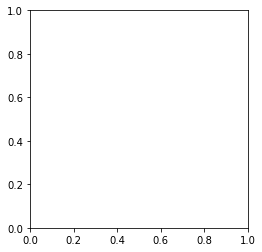

In [3]:
%matplotlib inline
#print(x)
#print(x[0][0])
fig = plt.figure()
ax = fig.add_subplot()
ax.set_aspect("equal")

ax.plot(x[0][0],x[0][1], linestyle = " ", marker = 'o')
#ax.plot(y[0][0],y[0][1], linestyle = " ", marker = 'o')
#ax.plot(damping_posx,damping_posy, linestyle=" ", marker = 'o')
ma_posx = [-8.80378877e-14, -2.00400157e-05,  2.00400157e-05,  2.45180411e-05,
  2.00400157e-05, -9.47046622e-14, -2.45180410e-05, -5.06892235e-14,
 -7.51007479e-16, -2.00400156e-05]
ma_posy = [9.16801357e-06,  2.01849643e-05,
  2.01849644e-05, -3.33118772e-14, -2.01849643e-05, -9.16801358e-06,
 -6.91825536e-14,  3.07232821e-05, -3.07232821e-05, -2.01849643e-05]
'''
ma_posx = [ 2.16590847e-05, -1.10634446e-14,  1.83461140e-05,  1.83461144e-05,
  5.10386767e-14, -2.16590846e-05, -1.83461142e-05, -3.06914933e-13,
  2.28942098e-13, -1.83461141e-05]
ma_posy = [ 2.72398038e-13,  1.00840949e-05,  2.19188450e-05, -2.19188446e-05,
 -1.00840947e-05, -2.21720323e-13,  2.19188445e-05,  3.47620657e-05,
 -3.47620659e-05, -2.19188450e-05]
'''
ax.plot(ma_posx,ma_posy, linestyle = " ", marker = 'x')

In [107]:
x_tot = x[2]
#x_tot = np.append(x[2], x1[2], axis=0)
#x_tot = np.append(x_tot, x2[2], axis=0)
#x_tot = np.append(x_tot, x3[2], axis=0)
#x_tot = np.append(x_tot, x4[2], axis=0)
#x_tot = np.append(x_tot, x5[2], axis=0)

In [118]:
#Rotating frame animation
from matplotlib.animation import FuncAnimation

class animate:
    def __init__(self,posall,units=1e6, title = "Title"):
        max_slices = 10**5
        len_slices = np.size(posall[:,0,0])
        if len_slices<max_slices: 
            sl=len_slices
        else: 
            sl=max_slices
        
        self.posall = posall


        self.x = []
        self.y = []

        self.positions1 = self.posall*units


        self.figure, self.ax = plt.subplots(figsize=(10,10))
        self.lim = np.max(np.abs(posall[0,:,:]*units))*0.8
        self.points1, = self.ax.plot(self.x, self.y
                                    ,'bo'
                                    ,zorder=2
                                    ,label='Particle'
                                    ,markersize=2)
        self.lines1, = self.ax.plot(self.x, self.y
                ,'ro'
                ,zorder=1
                ,label='Trail'
                ,markersize=0.1)
        self.ax.legend()
        plt.title(title)
        self.ax.set_xlabel(r'x [$\mu m$]')
        self.ax.set_ylabel(r'y [$\mu m$]')
        self.ax.set_aspect(1)

    def func_animate(self,frame_number,skip=1,tail=10**3,dots_every=1):
        self.ax.set_ylim((-self.lim,self.lim))
        self.ax.set_xlim((-self.lim,self.lim))
        x1 = self.positions1[frame_number*skip,0,:]
        y1 = self.positions1[frame_number*skip,1,:]
        if frame_number*skip-tail >= 0:
            index = np.arange(frame_number*skip-tail,
                                frame_number*skip,
                                dots_every)
            linex1=self.positions1[index,0,:]
            liney1=self.positions1[index,1,:]
        else:
            index = np.arange(0,frame_number*skip,dots_every)
            linex1=self.positions1[index,0,:]
            liney1=self.positions1[index,1,:]

        thetime = 1e-8*float(frame_number*skip)/1e-6
        #self.ax.annotate(r"Time =%1.0f[$\mu s$]" %thetime, xy=(0.1, 0.04),\
        #            xycoords='axes fraction',size=10,\
        #            bbox=dict(boxstyle='round', fc='w'))
        self.points1.set_data(x1,y1)
        self.lines1.set_data(linex1,liney1)

<IPython.core.display.Javascript object>


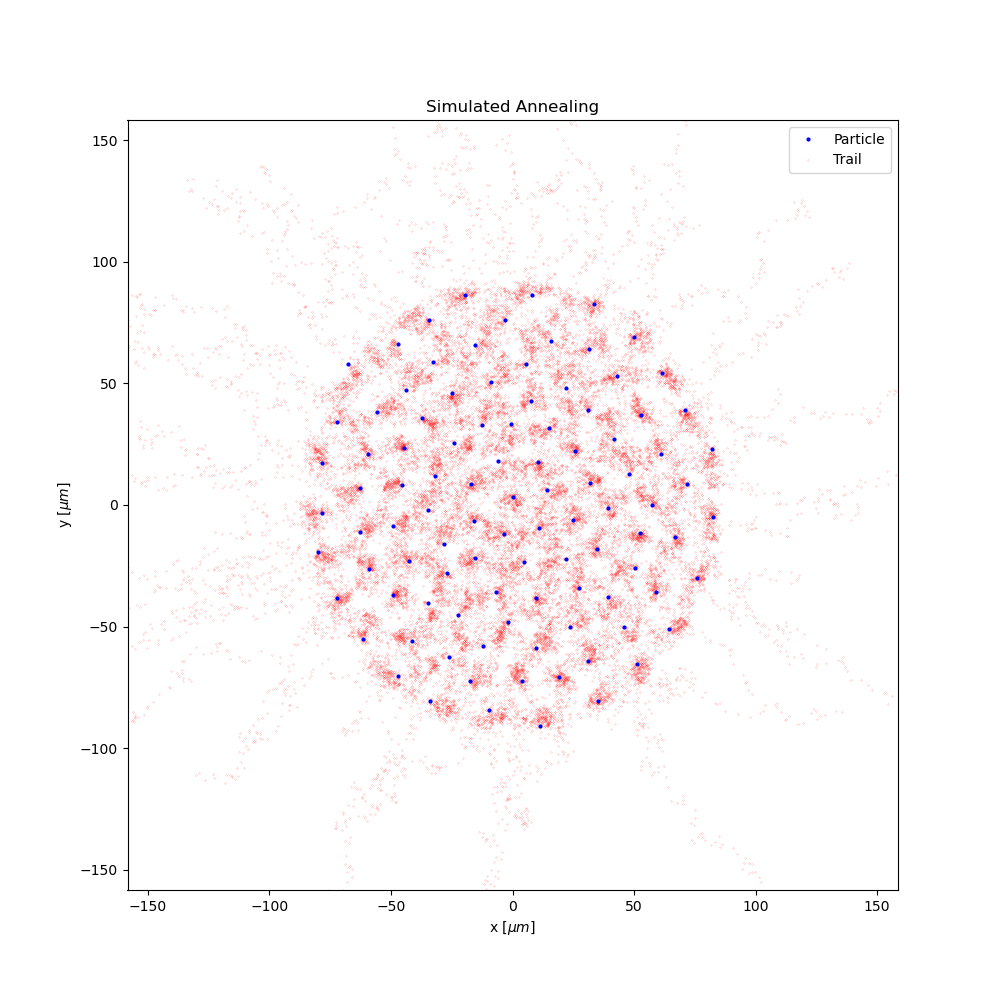

IndexError: index 1438 is out of bounds for axis 0 with size 1438

In [119]:
%matplotlib notebook
from matplotlib.animation import FFMpegWriter
    
#rot_anim = animate(load_pos_rot2D, title = "Rotating frame movie")
rot_anim = animate(x_tot[:,:2,:], title = "Simulated Annealing")

#for i in range(1000):
#    this_anim.func_animate(i)
#ani_rot = FuncAnimation(
#    rot_anim.figure, rot_anim.func_animate, interval=1, save_count = 100, repeat = False)
ani_rot = FuncAnimation(
    rot_anim.figure, rot_anim.func_animate, frames =100000, interval=10)
writervideo = FFMpegWriter(fps=60)
ani_rot.save('sim_annealing_100i.mp4', writer=writervideo)

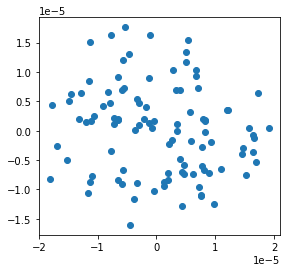

In [151]:
fig = plt.figure()
ax = fig.add_subplot()
ax.set_aspect("equal")
plt.plot(start_pos[0],start_pos[1], linestyle = " ", marker = 'o')

In [127]:
np.savetxt("100i_2D_annealing_x_beta1.csv", x_tot[:,0,:], delimiter=",")
np.savetxt("100i_2D_annealing_y_beta1.csv", x_tot[:,1,:], delimiter=",")
#np.savetxt("100i_2D_annealing_z_beta1.csv", x_tot[:,2,:], delimiter=",")

In [393]:
print(pot_en(np.array([ma_posx,ma_posy])))
print(pot_en(np.array([x[0][0],x[0][1]])))

4.968634332125927e-22
4.969099177507973e-22


In [158]:
x = simulated_annealing(pot_en, 100, 2000,10**-7,10**-25)

>0 f([[-1.06118325e-05 -1.23295597e-06  4.42593009e-06  6.28922359e-06
   8.99969255e-06 -5.42478217e-06 -6.44205239e-06  1.72350131e-05
   2.57411275e-06  7.52778501e-06 -1.14398724e-06 -2.94257681e-06
   7.81766622e-06  7.73173512e-06  5.07464268e-06 -1.13543895e-05
  -1.35879389e-06  1.69842586e-05 -4.67142840e-06  9.75199972e-06
  -7.14112415e-07  5.66891889e-06  4.75708937e-06 -7.67128536e-06
   2.06711151e-06 -3.55945296e-06  7.20974466e-06  5.02747480e-06
  -1.13226086e-05 -6.52978748e-06 -1.49268222e-05  1.56762259e-05
  -5.64937370e-06 -2.96740946e-06 -5.46779725e-06 -4.54038718e-07
   1.08957877e-05 -1.09852119e-05  5.81414085e-06  7.65298573e-06
  -1.77794044e-05 -1.76241971e-06 -1.17015219e-05 -1.15962114e-05
  -3.41318333e-06  1.64716080e-05  1.45552956e-05  3.96197140e-06
   3.40743913e-06 -5.90682059e-06  8.28010139e-06  1.64972642e-05
   1.63747015e-05 -1.68825753e-05  2.04517637e-06 -6.49084098e-06
   1.46687856e-05  4.27132407e-06  1.21182352e-05  7.05013550e-06
  -5.

C:\Users\jzari\Anaconda3\lib\site-packages\ipykernel_launcher.py:27: RuntimeWarning: overflow encountered in exp


>8 f([[-1.06695473e-05 -1.15661811e-06  4.43389897e-06  6.29715557e-06
   8.99256952e-06 -5.41809117e-06 -6.47024772e-06  1.72445024e-05
   2.54915758e-06  7.61231205e-06 -1.09777527e-06 -2.91761225e-06
   7.85795982e-06  7.74746212e-06  5.03625649e-06 -1.12842169e-05
  -1.33848786e-06  1.70371819e-05 -4.63751433e-06  9.77597415e-06
  -7.27616708e-07  5.65292973e-06  4.69027720e-06 -7.72443731e-06
   2.06262444e-06 -3.60353864e-06  7.21263098e-06  5.01342835e-06
  -1.14086789e-05 -6.57076640e-06 -1.49128637e-05  1.57340278e-05
  -5.65180463e-06 -2.94609998e-06 -5.42937000e-06 -4.32696879e-07
   1.08944957e-05 -1.09505581e-05  5.82581891e-06  7.64718154e-06
  -1.78242209e-05 -1.81854827e-06 -1.17745464e-05 -1.16549507e-05
  -3.47298263e-06  1.64698790e-05  1.44909603e-05  4.01379917e-06
   3.40694418e-06 -5.91278345e-06  8.32841913e-06  1.64877198e-05
   1.64537299e-05 -1.68180858e-05  2.04118643e-06 -6.45026485e-06
   1.46673853e-05  4.31198443e-06  1.21573869e-05  7.03036358e-06
  -5.

<IPython.core.display.Javascript object>


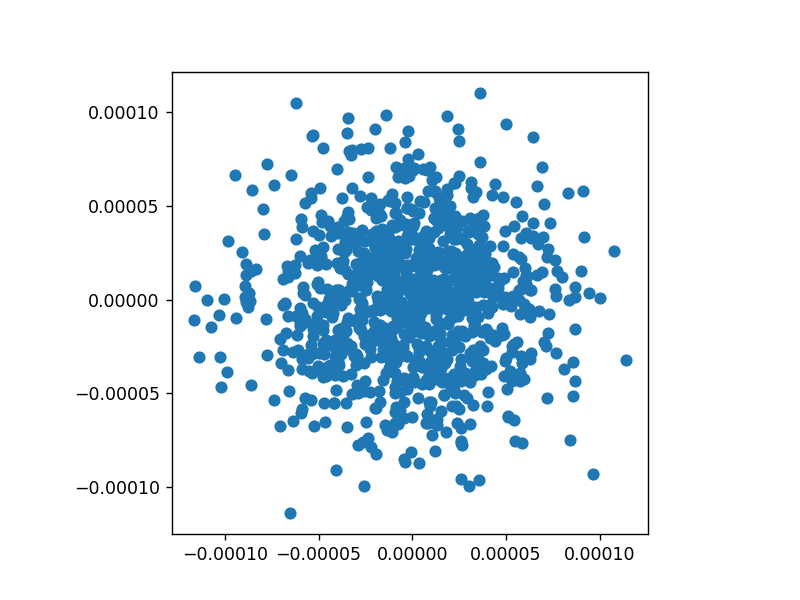

In [51]:
fig = plt.figure()
ax = fig.add_subplot()
ax.set_aspect("equal")
ax.plot(x3[0][0],x3[0][1], linestyle = " ", marker = 'o')

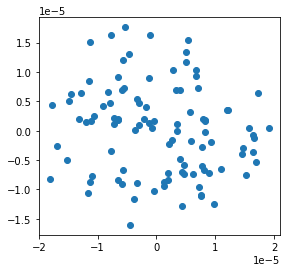

In [162]:
fig = plt.figure()
ax = fig.add_subplot()
ax.set_aspect("equal")
ax.plot(start_pos[0,:],start_pos[1,:], linestyle = " ", marker = 'o')

In [396]:
0.9999**10000

0.36786104643297046

In [2]:
#initialize positions

#ma_posx = [-8.80378877e-14, -2.00400157e-05,  2.00400157e-05,  2.45180411e-05,
#  2.00400157e-05, -9.47046622e-14, -2.45180410e-05, -5.06892235e-14,
# -7.51007479e-16, -2.00400156e-05]
#ma_posy = [9.16801357e-06,  2.01849643e-05,
#  2.01849644e-05, -3.33118772e-14, -2.01849643e-05, -9.16801358e-06,
# -6.91825536e-14,  3.07232821e-05, -3.07232821e-05, -2.01849643e-05]

num_ions = 236
#rad = 2*10**-3 #ions uniformly distributed in sphere of this radius
rad = 8*10**-5 #test
vol = 4/3*np.pi*rad**3
start_pos_x = np.empty(num_ions)
start_pos_y = np.empty(num_ions)
start_pos_z = np.empty(num_ions)
for i in range(num_ions):
    this_vol = rand.random()*vol
    this_rad = (3/(4*np.pi)*this_vol)**(1/3)
    this_theta = rand.random()*np.pi
    qq = rand.random()
    this_theta = np.arccos(2.*qq-1.)
    this_phi = rand.random()*2*np.pi
    start_pos_x[i] = this_rad * np.sin(this_theta) * np.cos(this_phi)
    start_pos_y[i] = this_rad * np.sin(this_theta) * np.sin(this_phi)
    start_pos_z[i] = this_rad * np.cos(this_theta)
start_pos = np.array([start_pos_x,start_pos_y, start_pos_z])
#start_pos = np.array([ma_posx,ma_posy])
start_pos

array([[ 2.30682125e-05,  4.14853290e-05,  6.49340621e-05,
         7.34864554e-05,  7.69113831e-06,  4.70732707e-05,
        -4.78715466e-06,  4.77403123e-05,  4.74809089e-05,
         4.82821475e-06, -7.88694564e-06, -3.86151507e-05,
        -5.10327008e-07, -4.35647906e-05,  2.84838830e-05,
         1.49753330e-05, -7.31807546e-05,  3.36434637e-05,
         7.80143266e-06,  4.73957008e-05, -3.01590423e-05,
        -5.04552903e-05,  5.72308478e-05, -4.67489551e-05,
        -4.48617178e-05,  1.30361419e-06, -3.85815911e-05,
        -1.47535749e-05, -1.67523754e-05,  4.65851586e-05,
        -2.87661897e-05,  1.20044399e-05, -2.83913737e-06,
         2.04314954e-05,  6.45930599e-05,  3.36304189e-05,
         6.40246732e-06, -5.88877740e-05, -4.91192161e-05,
         4.16401776e-05,  9.77687413e-06,  4.45113533e-05,
        -2.35408219e-06, -7.17610359e-05, -2.10847633e-05,
         6.19682450e-06, -2.67660507e-05, -7.06614751e-06,
         1.75881659e-05,  1.24464990e-05, -1.10322409e-0

In [3]:
m = 9.012182*1.66057e-27
q = 1.602176597458587e-19
wz = 2*np.pi*1.58e6
wc = 4.4588*q/m
#wr = 180000*2*np.pi*20
wr = (wc-np.sqrt(wc**2-6*wz**2))/2
V0=(0.5 * m * wz**2) / q
Volt_w = 30
Volt_0 = V0 
delta = 1612.*Volt_w / Volt_0
Vw = 0.5*(m*wz**2/q)*delta
eps0 = 8.85418782*10**-12

def pot_eng_ax_pl_trap_3D(position):
    shape   = np.shape(position)
    dims,ions=shape
    x = position[0,:]
    y = position[1,:]
    z = position[2,:]
    pot_eng_ion = np.zeros((ions,2))
    #pot_eng_ion = np.zeros((ions,1))
    pot_eng_ion[:,0] = 0.5*m*wz**2*np.square(z)
    pot_eng_ion[:,1] += -0.5*m*(wr**2 - wr*wc + 0.5*wz**2) *(np.square(x)+np.square(y))
    pot_eng_ion[:,1] += q*Vw*(np.square(x)-np.square(y))
    return np.sum(pot_eng_ion)

def pot_eng_coul_3D(position):
    shape   = np.shape(position)
    dims,ions=shape
    x = position[0,:]
    y = position[1,:]
    z = position[2,:]
    pot_eng_ion = np.zeros(ions)
    for ion1 in range(ions):
        for ion2 in range(ions):
            if ion1!=ion2:
                dx = x[ion1] - x[ion2]
                dy = y[ion1] - y[ion2]
                dz = z[ion1] - z[ion2]
                r = np.sqrt(dx**2 + dy**2 + dz**2)
                #r = np.sqrt(dx**2 + dy**2)
                pot_eng_ion[ion1] += q**2/(4*np.pi*eps0*r)
    return np.sum(pot_eng_ion)/2

def pot_eng_coul_3D_fmm(position):
    shape   = np.shape(position)
    dims,ions=shape
    x = position[0,:]
    y = position[1,:]
    z = position[2,:]
    sources = np.array([x,y,z])
    charges = np.full(ions, 1.0)
    fmm_out = fmm.lfmm3d(eps=10**-5, sources=sources,charges=charges,dipvec=None,targets=None,pg=2,pgt=0,nd=1)
    #print(fmm_out.pot)
    Vc_tot = np.sum(fmm_out.pot) * q**2/(4*np.pi*eps0)
    return Vc_tot/2

    
def pot_en_3D(position):
    return pot_eng_ax_pl_trap_3D(position) + pot_eng_coul_3D(position)
#pot_en_3D(start_pos)
#print(pot_en_3D(start_pos))

def pot_en_3D_fmm(position):
    return pot_eng_ax_pl_trap_3D(position) + pot_eng_coul_3D_fmm(position)
#pot_en_3D_fmm(start_pos)

In [4]:
def simulated_annealing_3D(energy, start_pos, n_iterations, step_size, temp):
    # generate an initial point
    best = start_pos
    position_list = np.array([[]])
    # evaluate the initial point
    best_eval = energy(start_pos)
    energies = np.array([])
    #print(best_eval)
    # current working solution
    curr, curr_eval = best, best_eval
    # run the algorithm
    print(np.size(start_pos[0]))
    write_per = 10
    counter = 0
    position_list = np.array([start_pos])
    accept_inc =0
    accept_dec =0
    #position_list = np.append(position_list, start_pos, axis=0)
    for i in range(n_iterations):
    # take a step
        candidate = curr + (np.random.rand(3,np.size(start_pos[0]))-0.5) * step_size
        # evaluate candidate point
        candidate_eval = energy(candidate)
        #print(candidate_eval)
        # check for new best solution
        if candidate_eval < best_eval:
            # store new best point
            best, best_eval = candidate, candidate_eval
            counter+=1
            if counter % write_per == 0:
                position_list = np.append(position_list, [best], axis = 0)
            # report progress
            #print('>%d f(%s) = %.5f' % (i, best, best_eval))
        # difference between candidate and current point evaluation
        diff = candidate_eval - curr_eval
        # calculate temperature for current epoch
        #t = temp / float(i + 1)
        t=temp
        #t = temp*0.9999**i
        # calculate metropolis acceptance criterion
        metropolis = np.exp(-diff / t)
        # check if we should keep the new point
        if diff < 0 or rand.random() < metropolis:
            # store the new current point
            curr, curr_eval = candidate, candidate_eval
            energies = np.append(energies, candidate_eval)
            counter+=1
            if diff > 0:
                print("energy increase")
                accept_inc+=1
            if diff < 0:
                accept_dec+=1
                print("energy decrease")
            #if counter % write_per == 0:
            #    position_list = np.append(position_list, [curr], axis = 0)
    return [best, best_eval, position_list, curr, accept_dec, accept_inc, energies]

In [4]:
def simulated_annealing_3D(energy, start_pos, n_iterations, step_size, temp):
    # generate an initial point
    best = start_pos
    position_list = np.array([[]])
    # evaluate the initial point
    best_eval = energy(start_pos)
    energies = np.array([])
    #print(best_eval)
    # current working solution
    curr, curr_eval = best, best_eval
    # run the algorithm
    print(np.size(start_pos[0]))
    write_per = 10
    counter = 0
    position_list = np.array([start_pos])
    accept_inc =0
    accept_dec =0
    #position_list = np.append(position_list, start_pos, axis=0)
    for i in range(n_iterations):
    # take a step
        candidate = curr * abs(np.random.normal(1, step_size, size = best.shape))
        # evaluate candidate point
        candidate_eval = energy(candidate)
        #print(candidate_eval)
        # check for new best solution
        if candidate_eval < best_eval:
            # store new best point
            best, best_eval = candidate, candidate_eval
            counter+=1
            if counter % write_per == 0:
                position_list = np.append(position_list, [best], axis = 0)
            # report progress
            #print('>%d f(%s) = %.5f' % (i, best, best_eval))
        # difference between candidate and current point evaluation
        diff = candidate_eval - curr_eval
        # calculate temperature for current epoch
        #t = temp / float(i + 1)
        t=temp
        #t = temp*0.9999**i
        # calculate metropolis acceptance criterion
        metropolis = np.exp(-diff / t)
        # check if we should keep the new point
        if diff < 0 or rand.random() < metropolis:
            # store the new current point
            curr, curr_eval = candidate, candidate_eval
            energies = np.append(energies, candidate_eval)
            counter+=1
            if diff > 0:
                print("energy increase")
                accept_inc+=1
            if diff < 0:
                accept_dec+=1
                print("energy decrease")
            #if counter % write_per == 0:
            #    position_list = np.append(position_list, [curr], axis = 0)
    return [best, best_eval, position_list, curr, accept_dec, accept_inc, energies]

In [35]:
def simulated_annealing_3D(energy, start_pos, n_iterations, refinement, step_size, temp):
    # generate an initial point
    best = start_pos
    position_list = np.array([[]])
    # evaluate the initial point
    best_eval = energy(start_pos)
    #print(best_eval)
    # current working solution
    curr, curr_eval = best, best_eval
    # run the algorithm
    print(np.size(start_pos[0]))
    update_history = np.zeros(refinement)
    #counter_lower_en = 0
    write_per = 10
    counter = 0
    position_list = np.array([start_pos])
    #position_list = np.append(position_list, start_pos, axis=0)
    for i in range(n_iterations):
    # take a step
        if i > 1 and i%refinement ==0:
            lower = refinement/2 - 0.5*refinement/2
            if np.sum(update_history) < lower:
                step_size = step_size*0.9
            upper = refinement/2 - 0.3*refinement/2
            if np.sum(update_history) > upper:
                temp = temp*0.98
            counter_lower_en = 0
        candidate = curr + (np.random.rand(3,np.size(start_pos[0]))-0.5) * step_size
        # evaluate candidate point
        candidate_eval = energy(candidate)
        #print(candidate_eval)
        # check for new best solution
        if candidate_eval < best_eval:
            #update_history[i%refinement] = 1
            # store new best point
            best, best_eval = candidate, candidate_eval
            counter+=1
            #counter_lower_en+=1
            if counter % write_per == 0:
                position_list = np.append(position_list, [best], axis = 0)
            # report progress
            print('>%d f(%s) = %.5f' % (i, best, best_eval))
        #else:
            #update_history[i%refinement] = 0
        # difference between candidate and current point evaluation
        diff = candidate_eval - curr_eval
        # calculate temperature for current epoch
        #t = temp / float(i + 1)
        #t=temp
        #t = temp*0.9999**i
        # calculate metropolis acceptance criterion
        metropolis = np.exp(-diff / temp)
        # check if we should keep the new point
        if diff < 0 or rand.random() < metropolis:
            # store the new current point
            update_history[i%refinement] = 1
            curr, curr_eval = candidate, candidate_eval
            counter+=1
            if diff > 0:
                print("energy increase")
            #if counter % write_per == 0:
            #    position_list = np.append(position_list, [curr], axis = 0)
        else:
            update_history[i%refinement] = 0
    return [best, best_eval, position_list]

In [6]:
def simulated_annealing_3D(energy, start_pos, n_iterations, step_size, temp):
    # generate an initial point
    best = start_pos
    position_list = np.array([[]])
    # evaluate the initial point
    best_eval = energy(start_pos)
    #print(best_eval)
    # current working solution
    curr, curr_eval = best, best_eval
    # run the algorithm
    print(np.size(start_pos[0]))
    write_per = 1
    counter = 0
    position_list = np.array([start_pos])
    n_ions = np.shape(start_pos)[1]
    #position_list = np.append(position_list, start_pos, axis=0)
    for i in range(n_iterations):
    # take a step
        for j in range(n_ions):
            candidate = curr 
            candidate[0,j] += (np.random.rand()-0.5) * step_size
            candidate[1,j] += (np.random.rand()-0.5) * step_size
            candidate[2,j] += (np.random.rand()-0.5) * step_size
            # evaluate candidate point
            candidate_eval = energy(candidate)
            #print(candidate_eval)
            # check for new best solution
            if candidate_eval < best_eval:
                # store new best point
                best, best_eval = candidate, candidate_eval
                counter+=1
                if counter % write_per == 0:
                    position_list = np.append(position_list, [best], axis = 0)
                # report progress
                print('>%d f(%s) = %.5f' % (i, best, best_eval))
            # difference between candidate and current point evaluation
            diff = candidate_eval - curr_eval
            # calculate temperature for current epoch
            t = temp / float(i + 1)
            #t = temp*0.9999**i
            # calculate metropolis acceptance criterion
            metropolis = np.exp(-diff / t)
            # check if we should keep the new point
            if diff < 0 or rand.random() < metropolis:
                # store the new current point
                curr, curr_eval = candidate, candidate_eval
                counter+=1
                if diff > 0:
                    print("energy increase")
                #if counter % write_per == 0:
                #    position_list = np.append(position_list, [curr], axis = 0)
    return [best, best_eval, position_list]

In [12]:
#x = simulated_annealing_3D(pot_en_3D_fmm, start_pos, 100000, 100, 10**-6,10**-23)
x = simulated_annealing_3D(pot_en_3D_fmm, start_pos, 10000,1*10**-13,10**-36)
#x = simulated_annealing_3D(pot_en_3D_fmm, start_pos, 1000, 0.05,10**-21)

236
energy decrease


0 1
55
3.383251615568358e-19


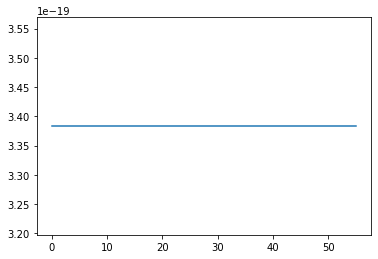

In [13]:
%matplotlib inline
print(x[-2], x[-3])
plt.plot(np.linspace(0,x[-1].size,x[-1].size), x[-1])
print(x[-1].size)
print(x[1])
#plt.ylim(3.35,3.45)

In [84]:
#x1 = simulated_annealing_3D(pot_en_3D_fmm, x[3], 10000,3*10**-6,5*10**-22)
x1 = simulated_annealing_3D(pot_en_3D_fmm, x[0], 1500,0.02,1*10**-22)

236
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
ener

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy d

312 465
777


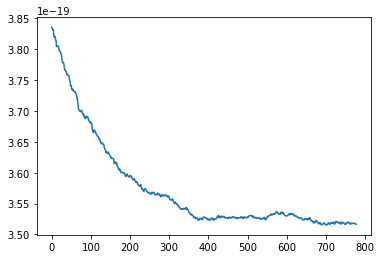

In [85]:
print(x1[-2],x1[-3])
plt.plot(np.linspace(0,x1[-1].size,x1[-1].size), x1[-1])
print(x1[-1].size)

In [104]:
#x2 = simulated_annealing_3D(pot_en_3D_fmm, x1[3], 10000,2*10**-6,2.5*10**-22)
x2 = simulated_annealing_3D(pot_en_3D_fmm, x1[3], 10000,0.01,1*10**-23)

236
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
ener

energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy i

energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy d

1585 2023
3608


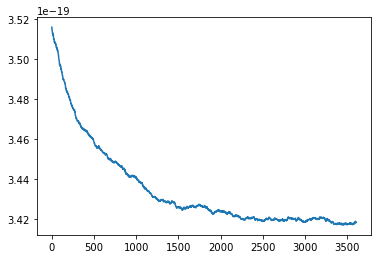

In [105]:
print(x2[-2],x2[-3])
plt.plot(np.linspace(0,x2[-1].size,x2[-1].size), x2[-1])
print(x2[-1].size)

In [119]:
#x3 = simulated_annealing_3D(pot_en_3D_fmm, x2[3], 10000,1.3*10**-6,10**-22)
x3 = simulated_annealing_3D(pot_en_3D_fmm, x2[3], 30000,0.005,1*10**-24)

236
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
ener

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy i

energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy i

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy d

energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy i

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

2620 3521
6141


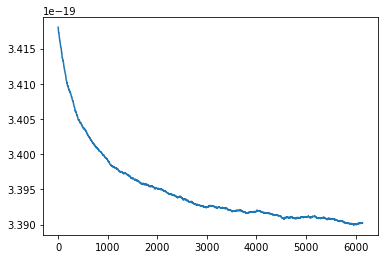

In [120]:
print(x3[-2],x3[-3])
plt.plot(np.linspace(0,x3[-1].size,x3[-1].size), x3[-1])
print(x3[-1].size)

In [136]:
#x4 = simulated_annealing_3D(pot_en_3D_fmm, x3[3], 10000,1*10**-6,5*10**-23)
x4 = simulated_annealing_3D(pot_en_3D_fmm, x3[3], 300000,0.0025,1*10**-25)

236
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
ener

energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy i

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy i

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy d

energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy d

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy i

energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy d

energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy i

energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy d

energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy i

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy i

energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy d

energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy i

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy d

energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy d

energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy d

8122 9647
17769


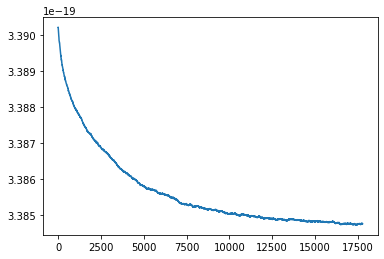

In [137]:
print(x4[-2],x4[-3])
plt.plot(np.linspace(0,x4[-1].size,x4[-1].size), x4[-1])
print(x4[-1].size)

In [148]:
#x5 = simulated_annealing_3D(pot_en_3D_fmm, x4[3], 10000,5*10**-7,2*10**-23)
x5 = simulated_annealing_3D(pot_en_3D_fmm, x4[3], 200000,0.001,2*10**-26)

236
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
ener

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy d

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy d

energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy d

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy d

energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy i

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy d

8041 8897
16938


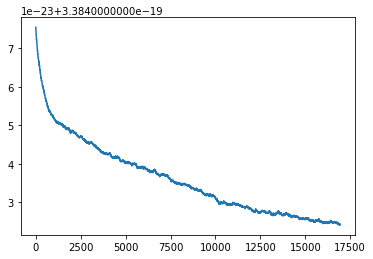

In [149]:
print(x5[-2],x5[-3])
plt.plot(np.linspace(0,x5[-1].size,x5[-1].size), x5[-1])
print(x5[-1].size)

In [152]:
#x6 = simulated_annealing_3D(pot_en_3D_fmm, x5[3], 30000,2*10**-7,8*10**-24)
x6 = simulated_annealing_3D(pot_en_3D_fmm, x5[3], 5000,0.0005,1*10**-26)

236
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
ener

energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy d

550 647
1197


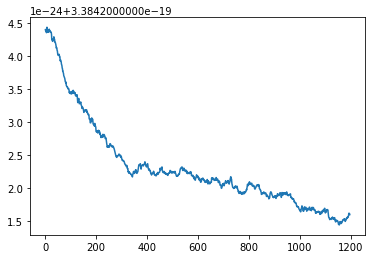

In [153]:
print(x6[-2],x6[-3])
plt.plot(np.linspace(0,x6[-1].size,x6[-1].size), x6[-1])
print(x6[-1].size)

In [104]:
#x7 = simulated_annealing_3D(pot_en_3D_fmm, x6[3], 20000,1*10**-7,3*10**-25)
x7 = simulated_annealing_3D(pot_en_3D_fmm, x6[3], 30000,0.001,2*10**-25)

236
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
ener

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy d

energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy d

energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy d

energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy i

energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy i

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy i

energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy i

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy d

energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy i

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy d

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy d

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy i

8222 8678
16900


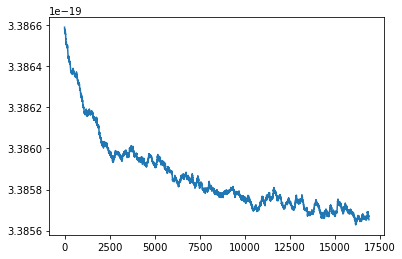

In [105]:
print(x7[-2],x7[-3])
plt.plot(np.linspace(0,x7[-1].size,x7[-1].size), x7[-1])
print(x7[-1].size)

In [106]:
#x8 = simulated_annealing_3D(pot_en_3D_fmm, x7[3], 100000,5*10**-8,3*10**-26)
x8 = simulated_annealing_3D(pot_en_3D_fmm, x7[3], 30000,0.001,2*10**-25)

236
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
ener

energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy d

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy i

energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy i

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy i

energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy d

energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy i

energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy d

energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

8605 8759
17364


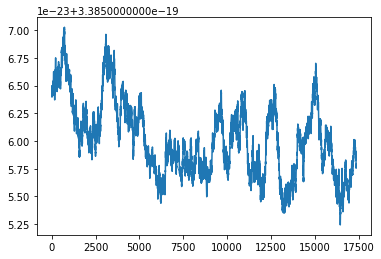

In [107]:
print(x8[-2],x8[-3])
plt.plot(np.linspace(0,x8[-1].size,x8[-1].size), x8[-1])
print(x8[-1].size)

In [113]:
#x9 = simulated_annealing_3D(pot_en_3D_fmm, x8[3], 10000,1.5*10**-8,6*10**-27)
x9 = simulated_annealing_3D(pot_en_3D_fmm, x8[3], 50000,0.0005,6*10**-26)

236
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
ener

energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy d

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy d

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy i

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy i

energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy d

energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy d

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy i

energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy i

energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy i

energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy d

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy d

energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy d

energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy i

energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy d

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy d

energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy d

energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy i

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy i

energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease


14615 15492
30107


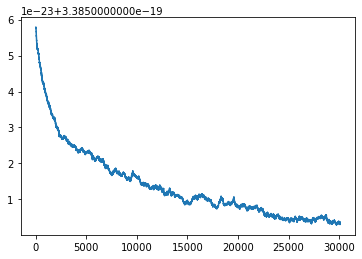

In [114]:
print(x9[-2],x9[-3])
plt.plot(np.linspace(0,x9[-1].size,x9[-1].size), x9[-1])
print(x9[-1].size)

In [488]:
x10 = simulated_annealing_3D(pot_en_3D_fmm, x9[3], 100000,5*10**-9,3*10**-28)

236
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
ener

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy d

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy i

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy d

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy d

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy i

energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

7974 16606
24580


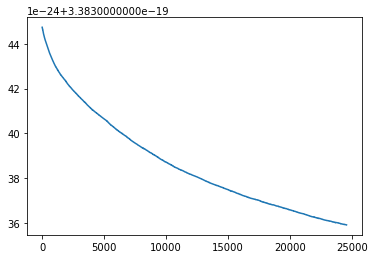

In [489]:
print(x10[-2],x10[-3])
plt.plot(np.linspace(0,x10[-1].size,x10[-1].size), x10[-1])
print(x10[-1].size)

In [490]:
x11 = simulated_annealing_3D(pot_en_3D_fmm, x10[3], 100000,5*10**-9,3*10**-28)

236
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
ener

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy d

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy d

energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy d

energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy i

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy i

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy d

8430 14478
22908


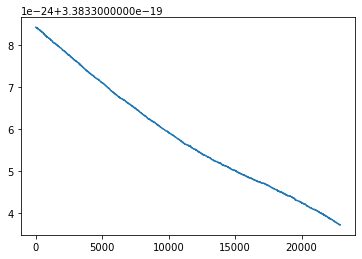

In [405]:
print(x11[-2],x11[-3])
plt.plot(np.linspace(0,x11[-1].size,x11[-1].size), x11[-1])
print(x11[-1].size)

In [406]:
x12 = simulated_annealing_3D(pot_en_3D_fmm, x11[0], 200000,5*10**-9,3*10**-28)

236
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
ener

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy d

energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy d

energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy i

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy d

energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy i

energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy d

energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy d

energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy i

energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy d

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy i

energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy d

energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy d

energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy d

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy d

energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy i

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy i

17444 22934
40378


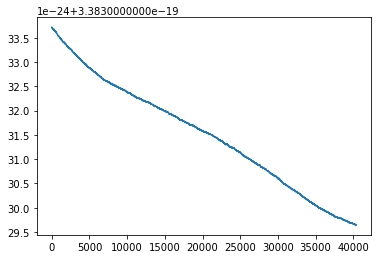

In [407]:
print(x12[-2],x12[-3])
plt.plot(np.linspace(0,x12[-1].size,x12[-1].size), x12[-1])
print(x12[-1].size)

In [416]:
x13 = simulated_annealing_3D(pot_en_3D_fmm, x12[0], 200000,5*10**-9,3*10**-28)

236
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
ener

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy d

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy i

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy i

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy d

energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy d

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy d

energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy i

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy i

energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy i

energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy d

energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy i

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy d

energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy i

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy d

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy i

energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy i

energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy d

energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy d

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy d

energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy i

energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy d

energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy i

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy d

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy i

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy i

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy i

17899 18869
36768


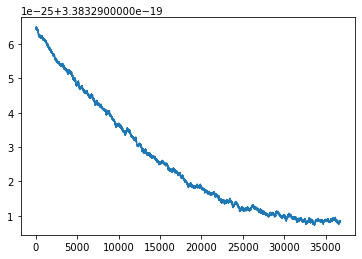

In [417]:
print(x13[-2],x13[-3])
plt.plot(np.linspace(0,x13[-1].size,x13[-1].size), x13[-1])
print(x13[-1].size)

In [423]:
x14 = simulated_annealing_3D(pot_en_3D_fmm, x13[0], 30000,2*10**-9,6*10**-29)

236
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
ener

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy d

energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy d

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy i

energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy i

3354 3830
7184


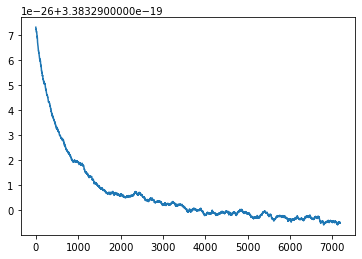

In [424]:
print(x14[-2],x14[-3])
plt.plot(np.linspace(0,x14[-1].size,x14[-1].size), x14[-1])
print(x14[-1].size)

In [430]:
x15 = simulated_annealing_3D(pot_en_3D_fmm, x14[0], 60000,1*10**-9,1*10**-29)

236
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
ener

energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy i

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy d

energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy d

energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy i

energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy d

energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy d

energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy i

energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy i

energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy d

energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy i

energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy decrease
energy decrease
energy increase
energy decrease
energy increase
energy increase
energy increase
energy decrease
energy increase
energy increase
energy increase
energy increase
energy decrease
energy increase
energy decrease
energy decrease
energy increase
energy decrease
energy d

4239 5255
9494


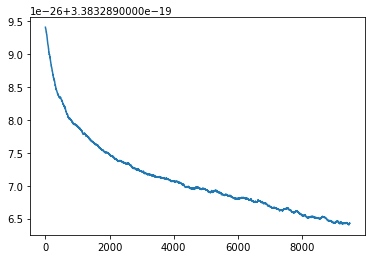

In [431]:
print(x15[-2],x15[-3])
plt.plot(np.linspace(0,x15[-1].size,x15[-1].size), x15[-1])
print(x15[-1].size)

In [432]:
'''
print(x[2].shape)
print(x1[2].shape)
print(x2[2].shape)
print(x3[2].shape)
print(x4[2].shape)
print(x5[2].shape)
print(x6[2].shape)
print(x7[2].shape)
print(x8[2].shape)
print(x9[2].shape)
print(x10[2].shape)
print(x11[2].shape)
print(x12[2].shape)
'''
x_tot = x[2]
#x_tot = np.append(x_tot, x[2], axis=0)
x_tot = np.append(x_tot, x1[2], axis=0)
x_tot = np.append(x_tot, x2[2], axis=0)
x_tot = np.append(x_tot, x3[2], axis=0)

x_tot = np.append(x_tot, x4[2], axis=0)
x_tot = np.append(x_tot, x5[2], axis=0)
x_tot = np.append(x_tot, x6[2], axis=0)
x_tot = np.append(x_tot, x7[2], axis=0)
x_tot = np.append(x_tot, x8[2], axis=0)

x_tot = np.append(x_tot, x9[2], axis=0)
x_tot = np.append(x_tot, x10[2], axis=0)
x_tot = np.append(x_tot, x11[2], axis=0)
x_tot = np.append(x_tot, x12[2], axis=0)
x_tot = np.append(x_tot, x13[2], axis=0)
x_tot = np.append(x_tot, x14[2], axis=0)
x_tot = np.append(x_tot, x15[2], axis=0)
#x_tot.shape


In [433]:
en = np.concatenate([x1[-1],x2[-1],x3[-1],x4[-1],x5[-1],x6[-1],x7[-1],x8[-1],x9[-1],x10[-1],x11[-1],x12[-1],x13[-1],x14[-1],x15[-1]])


(array([1.e-32, 1.e-30, 1.e-28, 1.e-26, 1.e-24, 1.e-22, 1.e-20, 1.e-18,
        1.e-16]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

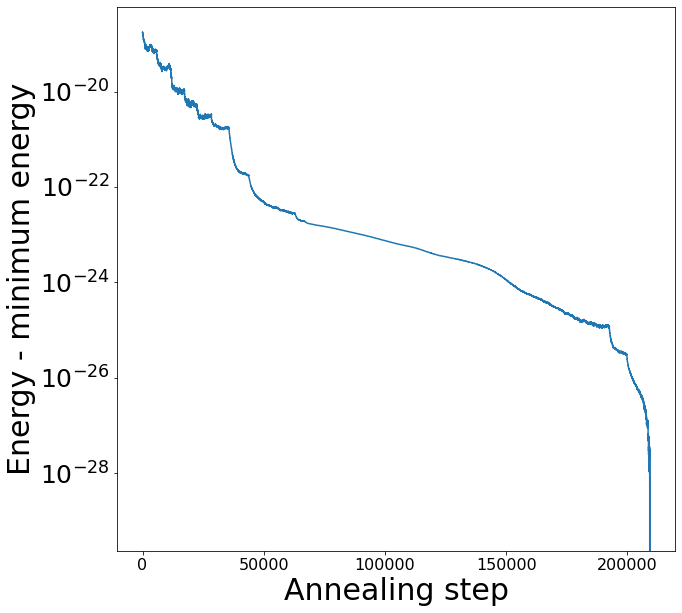

In [441]:
fig, ax = plt.subplots(figsize = (10,10))
plt.plot(np.linspace(0,en.size,en.size),en-np.amin(en))
ax.set_yscale('log')
ax.set_xlabel('Annealing step', fontsize=30)
ax.set_ylabel('Energy - minimum energy', fontsize=30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=25)

In [434]:
np.amin(en)

3.38328964045937e-19

In [459]:
#x_tot = x[2]
np.savetxt("236i_annealing_x.csv", x_tot[:,0,:], delimiter=",")
np.savetxt("236i_annealing_y.csv", x_tot[:,1,:], delimiter=",")
np.savetxt("236i_annealing_z.csv", x_tot[:,2,:], delimiter=",")

In [2]:
load_x = np.loadtxt("236i_ma_min_x.csv", delimiter=',')
load_y = np.loadtxt("236i_ma_min_y.csv", delimiter=',')
load_z = np.loadtxt("236i_ma_min_z.csv", delimiter=',')
start_pos = np.array([load_x,load_y,load_z])

In [23]:
x = simulated_annealing_3D(pot_en_3D, start_pos[-1], 5000,5*10**-6,10**-19)

500
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
ener

In [24]:
x1 = simulated_annealing_3D(pot_en_3D, x[0], 500,10**-6,10**-21)

500
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
energy increase
>40 f([[-1.67371635e-04  6.24646026e-05 -8.91600689e-05 ... -1.66908108e-05
   8.15481558e-05  5.19355372e-05]
 [ 1.18820802e-05 -2.87227676e-05  1.39605676e-05 ...  3.59681018e-05
   7.32242834e-05 -1.01398121e-05]
 [ 9.45583606e-06  1.74204107e-05 -1.19581123e-05 ... -2.77209169e-05
  -1.44557987e-05  5.91281779e-06]]) = 0.00000
>42 f([[-1.67676736e-04  6.21905464e-05 -8.95285807e-05 ... -1.71310501e-05
   8.18772997e-05  5.17138844e-05]
 [ 1.14018520e-05 -2.87227509e-05  1.35603738e-05 ...  3.64476963e-05
   7.27441547e-05 -1.01819711e-05]
 [ 9.02950684e-06  1.70629125e-05 -1.21595181e-05 ... -2.80957733e-05
  -1.46867070e-05  6.22789928e-06]]) = 0.00000
energy increase
>48 f([[-1.68095171e-04  6.25626213e-05 -8.87177625e-05 ... -1.72161937e-05
   8.19705965e-05  5.18494825e-05]
 [ 1.189973

In [25]:
x2 = simulated_annealing_3D(pot_en_3D, x1[0], 500,10**-6,10**-22)

500
energy increase
energy increase
energy increase
energy increase
>15 f([[-1.65610950e-04  6.52574115e-05 -8.96253865e-05 ... -1.69999742e-05
   8.45606935e-05  5.42690849e-05]
 [ 1.08747258e-05 -2.92227229e-05  1.47838548e-05 ...  4.30490068e-05
   6.96345033e-05 -1.16978098e-05]
 [ 5.88795647e-06  1.45596912e-05 -5.76716460e-06 ... -2.22816239e-05
  -1.81572430e-05  7.12188953e-06]]) = 0.00000
>18 f([[-1.66108293e-04  6.53980797e-05 -8.97675465e-05 ... -1.72206319e-05
   8.40988997e-05  5.41861359e-05]
 [ 1.12653865e-05 -2.90521725e-05  1.47938199e-05 ...  4.31066029e-05
   6.93899736e-05 -1.21191594e-05]
 [ 6.17020425e-06  1.44173904e-05 -5.61814053e-06 ... -2.21973594e-05
  -1.79744097e-05  7.60203308e-06]]) = 0.00000
>20 f([[-1.66279186e-04  6.56262621e-05 -8.96003634e-05 ... -1.71120458e-05
   8.41969423e-05  5.37205043e-05]
 [ 1.17390493e-05 -2.89627064e-05  1.46499095e-05 ...  4.30663798e-05
   6.92086738e-05 -1.20764067e-05]
 [ 6.54520699e-06  1.39505447e-05 -5.21270814e-06 

In [26]:
x3 = simulated_annealing_3D(pot_en_3D, x2[0], 500,10**-6,10**-23)

500
>3 f([[-1.65078466e-04  6.79884926e-05 -9.00259401e-05 ... -1.37236242e-05
   8.48980630e-05  5.71655856e-05]
 [ 7.77371244e-06 -2.47960127e-05  1.89385641e-05 ...  4.18283816e-05
   7.51337795e-05 -1.26140285e-05]
 [ 1.01393351e-05  1.12262949e-05 -2.35435810e-06 ... -1.99798920e-05
  -1.00765308e-05  5.17146112e-06]]) = 0.00000
>4 f([[-1.64742874e-04  6.82663966e-05 -9.01007264e-05 ... -1.37106025e-05
   8.47597638e-05  5.66809117e-05]
 [ 7.46829082e-06 -2.49767117e-05  1.88152904e-05 ...  4.19600681e-05
   7.52572046e-05 -1.29539793e-05]
 [ 1.02149623e-05  1.08909749e-05 -2.09382164e-06 ... -2.01922327e-05
  -9.95798480e-06  4.78962062e-06]]) = 0.00000
>6 f([[-1.64893071e-04  6.84953642e-05 -8.97129345e-05 ... -1.36088428e-05
   8.50772840e-05  5.63055994e-05]
 [ 7.05658967e-06 -2.49811344e-05  1.91889495e-05 ...  4.21634980e-05
   7.47661019e-05 -1.32646797e-05]
 [ 9.80221375e-06  1.08222395e-05 -2.27236095e-06 ... -2.00235834e-05
  -9.48208712e-06  5.25738232e-06]]) = 0.00000


C:\Users\jzari\Anaconda3\lib\site-packages\ipykernel_launcher.py:37: RuntimeWarning: overflow encountered in exp


>100 f([[-1.66405296e-04  6.98507990e-05 -8.97795465e-05 ... -1.42045126e-05
   8.57736996e-05  5.78064859e-05]
 [ 8.67279292e-06 -2.58077126e-05  2.03452254e-05 ...  4.29963643e-05
   7.43323368e-05 -1.65808229e-05]
 [ 7.49911809e-06  1.24284533e-05 -2.71211700e-06 ... -1.75751462e-05
  -7.80783432e-06  3.30779219e-06]]) = 0.00000
>101 f([[-1.66364976e-04  6.94114250e-05 -8.98203667e-05 ... -1.38860254e-05
   8.56006267e-05  5.78966719e-05]
 [ 8.24461465e-06 -2.61511077e-05  2.03311463e-05 ...  4.26115728e-05
   7.47654263e-05 -1.70770137e-05]
 [ 7.73497903e-06  1.21818426e-05 -2.32446841e-06 ... -1.73770354e-05
  -8.06030009e-06  3.70837636e-06]]) = 0.00000
>104 f([[-1.66482858e-04  6.94224422e-05 -8.96294900e-05 ... -1.41488946e-05
   8.60055302e-05  5.81525851e-05]
 [ 7.88688814e-06 -2.65707853e-05  1.98839652e-05 ...  4.24919619e-05
   7.45600474e-05 -1.74103159e-05]
 [ 7.59745125e-06  1.17984890e-05 -2.65103484e-06 ... -1.69853100e-05
  -8.36095546e-06  3.72703375e-06]]) = 0.0000

In [27]:
x4 = simulated_annealing_3D(pot_en_3D, x3[0], 1000,10**-6,10**-22)

500
>0 f([[-1.64899809e-04  7.24559530e-05 -9.10089060e-05 ... -1.60242928e-05
   8.40143922e-05  5.94690442e-05]
 [ 6.95607971e-06 -3.24918774e-05  1.41109379e-05 ...  4.13580246e-05
   8.17344237e-05 -1.94767204e-05]
 [ 7.90764893e-06  8.86288700e-06 -1.43293919e-06 ... -1.41414876e-05
  -2.18710480e-07  6.38797370e-06]]) = 0.00000
>1 f([[-1.64913675e-04  7.19932620e-05 -9.07632225e-05 ... -1.57816296e-05
   8.42785296e-05  5.97780943e-05]
 [ 6.49604806e-06 -3.21342151e-05  1.41207386e-05 ...  4.11891541e-05
   8.16256947e-05 -1.92009388e-05]
 [ 8.30183068e-06  8.47974951e-06 -1.88395406e-06 ... -1.42355681e-05
  -4.37604481e-07  6.35687235e-06]]) = 0.00000
energy increase
energy increase
energy increase
>41 f([[-1.65499243e-04  7.10920972e-05 -9.03261144e-05 ... -1.56208108e-05
   8.44319587e-05  5.92977150e-05]
 [ 5.51094676e-06 -3.41915886e-05  1.35804494e-05 ...  4.07687955e-05
   8.15613675e-05 -1.99667507e-05]
 [ 7.54432048e-06  6.73971756e-06 -2.00038952e-06 ... -1.42300350e-0

In [28]:
x_tot = np.append(start_pos, x[2], axis=0)
x_tot = np.append(x_tot, x1[2], axis=0)
x_tot = np.append(x_tot, x2[2], axis=0)
x_tot = np.append(x_tot, x3[2], axis=0)
x_tot = np.append(x_tot, x4[2], axis=0)
x_tot.shape

ValueError: all the input arrays must have same number of dimensions, but the array at index 0 has 2 dimension(s) and the array at index 1 has 3 dimension(s)

In [ ]:
np.savetxt("1000i_annealing_x2_beta1.csv", x_tot[:,0,:], delimiter=",")
np.savetxt("1000i_annealing_y2_beta1.csv", x_tot[:,1,:], delimiter=",")
np.savetxt("1000i_annealing_z2_beta1.csv", x_tot[:,2,:], delimiter=",")

In [212]:
#Rotating frame animation
from matplotlib.animation import FuncAnimation

class animate3D:
    def __init__(self,posall,units=1e6, title = "Title"):
        max_slices = 10**5
        len_slices = np.size(posall[:,0,0])
        if len_slices<max_slices: 
            sl=len_slices
        else: 
            sl=max_slices
        
        self.posall = posall


        self.x = []
        self.y = []
        self.z = []

        self.positions1 = self.posall*units

        self.figure = plt.figure(figsize=(10, 10))
        self.ax = self.figure.add_subplot(projection='3d')
        #self.figure, self.ax = plt.subplots(figsize=(12,12))
        self.lim = np.max(np.abs(posall[0,:,:]*units))*1
        self.points1, = self.ax.plot(self.x, self.y, self.z
                                    ,'bo'
                                    ,zorder=2
                                    ,label='Particle'
                                    ,markersize=3)
        #self.lines1, = self.ax.plot(self.x, self.y, self.z
        #        ,'ro'
        #        ,zorder=1
        #        ,label='Trail'
        #        ,markersize=0.1)
        self.ax.legend()
        plt.title(title)
        self.ax.set_xlabel(r'x [$\mu m$]')
        self.ax.set_ylabel(r'y [$\mu m$]')
        self.ax.set_zlabel(r'z [$\mu m$]')
        #self.ax.set_aspect(1)

    def func_animate(self,frame_number,skip=1,tail=10**3,dots_every=1):
        self.ax.set_ylim((-self.lim,self.lim))
        self.ax.set_xlim((-self.lim,self.lim))
        self.ax.set_zlim((-self.lim,self.lim))
        x1 = self.positions1[frame_number*skip,0,:]
        y1 = self.positions1[frame_number*skip,1,:]
        z1 = self.positions1[frame_number*skip,2,:]
        if frame_number*skip-tail >= 0:
            index = np.arange(frame_number*skip-tail,
                                frame_number*skip,
                                dots_every)
            #linex1=self.positions1[index,0,:]
            #liney1=self.positions1[index,1,:]
            #linez1=self.positions1[index,2,:]
        else:
            index = np.arange(0,frame_number*skip,dots_every)
            #linex1=self.positions1[index,0,:]
            #liney1=self.positions1[index,1,:]
            #linez1=self.positions1[index,2,:]

        thetime = 1e-8*float(frame_number*skip)/1e-6
        #self.ax.annotate(r"Time =%1.0f[$\mu s$]" %thetime, xy=(0.1, 0.04),\
        #            xycoords='axes fraction',size=10,\
        #            bbox=dict(boxstyle='round', fc='w'))
        self.points1.set_data(x1,y1)
        self.points1.set_3d_properties(z1) 
        #self.lines1.set_data(linex1,liney1)
        #self.lines1.set_3d_properties(linez1) 

In [213]:
x[2].shape

(132, 3, 1000)

<IPython.core.display.Javascript object>


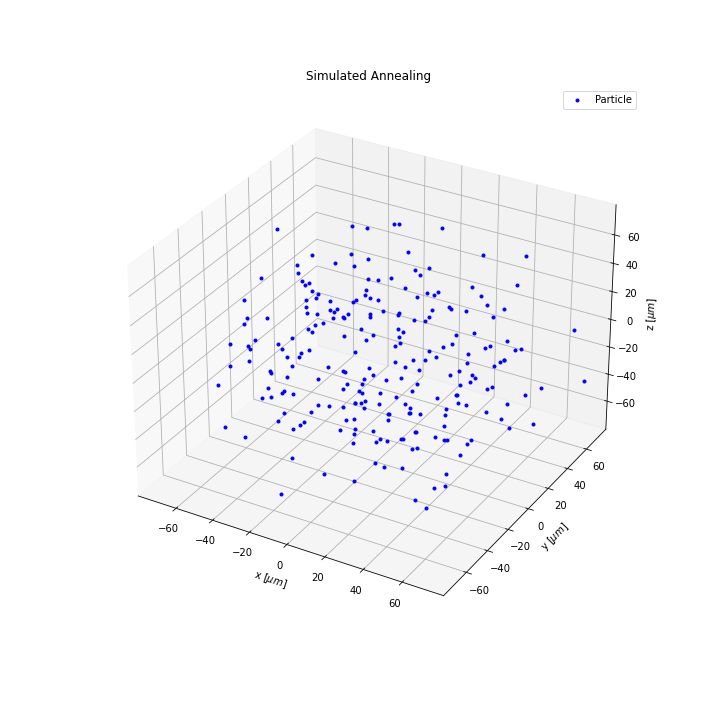

IndexError: index 1846 is out of bounds for axis 0 with size 1846

In [213]:
%matplotlib notebook
from matplotlib.animation import FFMpegWriter

#rot_anim = animate3D(start_pos, title = "Simulated Annealing")
rot_anim = animate3D(x_tot, title = "Simulated Annealing")
#for i in range(1000):
#    this_anim.func_animate(i)
#ani_rot = FuncAnimation(
#    rot_anim.figure, rot_anim.func_animate, interval=1, save_count = 100, repeat = False)
ani_rot = FuncAnimation(
    rot_anim.figure, rot_anim.func_animate, frames =100000, interval=200)
writervideo = FFMpegWriter(fps=60)
ani_rot.save('sim_annealing_236i_new.mp4', writer=writervideo)

(array([-40., -30., -20., -10.,   0.,  10.,  20.,  30.,  40.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

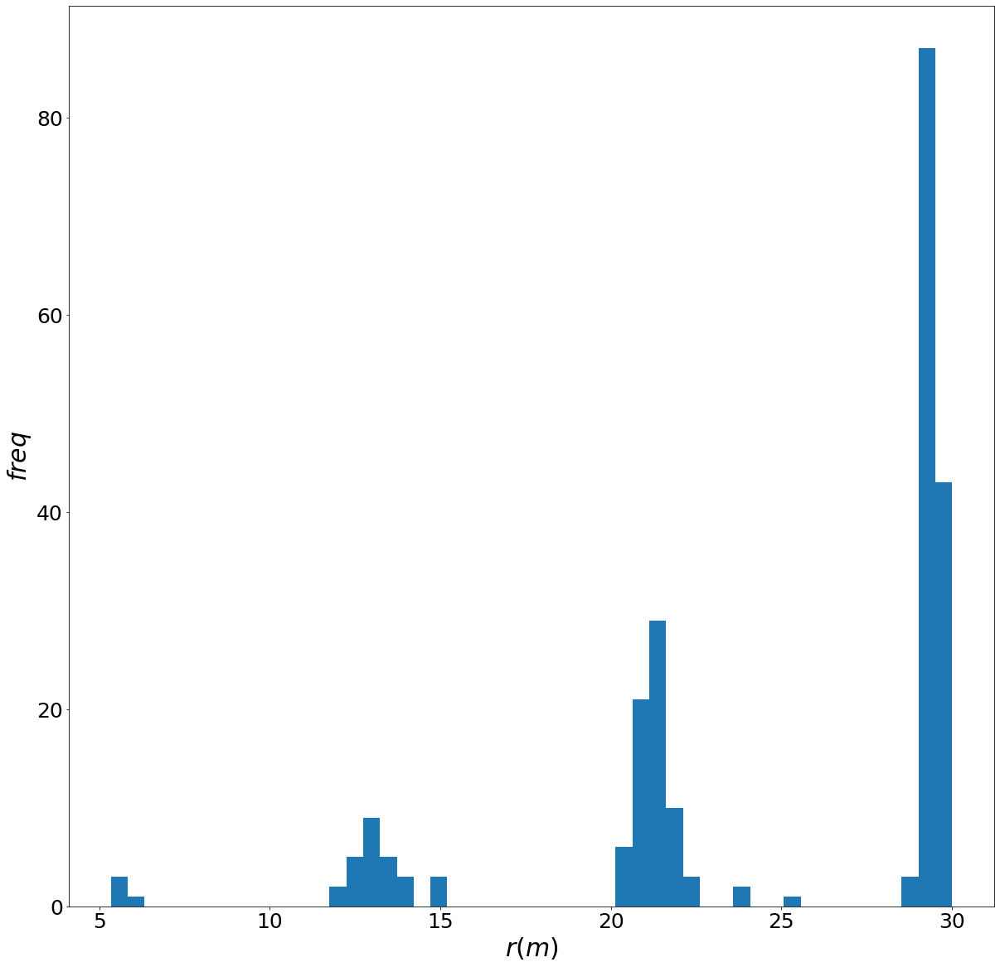

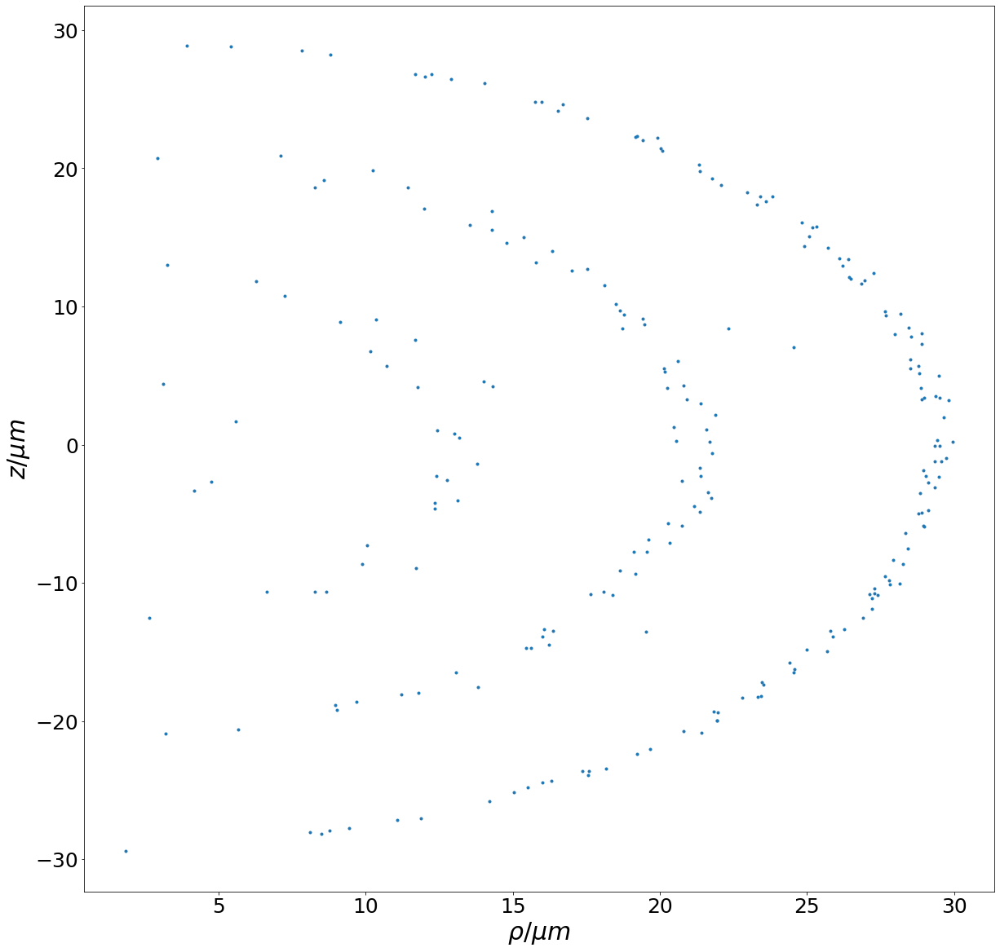

In [444]:
%matplotlib inline
plt.figure(figsize=(20, 20))
rad_list = np.sqrt(x_tot[-1,0,:]**2+x_tot[-1,1,:]**2+x_tot[-1,2,:]**2)
plt.hist(10**6*rad_list,50)
plt.xlabel(r'$r(m)$', fontsize = 30)
plt.ylabel(r'$freq$', fontsize = 30)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

rho_list = np.sqrt(x_tot[-1,0,:]**2+x_tot[-1,1,:]**2)
plt.figure(figsize=(20, 20))
#plt.figure()
plt.plot(10**6*rho_list, 10**6*x_tot[-1,2,:], linestyle = " ", marker = ".")
plt.xlabel(r'$\rho/\mu m$', fontsize = 30)
plt.ylabel(r'$z/\mu m$', fontsize = 30)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

(array([-40., -30., -20., -10.,   0.,  10.,  20.,  30.,  40.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

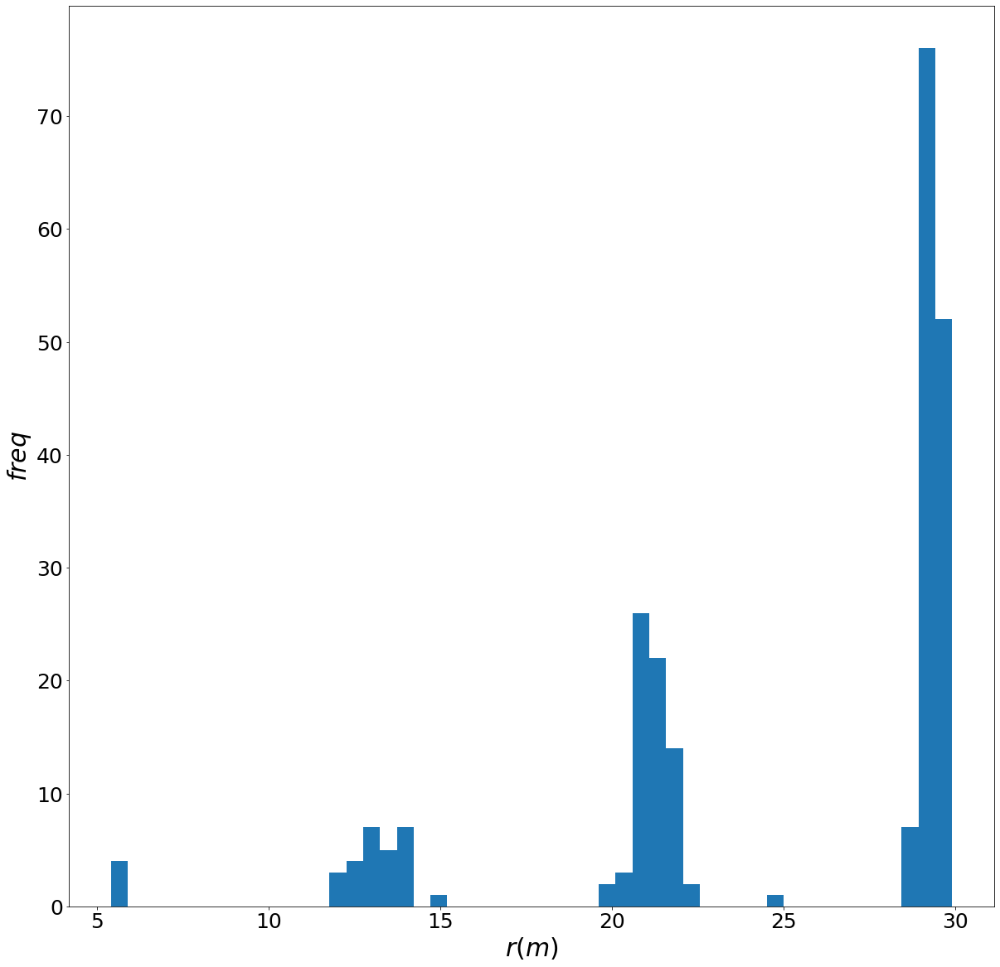

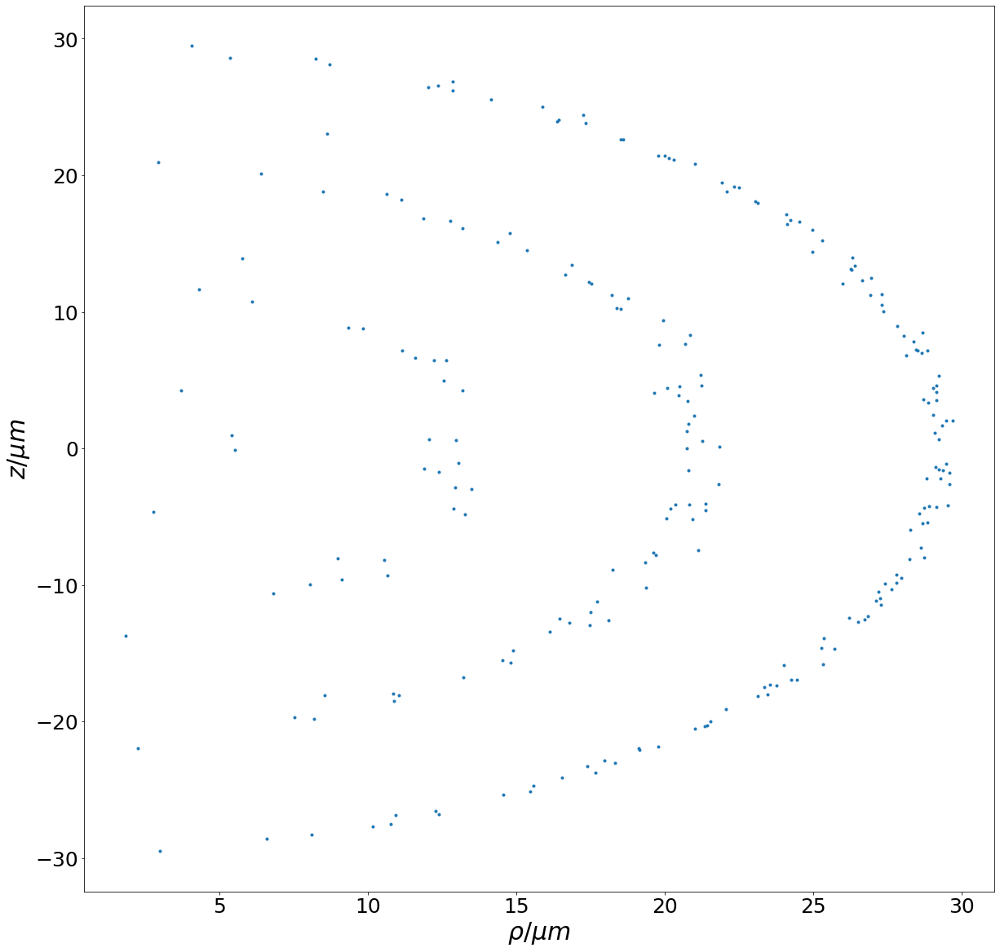

In [26]:
%matplotlib inline
nion
plt.figure(figsize=(20, 20))
rad_list = np.sqrt(res.x[:nion]**2+res.x[nion:nion*2]**2+res.x[2*nion:3*nion]**2)
plt.hist(10**6*rad_list,50)
plt.xlabel(r'$r(m)$', fontsize = 30)
plt.ylabel(r'$freq$', fontsize = 30)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

rho_list = np.sqrt(res.x[:nion]**2+res.x[nion:2*nion]**2)
plt.figure(figsize=(20, 20))
#plt.figure()
plt.plot(10**6*rho_list, 10**6*res.x[2*nion:3*nion], linestyle = " ", marker = ".")
plt.xlabel(r'$\rho/\mu m$', fontsize = 30)
plt.ylabel(r'$z/\mu m$', fontsize = 30)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

<IPython.core.display.Javascript object>


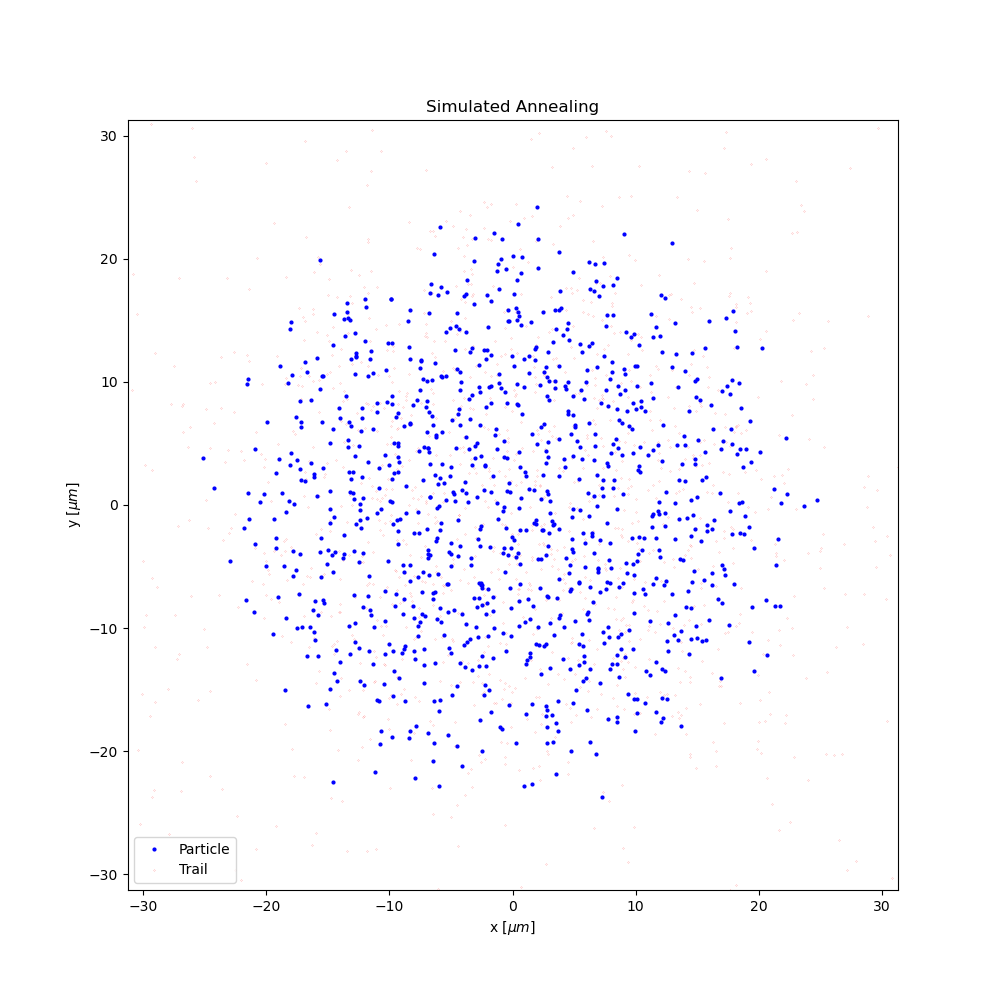

IndexError: index 33 is out of bounds for axis 0 with size 33

In [25]:
%matplotlib notebook
from matplotlib.animation import FFMpegWriter
    
#rot_anim = animate(load_pos_rot2D, title = "Rotating frame movie")
rot_anim = animate(x_tot[:,:2,:], title = "Simulated Annealing")

#for i in range(1000):
#    this_anim.func_animate(i)
#ani_rot = FuncAnimation(
#    rot_anim.figure, rot_anim.func_animate, interval=1, save_count = 100, repeat = False)
ani_rot = FuncAnimation(
    rot_anim.figure, rot_anim.func_animate, frames =100000, interval=200)
writervideo = FFMpegWriter(fps=60)
ani_rot.save('sim_annealing_1000i_topview.mp4', writer=writervideo)

In [22]:
print(x[0])

[[-6.68136771e-05  2.59985043e-05  2.04798140e-05  6.64444692e-05
  -2.19826571e-05 -7.05335765e-06  4.80074833e-05  7.76830392e-05
  -2.57763440e-05  1.04957638e-05  2.59358107e-06  4.02424701e-05
   8.93730647e-06  4.51790583e-05  5.04664298e-05  6.31022031e-06
   5.75029291e-05  2.05754305e-06 -4.61032324e-05  9.44669507e-06
   1.09390238e-05 -4.13635284e-05  7.65314894e-05 -4.82662715e-05
  -2.18278364e-05 -8.23261093e-06 -1.29416151e-05 -5.85389527e-05
  -5.30986088e-05  4.81577225e-05  6.31222194e-05 -5.55698445e-05
  -1.26298457e-05  6.51928741e-05  6.00011963e-05 -4.36738580e-05
  -4.97981173e-05 -2.19498929e-05 -4.35138051e-06 -2.06709754e-05
   2.36813591e-05  3.23408094e-05  1.76781253e-05  6.06842368e-05
  -4.18126048e-05 -4.34416042e-06  1.90820050e-05 -4.36879450e-05
  -7.49064114e-05  1.69192393e-05  7.34253912e-05  3.58683475e-05
  -7.98947692e-05  1.10992586e-05  2.17901993e-05 -3.82632978e-05
   4.76605996e-05 -5.59850920e-05  8.05214046e-05  2.97404365e-05
   1.93849

In [11]:
#import crystal_mod as cry_mod 
import mode_analysis_code_original as ma
import matplotlib.pyplot as plt 
import numpy as np

In [12]:
num_ions=100
mass_amu=9.012182
vtrap=(0.0, -1750.0, -1970.0)
v_wall=30.
frot=180000
method='bfgs'
frot_kHz = 1e-3*frot 

ma_instance=ma.ModeAnalysis(
            N      = num_ions,
            ionmass= mass_amu,
            Vtrap  = vtrap,
            omega_z = 2*np.pi*1.58e6,
            Vwall  = v_wall,
            frot   = frot_kHz,
            method = method)
ma_instance.run()

(200,)


In [13]:
pos = ma_instance.uE

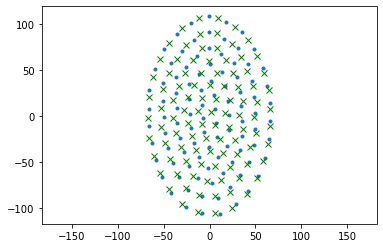

[-7.05073698e-06 -2.24742497e-05  6.50797327e-06  4.89458041e-05
 -5.76342114e-06 -3.23789344e-05 -2.01658446e-05  2.12090264e-06
  5.09702069e-06  3.28347354e-05  7.44865843e-06  9.00340287e-06
  3.33179831e-05 -1.27740512e-05 -1.67241110e-05 -1.14081973e-05
 -2.14415713e-05 -2.22501252e-05  2.99651601e-05  1.37654462e-05
  3.54399407e-05  2.10729896e-05  4.90090976e-05  3.48870658e-05
  1.43008849e-05  6.50920736e-05  2.21721967e-05 -1.76271640e-06
 -7.64659262e-06  1.89459662e-05 -9.97062068e-07 -4.03023674e-05
 -3.63323027e-05 -4.24902715e-05 -3.03641336e-05 -9.19635060e-06
 -4.93734113e-05  3.06390004e-05  2.61766455e-05  5.88182097e-05
  1.73012962e-05  3.55871558e-05  6.60582863e-05  2.16574097e-05
  9.67755474e-06  1.18979413e-05  3.29976597e-05 -7.76713349e-06
  2.94212204e-06 -2.23010445e-05 -2.02237481e-05 -4.51846201e-05
 -4.83874247e-05 -3.59328219e-05 -5.05760842e-05 -2.51327202e-05
 -6.61648577e-05 -1.39496272e-05 -9.53218155e-07  1.30588746e-05
  1.79866901e-07  5.00384

In [176]:
ax = plt.subplot()
ax.axis('equal')
ax.scatter(pos[0:ma_instance.Nion]*1e6,pos[ma_instance.Nion:]*1e6, marker = '.')
#ax.plot(x_tot[-1,0]*1e6,x_tot[-1,1]*1e6, linestyle = " ", marker = 'x', color = 'red')
#ax.plot(res.x[:100]*1e6,res.x[100:200]*1e6, linestyle = " ", marker = 'x', color = 'red')
ax.plot(res5.x[:100]*1e6,res5.x[100:200]*1e6, linestyle = " ", marker = 'x', color = 'green')
plt.show()
print(pos[:num_ions])
print(pos[num_ions:])

In [175]:
pos2D = np.array([pos[0:ma_instance.Nion],pos[ma_instance.Nion:]])
print(pot_en_fmm(pos2D))
print(pot_en_fmm(x_tot[-1]))
res_en = pot_en_fmm(np.array([res.x[0:100],res.x[100:]]))
print(res_en)
res2_en = pot_en_fmm(np.array([res2.x[0:100],res2.x[100:]]))
print(res2_en)
res3_en = pot_en_fmm(np.array([res3.x[0:100],res3.x[100:]]))
print(res3_en)
res4_en = pot_en_fmm(np.array([res4.x[0:100],res4.x[100:]]))
print(res4_en)
res5_en = pot_en_fmm(np.array([res5.x[0:100],res5.x[100:]]))
print(res5_en)

2.8656567604688853e-20
2.866067551817661e-20
2.8659630181088006e-20
2.865872341098493e-20
2.865826500946071e-20
2.865797445433367e-20
2.865779228553333e-20


In [ ]:
2.92930873200625e-20
2.9291774539742116e-20
2.9287971469202123e-20
2.9287816063371503e-20
2.928867171497029e-20

In [12]:
print(x[0])

[[ 4.17070423e-05 -6.19325868e-06  6.32634821e-05  3.76614868e-05
   5.66389874e-05 -3.10147303e-05  4.69757981e-05  1.81316786e-05
  -2.74955788e-05 -5.67346950e-05  8.43491050e-05  3.96427299e-05
  -5.98000665e-05 -9.20972390e-06 -4.51523884e-05 -5.62338935e-05
   2.09259962e-05  6.47698232e-05 -1.09943815e-05 -1.66016124e-05
  -3.52592458e-05 -6.02298037e-05 -8.33262896e-05 -1.92336587e-06
  -8.27644009e-05 -1.44181848e-05  6.07369162e-05  1.75716911e-05
   5.32898311e-06  2.52247283e-05 -3.52995229e-06  6.11865219e-06
  -3.13150293e-05  3.23755431e-05  3.43495352e-07  4.52380647e-05
  -6.36791716e-06 -3.74332096e-05 -8.87941931e-06 -2.63199623e-05
   1.26623133e-05  4.21753221e-05  3.03737534e-05  2.22598487e-06
   2.25660137e-05 -5.27160684e-05 -7.16432431e-05 -1.78669309e-05
  -2.03406048e-05  8.57730365e-06 -4.02895593e-05  5.29217831e-05
   6.88955889e-05 -6.76498819e-05  1.88574286e-06  1.80111762e-05
   7.41652533e-06  6.75604128e-05 -3.50546416e-05  1.23513677e-05
   4.81674

In [85]:
x_tot[-1,:,:]

array([[ 1.71973576e-05, -2.00901508e-05,  2.53168016e-05,
         3.49507844e-05, -3.64015117e-05, -1.69272397e-05,
         1.47226029e-05, -1.59683214e-05,  3.27452939e-05,
         3.84908957e-05,  1.55336898e-05,  1.11336392e-06,
        -2.21619406e-05,  1.24711270e-05, -3.51154424e-05,
        -1.88528461e-06, -2.80405775e-06, -4.91024976e-07,
        -6.56621959e-06, -3.63758937e-05],
       [-7.76430358e-06,  3.33030353e-05, -2.73696129e-05,
         5.83287412e-06, -1.84589500e-05,  9.93582990e-06,
         1.21859314e-05, -1.13496329e-05,  2.52434939e-05,
        -1.31934576e-05,  3.58284274e-05, -2.04321764e-05,
        -3.13207124e-05, -4.03370794e-05,  2.10077493e-05,
         2.21564756e-05,  4.35697214e-05,  5.93270251e-08,
        -4.13192794e-05,  1.14727055e-06],
       [-2.69039968e-08,  1.44178094e-08, -5.24261106e-08,
         4.75409425e-08,  1.66689983e-08,  8.17887784e-08,
         8.70153449e-09,  5.92674843e-08, -3.79556140e-08,
        -1.39473955e-08, -1.6

In [21]:
from scipy.optimize import minimize
print(x_tot[-1].shape)
x_totf = x_tot[-1].flatten()
print(x_totf.shape)

(3, 236)
(708,)


In [42]:
sfx = "_10i_eq"
load_xrot_raw = np.loadtxt("x" + sfx + ".csv")
load_yrot_raw = np.loadtxt("y" + sfx + ".csv")
load_zrot = np.loadtxt("z" + sfx + ".csv")
load_xrot = np.zeros(10)
load_yrot = np.zeros(10)
for j in range(10):
    load_xrot[j] = np.cos(334.47501329-np.pi/2)*load_xrot_raw[j]+np.sin(334.47501329-np.pi/2)*load_yrot_raw[j] #rotation
    load_yrot[j] = -np.sin(334.47501329-np.pi/2)*load_xrot_raw[j]+np.cos(334.47501329-np.pi/2)*load_yrot_raw[j] #rotation
x_totf = np.concatenate([load_xrot,load_yrot,load_zrot]).flatten()

In [54]:
from scipy.optimize import minimize
print(start_pos.shape)
x_totf = start_pos.flatten()
print(x_totf.shape)

(2, 100)
(200,)


In [172]:
#res = minimize(pot_en_fmm, x_totf, tol = 10**-40, method = 'CG', jac = '3-point')
#res = minimize(pot_en_fmm, x_totf, tol = 10**-40, method = 'Nelder-Mead')
#res2 = minimize(pot_en_fmm, res.x, tol = 10**-20, method = 'CG', jac = '3-point')
#res2 = minimize(pot_en_fmm, res.x, tol = 10**-40, method = 'Nelder-Mead')
#res3 = minimize(pot_en_fmm, res2.x, tol = 10**-40, method = 'Nelder-Mead')
#res4 = minimize(pot_en_fmm, res3.x, tol = 10**-40, method = 'Nelder-Mead')
#res5 = minimize(pot_en_fmm, res4.x, tol = 10**-40, method = 'Nelder-Mead')

In [45]:
res = minimize(pot_en_3D_fmm, x_totf, method='CG', tol = 10**-20)

In [62]:
from scipy import optimize
def approx_jac():
    jac = np.zeros(236*3)
    for i in range(236*3):
        jac[i] = optimize.approx_fprime(x, pot_en_3D_fmm, 10**-9)
    return jac
result = optimize.minimize(pot_en_3D_fmm, x_totf, method = 'Newton-CG', jac = approx_jac())

NameError: name 'x' is not defined

In [460]:
np.savetxt("x_236i_eq_scipy.csv", res.x[:236], delimiter=",")
np.savetxt("y_236i_eq_scipy.csv", res.x[236:2*236], delimiter=",")
np.savetxt("z_236i_eq_scipy.csv", res.x[2*236:3*236], delimiter=",")

In [462]:
np.savetxt("x_236i_start.csv", start_pos[0], delimiter=",")
np.savetxt("y_236i_start.csv", start_pos[1], delimiter=",")
np.savetxt("z_236i_start.csv", start_pos[2], delimiter=",")

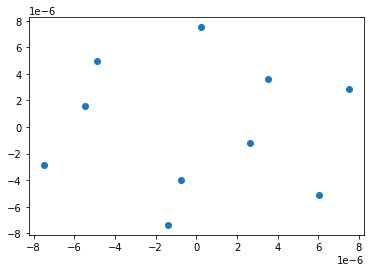

In [28]:
plt.plot(res.x[10:20],res.x[20:30], linestyle = " ", marker = "o")

In [34]:
res_en = pot_en_3D_fmm(np.array([res.x[0:50],res.x[50:2*50], res.x[2*50:3*50]]))
print(res_en)

2.426463904414705e-20


In [48]:
res_en = pot_en_3D_fmm(np.array([res.x[0:236],res.x[236:2*236], res.x[2*236:3*236]]))
print(res_en)

3.3832624218496297e-19


In [46]:
print(res.x - x_totf)
#print(res.x[0:100] - start_pos[0,:])
#print(res.x[0:100])
#print(x_tot[-1,0,:])
print(res.success)
print(res.message)

#print(res2.x[0:100] - x_tot[-1,0,:])
#print(res.x[0:100] - start_pos[0,:])
#print(res.x[0:100])
#print(x_tot[-1,0,:])
#print(res2.success)
#print(res2.message)

[-8.88211394e-09  3.80502237e-09 -1.27667910e-09 -4.98218375e-09
 -8.80070798e-09  1.02888171e-10  2.75789675e-09 -3.36235284e-10
 -3.46168322e-09 -6.55820886e-09 -2.43605487e-09 -6.87923113e-09
  4.05370461e-10 -1.06235403e-08  3.83951302e-09 -4.10161850e-09
  3.71111983e-09 -5.54651895e-09  7.75042602e-10 -6.05308817e-09
 -4.74667720e-09 -6.85252011e-09  4.39506331e-09 -1.00939399e-08
 -4.84333799e-09 -2.71534045e-09 -6.66231474e-10  2.77619586e-10
  7.16344943e-10 -3.55042889e-11  9.40509047e-10 -4.07922133e-09
 -6.27355064e-11  1.47392477e-09 -5.85147346e-09  4.63001954e-09
 -6.33567562e-09  2.00301663e-10 -5.32262582e-09 -1.11868802e-08
  4.57407176e-09 -1.08468848e-08 -4.68177892e-10  3.20226071e-10
  1.96186872e-10 -4.89424598e-09 -9.64648652e-09 -5.36925008e-09
 -2.17040331e-09 -6.04778913e-10 -3.14670267e-09 -7.34574470e-09
 -1.10629263e-08 -2.25061497e-09 -7.61552110e-09 -2.39179244e-09
 -7.14580601e-09 -1.19465258e-08  1.47036866e-09  2.39492536e-10
 -7.61395380e-09 -9.09967

[[ 5.55078827e-06 -3.49700048e-07  1.95074800e-05  3.02678463e-06
   2.67359064e-05 -1.74181949e-05 -2.11780130e-05 -1.09291255e-06
   2.28289296e-05  5.12158366e-09 -1.74807369e-05 -7.29494269e-06
  -7.16247193e-07  5.43236406e-06 -2.25353947e-05  1.45131945e-05
   1.08981930e-06 -2.24323167e-05 -3.86719570e-06  7.89251050e-06
   2.12488196e-05 -1.49542091e-05  8.30882875e-06 -4.04485033e-06
   1.85577857e-05 -1.59449595e-06 -1.45569381e-05  2.69390900e-05
   1.17071935e-05  1.78453630e-05 -2.65705133e-05 -9.34968883e-06
   4.10888300e-06 -1.58866695e-06  6.42012122e-06 -2.21537440e-05
   1.19625568e-05  4.69416977e-06  8.80753710e-06 -4.50277710e-06
  -1.30633859e-05 -7.20397727e-06  1.43720729e-05 -1.42966280e-05
  -9.35920387e-06 -2.56827129e-05  6.55188200e-06  2.48530690e-05
  -1.73618426e-06  4.01799008e-06 -5.02138131e-06  1.53817890e-05
  -2.21063724e-05 -2.23423418e-05  2.86330889e-05  1.99500239e-05
  -1.28955188e-05 -1.86208459e-05 -2.87435325e-05 -1.50207287e-05
   8.79406

(array([-40., -30., -20., -10.,   0.,  10.,  20.,  30.,  40.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

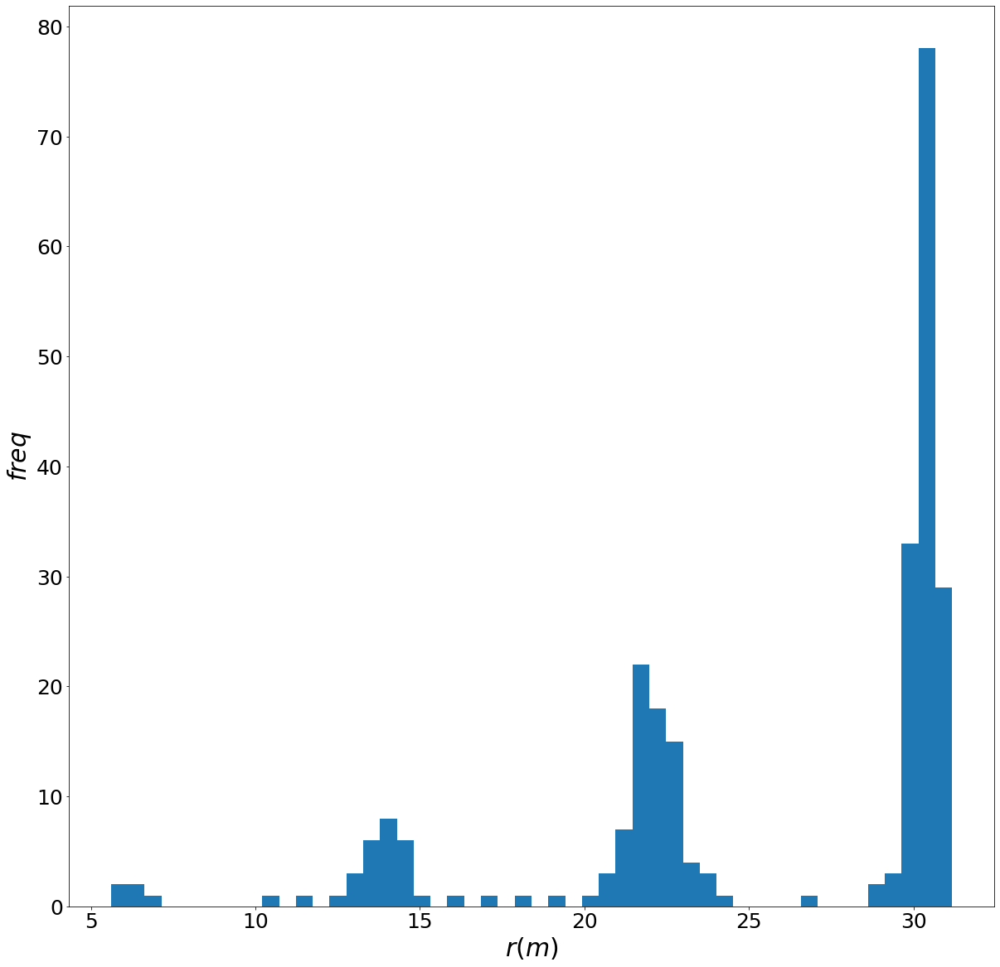

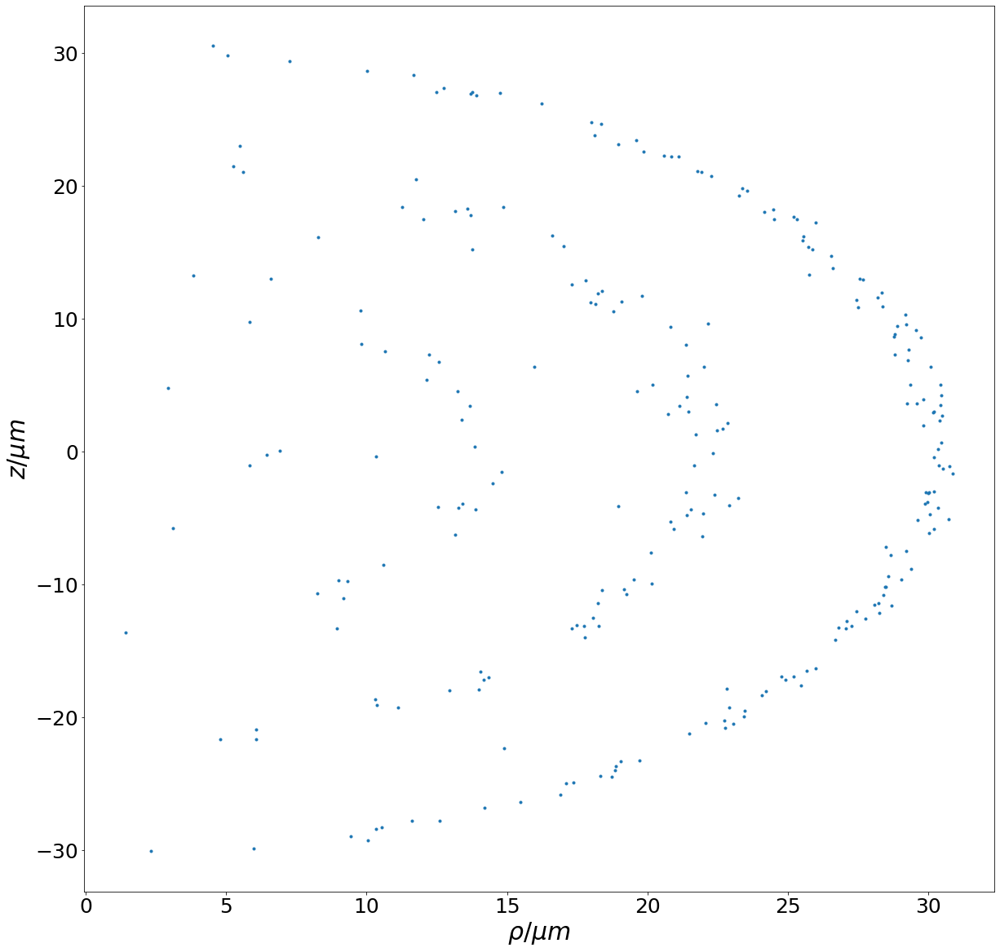

In [113]:
xr = res.x[0:256]
yr = res.x[256:2*256]
zr = res.x[2*256:3*256]
arr_res = np.array([xr,yr,zr])
print(arr_res)
%matplotlib inline
plt.figure(figsize=(20, 20))
rad_list = np.sqrt(xr**2+yr**2+zr**2)
plt.hist(10**6*rad_list,50)
plt.xlabel(r'$r(m)$', fontsize = 30)
plt.ylabel(r'$freq$', fontsize = 30)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

rho_list = np.sqrt(xr**2+yr**2)
plt.figure(figsize=(20, 20))
#plt.figure()
plt.plot(10**6*rho_list, 10**6*zr, linestyle = " ", marker = ".")
plt.xlabel(r'$\rho/\mu m$', fontsize = 30)
plt.ylabel(r'$z/\mu m$', fontsize = 30)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

(array([-4.e-05, -3.e-05, -2.e-05, -1.e-05,  0.e+00,  1.e-05,  2.e-05,
         3.e-05,  4.e-05]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

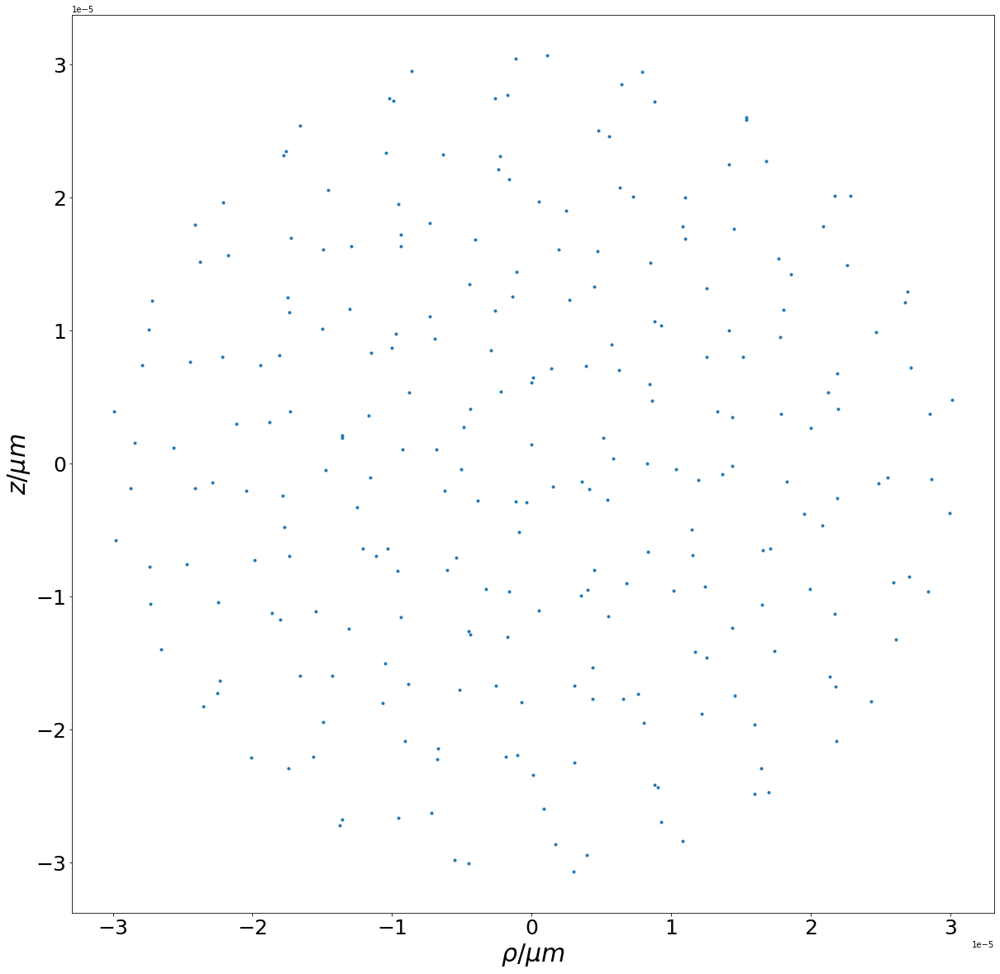

In [114]:
plt.figure(figsize=(20, 20))
#plt.figure()
plt.plot(xr, yr, linestyle = " ", marker = ".")
plt.xlabel(r'$\rho/\mu m$', fontsize = 30)
plt.ylabel(r'$z/\mu m$', fontsize = 30)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

In [60]:
m = 9.012182*1.66057e-27
q = 1.602176597458587e-19
wz = 2*np.pi*1.58e6
wc = 4.4588*q/m
#wr = 180000*2*np.pi*20
wr = (wc-np.sqrt(wc**2-6*wz**2))/2
V0=(0.5 * m * wz**2) / q
Volt_w = 30
Volt_0 = V0 
delta = 1612.*Volt_w / Volt_0
Vw = 0.5*(m*wz**2/q)*delta
eps0 = 8.85418782*10**-12
nion=236

def pot_eng_ax_pl_trap_3D(position):
    #shape   = np.shape(position)
    #dims,ions=shape
    x = position[0:nion]
    y = position[nion:2*nion]
    z = position[2*nion:3*nion]
    pot_eng_ion = np.zeros((nion,2))
    #pot_eng_ion = np.zeros((ions,1))
    pot_eng_ion[:,0] = 0.5*m*wz**2*np.square(z)
    pot_eng_ion[:,1] += -0.5*m*(wr**2 - wr*wc + 0.5*wz**2) *(np.square(x)+np.square(y))
    pot_eng_ion[:,1] += q*Vw*(np.square(x)-np.square(y))
    return np.sum(pot_eng_ion)
'''
def pot_eng_coul_3D(position):
    #shape   = np.shape(position)
    #dims,ions=shape
    x = position[0:100]
    y = position[101:200]
    z = position[201:300]
    pot_eng_ion = np.zeros(ions)
    for ion1 in range(ions):
        for ion2 in range(ions):
            if ion1!=ion2:
                dx = x[ion1] - x[ion2]
                dy = y[ion1] - y[ion2]
                dz = z[ion1] - z[ion2]
                r = np.sqrt(dx**2 + dy**2 + dz**2)
                #r = np.sqrt(dx**2 + dy**2)
                pot_eng_ion[ion1] += q**2/(4*np.pi*eps0*r)
    return np.sum(pot_eng_ion)/2
'''
def pot_eng_coul_3D_fmm(position):
    #shape   = np.shape(position)
    #dims,ions=shape
    x = position[0:nion]
    y = position[nion:2*nion]
    z = position[2*nion:3*nion]
    sources = np.array([x,y,z])
    charges = np.full(nion, 1.0)
    fmm_out = fmm.lfmm3d(eps=10**-5, sources=sources,charges=charges,dipvec=None,targets=None,pg=2,pgt=0,nd=1)
    #print(fmm_out.pot)
    Vc_tot = np.sum(fmm_out.pot) * q**2/(4*np.pi*eps0)
    return Vc_tot/2

'''    
def pot_en_3D(position):
    return pot_eng_ax_pl_trap_3D(position) + pot_eng_coul_3D(position)
pot_en_3D(start_pos)
'''
def pot_en_3D_fmm(position):
    return 10**20*(pot_eng_ax_pl_trap_3D(position) + pot_eng_coul_3D_fmm(position))
#pot_en_3D_fmm(start_pos)

In [9]:
print(pot_en_3D(x_tot[-1]))

5.17146847834089e-18


In [34]:
sfx = "_rot_dec_1000i_w2_d7_f7_t10.dat"
load_xrot = np.loadtxt("x" + sfx + ".csv")
load_yrot = np.loadtxt("y" + sfx + ".csv")
load_zrot = np.loadtxt("z" + sfx + ".csv")
load_vxrot = np.loadtxt("vx" + sfx + ".csv")
load_vyrot = np.loadtxt("vy" + sfx + ".csv")
load_vzrot = np.loadtxt("vz" + sfx + ".csv")

times_rec_d7_f7_t10 = 401
times_rec = times_rec_d7_f7_t10
num_particles = 1000
load_pos_rot3D_d7_f7_t10 = np.zeros((times_rec,3,num_particles))
load_pos_rot2D_d7_f7_t10 = np.zeros((times_rec,2,num_particles))
load_vel_rot3D_d7_f7_t10 = np.zeros((times_rec,3,num_particles))
load_pos_rot3D_d7_f7_t10[:,0,:] = load_xrot
load_pos_rot3D_d7_f7_t10[:,1,:] = load_yrot
load_pos_rot3D_d7_f7_t10[:,2,:] = load_zrot
load_pos_rot2D_d7_f7_t10[:,0,:] = load_xrot
load_pos_rot2D_d7_f7_t10[:,1,:] = load_yrot
load_vel_rot3D_d7_f7_t10[:,0,:] = load_vxrot
load_vel_rot3D_d7_f7_t10[:,1,:] = load_vyrot
load_vel_rot3D_d7_f7_t10[:,2,:] = load_vzrot

pot_en_damp = np.zeros(times_rec_d7_f7_t10)
for i in range(times_rec_d7_f7_t10):
    pot_en_damp[i] = pot_en_3D(load_pos_rot3D_d7_f7_t10[i])
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(times_rec_d7_f7_t10, pot_en_damp)

KeyboardInterrupt: 

In [43]:
m = 9.012182*1.66057e-27
q = 1.602176597458587e-19
wz = 2*np.pi*1.58e6
wc = 4.4588*q/m
wr = 180000*2*np.pi
V0=(0.5 * m * wz**2) / q
Volt_w = 30
Volt_0 = V0 
delta = 1612.*Volt_w / Volt_0
Vw = 0.5*(m*wz**2/q)*delta
eps0 = 8.85418782*10**-12

def pot_eng_ax_pl_trap(position):
    #shape   = np.shape(position)
    #dims,ions=shape
    x = position[0:100]
    y = position[100:200]
    #z = position[2,:]
    #pot_eng_ion = np.zeros((ions,2))
    pot_eng_ion = np.zeros((100,1))
    #pot_eng_ion[:,0] = 0.5*m*wz**2*np.square(z)
    #pot_eng_ion[:,1] += -0.5*m*(wr**2 - wr*wc + 0.5*wz**2) *(np.square(x)+np.square(y))
    #pot_eng_ion[:,1] += q*Vw*(np.square(x)-np.square(y))
    pot_eng_ion[:,0] += -0.5*m*(wr**2 - wr*wc + 0.5*wz**2) *(np.square(x)+np.square(y))
    pot_eng_ion[:,0] += q*Vw*(np.square(x)-np.square(y))
    return np.sum(pot_eng_ion)

def pot_eng_coul(position):
    #shape   = np.shape(position)
    #dims,ions=shape
    x = position[0:100]
    y = position[1:200]
    #z = position[2,:]
    pot_eng_ion = np.zeros(100)
    for ion1 in range(100):
        for ion2 in range(100):
            if ion1!=ion2:
                dx = x[ion1] - x[ion2]
                dy = y[ion1] - y[ion2]
                #dz = z[ion1] - z[ion2]
                #r = np.sqrt(dx**2 + dy**2 + dz**2)
                #pot_eng_ion[ion1] += q**2/(4*np.pi*eps0*r)
                r = np.sqrt(dx**2 + dy**2)
                pot_eng_ion[ion1] += q**2/(4*np.pi*eps0*r)
    return np.sum(pot_eng_ion)/2

def pot_eng_coul_fmm(position):
    #shape   = np.shape(position)
    #dims,ions=shape
    x = position[0:100]
    y = position[100:200]
    sources = np.array([x,y,np.zeros(100)])
    charges = np.full(100, 1.0)
    fmm_out = fmm.lfmm3d(eps=10**-5, sources=sources,charges=charges,dipvec=None,targets=None,pg=2,pgt=0,nd=1)
    #print(fmm_out.pot)
    Vc_tot = np.sum(fmm_out.pot) * q**2/(4*np.pi*eps0)
    return Vc_tot/2

    
def pot_en(position):
    return pot_eng_ax_pl_trap(position) + pot_eng_coul(position)
#pot_en(start_pos)

def pot_en_fmm(position):
    return 10**20*(pot_eng_ax_pl_trap(position) + pot_eng_coul_fmm(position))
#pot_en_fmm(start_pos)

In [20]:
sfx = "_rot_236i_damp_d6_md_sim.dat"
load_xrot = np.loadtxt("x" + sfx + ".csv")
load_yrot = np.loadtxt("y" + sfx + ".csv")
load_zrot = np.loadtxt("z" + sfx + ".csv")
load_vxrot = np.loadtxt("vx" + sfx + ".csv")
load_vyrot = np.loadtxt("vy" + sfx + ".csv")
load_vzrot = np.loadtxt("vz" + sfx + ".csv")

times_rec_d7_f7_t10 = 5001
times_rec = times_rec_d7_f7_t10
num_particles = 236
load_pos_rot3D_d7_f7_t10 = np.zeros((times_rec,3,num_particles))
load_pos_rot2D_d7_f7_t10 = np.zeros((times_rec,2,num_particles))
load_vel_rot3D_d7_f7_t10 = np.zeros((times_rec,3,num_particles))
load_pos_rot3D_d7_f7_t10[:,0,:] = load_xrot
load_pos_rot3D_d7_f7_t10[:,1,:] = load_yrot
load_pos_rot3D_d7_f7_t10[:,2,:] = load_zrot
load_pos_rot2D_d7_f7_t10[:,0,:] = load_xrot
load_pos_rot2D_d7_f7_t10[:,1,:] = load_yrot
load_vel_rot3D_d7_f7_t10[:,0,:] = load_vxrot
load_vel_rot3D_d7_f7_t10[:,1,:] = load_vyrot
load_vel_rot3D_d7_f7_t10[:,2,:] = load_vzrot
x_tot = load_pos_rot3D_d7_f7_t10

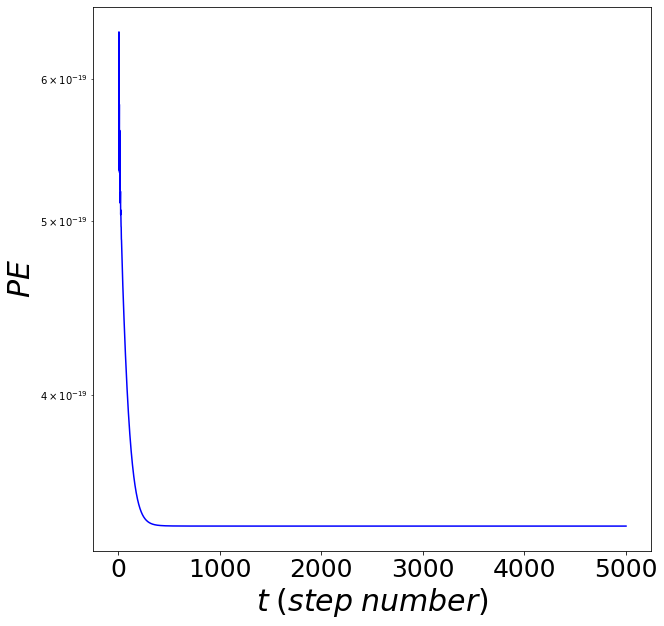

In [17]:
%matplotlib inline
poten_arr_d7_f7_t10 = np.zeros(5001)
for i in range(5001):
    poten_arr_d7_f7_t10[i] = pot_en_3D_fmm(load_pos_rot3D_d7_f7_t10[i])
    
fig, ax = plt.subplots(figsize = (10,10))
ax.plot(np.arange(times_rec_d7_f7_t10)[5:], poten_arr_d7_f7_t10[5:], color = 'blue')

plt.xlabel(r'$t\;(step\;number)$',fontsize = 30)
plt.ylabel(r'$PE$',fontsize = 30)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax.set_yscale('log')

3.383262466888842e-19


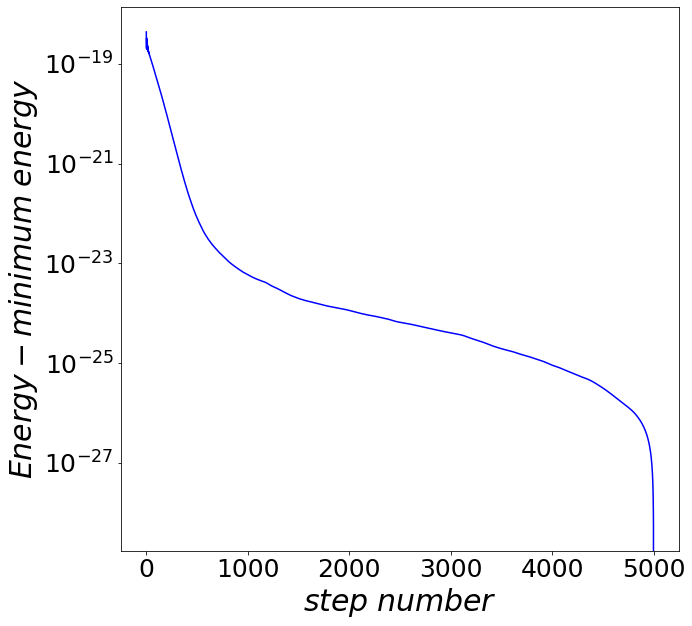

In [18]:
fig, ax = plt.subplots(figsize = (10,10))
ax.plot(np.arange(times_rec_d7_f7_t10)[:], poten_arr_d7_f7_t10[:]-np.amin(poten_arr_d7_f7_t10), color = 'blue')

plt.xlabel(r'$step\;number$',fontsize = 30)
plt.ylabel(r'$Energy - minimum\;energy$',fontsize = 30)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax.set_yscale('log')
print(np.amin(poten_arr_d7_f7_t10))

In [457]:
#Rotating frame animation
from matplotlib.animation import FuncAnimation

class animate:
    def __init__(self,posall,units=1e6, title = "Title"):
        max_slices = 10**5
        len_slices = np.size(posall[:,0,0])
        if len_slices<max_slices: 
            sl=len_slices
        else: 
            sl=max_slices
        
        self.posall = posall


        self.x = []
        self.y = []

        self.positions1 = self.posall*units


        self.figure, self.ax = plt.subplots(figsize=(10,10))
        self.lim = np.max(np.abs(posall[0,:,:]*units))*2
        self.points1, = self.ax.plot(self.x, self.y
                                    ,'bo'
                                    ,zorder=2
                                    ,label='Particle'
                                    ,markersize=2)
        self.lines1, = self.ax.plot(self.x, self.y
                ,'ro'
                ,zorder=1
                ,label='Trail'
                ,markersize=0.1)
        self.ax.legend()
        plt.title(title)
        self.ax.set_xlabel(r'x [$\mu m$]')
        self.ax.set_ylabel(r'y [$\mu m$]')
        self.ax.set_aspect(1)

    def func_animate(self,frame_number,skip=1,tail=1,dots_every=1):
        #self.ax.set_ylim((-self.lim,self.lim))
        #self.ax.set_xlim((-self.lim,self.lim))
        self.ax.set_ylim((-35,35))
        self.ax.set_xlim((0,35))
        x1 = self.positions1[frame_number*skip,0,:]
        y1 = self.positions1[frame_number*skip,1,:]
        if frame_number*skip-tail >= 0:
            index = np.arange(frame_number*skip-tail,
                                frame_number*skip,
                                dots_every)
            linex1=self.positions1[index,0,:]
            liney1=self.positions1[index,1,:]
        else:
            index = np.arange(0,frame_number*skip,dots_every)
            linex1=self.positions1[index,0,:]
            liney1=self.positions1[index,1,:]

        thetime = 1e-8*float(frame_number*skip)/1e-6
        #self.ax.annotate(r"Time =%1.0f[$\mu s$]" %thetime, xy=(0.1, 0.04),\
        #            xycoords='axes fraction',size=10,\
        #            bbox=dict(boxstyle='round', fc='w'))
        self.points1.set_data(x1,y1)
        self.lines1.set_data(linex1,liney1)

In [451]:
pos_rot = np.empty((x_tot.shape[0], 2, 236))
for i in range(pos_rot.shape[0]):
    pos_rot[i,0,:] = np.sqrt(x_tot[i,0,:]**2+x_tot[i,1,:]**2)
    pos_rot[i,1,:] = x_tot[i,2,:]

<IPython.core.display.Javascript object>


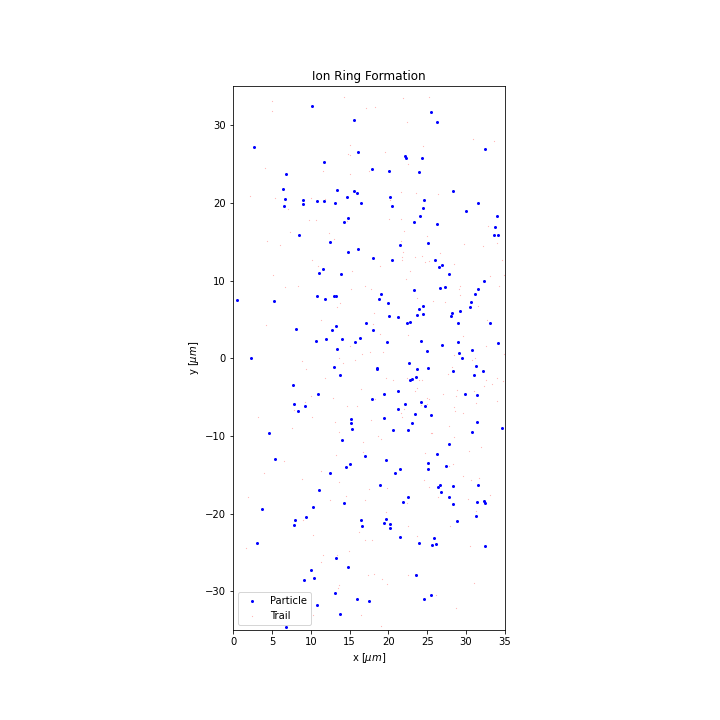

IndexError: index 4337 is out of bounds for axis 0 with size 4337

In [458]:
%matplotlib notebook
from matplotlib.animation import FFMpegWriter
    
#rot_anim = animate(load_pos_rot2D, title = "Rotating frame movie")
rot_anim = animate(pos_rot, title = "Ion Ring Formation")

#for i in range(1000):
#    this_anim.func_animate(i)
#ani_rot = FuncAnimation(
#    rot_anim.figure, rot_anim.func_animate, interval=1, save_count = 100, repeat = False)
ani_rot = FuncAnimation(
    rot_anim.figure, rot_anim.func_animate, frames =30000, interval=10)
writervideo = FFMpegWriter(fps=60)
ani_rot.save('236_ion_rings.mp4', writer=writervideo)


(array([-40., -30., -20., -10.,   0.,  10.,  20.,  30.,  40.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

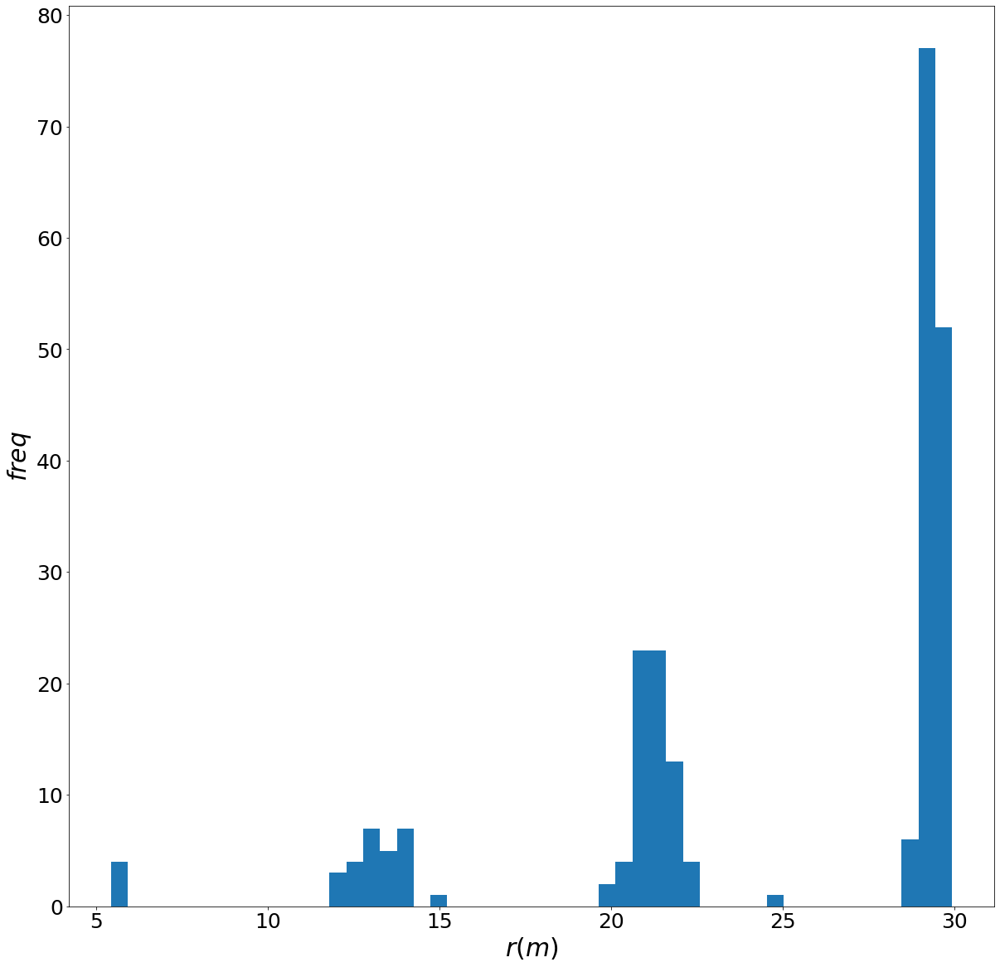

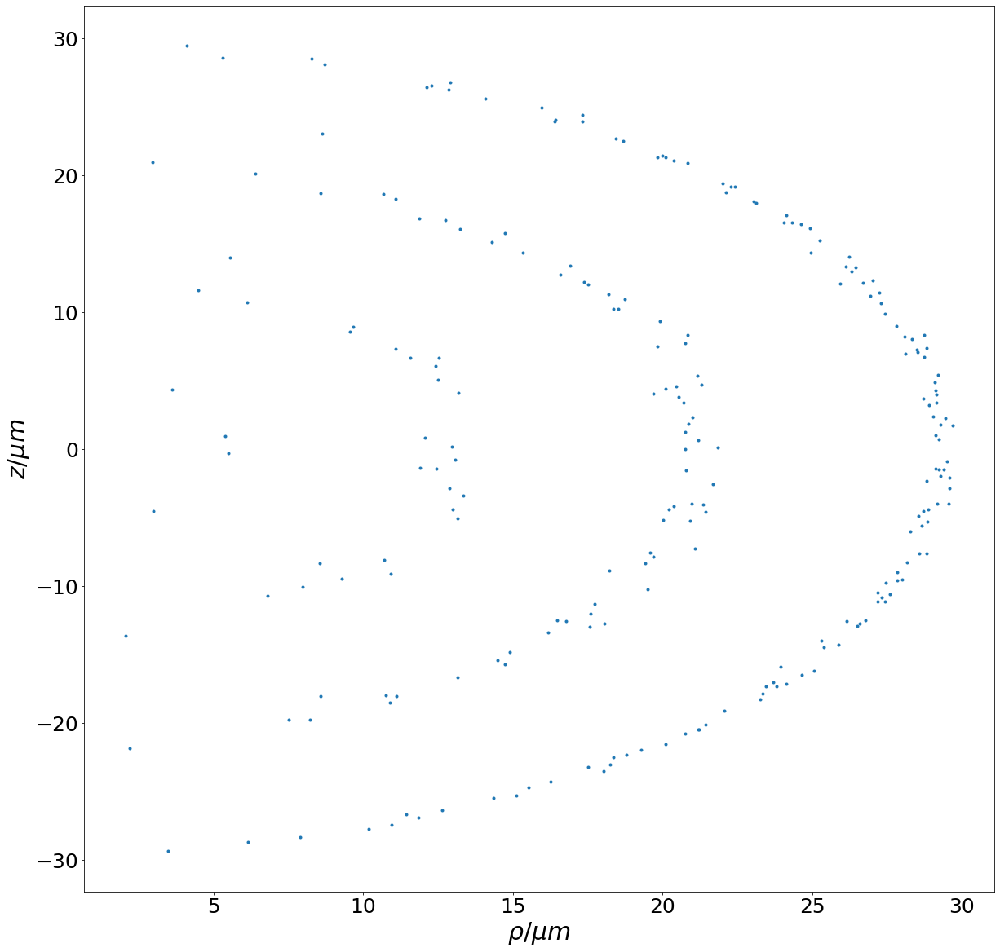

In [19]:
%matplotlib inline
plt.figure(figsize=(20, 20))
rad_list = np.sqrt(load_pos_rot3D_d7_f7_t10[-1,0,:]**2+load_pos_rot3D_d7_f7_t10[-1,1,:]**2+load_pos_rot3D_d7_f7_t10[-1,2,:]**2)
plt.hist(10**6*rad_list,50)
plt.xlabel(r'$r(m)$', fontsize = 30)
plt.ylabel(r'$freq$', fontsize = 30)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

rho_list = np.sqrt(load_pos_rot3D_d7_f7_t10[-1,0,:]**2+load_pos_rot3D_d7_f7_t10[-1,1,:]**2)
plt.figure(figsize=(20, 20))
#plt.figure()
plt.plot(10**6*rho_list, 10**6*load_pos_rot3D_d7_f7_t10[-1,2,:], linestyle = " ", marker = ".")
plt.xlabel(r'$\rho/\mu m$', fontsize = 30)
plt.ylabel(r'$z/\mu m$', fontsize = 30)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

In [46]:
cur = np.array([[1,1],[1,1]])
x = abs(np.random.normal(1, 5, size = (2,2)))
print(x)
cur*x

[[1.54437458 3.31273074]
 [1.65739877 1.6362507 ]]


array([[1.54437458, 3.31273074],
       [1.65739877, 1.6362507 ]])